# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

100% 255k/255k [00:00<00:00, 459kB/s]
100% 255k/255k [00:00<00:00, 459kB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

100% 66.1k/66.1k [00:00<00:00, 352kB/s]
100% 66.1k/66.1k [00:00<00:00, 352kB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [00:55<00:00, 23.5MB/s]
100% 1.09G/1.09G [00:55<00:00, 20.9MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 2.3 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 37.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 59.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 57.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 87.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 27.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━

In [ ]:
import timm

In [ ]:
from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
import torchvision.models as models

In [ ]:
from scipy.stats import spearmanr

# Preprocess & Split

In [ ]:
df_food = pd.read_csv("/content/food.csv")
df_food["image_file"] =df_food["image_file"].apply(lambda file: "/content/food" +"/"+ file) # Create image path
df_food["memorability_wo_fa_correction"] = df_food["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_food.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,2001,/content/food/000000007944.jpg,food,apple,411.0,640.0,coco,apple,1.0,77,2,90,0.855556,0.833333
1,2002,/content/food/000000010478.jpg,food,apple,426.0,640.0,coco,apple,1.0,82,3,101,0.811881,0.782178
2,2003,/content/food/000000028864.jpg,food,apple,384.0,500.0,coco,apple,1.0,70,7,85,0.823529,0.741176
3,2004,/content/food/000000052818.jpg,food,apple,428.0,640.0,coco,apple,1.0,79,1,95,0.831579,0.821053
4,2005,/content/food/000000056714.jpg,food,apple,500.0,333.0,coco,apple,1.0,82,6,101,0.811881,0.752475


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 111.59480955702594
Standard deviation of pixel values: 71.5882221476661


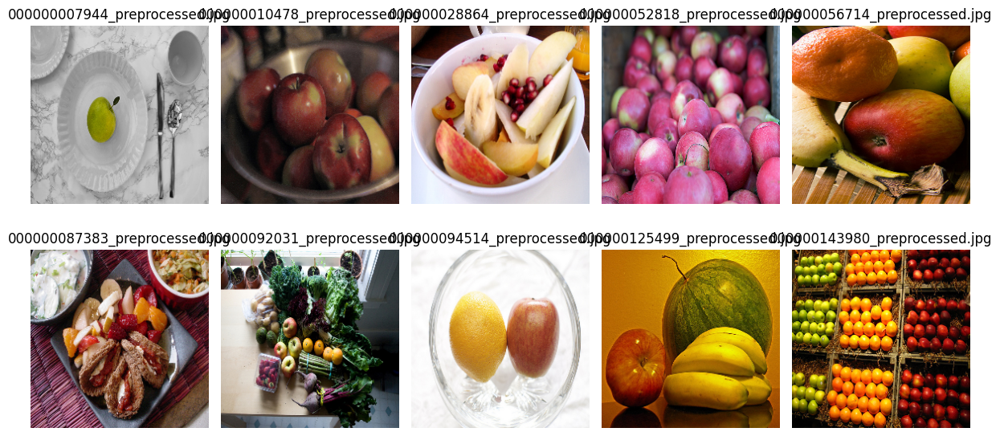

In [ ]:
# Sample data (replace this with your DataFrame)
df_food= pd.DataFrame({
    'image_file': df_food["image_file"],
    'memoscore': df_food["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_food['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_food.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_food.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_food.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_food.head()

,image_file,memoscore,preprocessed_image_path
0,/content/food/000000007944.jpg,0.855556,/content/food/000000007944_preprocessed.jpg
1,/content/food/000000010478.jpg,0.811881,/content/food/000000010478_preprocessed.jpg
2,/content/food/000000028864.jpg,0.823529,/content/food/000000028864_preprocessed.jpg
3,/content/food/000000052818.jpg,0.831579,/content/food/000000052818_preprocessed.jpg
4,/content/food/000000056714.jpg,0.811881,/content/food/000000056714_preprocessed.jpg


In [ ]:
del df_food["image_file"]

In [ ]:
df_food.head()

,memoscore,preprocessed_image_path
0,0.855556,/content/food/000000007944_preprocessed.jpg
1,0.811881,/content/food/000000010478_preprocessed.jpg
2,0.823529,/content/food/000000028864_preprocessed.jpg
3,0.831579,/content/food/000000052818_preprocessed.jpg
4,0.811881,/content/food/000000056714_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_food.drop('memoscore', axis=1)), pd.DataFrame(df_food['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
1237,/content/food/n07923748_4049_preprocessed.jpg
1938,/content/food/n07849336_29367_preprocessed.jpg
1094,/content/food/n07838073_20268_preprocessed.jpg
491,/content/food/000000253863_preprocessed.jpg
640,/content/food/n07717556_2777_preprocessed.jpg


In [ ]:
merged_train_food= pd.concat([X_train, y_train], axis=1)
merged_train_food

,preprocessed_image_path,memoscore
1237,/content/food/n07923748_4049_preprocessed.jpg,0.814433
1938,/content/food/n07849336_29367_preprocessed.jpg,0.917526
1094,/content/food/n07838073_20268_preprocessed.jpg,0.823529
491,/content/food/000000253863_preprocessed.jpg,0.850575
640,/content/food/n07717556_2777_preprocessed.jpg,0.963303
...,...,...
1493,/content/food/n07863374_18875_preprocessed.jpg,0.846154
1580,/content/food/000000538368_preprocessed.jpg,0.840426
1567,/content/food/000000433792_preprocessed.jpg,0.792079
1151,/content/food/000000187959_preprocessed.jpg,0.942308


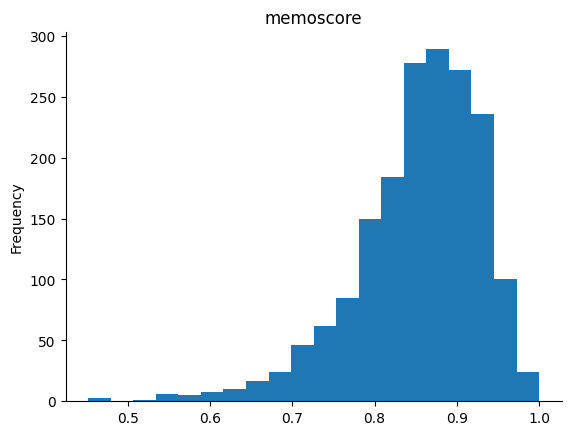

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_train_food['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_val_food = pd.concat([X_val, y_val], axis=1)
merged_val_food

,preprocessed_image_path,memoscore
1204,/content/food/n07697537_5782_preprocessed.jpg,0.858586
1473,/content/food/n07863374_18230_preprocessed.jpg,0.836364
1324,/content/food/n07711569_6001_preprocessed.jpg,0.823529
1886,/content/food/n07933274_35061_preprocessed.jpg,0.891304
1148,/content/food/000000183893_preprocessed.jpg,0.842593
...,...,...
910,/content/food/n07911677_3818_preprocessed.jpg,0.834862
716,/content/food/000000125755_preprocessed.jpg,0.798077
1256,/content/food/n07711569_1475_preprocessed.jpg,0.750000
658,/content/food/n07717556_4185_preprocessed.jpg,0.966667


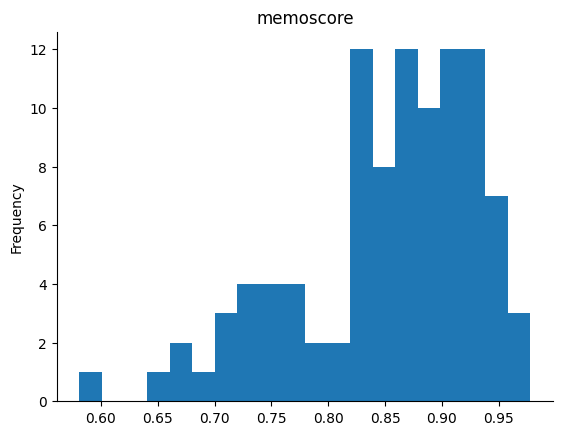

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_val_food['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
merged_test_food = pd.concat([X_test, y_test], axis=1)
merged_test_food

,preprocessed_image_path,memoscore
1273,/content/food/n07711569_2344_preprocessed.jpg,0.956522
875,/content/food/n07911677_10420_preprocessed.jpg,0.688073
1998,/content/food/n07716358_9686_preprocessed.jpg,0.927711
1869,/content/food/n07933274_32452_preprocessed.jpg,0.909091
1132,/content/food/000000051001_preprocessed.jpg,0.895238
...,...,...
1285,/content/food/n07711569_3317_preprocessed.jpg,0.930233
1168,/content/food/000000429293_preprocessed.jpg,0.804124
236,/content/food/n07654148_22848_preprocessed.jpg,0.897727
1049,/content/food/000000554340_preprocessed.jpg,0.860465


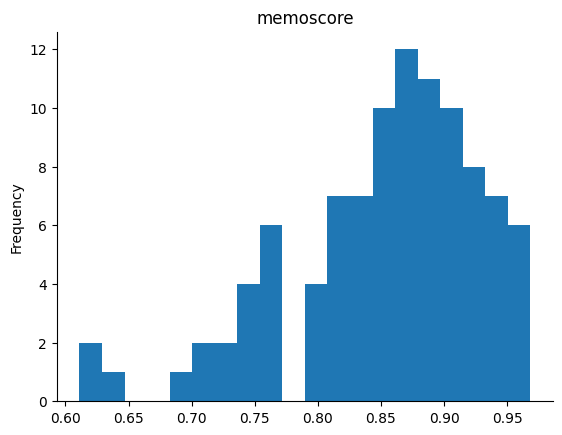

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_test_food['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/food_Vit+Res.csv'
merged_train_food.to_csv(csv_train_food, index=False)

In [ ]:
csv_val_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/food_Vit+Res.csv'
merged_val_food.to_csv(csv_val_food, index=False)

In [ ]:
csv_test_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/food_Vit+Res.csv'
merged_test_food.to_csv(csv_test_food, index=False)

#Load Dataset

In [ ]:
df_train_food = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/food_Vit+Res.csv")
df_val_food= pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/food_Vit+Res.csv')
df_test_food = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/food_Vit+Res.csv')

In [ ]:
df_train_food.head()

,preprocessed_image_path,memoscore
0,/content/food/n07693725_1396_preprocessed.jpg,0.943396
1,/content/food/n07711569_1768_preprocessed.jpg,0.882353
2,/content/food/n07880968_6026_preprocessed.jpg,0.929412
3,/content/food/n07911677_291_preprocessed.jpg,0.814433
4,/content/food/n07654148_11193_preprocessed.jpg,0.837838


In [ ]:
df_train_food.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_food(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_food(df_train_food, trans_transform=trans_transform, res_transform=res_transform)
train_dl = DataLoader(train_ds, batch_size=16, shuffle= False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 143MB/s]

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

In [ ]:
print(trans_layer_norm )

LayerNorm((768,), eps=1e-12, elementwise_affine=True)


In [ ]:
print(layers_trans)

[ViTEmbeddings(
  (patch_embeddings): ViTPatchEmbeddings(
    (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  )
  (dropout): Dropout(p=0.0, inplace=False)
), ViTEncoder(
  (layer): ModuleList(
    (0-11): 12 x ViTLayer(
      (attention): ViTAttention(
        (attention): ViTSelfAttention(
          (query): Linear(in_features=768, out_features=768, bias=True)
          (key): Linear(in_features=768, out_features=768, bias=True)
          (value): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (output): ViTSelfOutput(
          (dense): Linear(in_features=768, out_features=768, bias=True)
          (dropout): Dropout(p=0.0, inplace=False)
        )
      )
      (intermediate): ViTIntermediate(
        (dense): Linear(in_features=768, out_features=3072, bias=True)
        (intermediate_act_fn): GELUActivation()
      )
      (output): ViTOutput(
        (dense): Linear(in_features=3072, ou

In [ ]:
# Merge the two models
class model_merge_food(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_food(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1056: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.018931955099105835

 Epoch: (1/50) Loss_rmse = 0.13759344816207886

 Epoch: (1/50) R^2 = -2.7418978214263916

 Epoch: (1/50) MAE = 0.1127409115433693
Spearman correlation coefficient: SignificanceResult(statistic=0.13260932080586127, pvalue=1.7546062018836812e-08)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.

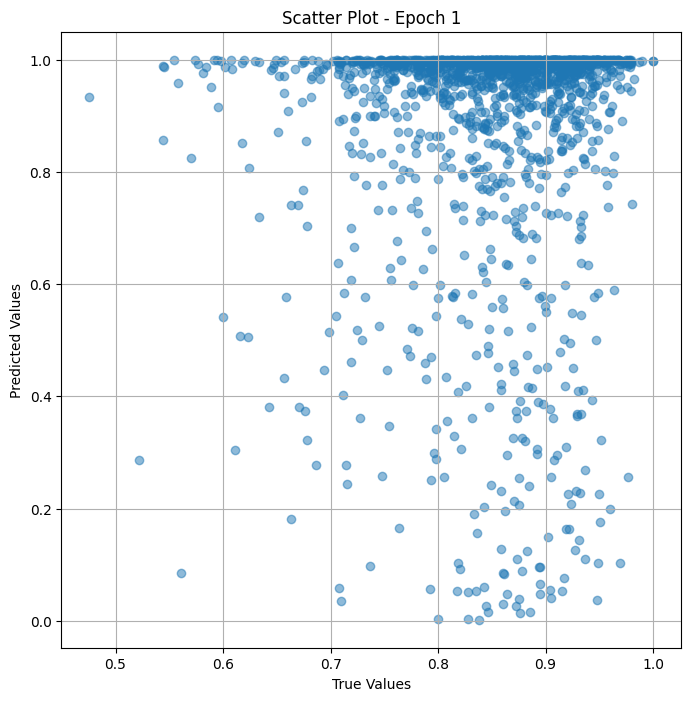

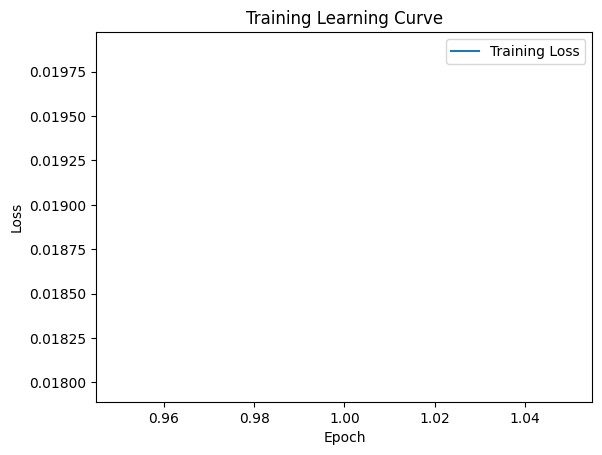


 Epoch: (2/50) Loss = 0.01860984042286873

 Epoch: (2/50) Loss_rmse = 0.13641789555549622

 Epoch: (2/50) R^2 = -2.678231954574585

 Epoch: (2/50) MAE = 0.1100023090839386
Spearman correlation coefficient: SignificanceResult(statistic=0.21115271595616897, pvalue=1.6500919122362536e-19)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86

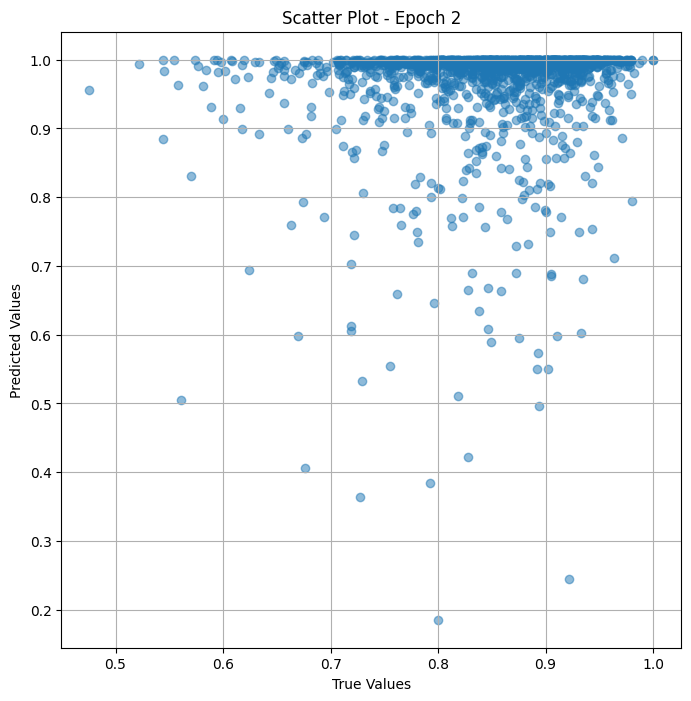

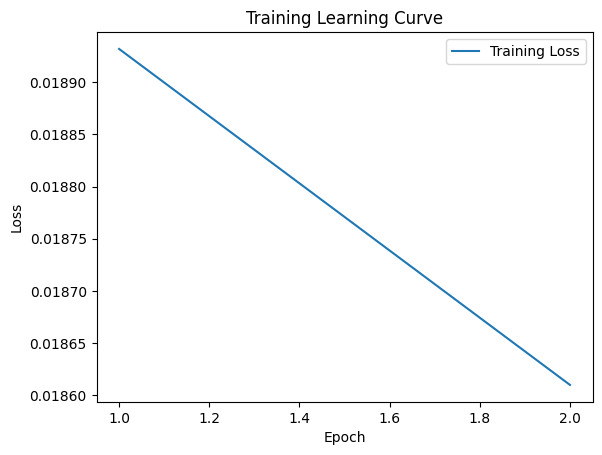


 Epoch: (3/50) Loss = 0.01804320514202118

 Epoch: (3/50) Loss_rmse = 0.13432499766349792

 Epoch: (3/50) R^2 = -2.5662364959716797

 Epoch: (3/50) MAE = 0.10490936040878296
Spearman correlation coefficient: SignificanceResult(statistic=0.2339966343468251, pvalue=1.0342370273649541e-23)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.8

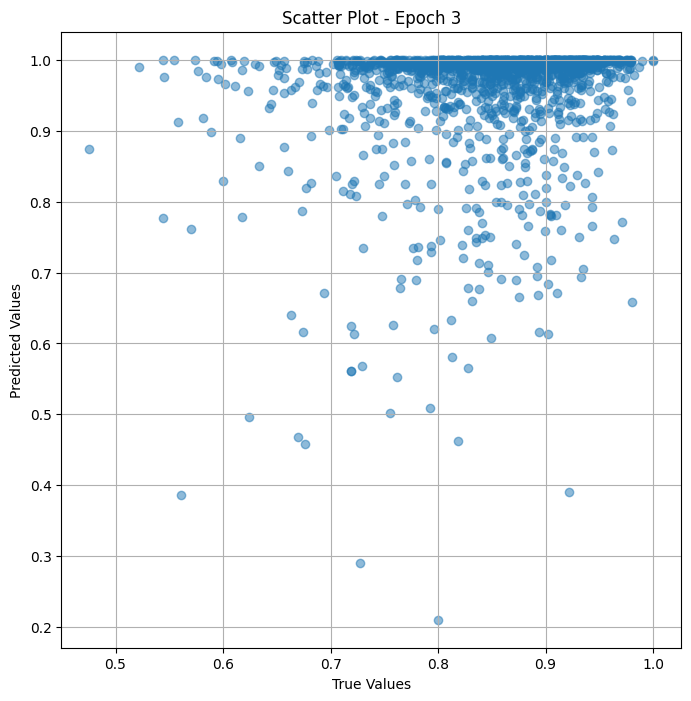

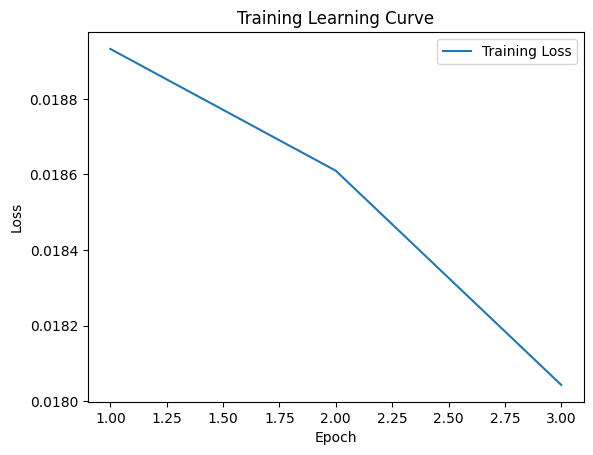


 Epoch: (4/50) Loss = 0.017655786126852036

 Epoch: (4/50) Loss_rmse = 0.13287506997585297

 Epoch: (4/50) R^2 = -2.4896631240844727

 Epoch: (4/50) MAE = 0.10087312012910843
Spearman correlation coefficient: SignificanceResult(statistic=0.24908255147083946, pvalue=9.541286490040213e-27)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.

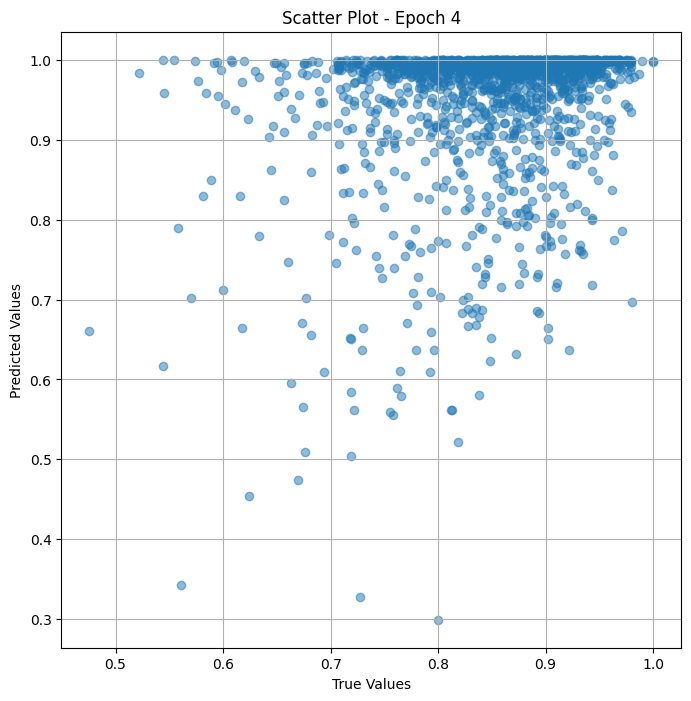

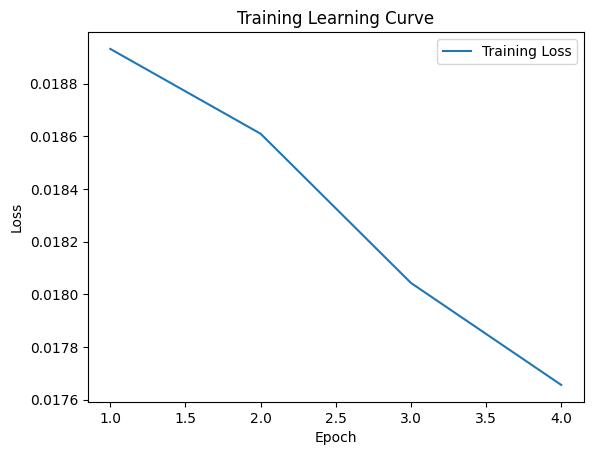


 Epoch: (5/50) Loss = 0.01727929338812828

 Epoch: (5/50) Loss_rmse = 0.13145072758197784

 Epoch: (5/50) R^2 = -2.4152495861053467

 Epoch: (5/50) MAE = 0.09714211523532867
Spearman correlation coefficient: SignificanceResult(statistic=0.2586554193437226, pvalue=8.791240542018457e-29)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86

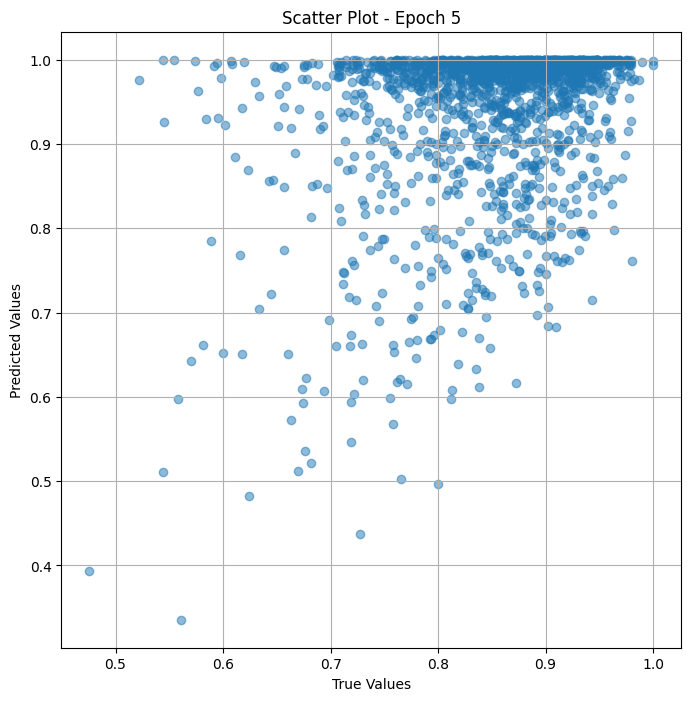

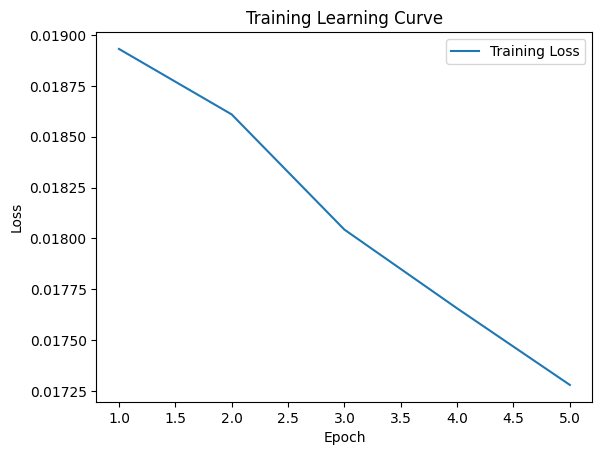


 Epoch: (6/50) Loss = 0.01732068508863449

 Epoch: (6/50) Loss_rmse = 0.13160806894302368

 Epoch: (6/50) R^2 = -2.4234304428100586

 Epoch: (6/50) MAE = 0.10195139795541763
Spearman correlation coefficient: SignificanceResult(statistic=0.27478464084420484, pvalue=2.0770983847389782e-32)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.

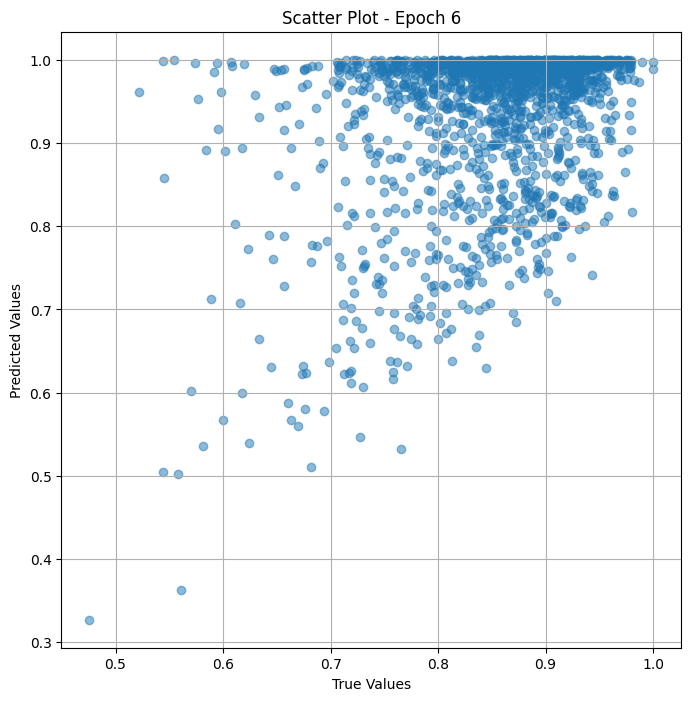

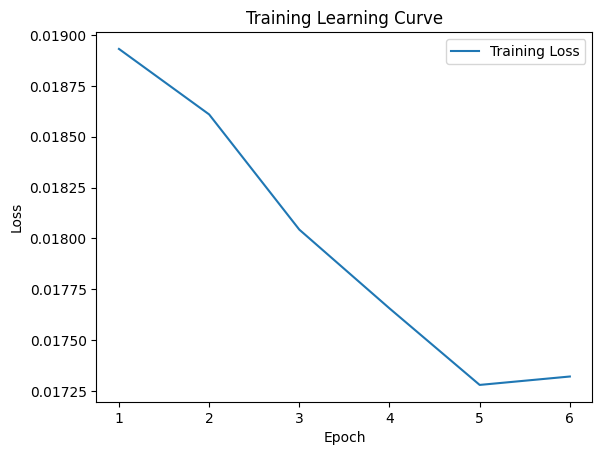


 Epoch: (7/50) Loss = 0.016885802149772644

 Epoch: (7/50) Loss_rmse = 0.12994538247585297

 Epoch: (7/50) R^2 = -2.3374760150909424

 Epoch: (7/50) MAE = 0.10177204012870789
Spearman correlation coefficient: SignificanceResult(statistic=0.2995699098851611, pvalue=1.7729886900325847e-38)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.

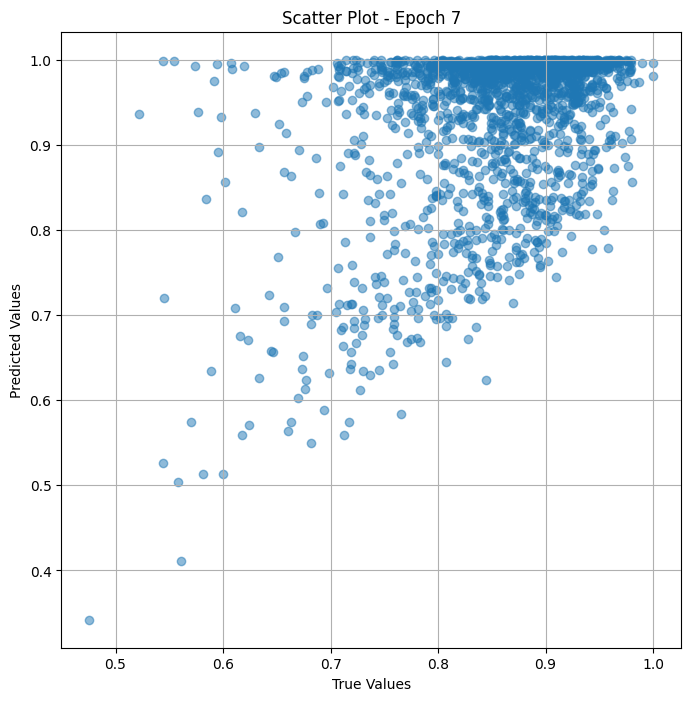

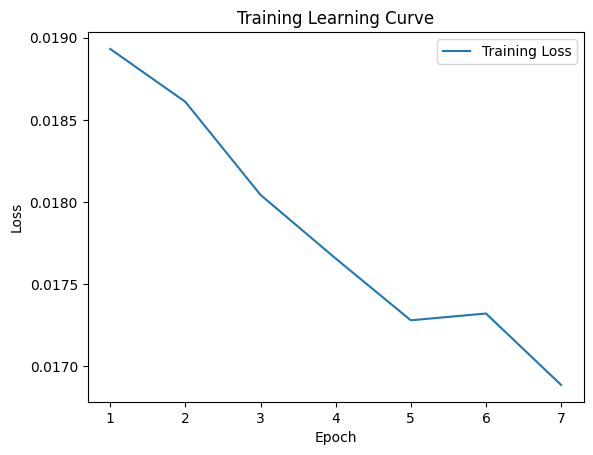


 Epoch: (8/50) Loss = 0.01585930772125721

 Epoch: (8/50) Loss_rmse = 0.12593373656272888

 Epoch: (8/50) R^2 = -2.134589672088623

 Epoch: (8/50) MAE = 0.09991464763879776
Spearman correlation coefficient: SignificanceResult(statistic=0.3264698149138599, pvalue=8.980932058860384e-46)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.861

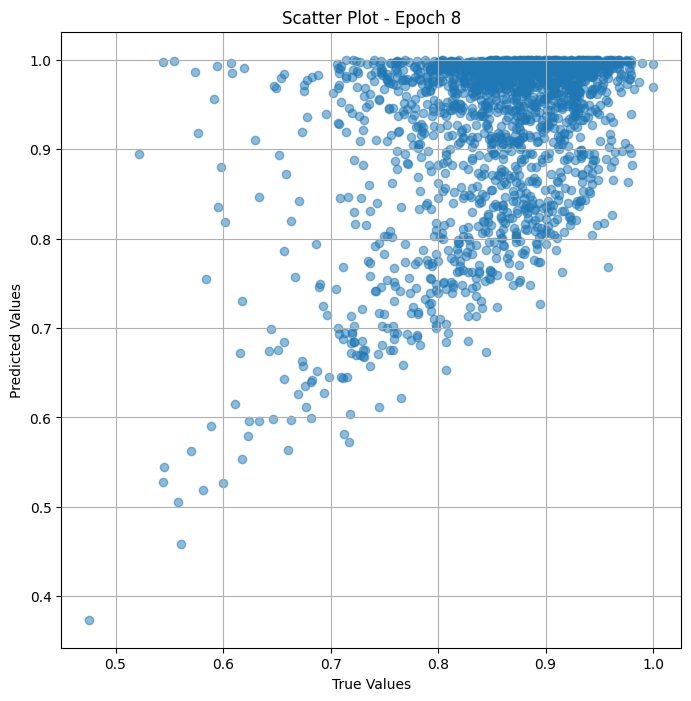

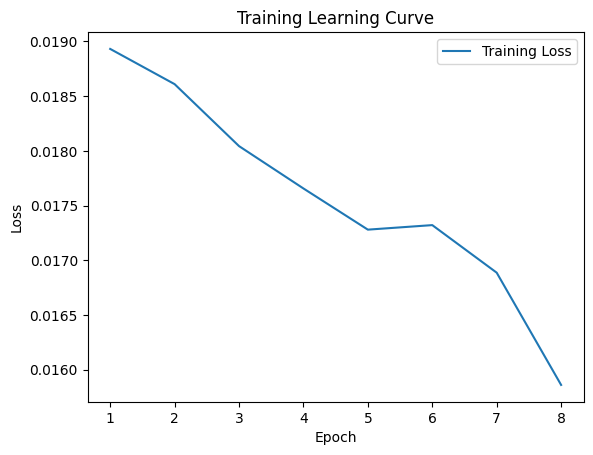


 Epoch: (9/50) Loss = 0.014389719814062119

 Epoch: (9/50) Loss_rmse = 0.11995715647935867

 Epoch: (9/50) R^2 = -1.844125747680664

 Epoch: (9/50) MAE = 0.09614060074090958
Spearman correlation coefficient: SignificanceResult(statistic=0.35351926021372565, pvalue=6.812190143411544e-54)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.8

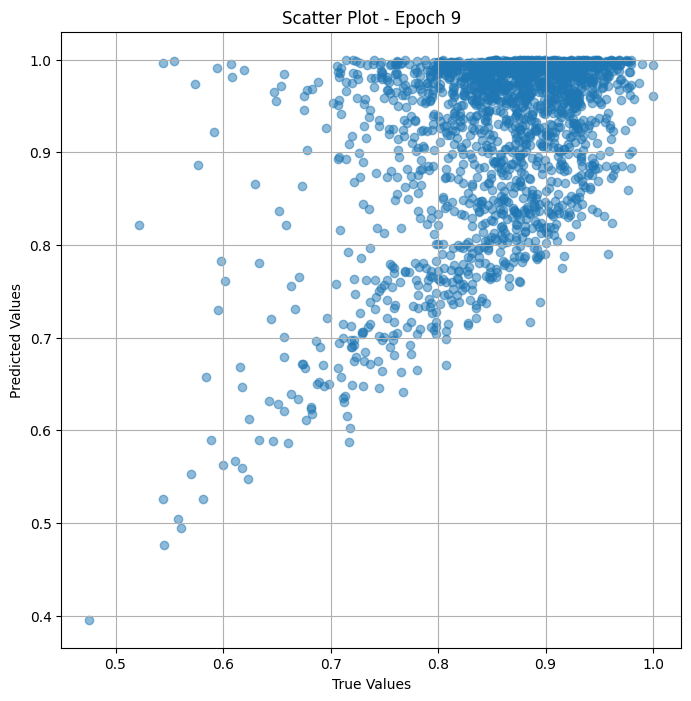

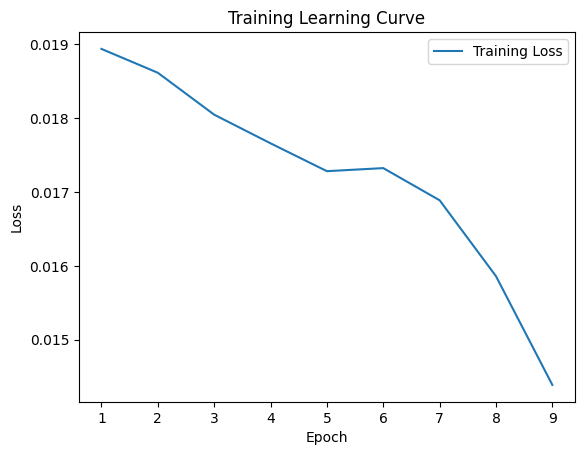


 Epoch: (10/50) Loss = 0.012252861633896828

 Epoch: (10/50) Loss_rmse = 0.11069264262914658

 Epoch: (10/50) R^2 = -1.4217760562896729

 Epoch: (10/50) MAE = 0.0896444320678711
Spearman correlation coefficient: SignificanceResult(statistic=0.3812198958719843, pvalue=4.4990188883447023e-63)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044,

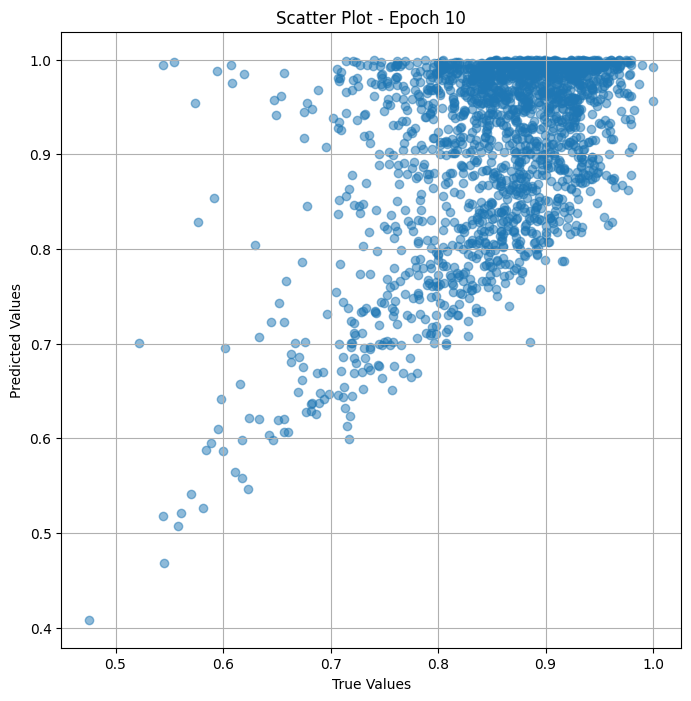

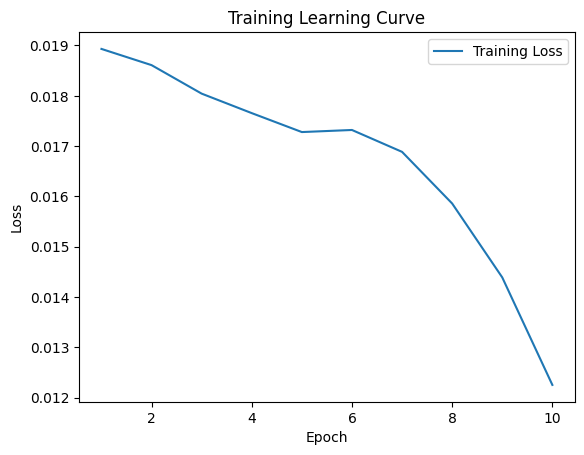


 Epoch: (11/50) Loss = 0.009174186736345291

 Epoch: (11/50) Loss_rmse = 0.09578197449445724

 Epoch: (11/50) R^2 = -0.8132765293121338

 Epoch: (11/50) MAE = 0.07784987986087799
Spearman correlation coefficient: SignificanceResult(statistic=0.41285868173737367, pvalue=1.0507621985896494e-74)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.891304

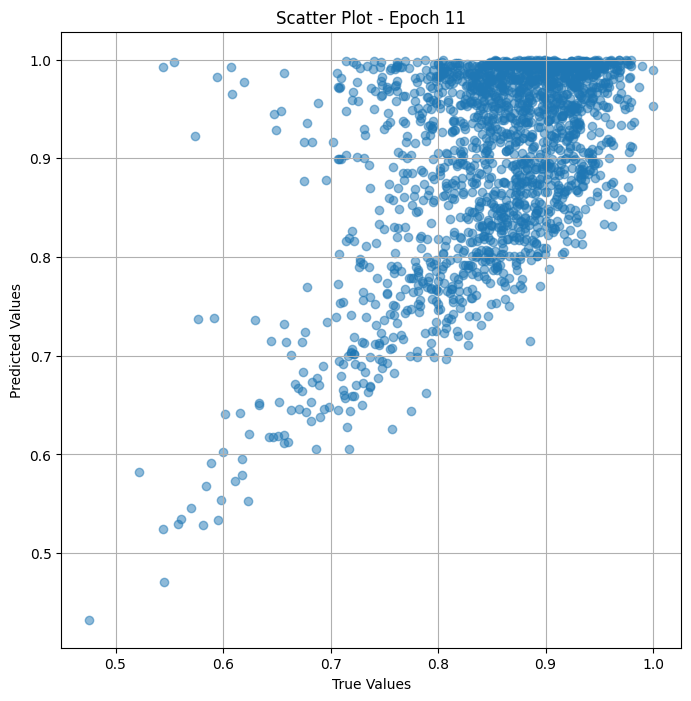

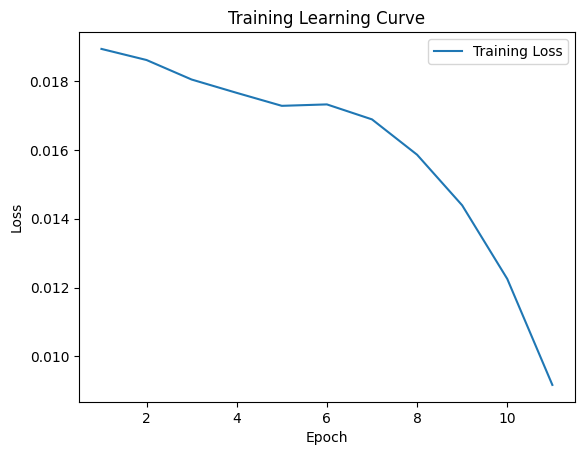


 Epoch: (12/50) Loss = 0.005553026683628559

 Epoch: (12/50) Loss_rmse = 0.07451863586902618

 Epoch: (12/50) R^2 = -0.09755480289459229

 Epoch: (12/50) MAE = 0.060751043260097504
Spearman correlation coefficient: SignificanceResult(statistic=0.44701832644026585, pvalue=9.43043250075289e-89)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.891304

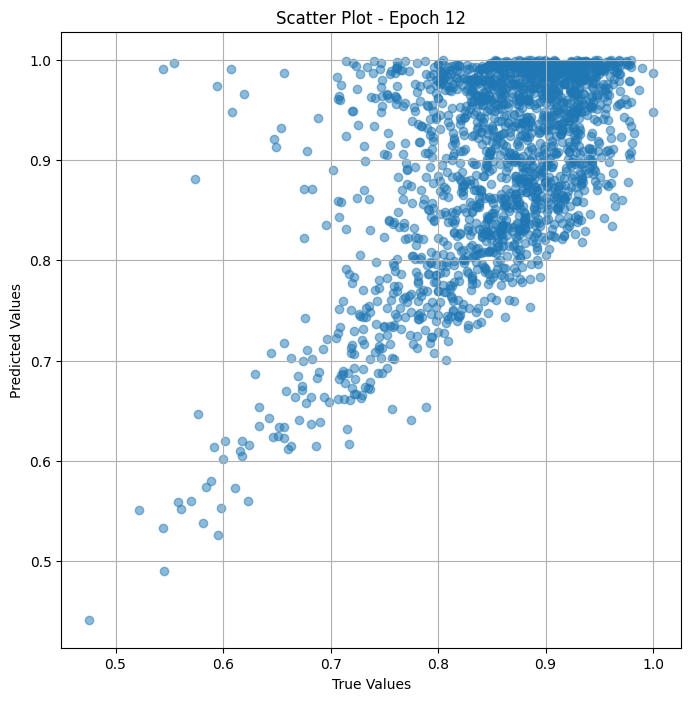

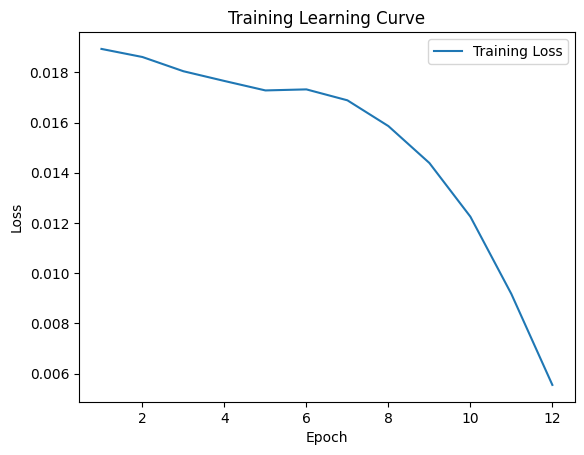


 Epoch: (13/50) Loss = 0.0031423820182681084

 Epoch: (13/50) Loss_rmse = 0.056056953966617584

 Epoch: (13/50) R^2 = 0.3789086937904358

 Epoch: (13/50) MAE = 0.03846793621778488
Spearman correlation coefficient: SignificanceResult(statistic=0.4823550329817506, pvalue=4.489257710775614e-105)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.891304

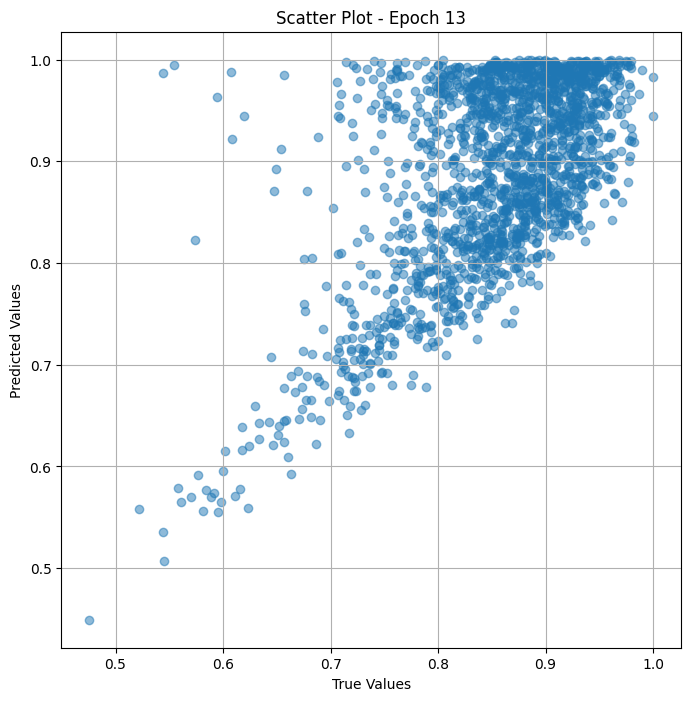

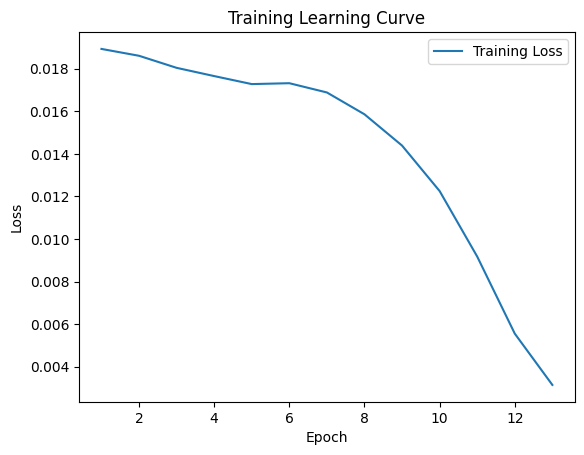


 Epoch: (14/50) Loss = 0.002738719107583165

 Epoch: (14/50) Loss_rmse = 0.05233277380466461

 Epoch: (14/50) R^2 = 0.45869261026382446

 Epoch: (14/50) MAE = 0.0339924693107605
Spearman correlation coefficient: SignificanceResult(statistic=0.5178953653164242, pvalue=1.525681093050412e-123)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044,

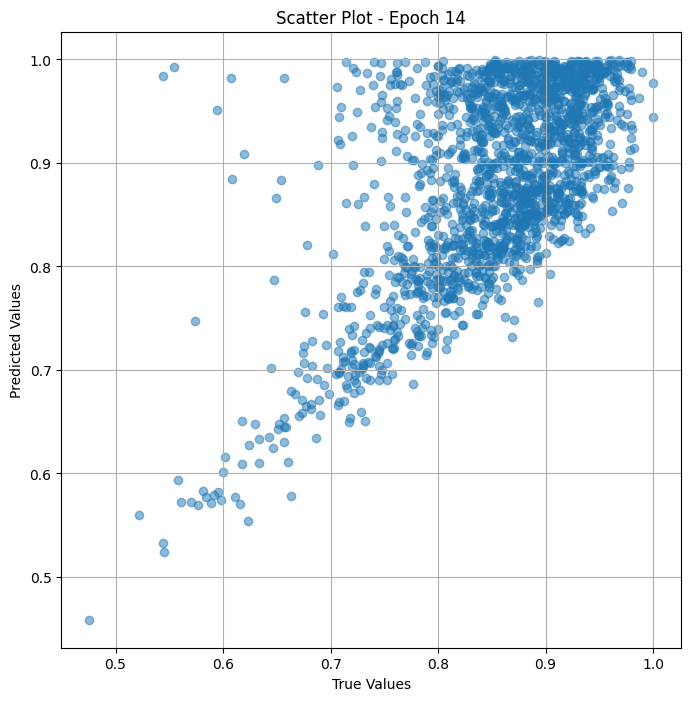

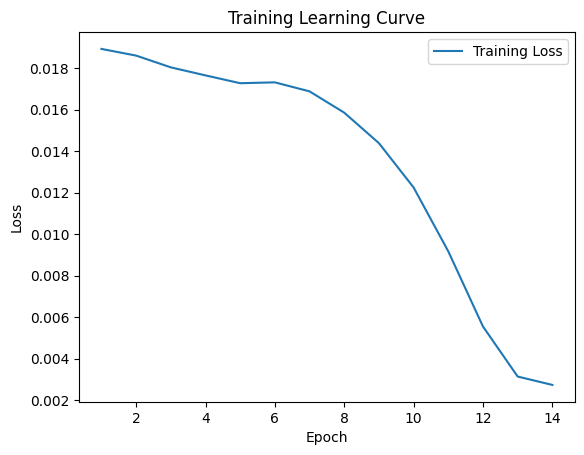


 Epoch: (15/50) Loss = 0.0022561235819011927

 Epoch: (15/50) Loss_rmse = 0.047498669475317

 Epoch: (15/50) R^2 = 0.5540775060653687

 Epoch: (15/50) MAE = 0.030677631497383118
Spearman correlation coefficient: SignificanceResult(statistic=0.5545147253585029, pvalue=5.178796538647473e-145)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044,

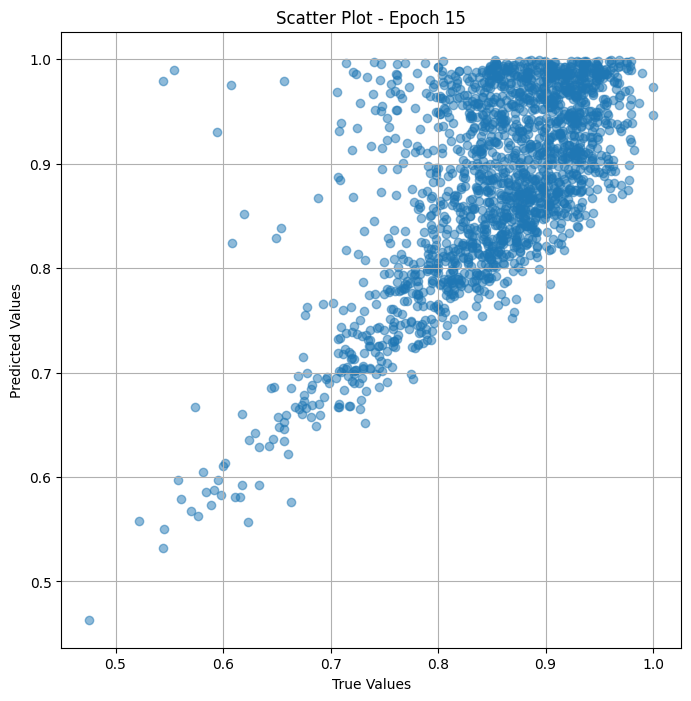

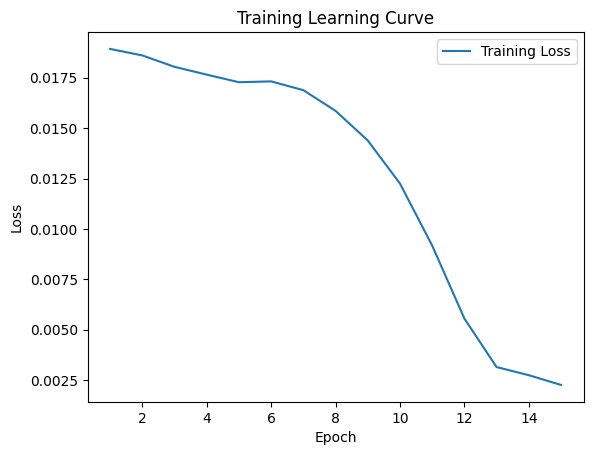


 Epoch: (16/50) Loss = 0.0018396252999082208

 Epoch: (16/50) Loss_rmse = 0.04289085417985916

 Epoch: (16/50) R^2 = 0.6363983750343323

 Epoch: (16/50) MAE = 0.029001086950302124
Spearman correlation coefficient: SignificanceResult(statistic=0.5912750653253863, pvalue=1.977348852613793e-169)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.891304

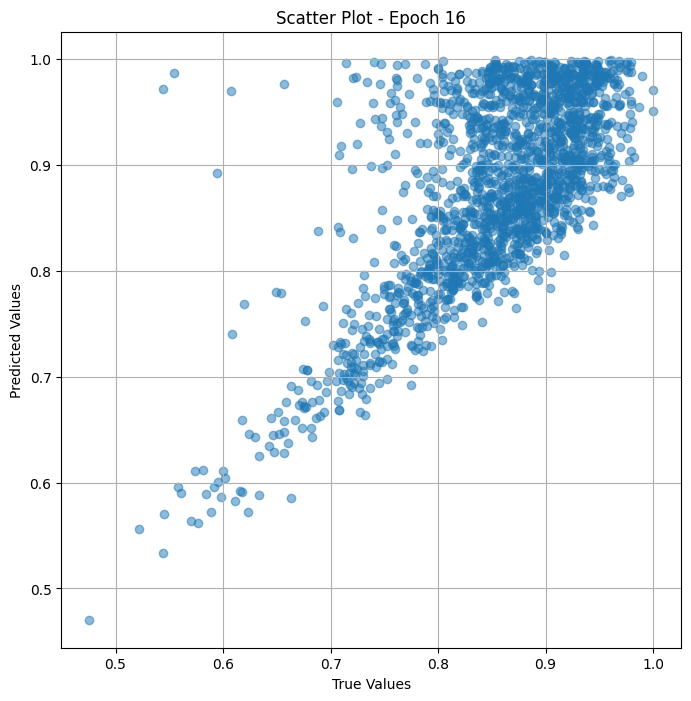

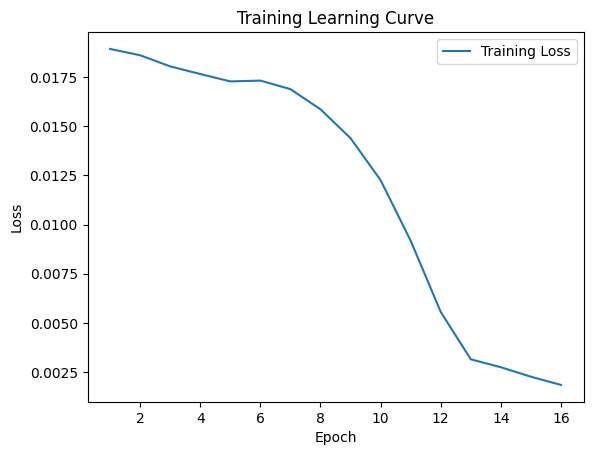


 Epoch: (17/50) Loss = 0.001413800404407084

 Epoch: (17/50) Loss_rmse = 0.03760053589940071

 Epoch: (17/50) R^2 = 0.7205625772476196

 Epoch: (17/50) MAE = 0.02563755214214325
Spearman correlation coefficient: SignificanceResult(statistic=0.6257065108490135, pvalue=2.4345022095737997e-195)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044

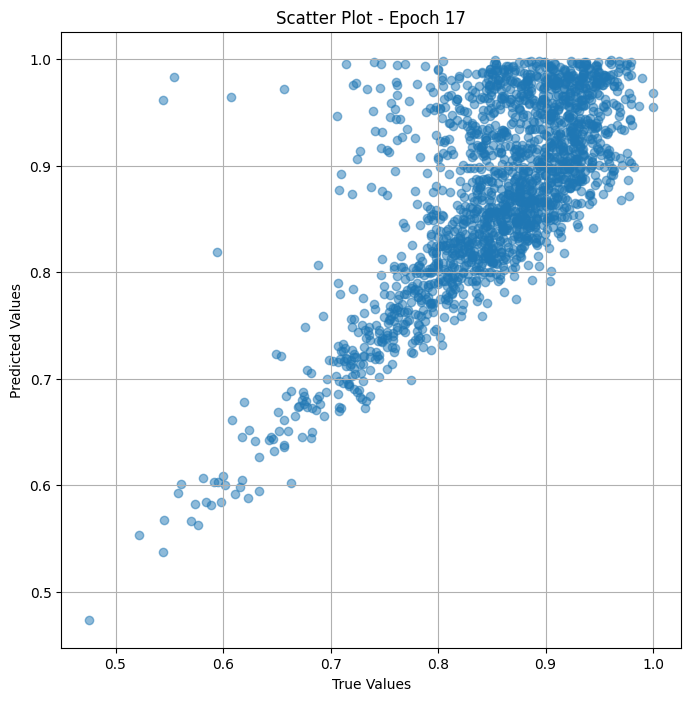

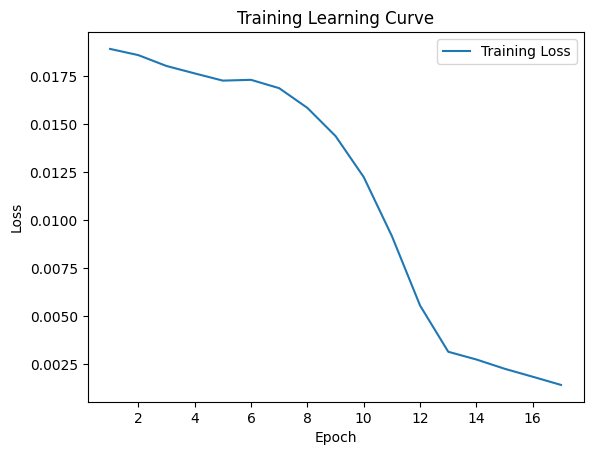


 Epoch: (18/50) Loss = 0.0010627662995830178

 Epoch: (18/50) Loss_rmse = 0.032600097358226776

 Epoch: (18/50) R^2 = 0.7899444103240967

 Epoch: (18/50) MAE = 0.022839069366455078
Spearman correlation coefficient: SignificanceResult(statistic=0.6578602858568032, pvalue=1.1601650117397772e-222)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913

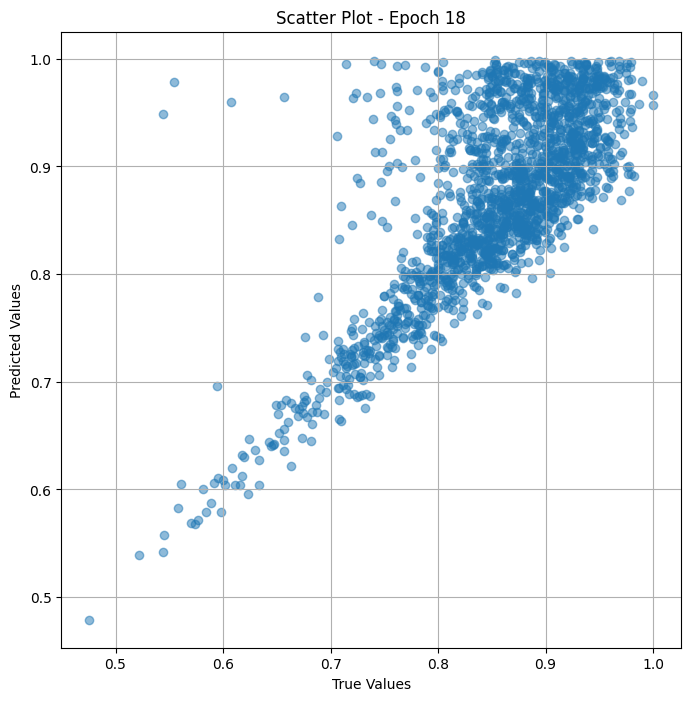

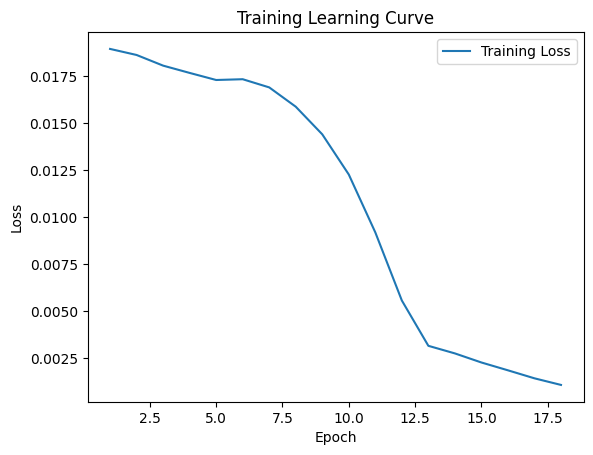


 Epoch: (19/50) Loss = 0.0006783583667129278

 Epoch: (19/50) Loss_rmse = 0.026045313104987144

 Epoch: (19/50) R^2 = 0.8659225702285767

 Epoch: (19/50) MAE = 0.018100067973136902
Spearman correlation coefficient: SignificanceResult(statistic=0.6888087504033059, pvalue=2.4049683052117585e-252)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913

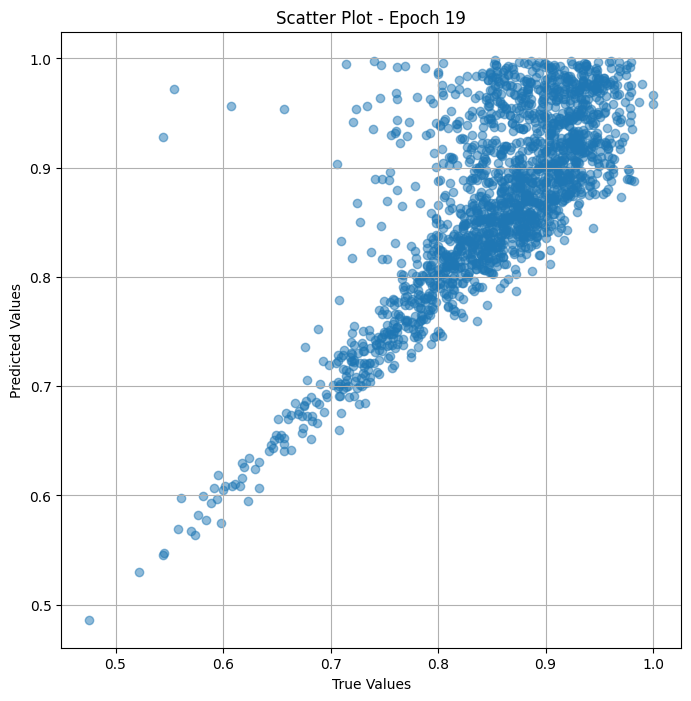

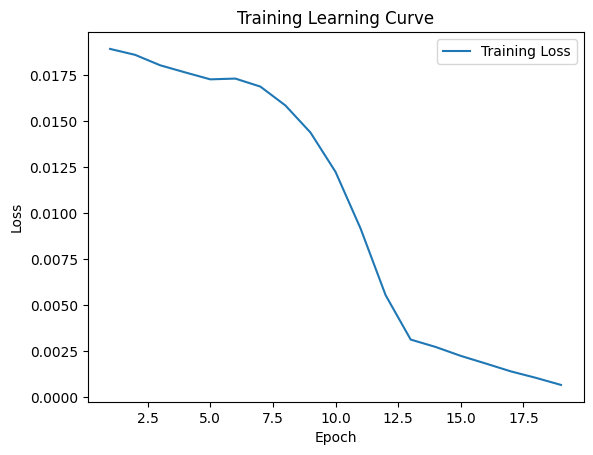


 Epoch: (20/50) Loss = 0.000349557027220726

 Epoch: (20/50) Loss_rmse = 0.018696444109082222

 Epoch: (20/50) R^2 = 0.9309101104736328

 Epoch: (20/50) MAE = 0.014028884470462799
Spearman correlation coefficient: SignificanceResult(statistic=0.7180161200516969, pvalue=5.2383970930326434e-284)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.89130

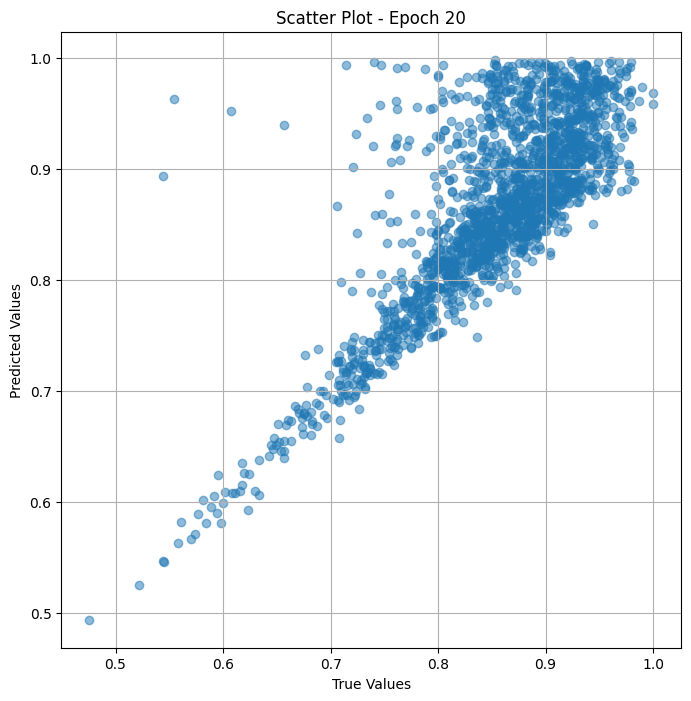

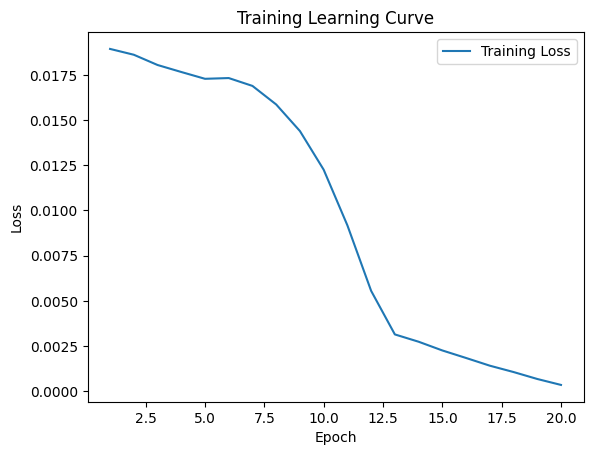


 Epoch: (21/50) Loss = 0.00022742978762835264

 Epoch: (21/50) Loss_rmse = 0.015080775134265423

 Epoch: (21/50) R^2 = 0.9550485610961914

 Epoch: (21/50) MAE = 0.011797450482845306
Spearman correlation coefficient: SignificanceResult(statistic=0.7459166136281348, pvalue=2.933327e-318)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86

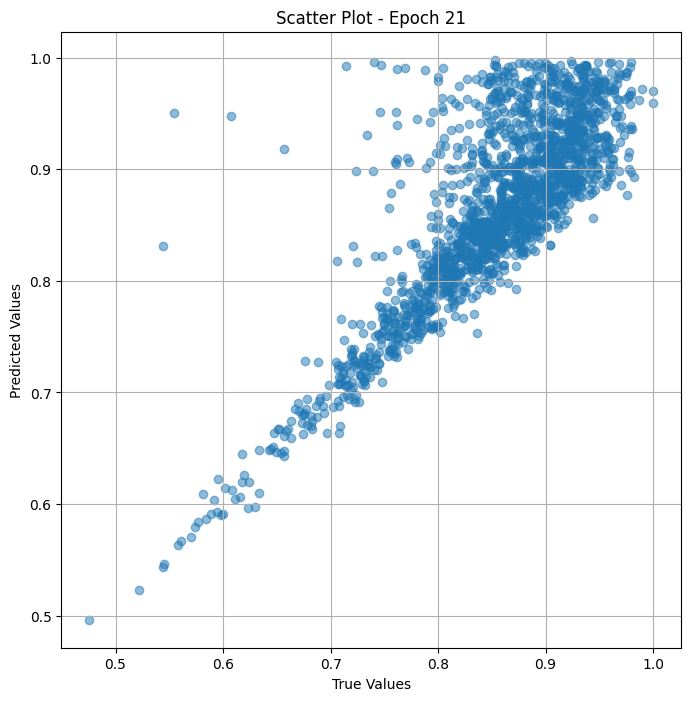

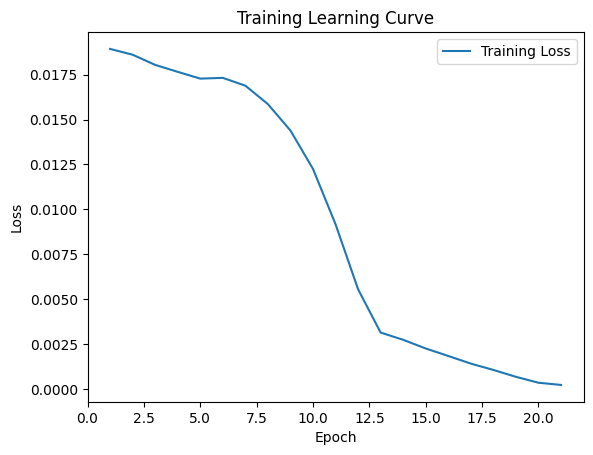


 Epoch: (22/50) Loss = 0.00027923681773245335

 Epoch: (22/50) Loss_rmse = 0.016710380092263222

 Epoch: (22/50) R^2 = 0.9448089003562927

 Epoch: (22/50) MAE = 0.010032124817371368
Spearman correlation coefficient: SignificanceResult(statistic=0.771397248464133, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.8

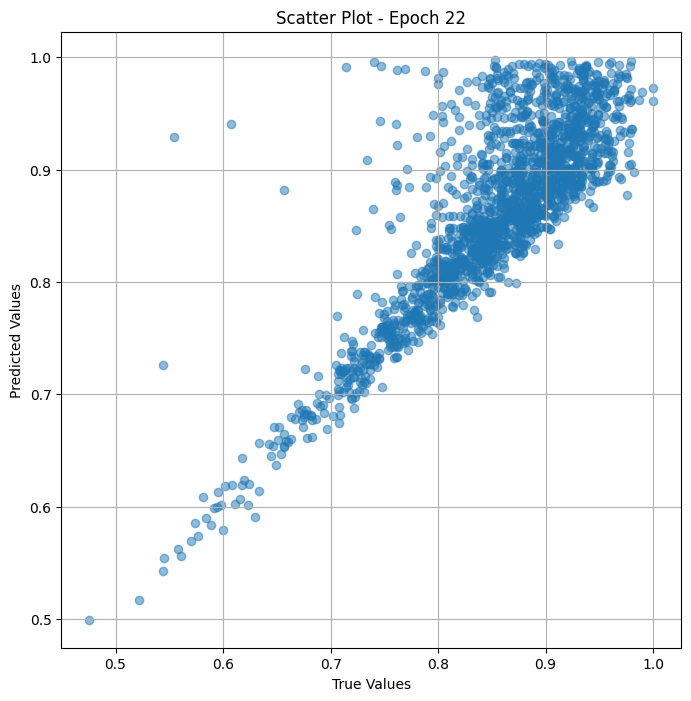

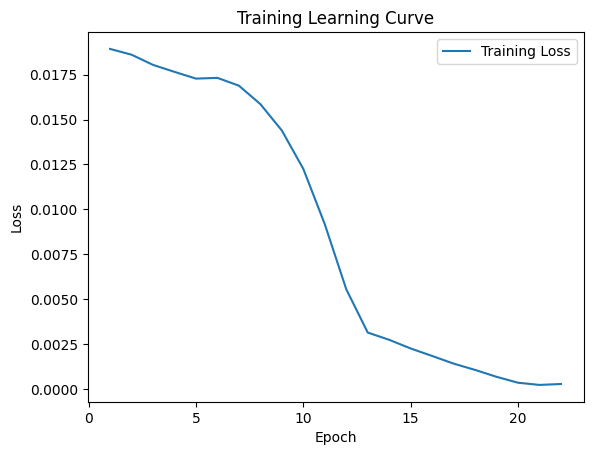


 Epoch: (23/50) Loss = 0.00036813796032220125

 Epoch: (23/50) Loss_rmse = 0.019186921417713165

 Epoch: (23/50) R^2 = 0.9272375702857971

 Epoch: (23/50) MAE = 0.013477765023708344
Spearman correlation coefficient: SignificanceResult(statistic=0.7931847239245402, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

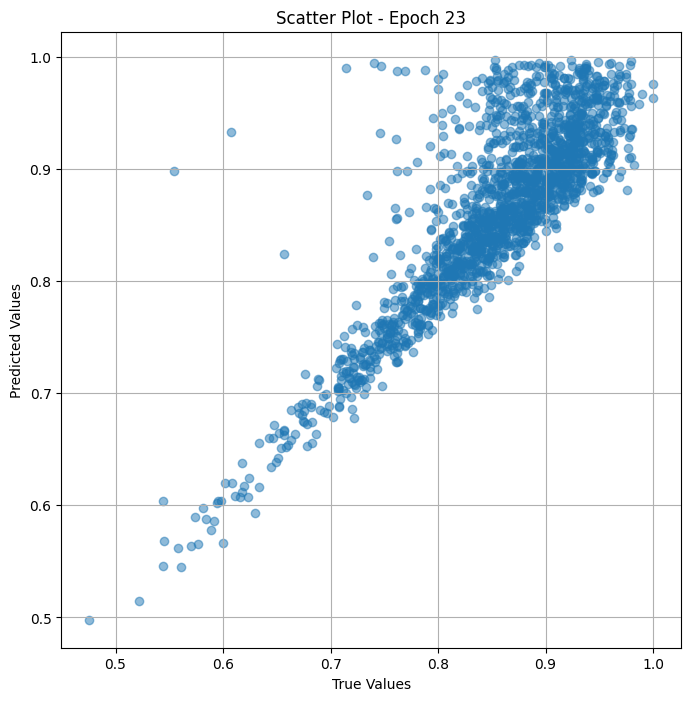

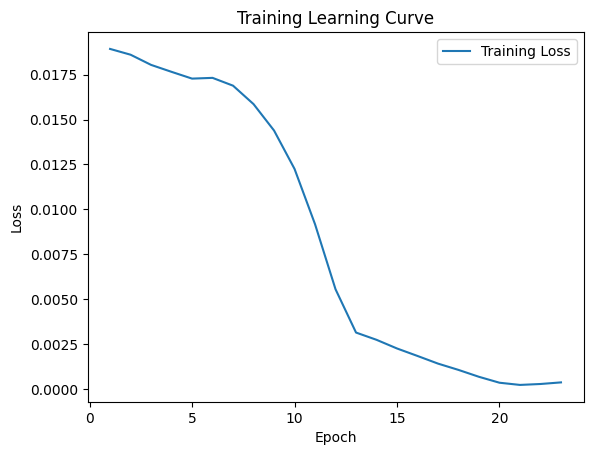


 Epoch: (24/50) Loss = 0.00037195131881162524

 Epoch: (24/50) Loss_rmse = 0.01928604021668434

 Epoch: (24/50) R^2 = 0.9264838695526123

 Epoch: (24/50) MAE = 0.01490003615617752
Spearman correlation coefficient: SignificanceResult(statistic=0.810624937283579, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87,

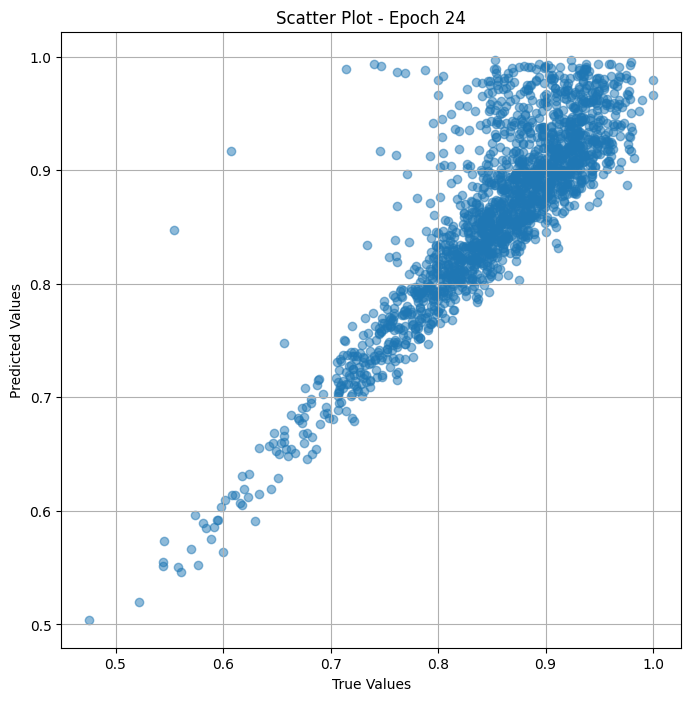

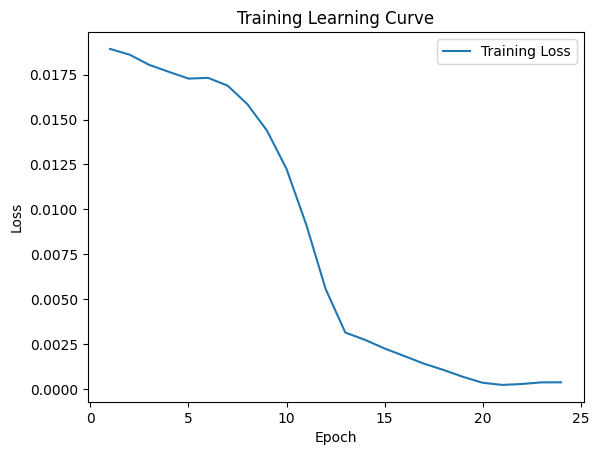


 Epoch: (25/50) Loss = 0.0004192361666355282

 Epoch: (25/50) Loss_rmse = 0.02047525718808174

 Epoch: (25/50) R^2 = 0.9171380400657654

 Epoch: (25/50) MAE = 0.016313478350639343
Spearman correlation coefficient: SignificanceResult(statistic=0.8259428049716508, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

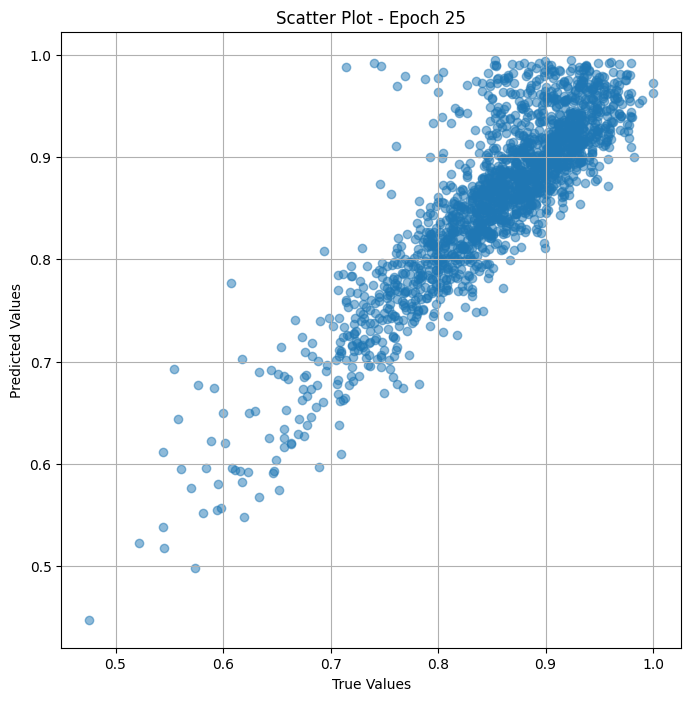

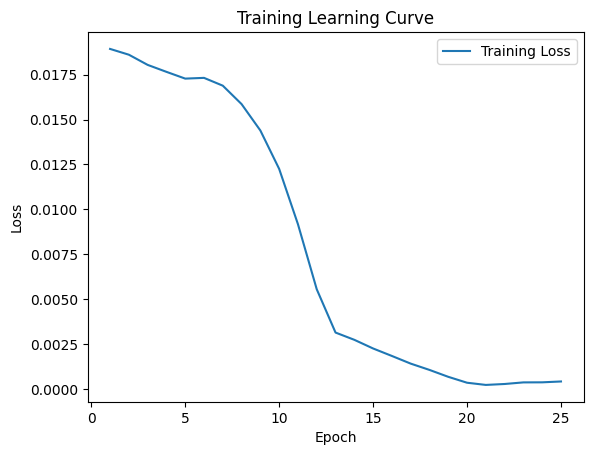


 Epoch: (26/50) Loss = 0.00027489152853377163

 Epoch: (26/50) Loss_rmse = 0.016579853370785713

 Epoch: (26/50) R^2 = 0.9456677436828613

 Epoch: (26/50) MAE = 0.014945633709430695
Spearman correlation coefficient: SignificanceResult(statistic=0.8339426204183571, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

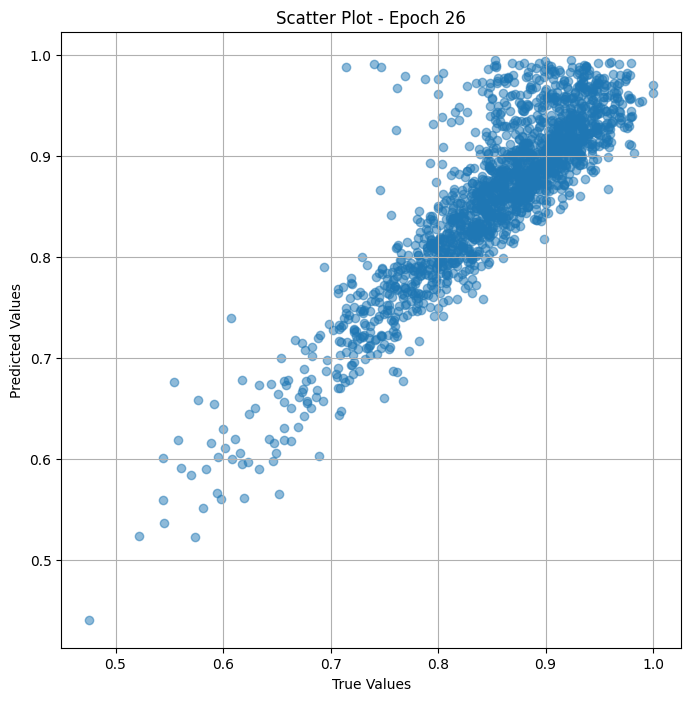

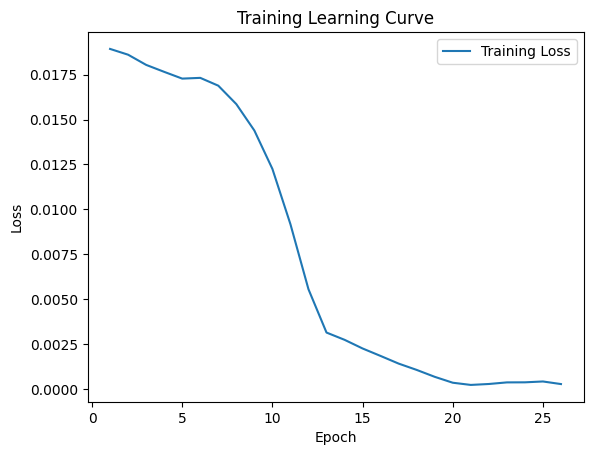


 Epoch: (27/50) Loss = 0.00019991380395367742

 Epoch: (27/50) Loss_rmse = 0.014139087870717049

 Epoch: (27/50) R^2 = 0.9604870676994324

 Epoch: (27/50) MAE = 0.013439491391181946
Spearman correlation coefficient: SignificanceResult(statistic=0.83864050717156, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

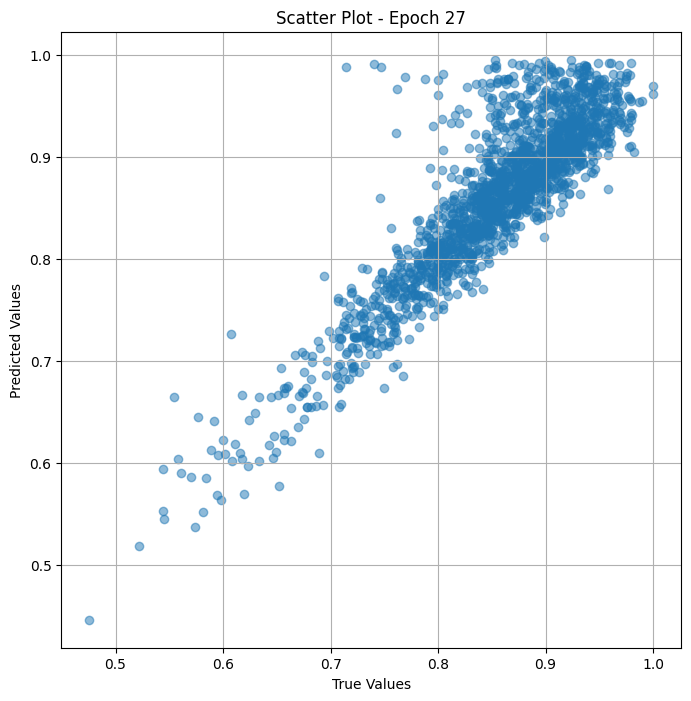

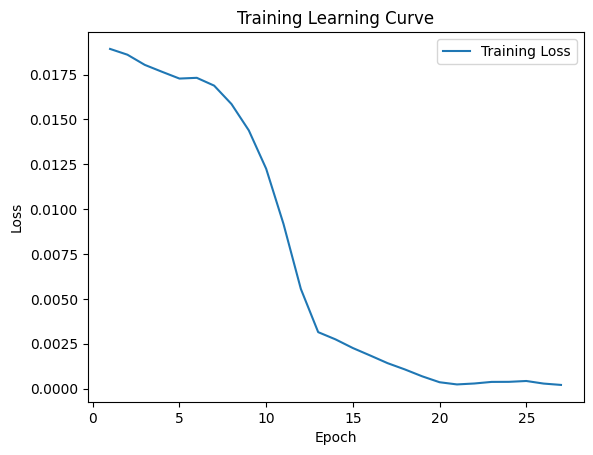


 Epoch: (28/50) Loss = 0.0001703350862953812

 Epoch: (28/50) Loss_rmse = 0.013051248155534267

 Epoch: (28/50) R^2 = 0.966333270072937

 Epoch: (28/50) MAE = 0.012266412377357483
Spearman correlation coefficient: SignificanceResult(statistic=0.8427055153139743, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

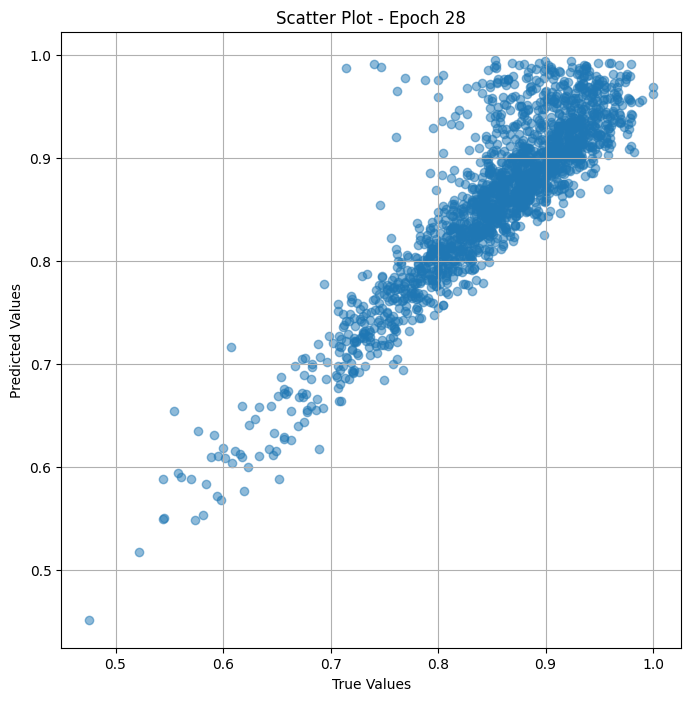

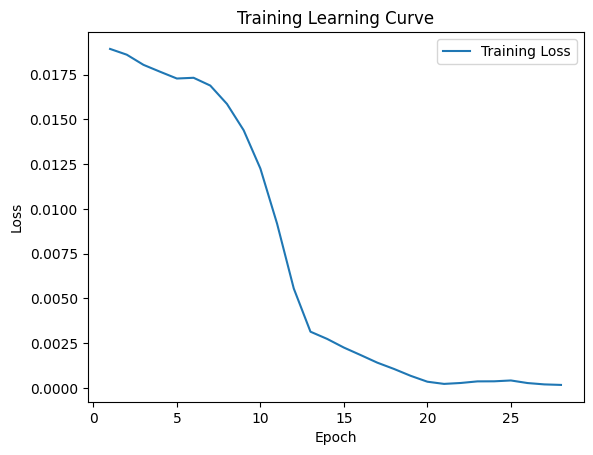


 Epoch: (29/50) Loss = 0.0001606155710760504

 Epoch: (29/50) Loss_rmse = 0.012673419900238514

 Epoch: (29/50) R^2 = 0.9682543277740479

 Epoch: (29/50) MAE = 0.011401869356632233
Spearman correlation coefficient: SignificanceResult(statistic=0.8461690319244615, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.8

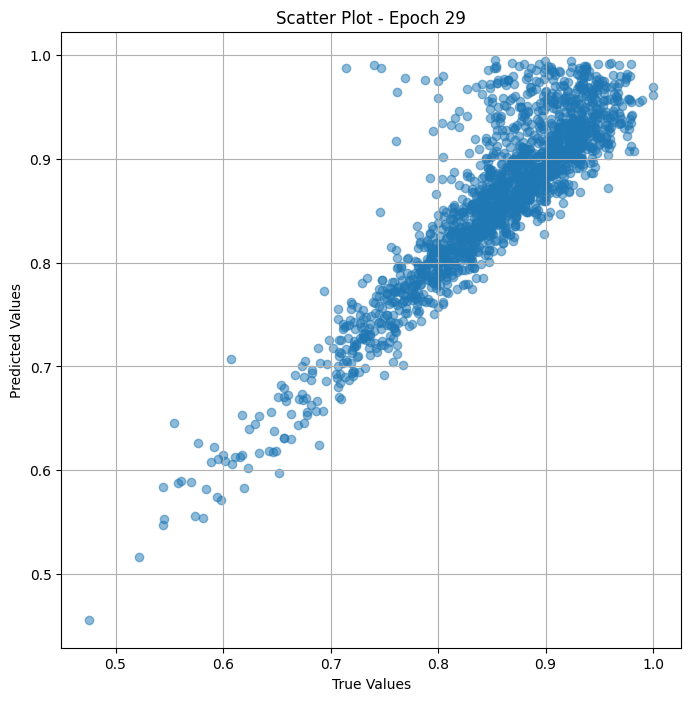

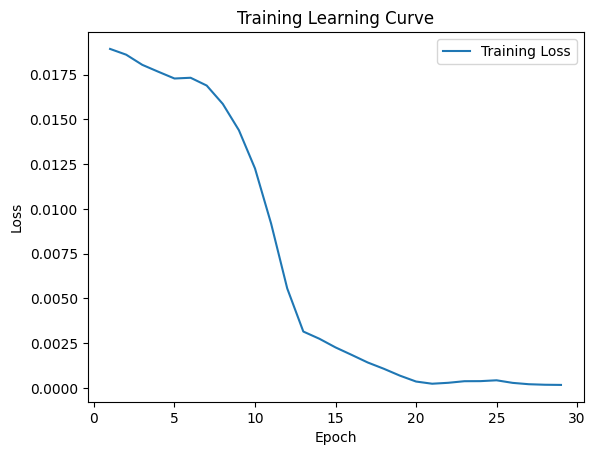


 Epoch: (30/50) Loss = 0.0001582670520292595

 Epoch: (30/50) Loss_rmse = 0.01258042361587286

 Epoch: (30/50) R^2 = 0.9687185287475586

 Epoch: (30/50) MAE = 0.011124029755592346
Spearman correlation coefficient: SignificanceResult(statistic=0.849405676169255, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87,

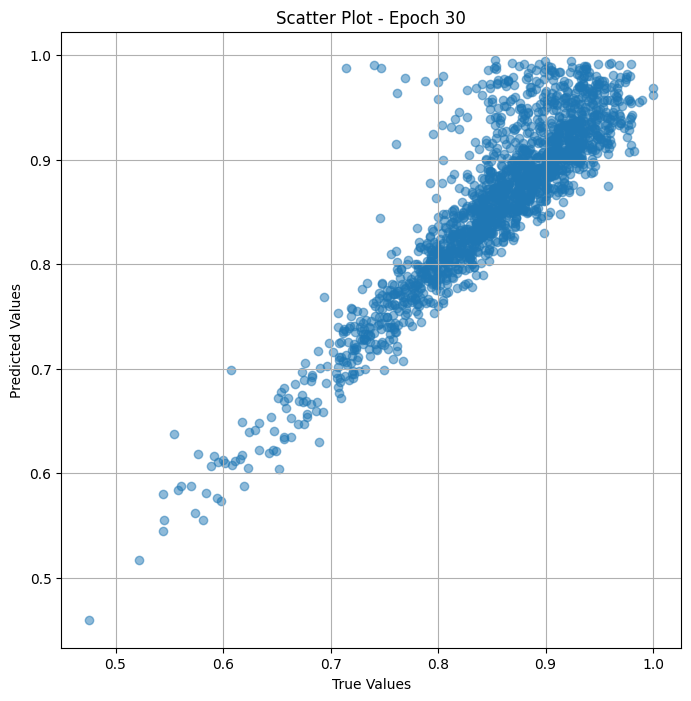

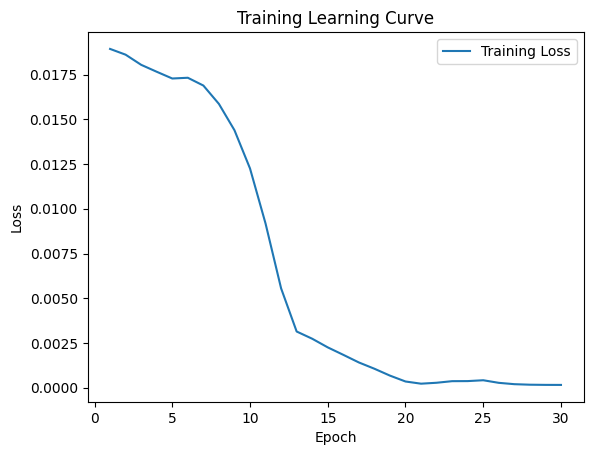


 Epoch: (31/50) Loss = 0.00015807579620741308

 Epoch: (31/50) Loss_rmse = 0.012572819367051125

 Epoch: (31/50) R^2 = 0.9687563180923462

 Epoch: (31/50) MAE = 0.011274196207523346
Spearman correlation coefficient: SignificanceResult(statistic=0.8523618910955687, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

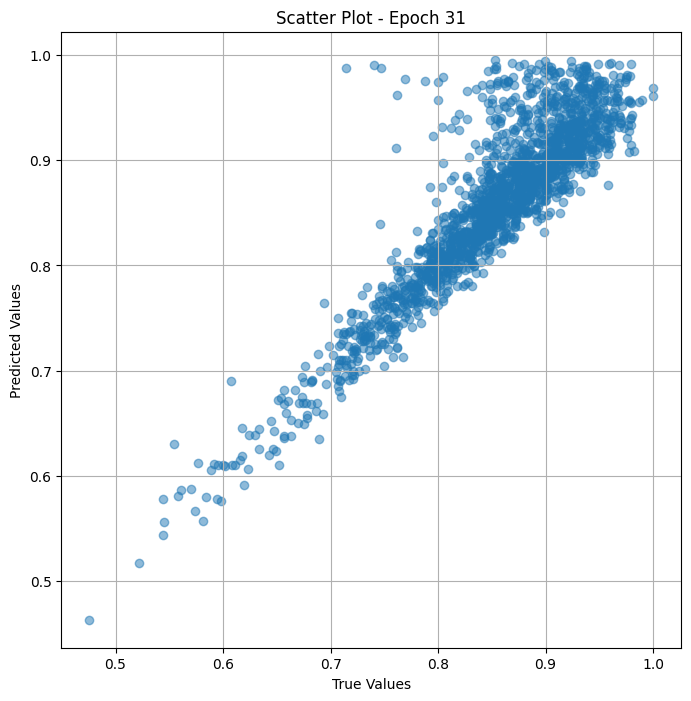

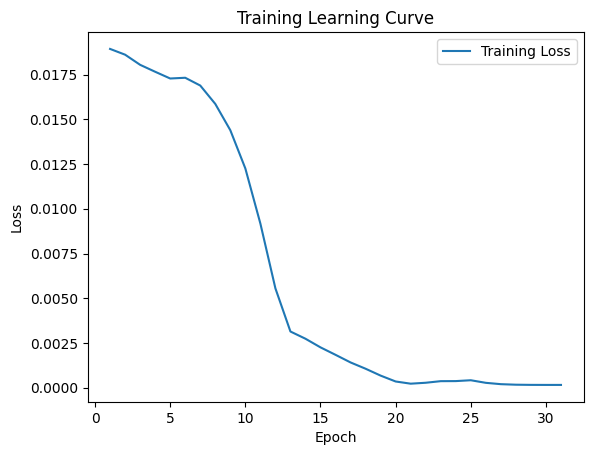


 Epoch: (32/50) Loss = 0.00015807090676389635

 Epoch: (32/50) Loss_rmse = 0.012572625651955605

 Epoch: (32/50) R^2 = 0.9687573313713074

 Epoch: (32/50) MAE = 0.011297732591629028
Spearman correlation coefficient: SignificanceResult(statistic=0.8551954100192598, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

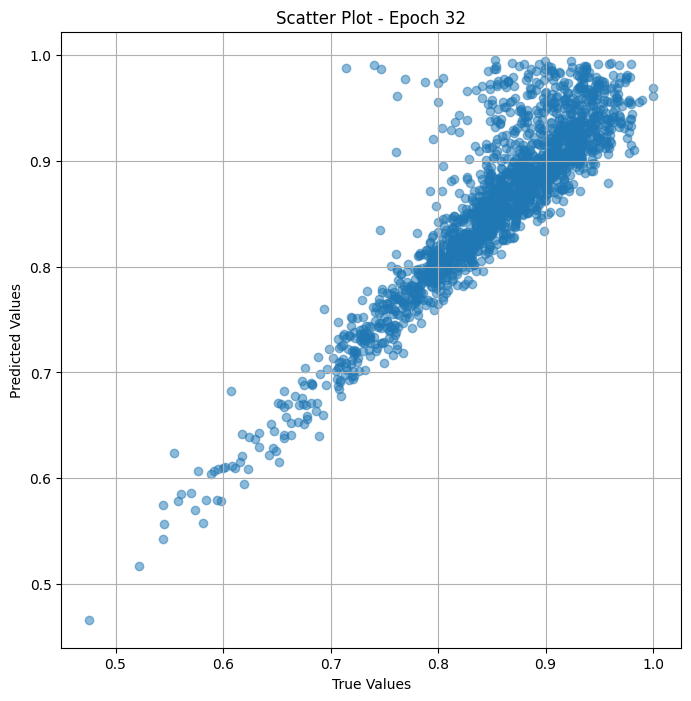

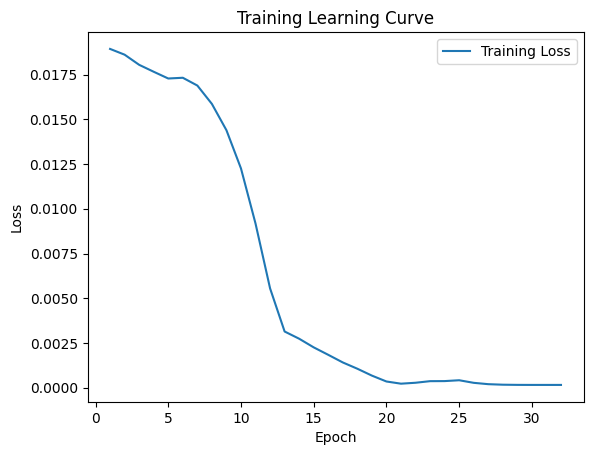


 Epoch: (33/50) Loss = 0.00015762625844217837

 Epoch: (33/50) Loss_rmse = 0.012554929591715336

 Epoch: (33/50) R^2 = 0.9688451886177063

 Epoch: (33/50) MAE = 0.011238016188144684
Spearman correlation coefficient: SignificanceResult(statistic=0.8578827595976646, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

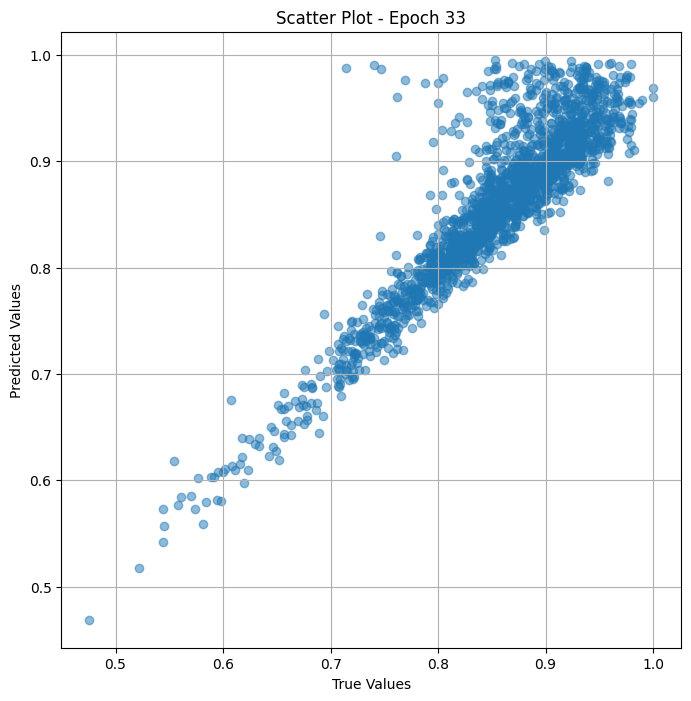

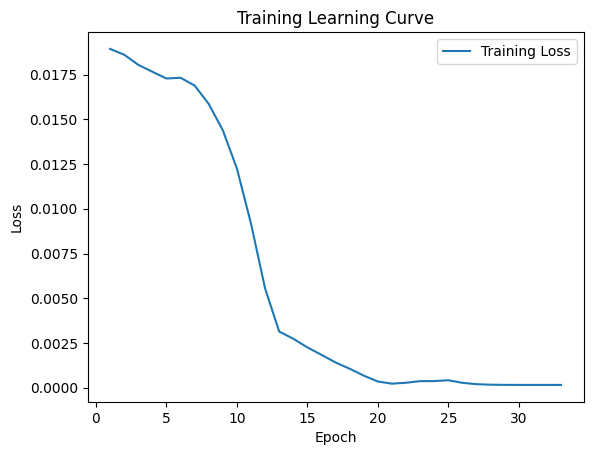


 Epoch: (34/50) Loss = 0.00015672955487389117

 Epoch: (34/50) Loss_rmse = 0.012519167736172676

 Epoch: (34/50) R^2 = 0.9690224528312683

 Epoch: (34/50) MAE = 0.011125251650810242
Spearman correlation coefficient: SignificanceResult(statistic=0.860563798162555, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.8

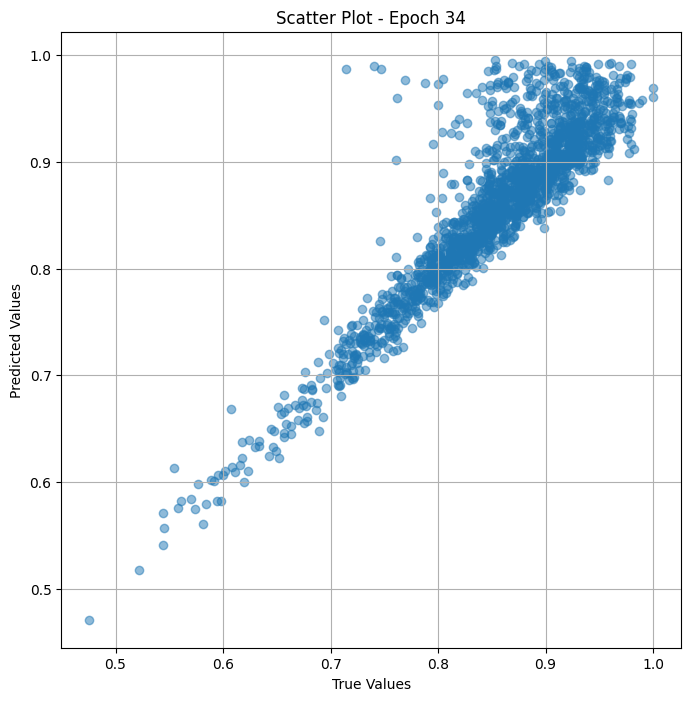

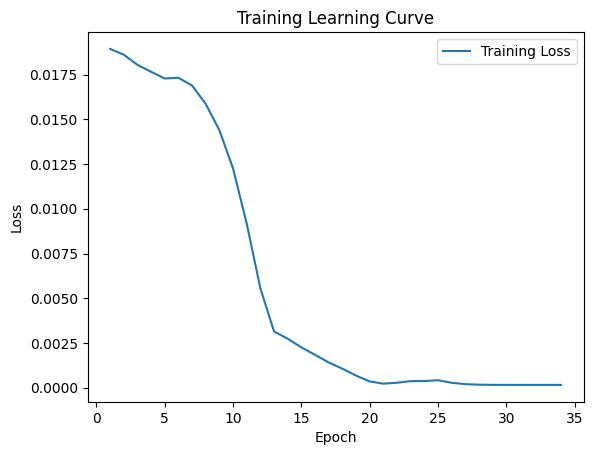


 Epoch: (35/50) Loss = 0.00015542263281531632

 Epoch: (35/50) Loss_rmse = 0.012466860935091972

 Epoch: (35/50) R^2 = 0.9692807197570801

 Epoch: (35/50) MAE = 0.01097910851240158
Spearman correlation coefficient: SignificanceResult(statistic=0.8631234743462589, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.8

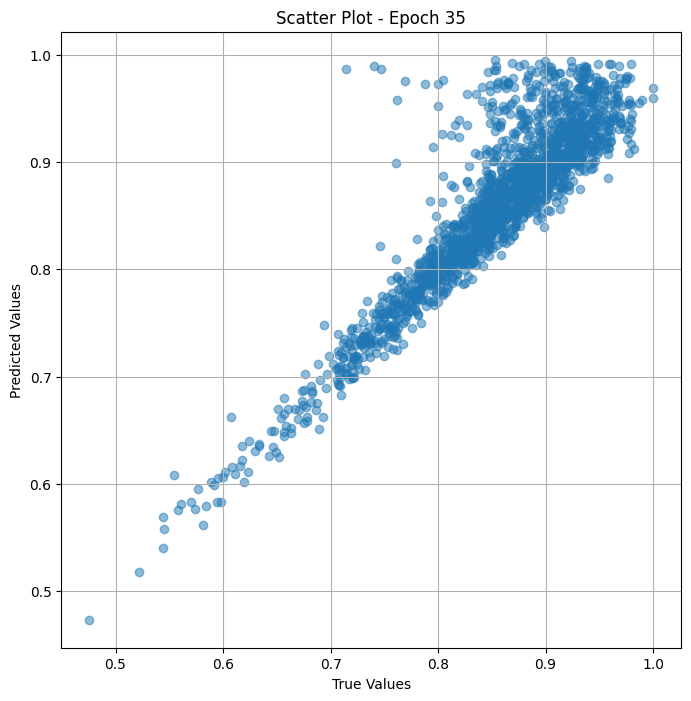

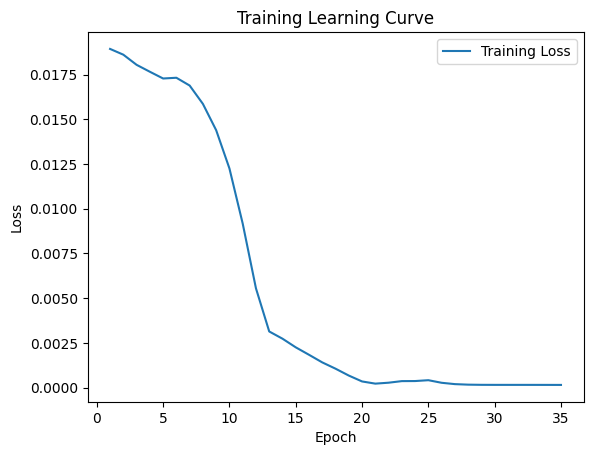


 Epoch: (36/50) Loss = 0.00015381246339529753

 Epoch: (36/50) Loss_rmse = 0.012402115389704704

 Epoch: (36/50) R^2 = 0.9695990085601807

 Epoch: (36/50) MAE = 0.010814383625984192
Spearman correlation coefficient: SignificanceResult(statistic=0.8656013149616878, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

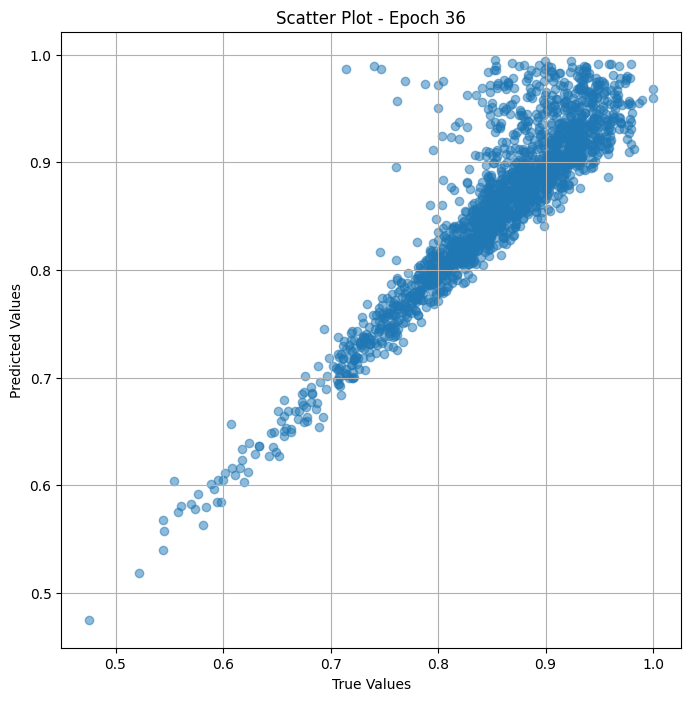

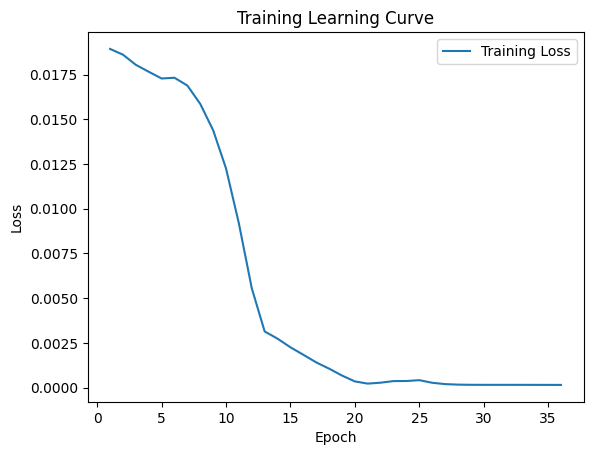


 Epoch: (37/50) Loss = 0.00015198317123577

 Epoch: (37/50) Loss_rmse = 0.01232814509421587

 Epoch: (37/50) R^2 = 0.9699605703353882

 Epoch: (37/50) MAE = 0.010635241866111755
Spearman correlation coefficient: SignificanceResult(statistic=0.8679682351997764, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 

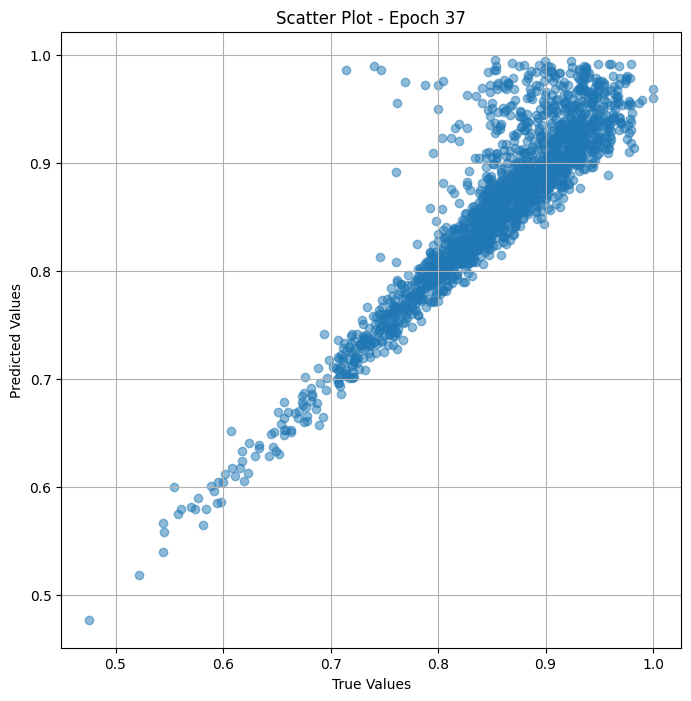

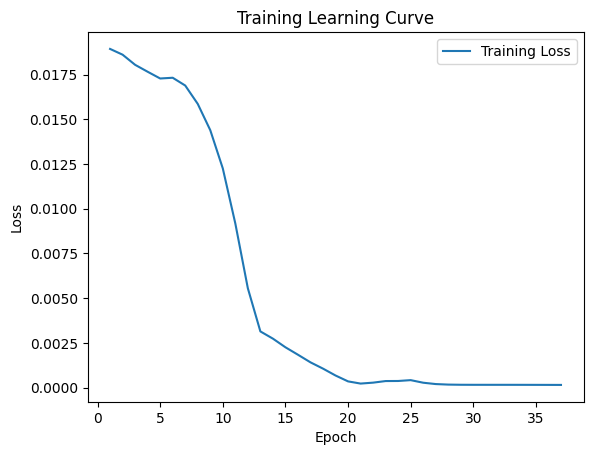


 Epoch: (38/50) Loss = 0.00014997839753050357

 Epoch: (38/50) Loss_rmse = 0.012246566824615002

 Epoch: (38/50) R^2 = 0.970356822013855

 Epoch: (38/50) MAE = 0.010449439287185669
Spearman correlation coefficient: SignificanceResult(statistic=0.8704301388283907, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.8

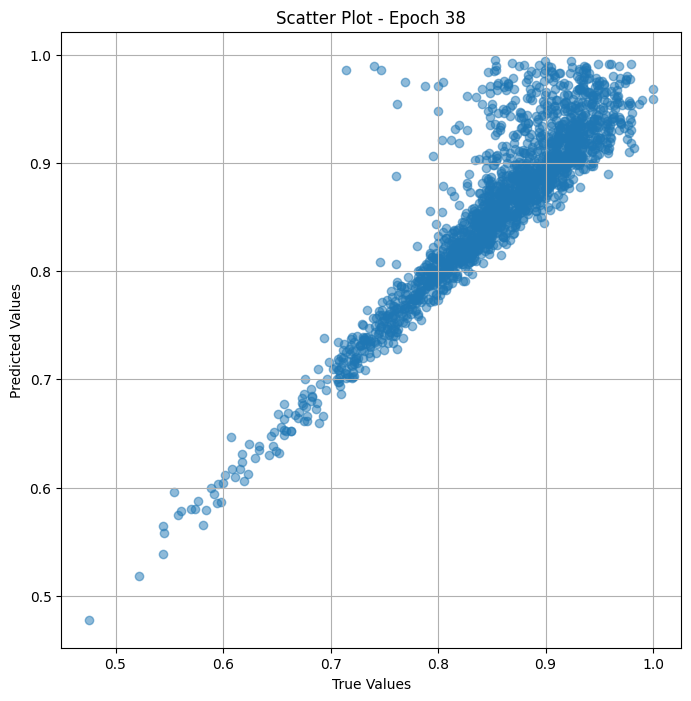

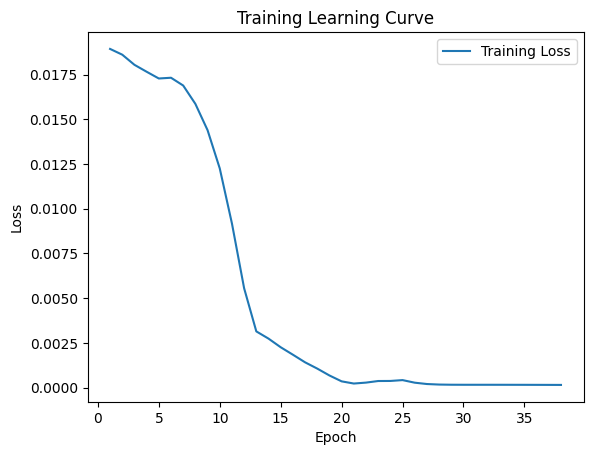


 Epoch: (39/50) Loss = 0.000147868282510899

 Epoch: (39/50) Loss_rmse = 0.012160110287368298

 Epoch: (39/50) R^2 = 0.9707738757133484

 Epoch: (39/50) MAE = 0.010260425508022308
Spearman correlation coefficient: SignificanceResult(statistic=0.8726960782829446, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

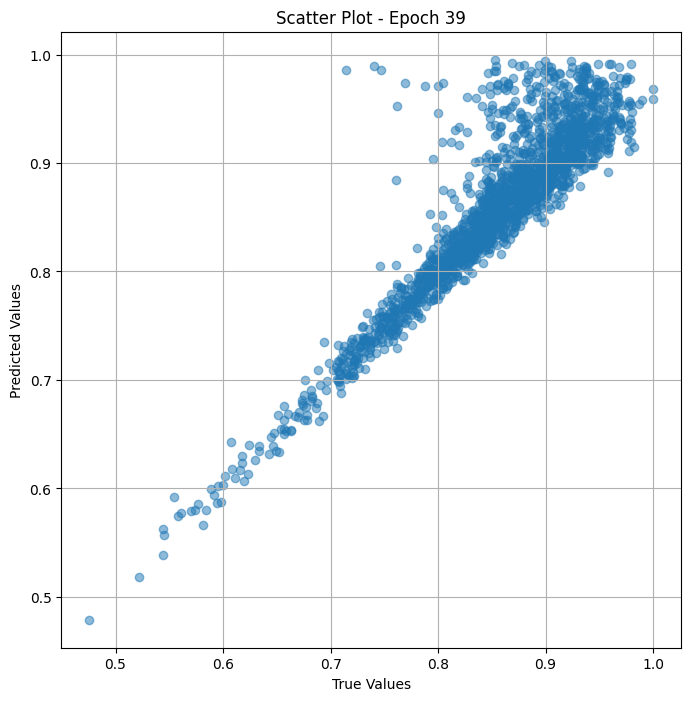

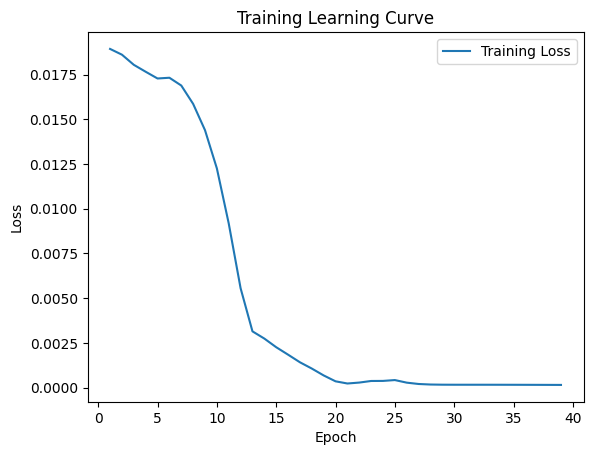


 Epoch: (40/50) Loss = 0.0001456507743569091

 Epoch: (40/50) Loss_rmse = 0.01206858642399311

 Epoch: (40/50) R^2 = 0.9712121486663818

 Epoch: (40/50) MAE = 0.010070793330669403
Spearman correlation coefficient: SignificanceResult(statistic=0.8751123639259142, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

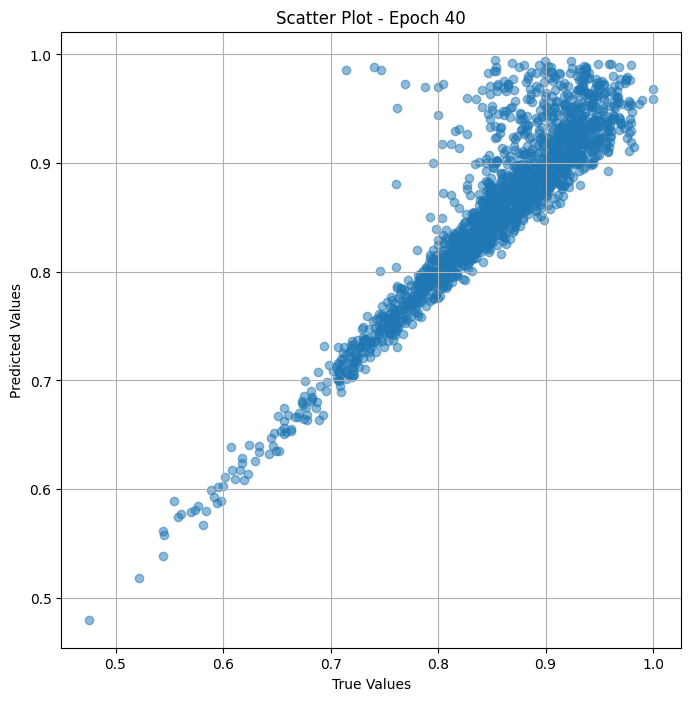

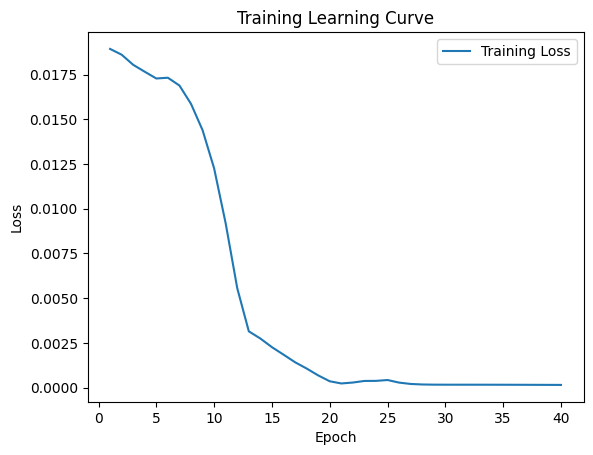


 Epoch: (41/50) Loss = 0.00014337117318063974

 Epoch: (41/50) Loss_rmse = 0.011973770335316658

 Epoch: (41/50) R^2 = 0.971662700176239

 Epoch: (41/50) MAE = 0.00988016277551651
Spearman correlation coefficient: SignificanceResult(statistic=0.8773893054966818, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

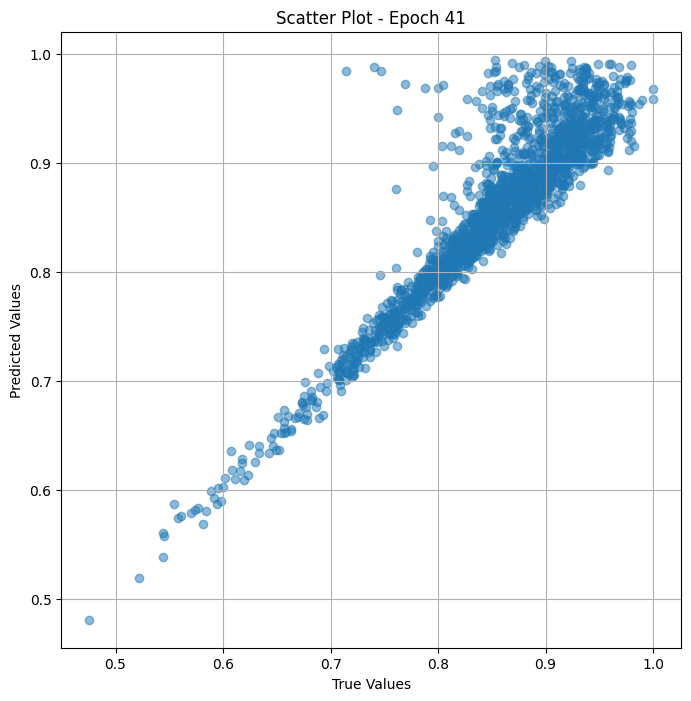

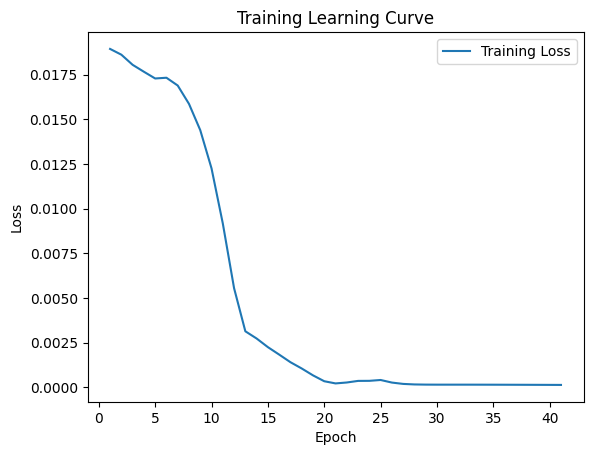


 Epoch: (42/50) Loss = 0.00014101926353760064

 Epoch: (42/50) Loss_rmse = 0.0118751535192132

 Epoch: (42/50) R^2 = 0.9721275568008423

 Epoch: (42/50) MAE = 0.009692110121250153
Spearman correlation coefficient: SignificanceResult(statistic=0.8796804458842421, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

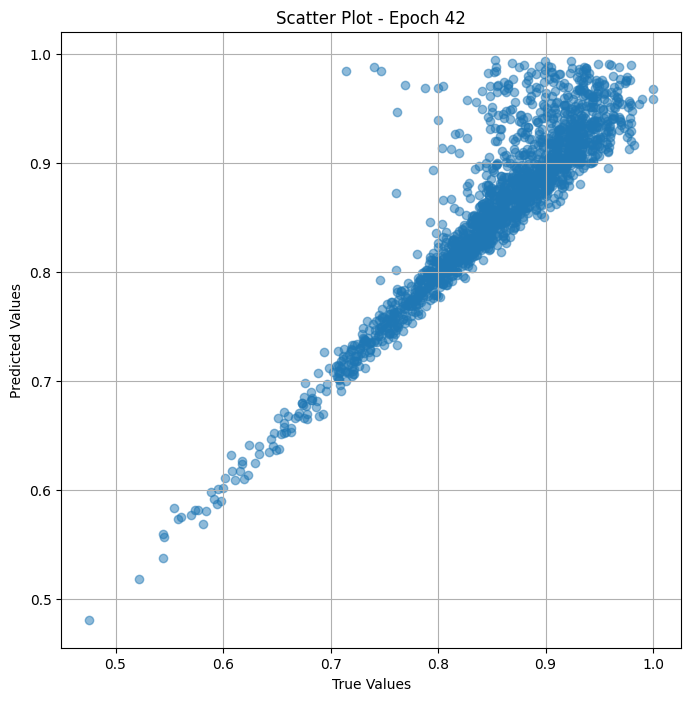

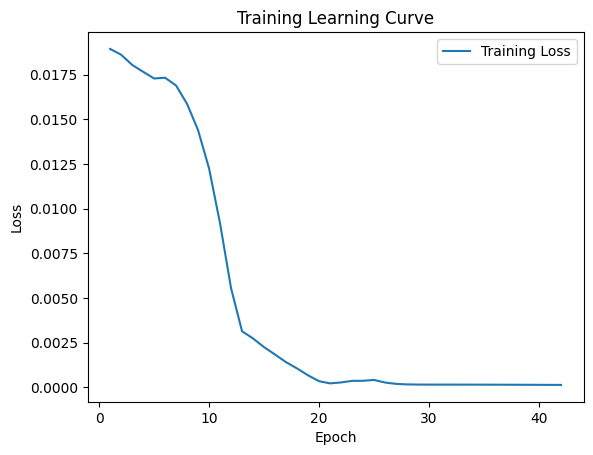


 Epoch: (43/50) Loss = 0.00013859815953765064

 Epoch: (43/50) Loss_rmse = 0.011772772297263145

 Epoch: (43/50) R^2 = 0.9726061224937439

 Epoch: (43/50) MAE = 0.009504370391368866
Spearman correlation coefficient: SignificanceResult(statistic=0.8818911541139951, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

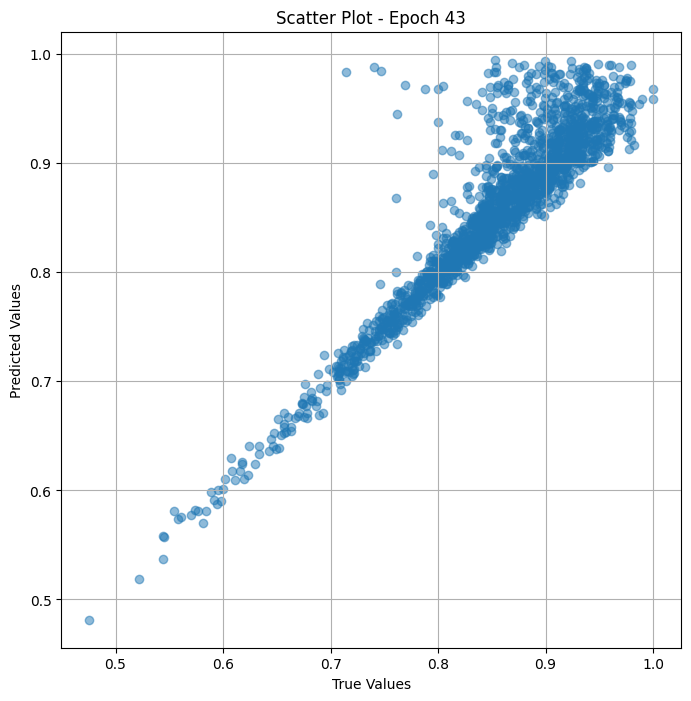

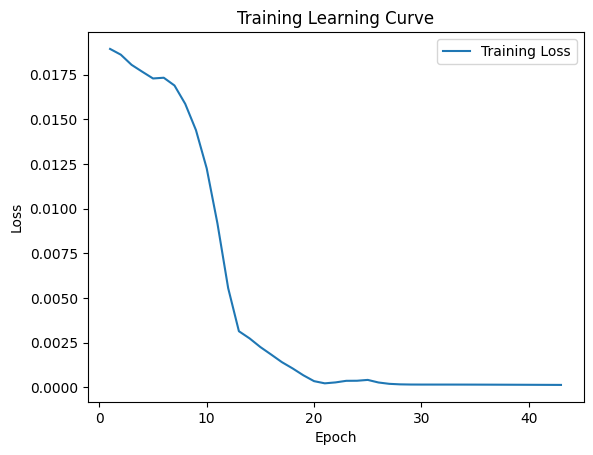


 Epoch: (44/50) Loss = 0.00013608139124698937

 Epoch: (44/50) Loss_rmse = 0.01166539266705513

 Epoch: (44/50) R^2 = 0.9731035232543945

 Epoch: (44/50) MAE = 0.009334228932857513
Spearman correlation coefficient: SignificanceResult(statistic=0.8841489505332024, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.8

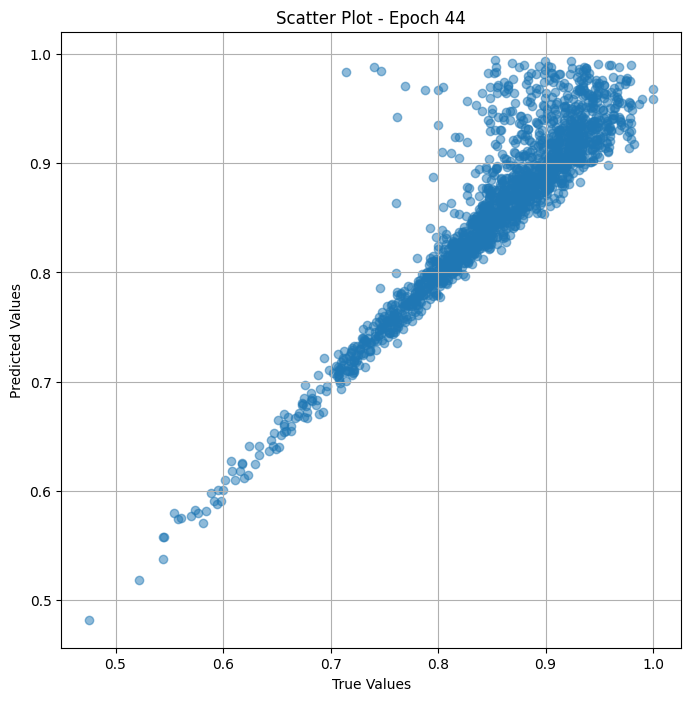

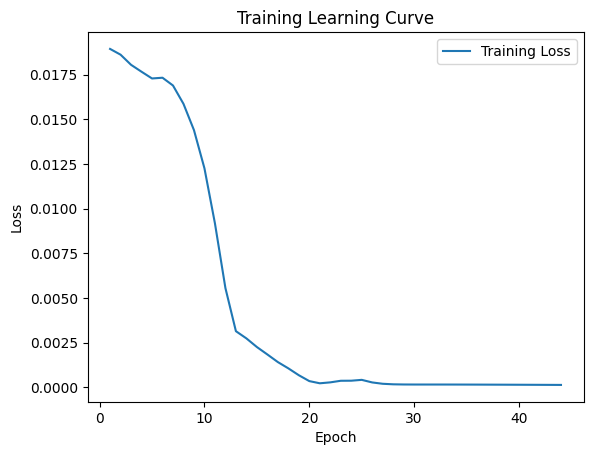


 Epoch: (45/50) Loss = 0.00013350222434382886

 Epoch: (45/50) Loss_rmse = 0.011554316617548466

 Epoch: (45/50) R^2 = 0.9736133217811584

 Epoch: (45/50) MAE = 0.009219244122505188
Spearman correlation coefficient: SignificanceResult(statistic=0.8863393614824072, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

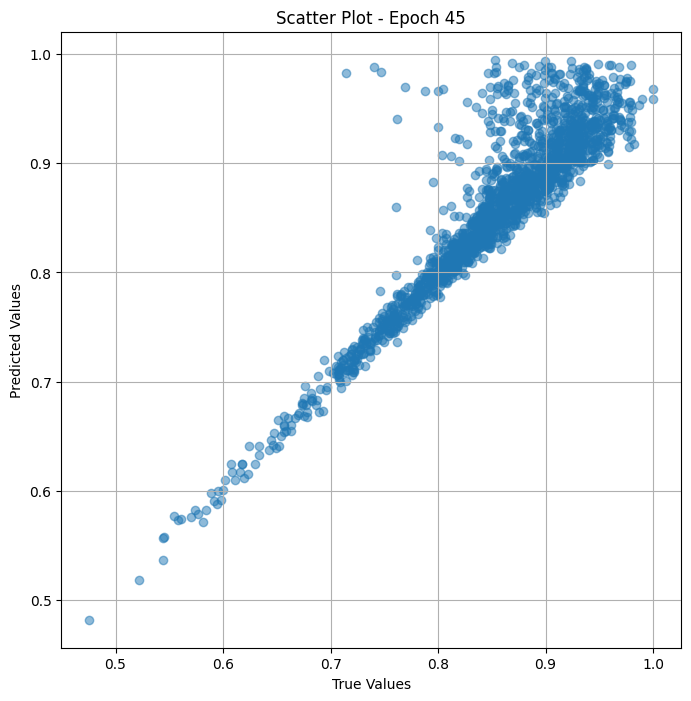

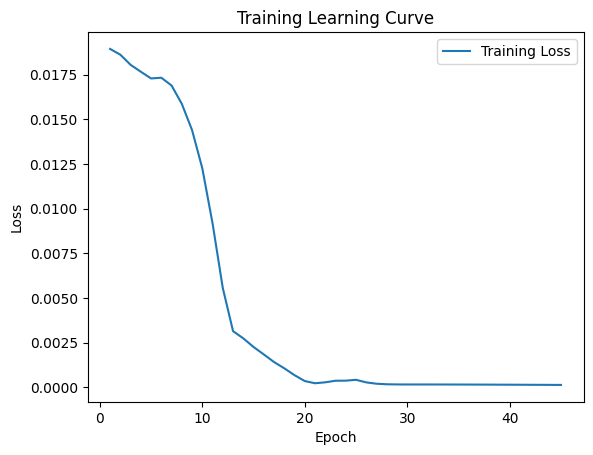


 Epoch: (46/50) Loss = 0.00013087663683108985

 Epoch: (46/50) Loss_rmse = 0.01144013274461031

 Epoch: (46/50) R^2 = 0.974132239818573

 Epoch: (46/50) MAE = 0.009100399911403656
Spearman correlation coefficient: SignificanceResult(statistic=0.8885723991188593, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87

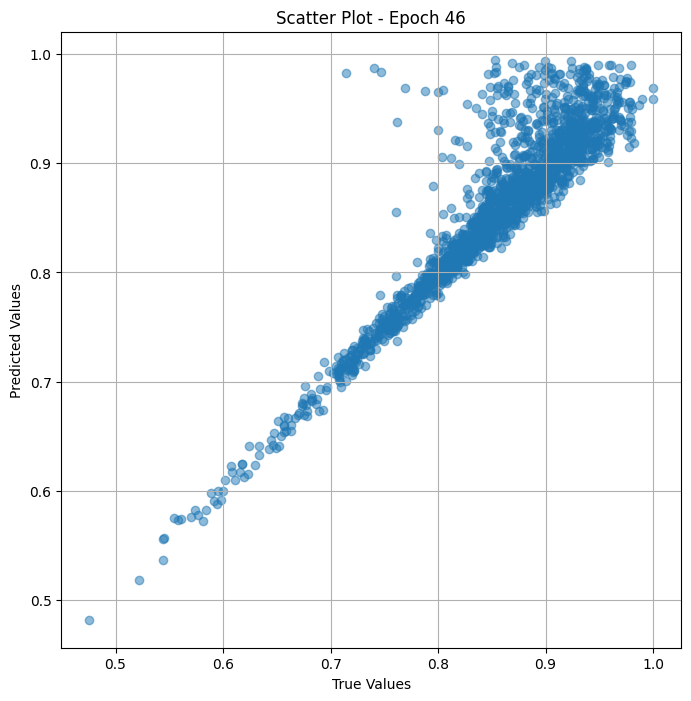

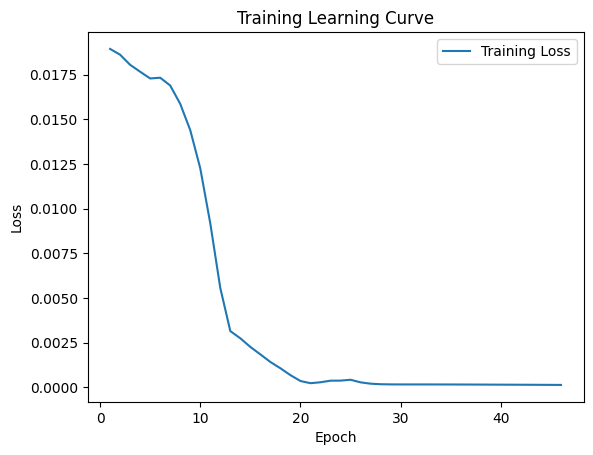


 Epoch: (47/50) Loss = 0.00012817999231629074

 Epoch: (47/50) Loss_rmse = 0.01132166013121605

 Epoch: (47/50) R^2 = 0.9746652245521545

 Epoch: (47/50) MAE = 0.008976176381111145
Spearman correlation coefficient: SignificanceResult(statistic=0.8908597608835008, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.8

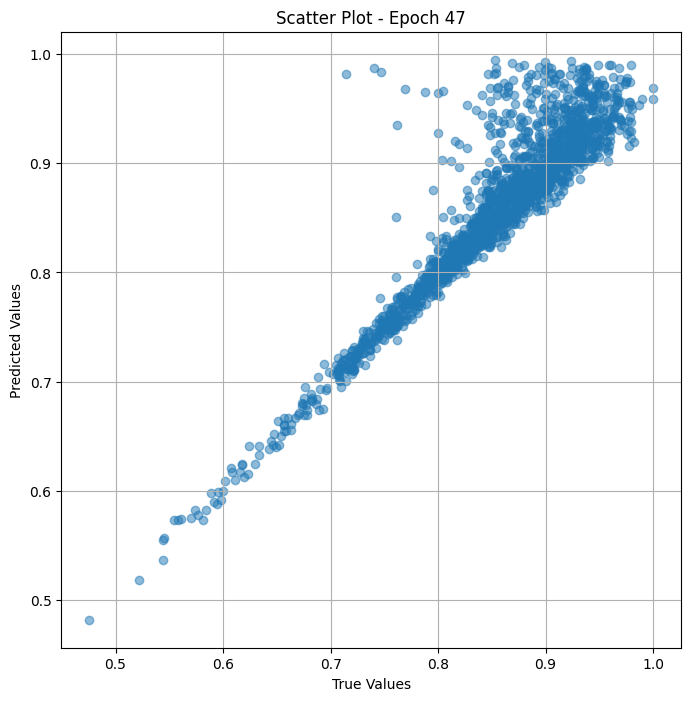

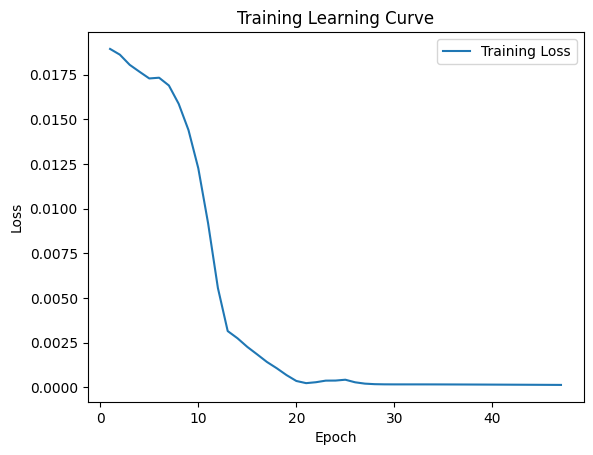


 Epoch: (48/50) Loss = 0.00012539909221231937

 Epoch: (48/50) Loss_rmse = 0.011198173277080059

 Epoch: (48/50) R^2 = 0.9752148985862732

 Epoch: (48/50) MAE = 0.008846819400787354
Spearman correlation coefficient: SignificanceResult(statistic=0.8931567891762808, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

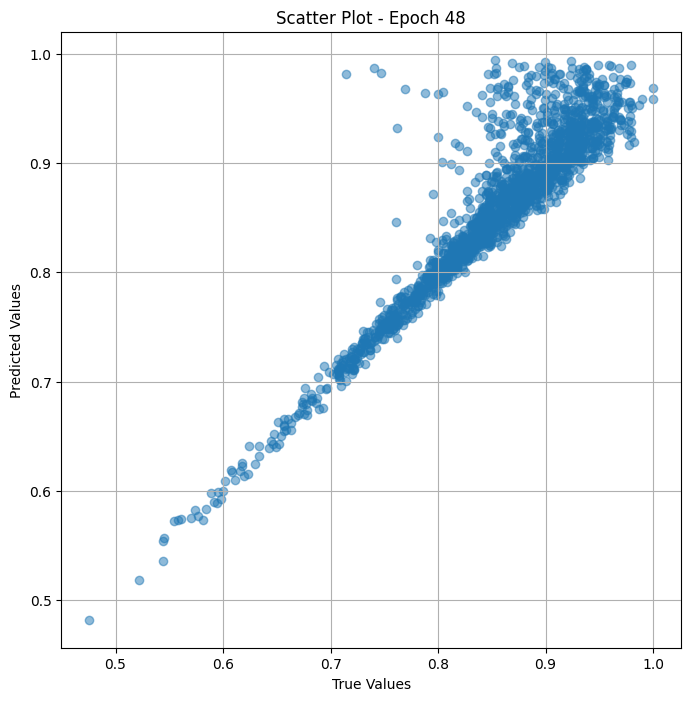

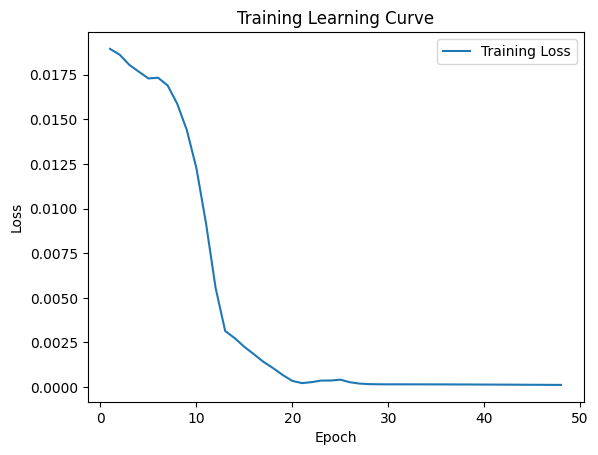


 Epoch: (49/50) Loss = 0.00012254691682755947

 Epoch: (49/50) Loss_rmse = 0.011070091277360916

 Epoch: (49/50) R^2 = 0.9757786393165588

 Epoch: (49/50) MAE = 0.008713200688362122
Spearman correlation coefficient: SignificanceResult(statistic=0.8953445142573655, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

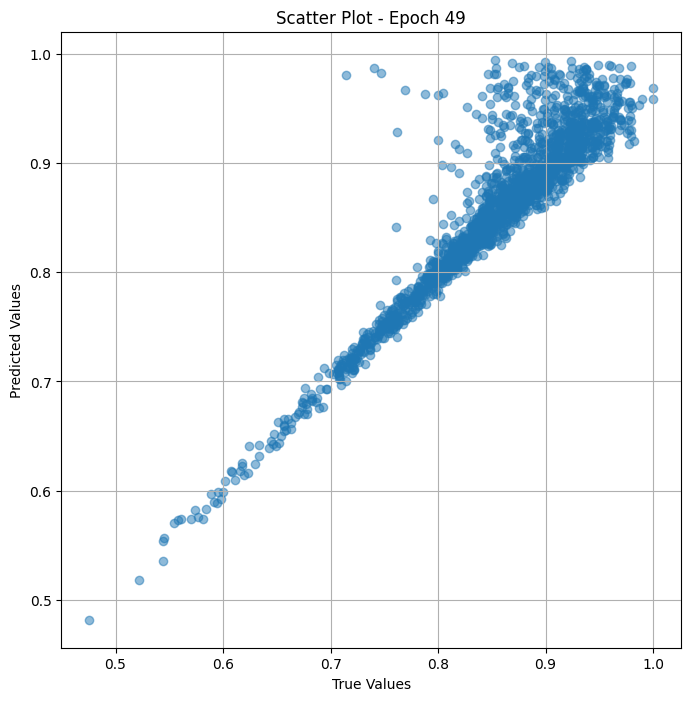

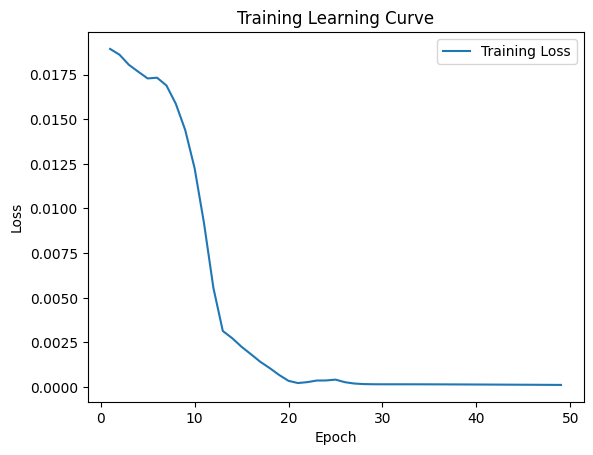


 Epoch: (50/50) Loss = 0.00011964097211603075

 Epoch: (50/50) Loss_rmse = 0.010938051156699657

 Epoch: (50/50) R^2 = 0.9763529896736145

 Epoch: (50/50) MAE = 0.008577883243560791
Spearman correlation coefficient: SignificanceResult(statistic=0.8976162039967199, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.

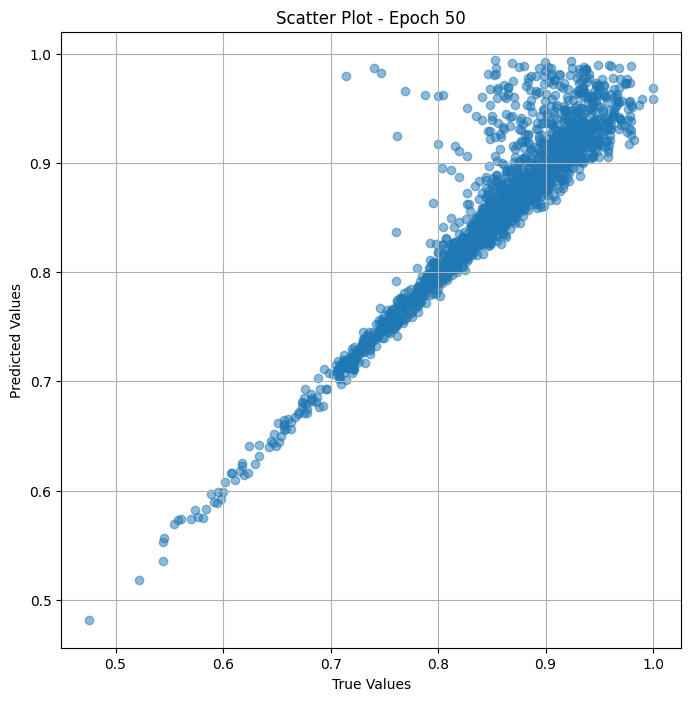

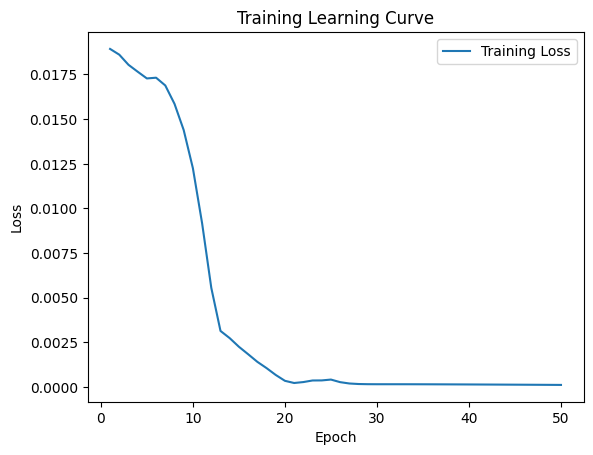

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S")

## Valid

In [ ]:
class Dataset_val(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_val(df_val_food, trans_transform=trans_transform, res_transform=res_transform)
train_dl_val = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_val = model_merge_val(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
model_val = to_device(model_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.03701549395918846

 Epoch: (1/50) Loss_rmse = 0.19239410758018494

 Epoch: (1/50) R^2 = -1.9556353092193604

 Epoch: (1/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=0.016718869495084273, pvalue=0.8715608171242741)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.7

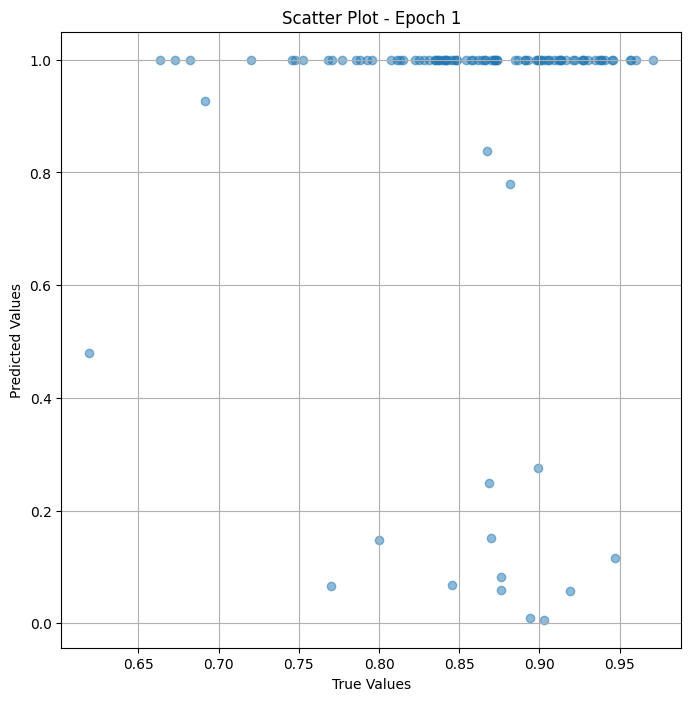

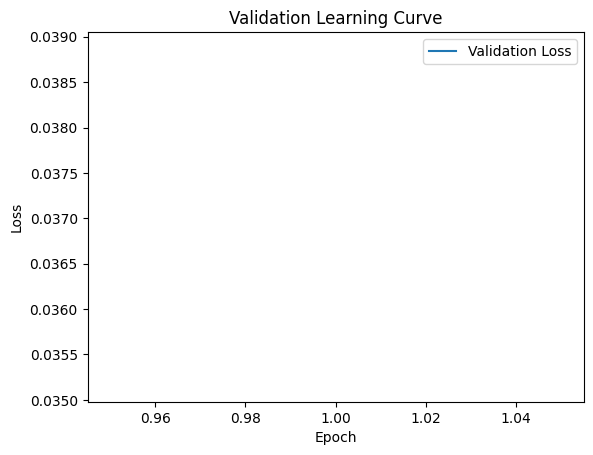

/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:5445: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))



 Epoch: (2/50) Loss = 0.03701549395918846

 Epoch: (2/50) Loss_rmse = 0.19239410758018494

 Epoch: (2/50) R^2 = -1.9556353092193604

 Epoch: (2/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

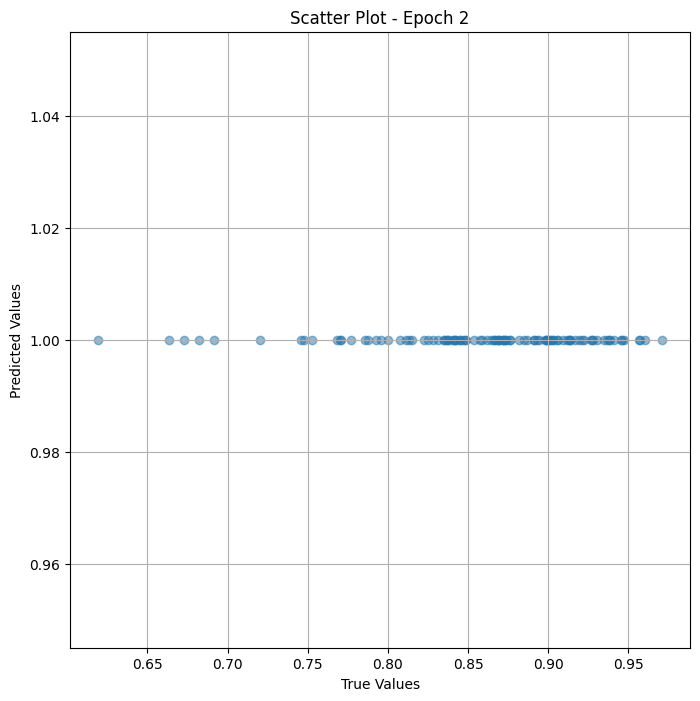

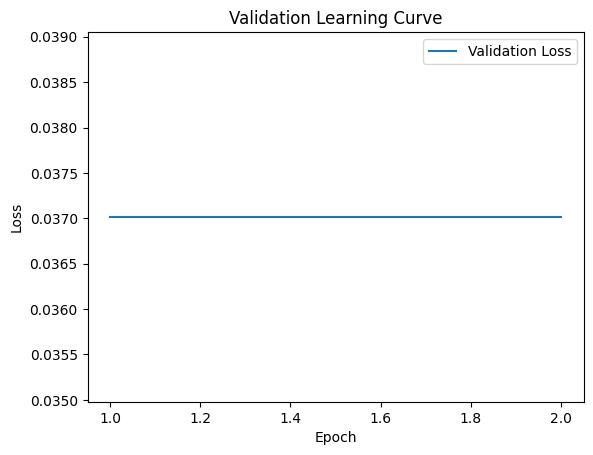


 Epoch: (3/50) Loss = 0.03701549395918846

 Epoch: (3/50) Loss_rmse = 0.19239410758018494

 Epoch: (3/50) R^2 = -1.9556353092193604

 Epoch: (3/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

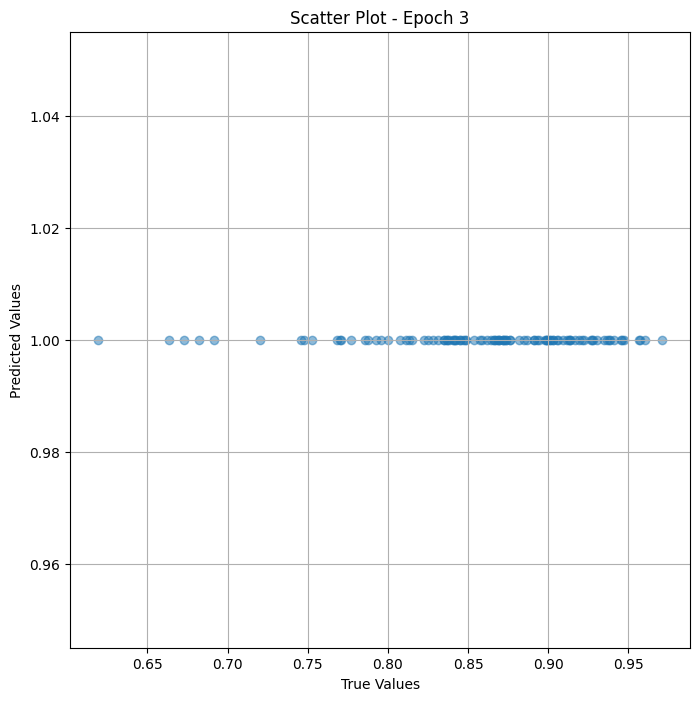

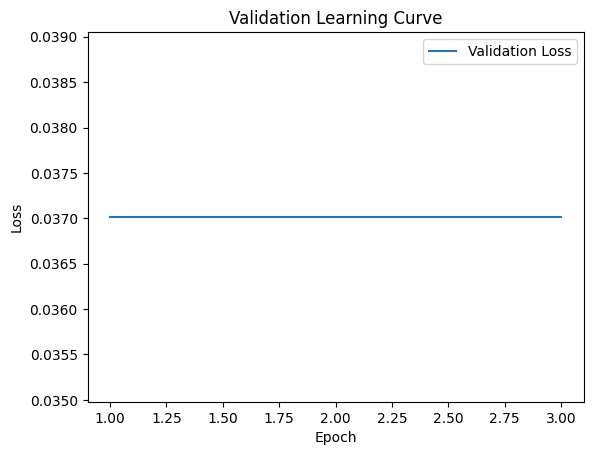


 Epoch: (4/50) Loss = 0.03701549395918846

 Epoch: (4/50) Loss_rmse = 0.19239410758018494

 Epoch: (4/50) R^2 = -1.9556353092193604

 Epoch: (4/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

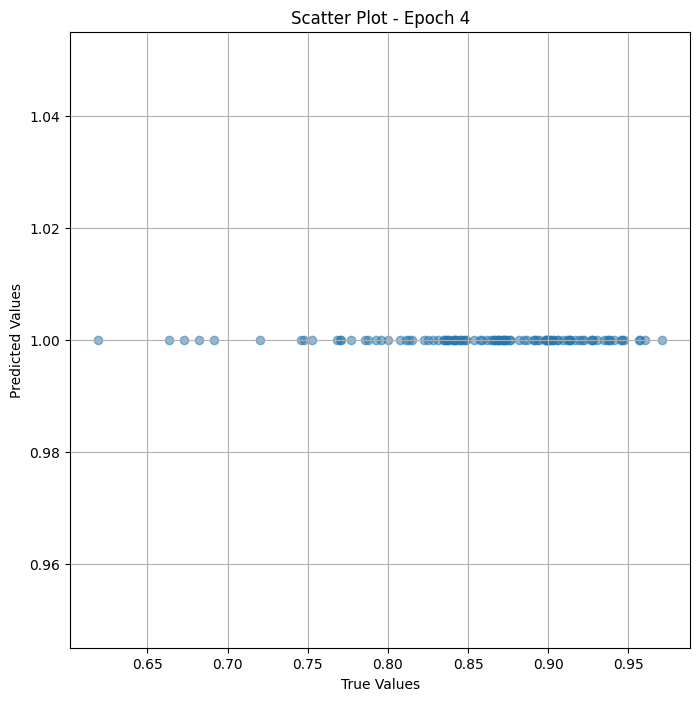

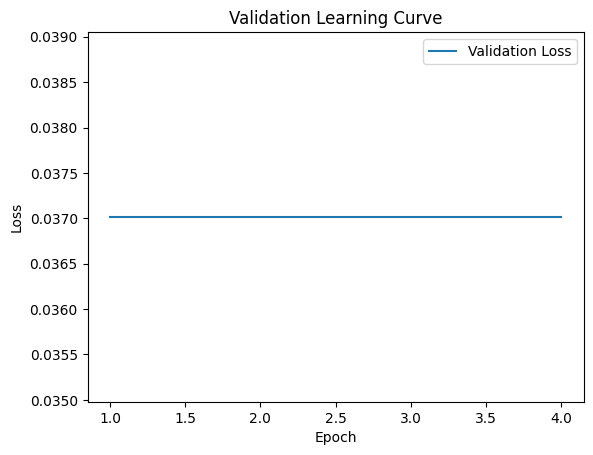


 Epoch: (5/50) Loss = 0.03701549395918846

 Epoch: (5/50) Loss_rmse = 0.19239410758018494

 Epoch: (5/50) R^2 = -1.9556353092193604

 Epoch: (5/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

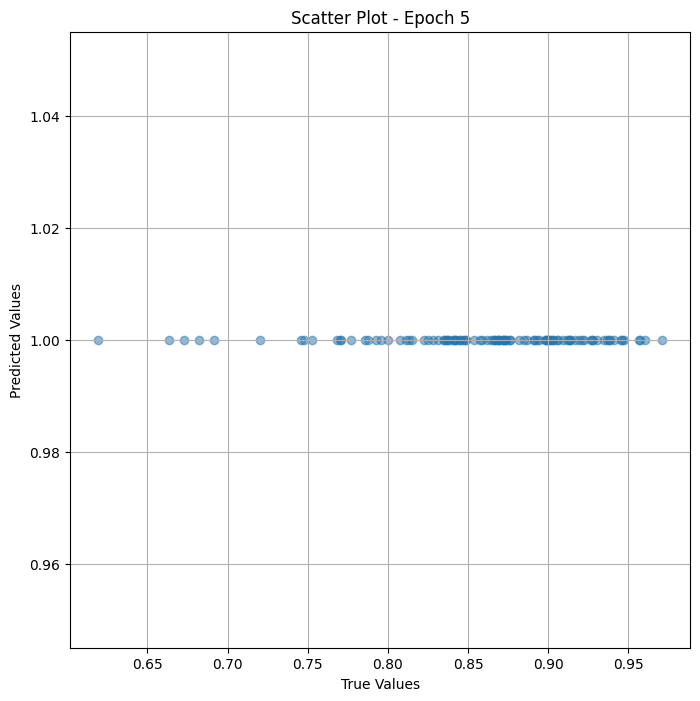

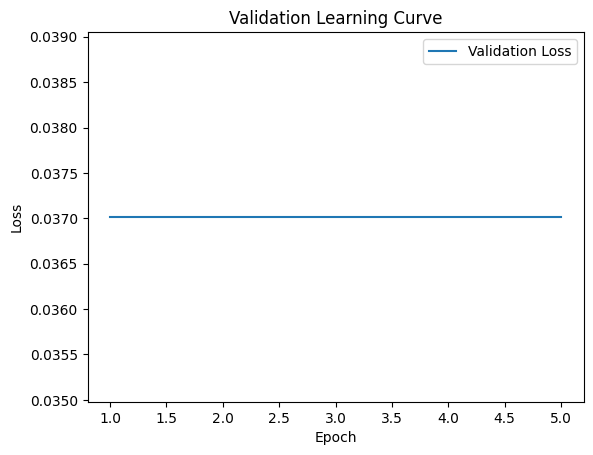


 Epoch: (6/50) Loss = 0.03701549395918846

 Epoch: (6/50) Loss_rmse = 0.19239410758018494

 Epoch: (6/50) R^2 = -1.9556353092193604

 Epoch: (6/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

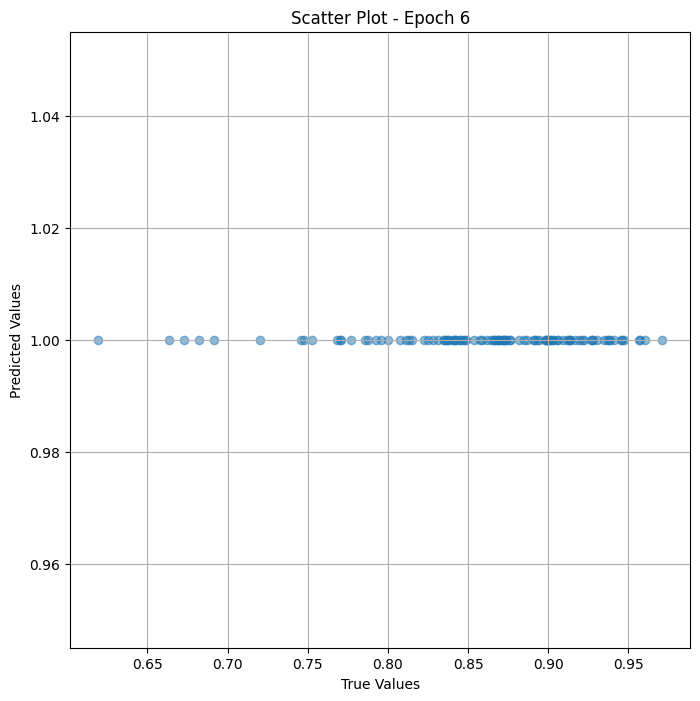

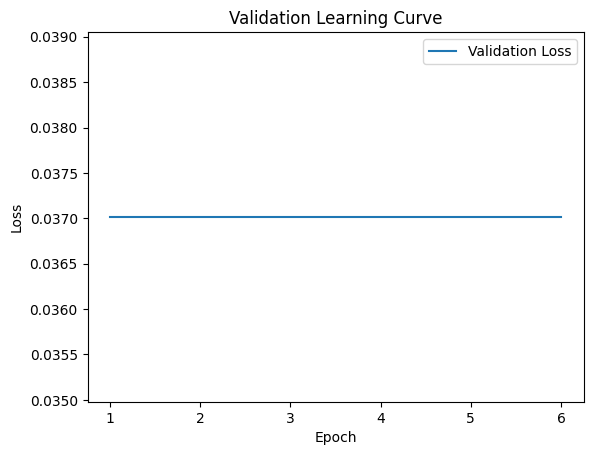


 Epoch: (7/50) Loss = 0.03701549395918846

 Epoch: (7/50) Loss_rmse = 0.19239410758018494

 Epoch: (7/50) R^2 = -1.9556353092193604

 Epoch: (7/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

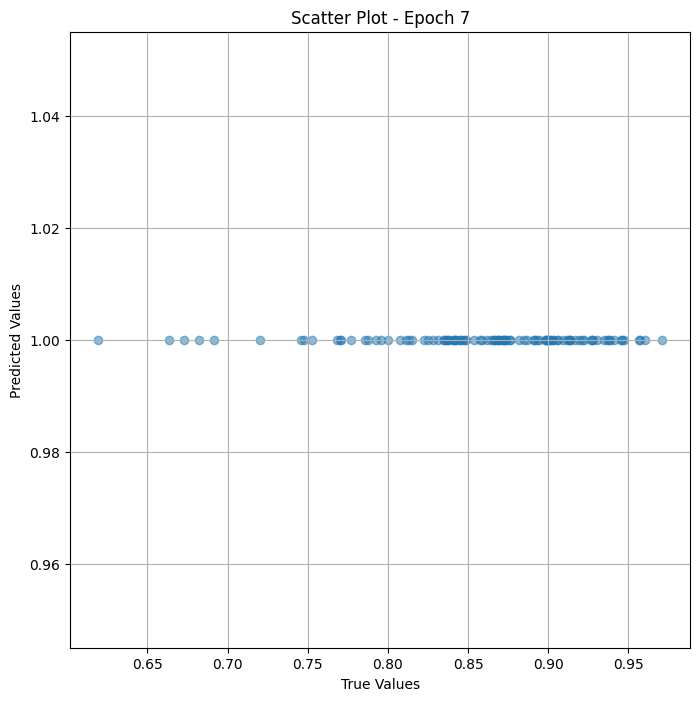

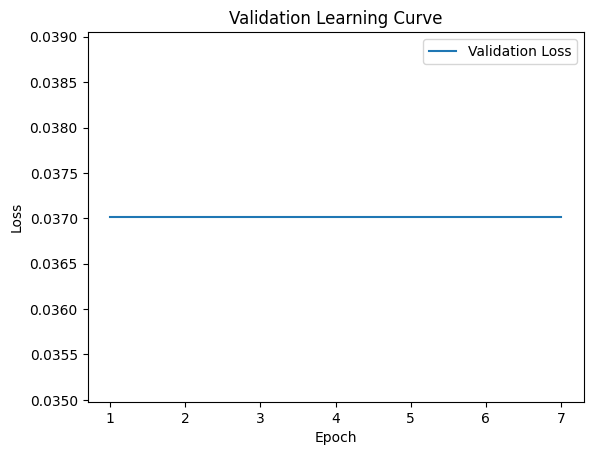


 Epoch: (8/50) Loss = 0.03701549395918846

 Epoch: (8/50) Loss_rmse = 0.19239410758018494

 Epoch: (8/50) R^2 = -1.9556353092193604

 Epoch: (8/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

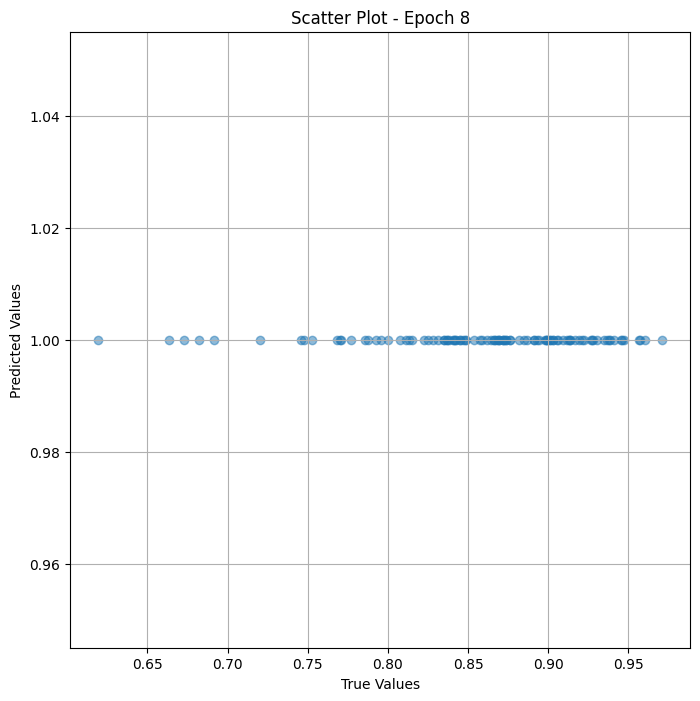

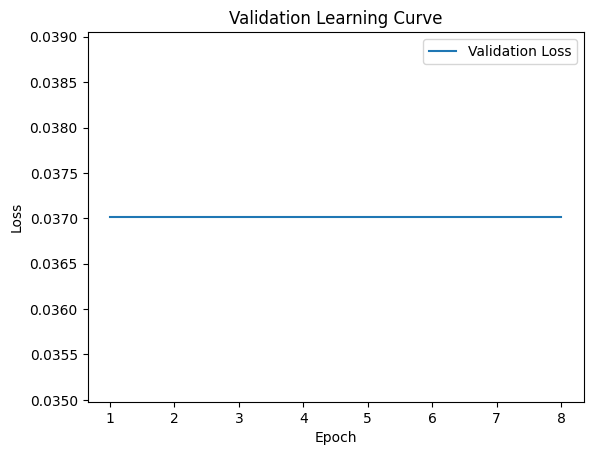


 Epoch: (9/50) Loss = 0.03701549395918846

 Epoch: (9/50) Loss_rmse = 0.19239410758018494

 Epoch: (9/50) R^2 = -1.9556353092193604

 Epoch: (9/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 

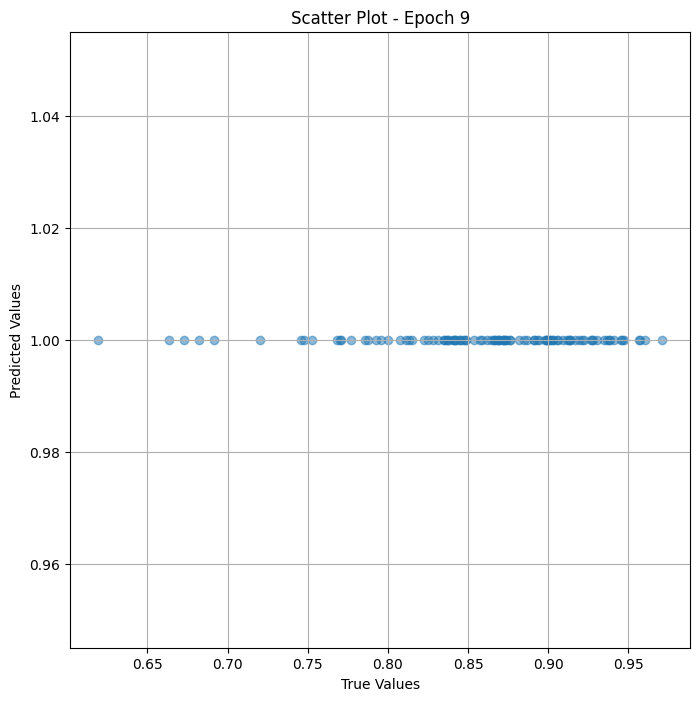

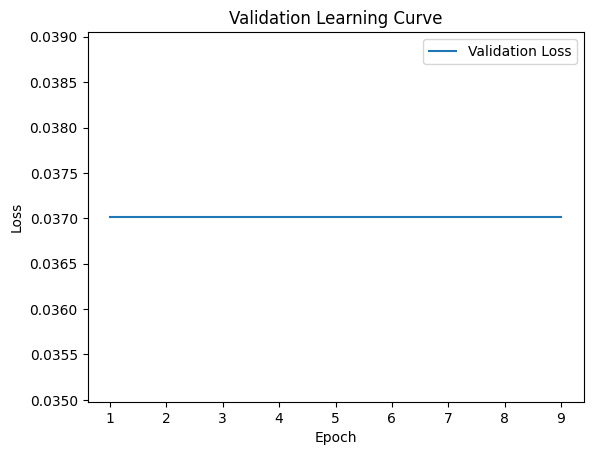


 Epoch: (10/50) Loss = 0.03701549395918846

 Epoch: (10/50) Loss_rmse = 0.19239410758018494

 Epoch: (10/50) R^2 = -1.9556353092193604

 Epoch: (10/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

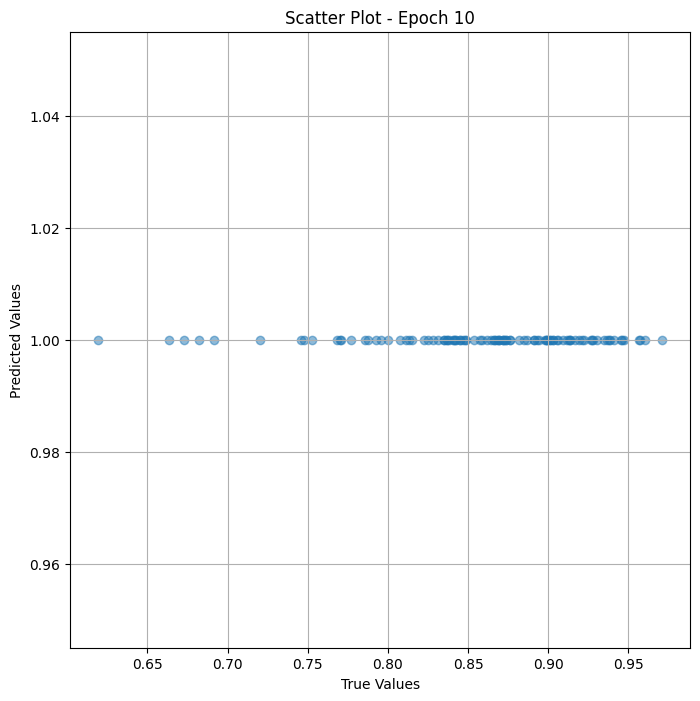

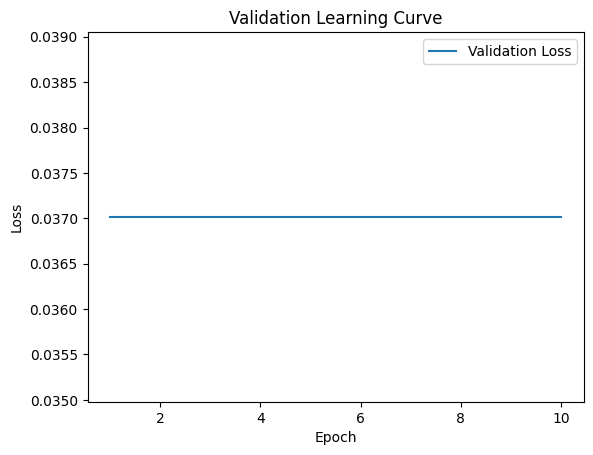


 Epoch: (11/50) Loss = 0.03701549395918846

 Epoch: (11/50) Loss_rmse = 0.19239410758018494

 Epoch: (11/50) R^2 = -1.9556353092193604

 Epoch: (11/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

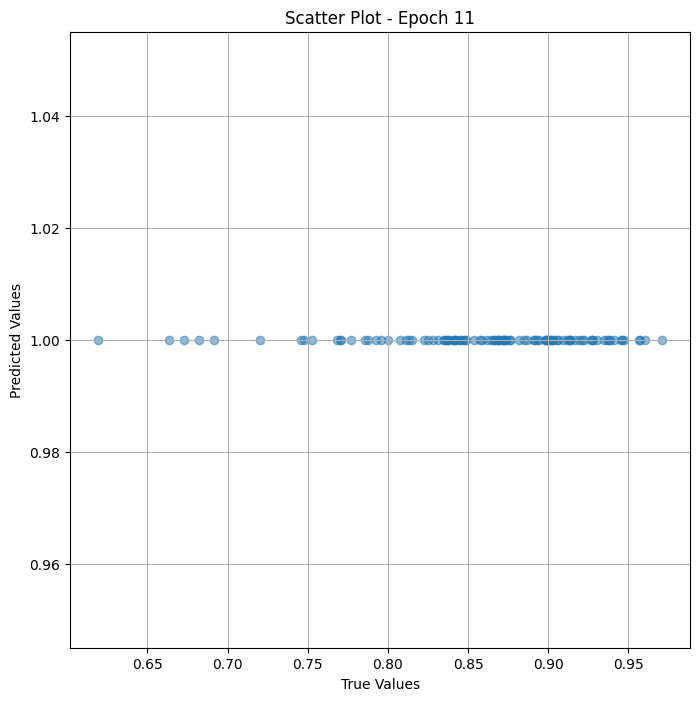

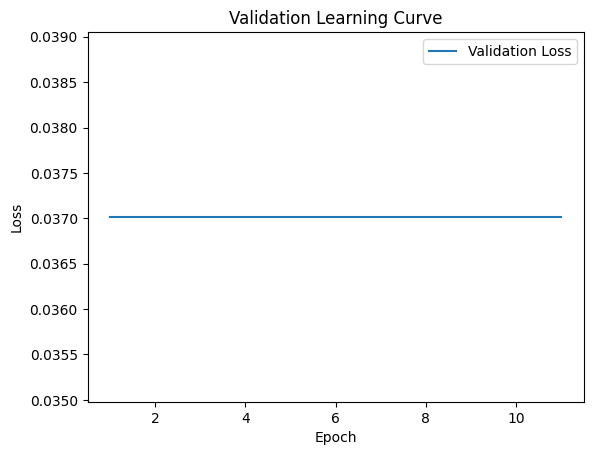


 Epoch: (12/50) Loss = 0.03701549395918846

 Epoch: (12/50) Loss_rmse = 0.19239410758018494

 Epoch: (12/50) R^2 = -1.9556353092193604

 Epoch: (12/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

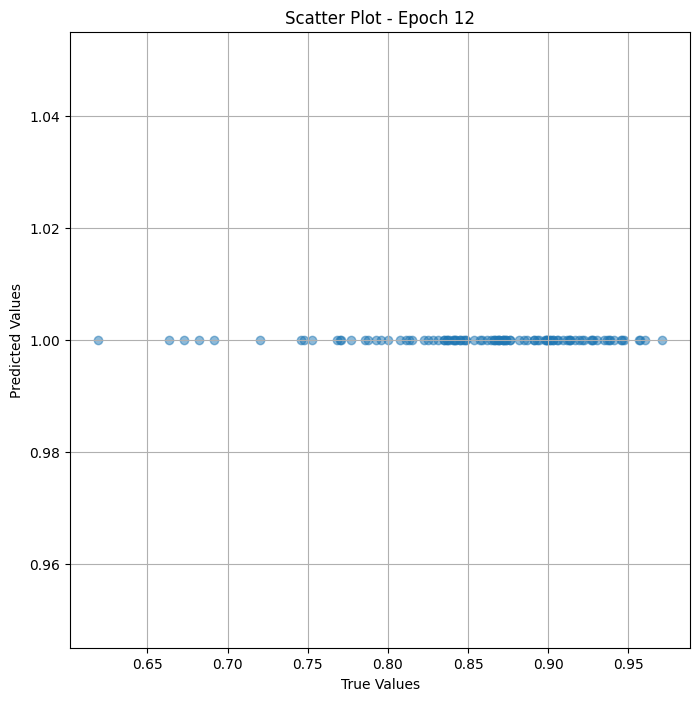

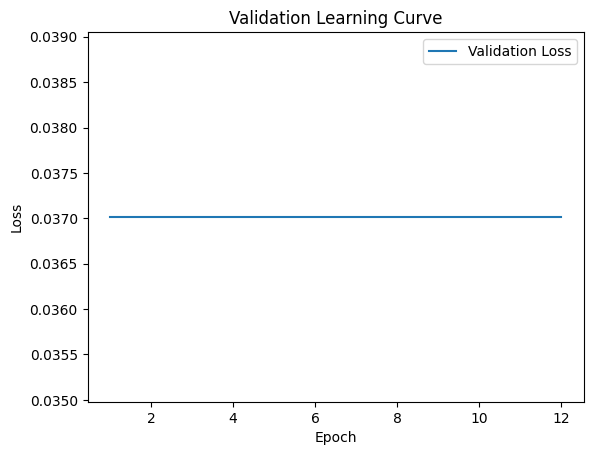


 Epoch: (13/50) Loss = 0.03701549395918846

 Epoch: (13/50) Loss_rmse = 0.19239410758018494

 Epoch: (13/50) R^2 = -1.9556353092193604

 Epoch: (13/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

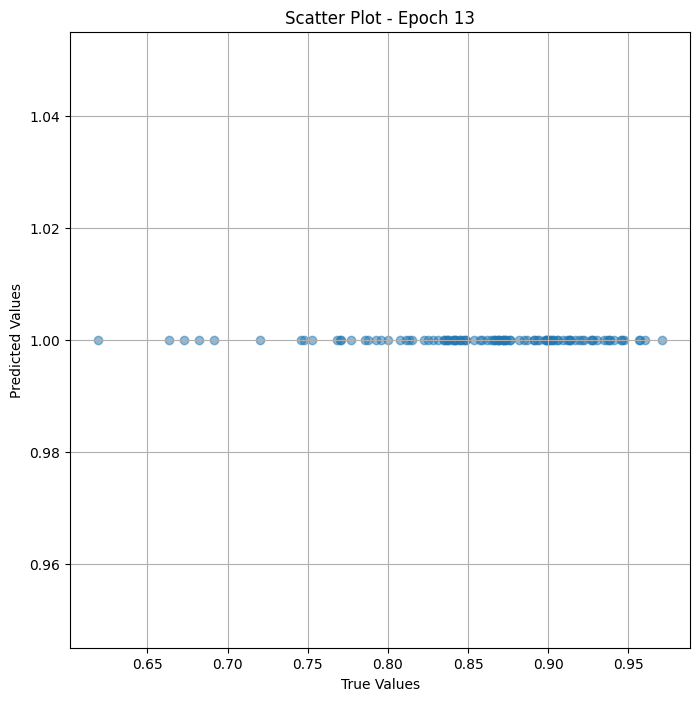

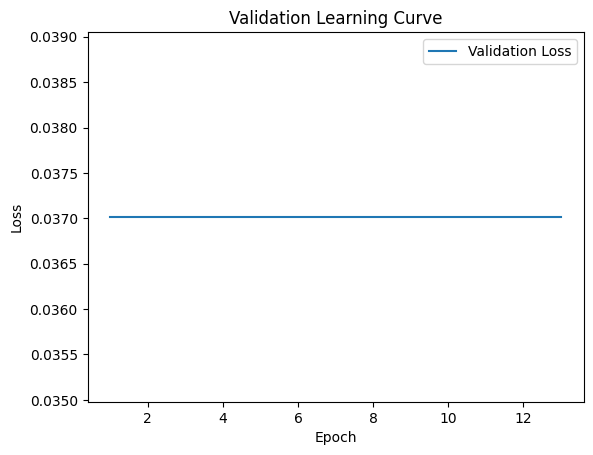


 Epoch: (14/50) Loss = 0.03701549395918846

 Epoch: (14/50) Loss_rmse = 0.19239410758018494

 Epoch: (14/50) R^2 = -1.9556353092193604

 Epoch: (14/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

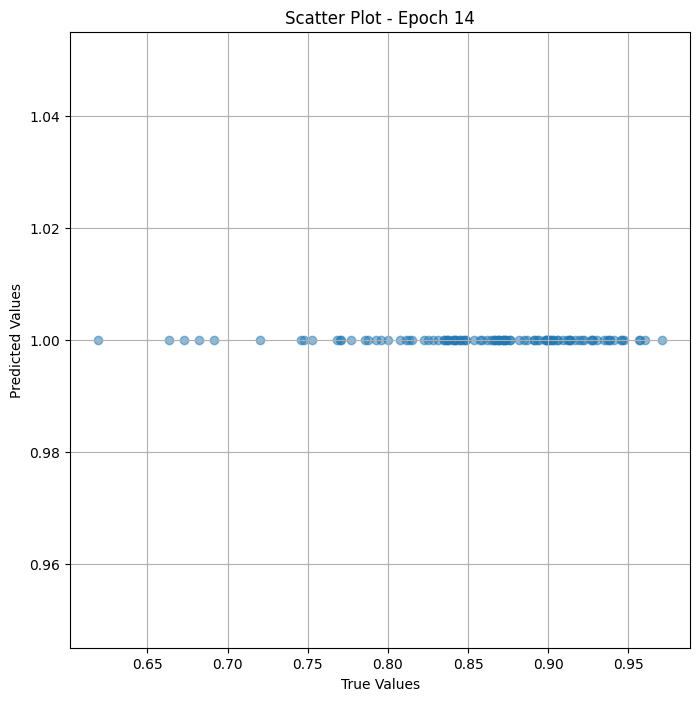

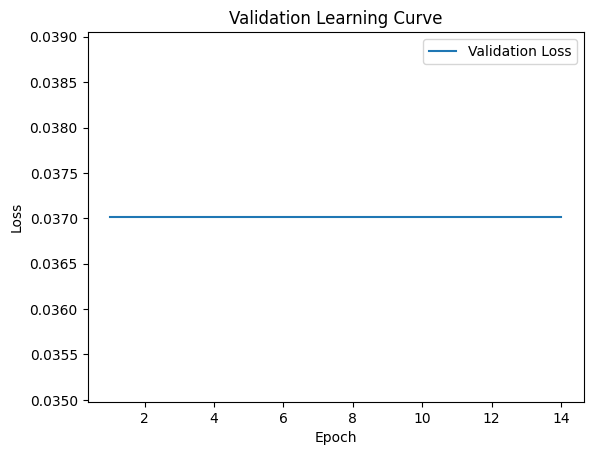


 Epoch: (15/50) Loss = 0.03701549395918846

 Epoch: (15/50) Loss_rmse = 0.19239410758018494

 Epoch: (15/50) R^2 = -1.9556353092193604

 Epoch: (15/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

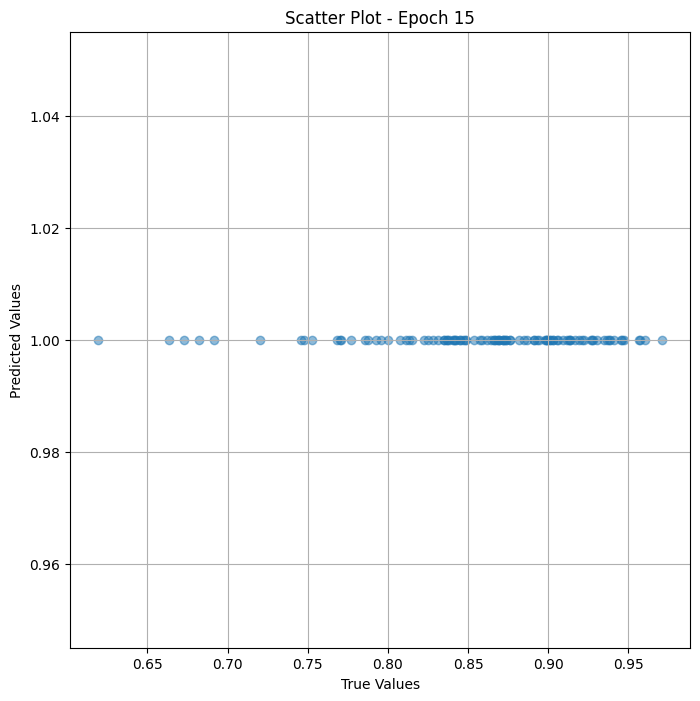

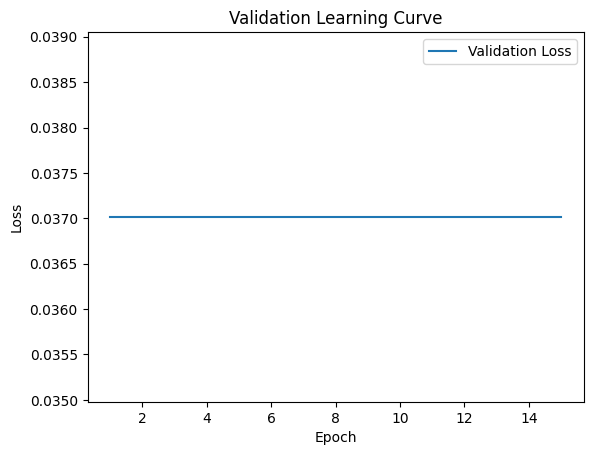


 Epoch: (16/50) Loss = 0.03701549395918846

 Epoch: (16/50) Loss_rmse = 0.19239410758018494

 Epoch: (16/50) R^2 = -1.9556353092193604

 Epoch: (16/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

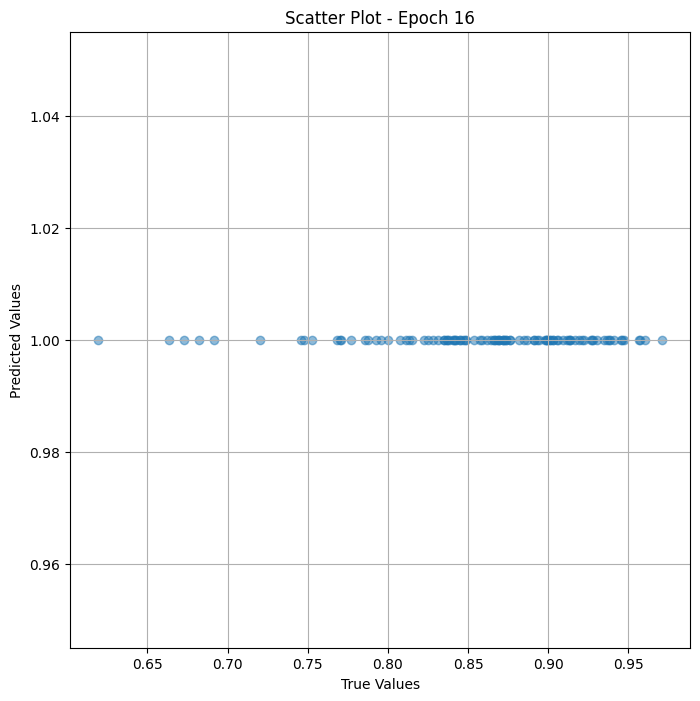

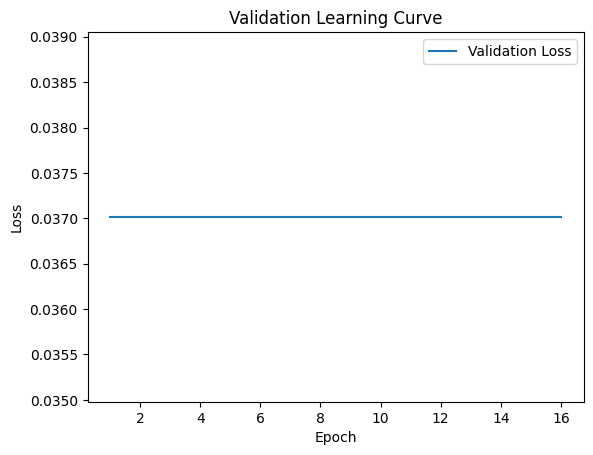


 Epoch: (17/50) Loss = 0.03701549395918846

 Epoch: (17/50) Loss_rmse = 0.19239410758018494

 Epoch: (17/50) R^2 = -1.9556353092193604

 Epoch: (17/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

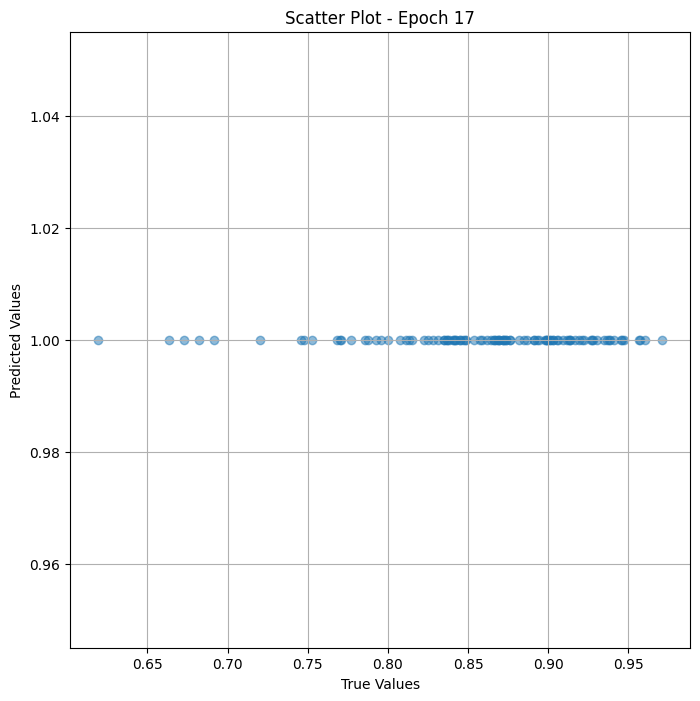

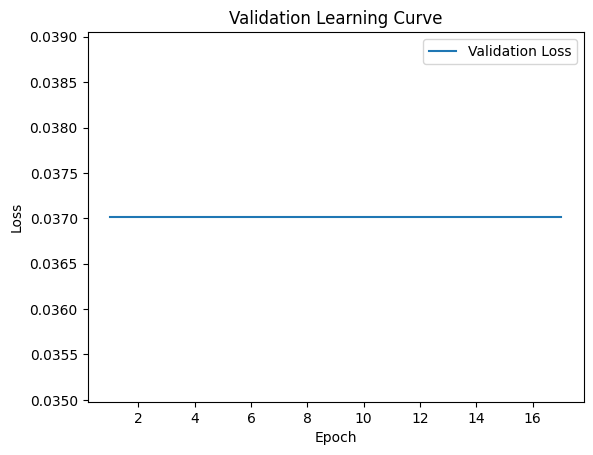


 Epoch: (18/50) Loss = 0.03701549395918846

 Epoch: (18/50) Loss_rmse = 0.19239410758018494

 Epoch: (18/50) R^2 = -1.9556353092193604

 Epoch: (18/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

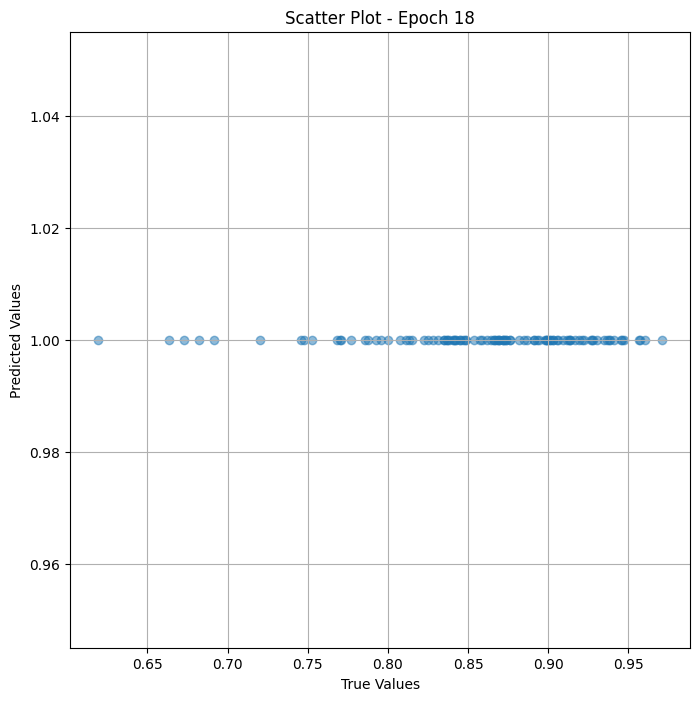

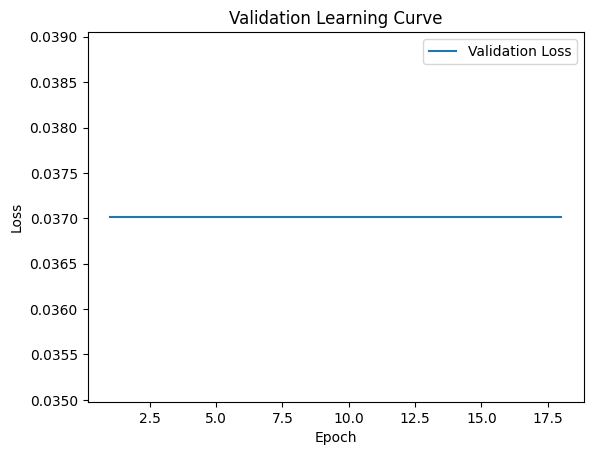


 Epoch: (19/50) Loss = 0.03701549395918846

 Epoch: (19/50) Loss_rmse = 0.19239410758018494

 Epoch: (19/50) R^2 = -1.9556353092193604

 Epoch: (19/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

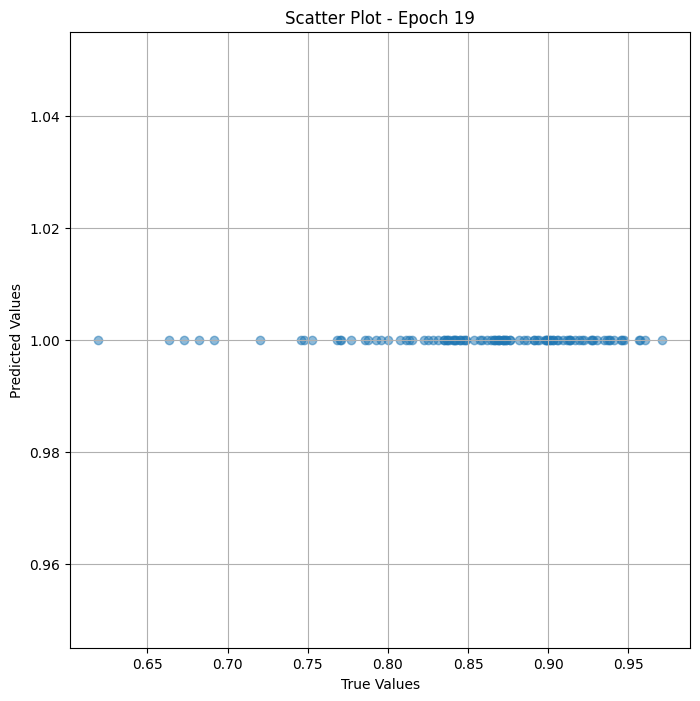

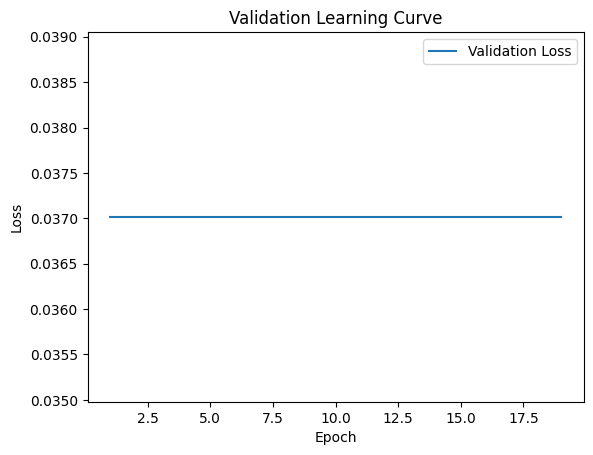


 Epoch: (20/50) Loss = 0.03701549395918846

 Epoch: (20/50) Loss_rmse = 0.19239410758018494

 Epoch: (20/50) R^2 = -1.9556353092193604

 Epoch: (20/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

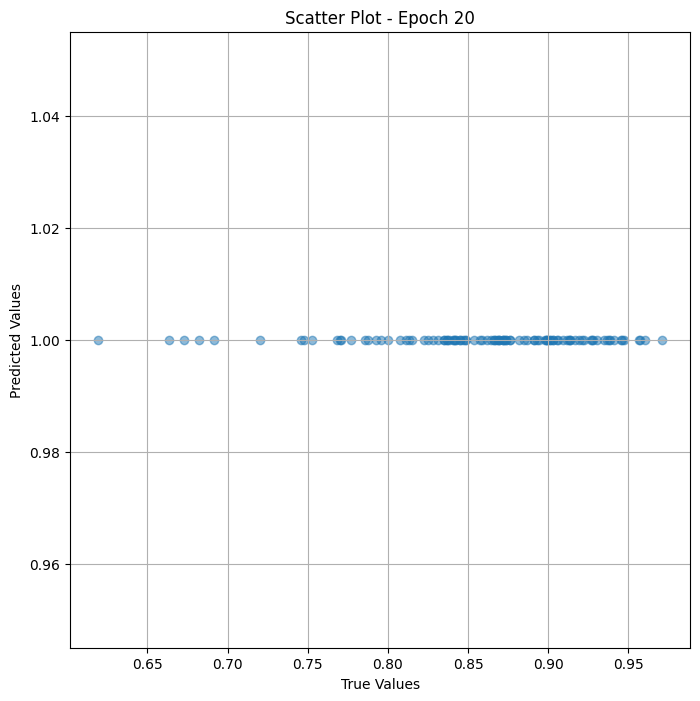

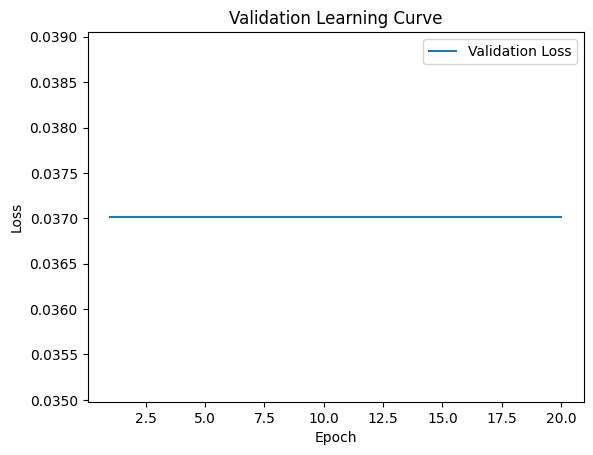


 Epoch: (21/50) Loss = 0.03701549395918846

 Epoch: (21/50) Loss_rmse = 0.19239410758018494

 Epoch: (21/50) R^2 = -1.9556353092193604

 Epoch: (21/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

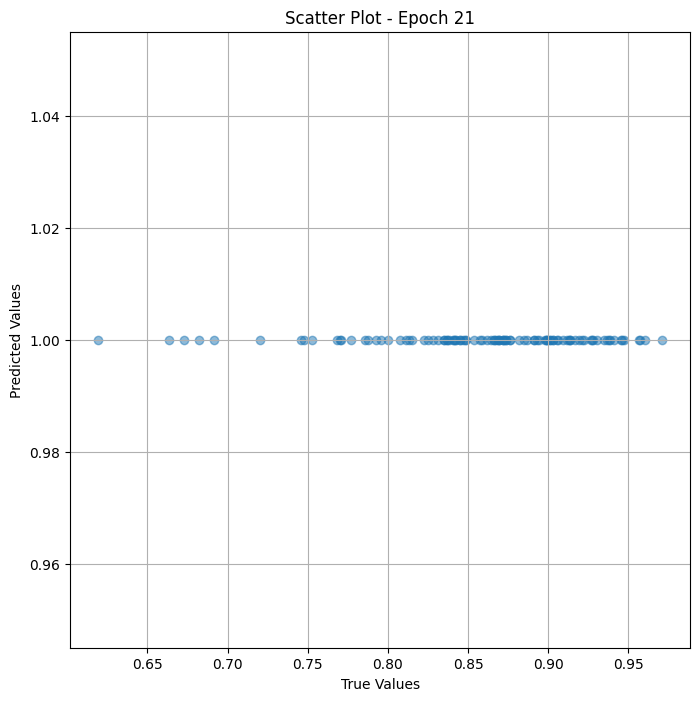

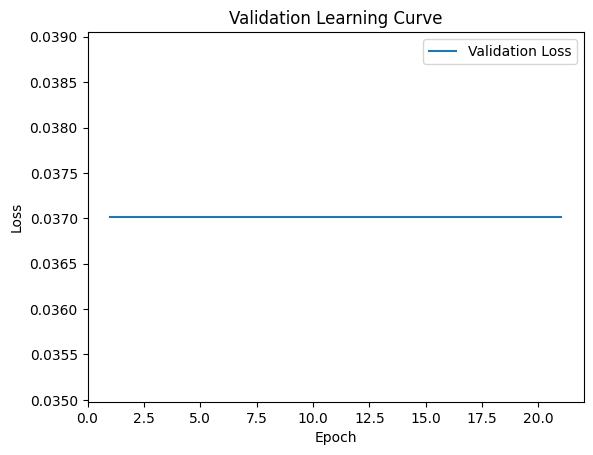


 Epoch: (22/50) Loss = 0.03701549395918846

 Epoch: (22/50) Loss_rmse = 0.19239410758018494

 Epoch: (22/50) R^2 = -1.9556353092193604

 Epoch: (22/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

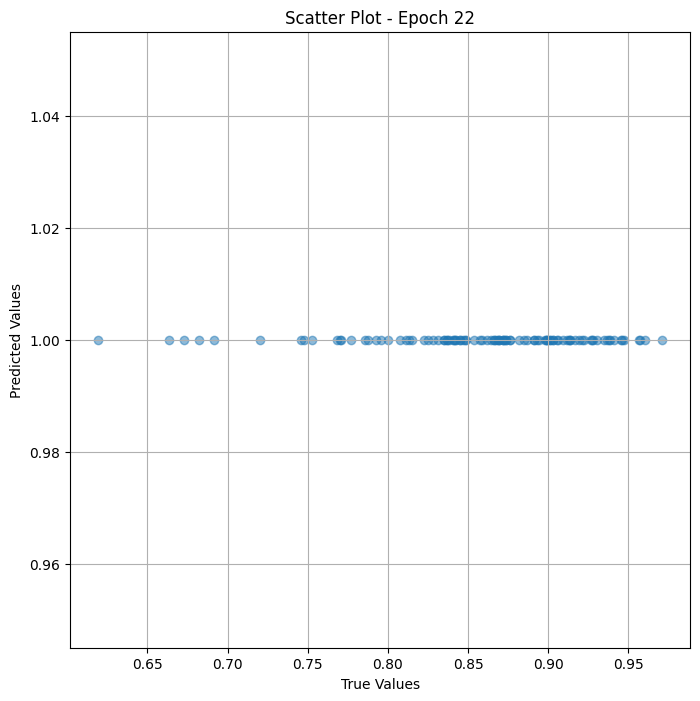

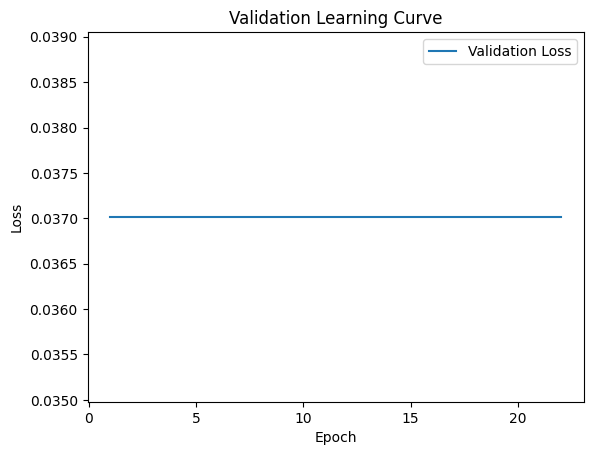


 Epoch: (23/50) Loss = 0.03701549395918846

 Epoch: (23/50) Loss_rmse = 0.19239410758018494

 Epoch: (23/50) R^2 = -1.9556353092193604

 Epoch: (23/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

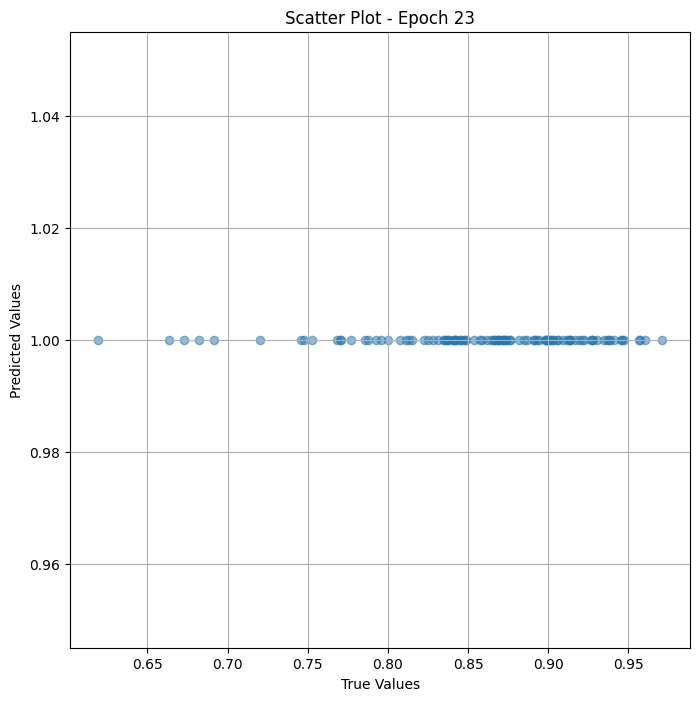

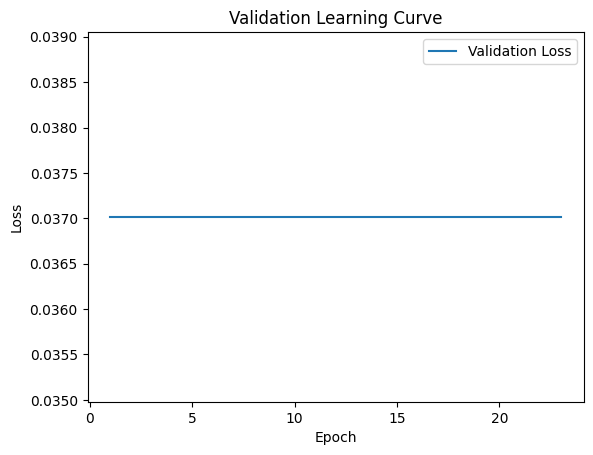


 Epoch: (24/50) Loss = 0.03701549395918846

 Epoch: (24/50) Loss_rmse = 0.19239410758018494

 Epoch: (24/50) R^2 = -1.9556353092193604

 Epoch: (24/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

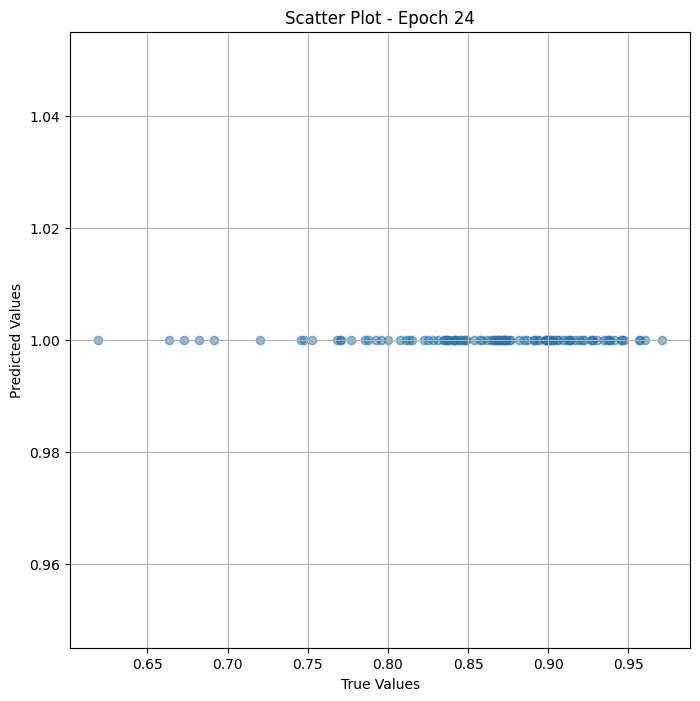

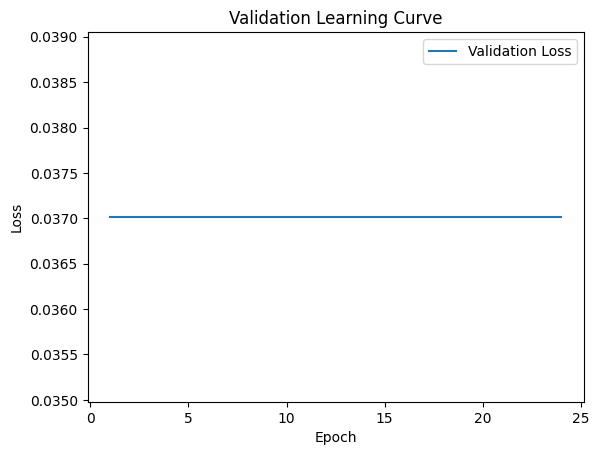


 Epoch: (25/50) Loss = 0.03701549395918846

 Epoch: (25/50) Loss_rmse = 0.19239410758018494

 Epoch: (25/50) R^2 = -1.9556353092193604

 Epoch: (25/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

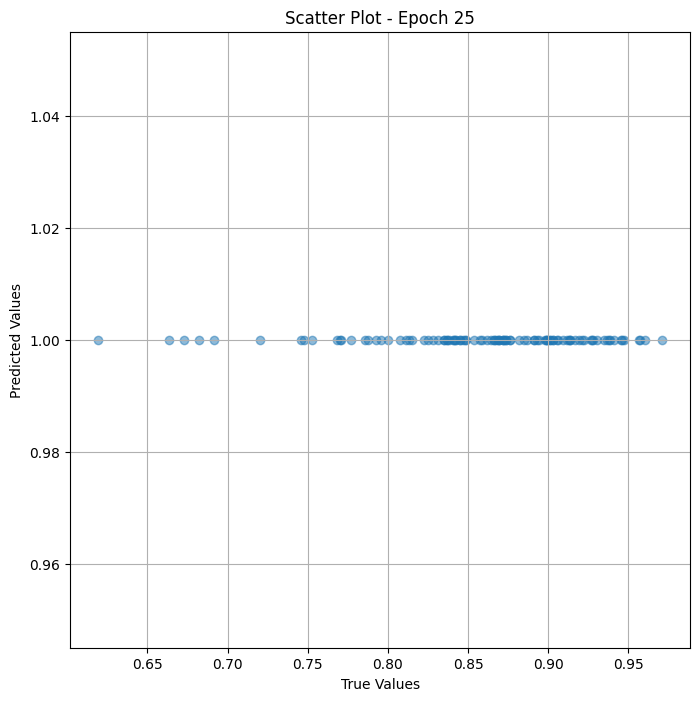

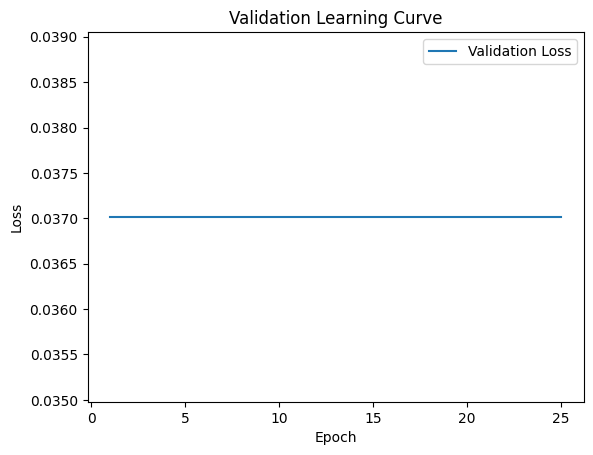


 Epoch: (26/50) Loss = 0.03701549395918846

 Epoch: (26/50) Loss_rmse = 0.19239410758018494

 Epoch: (26/50) R^2 = -1.9556353092193604

 Epoch: (26/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

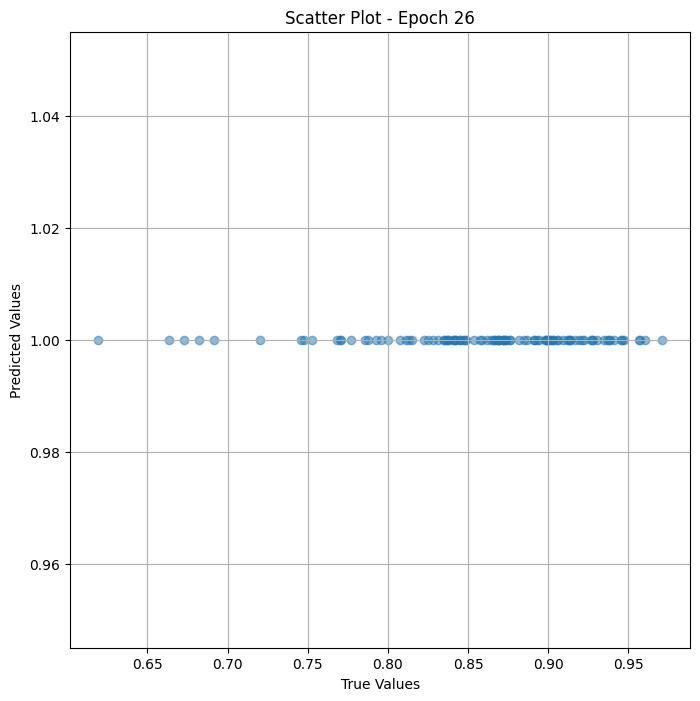

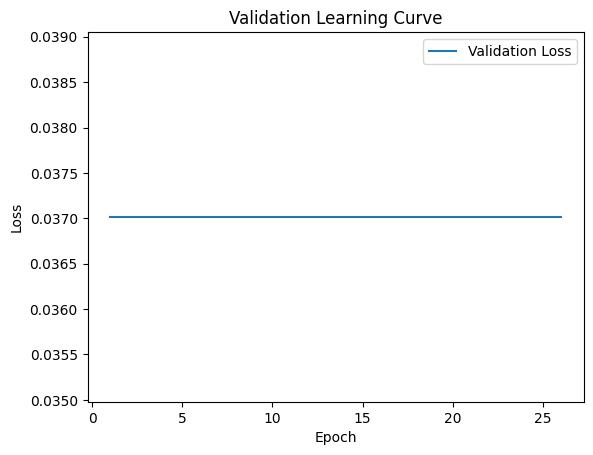


 Epoch: (27/50) Loss = 0.03701549395918846

 Epoch: (27/50) Loss_rmse = 0.19239410758018494

 Epoch: (27/50) R^2 = -1.9556353092193604

 Epoch: (27/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

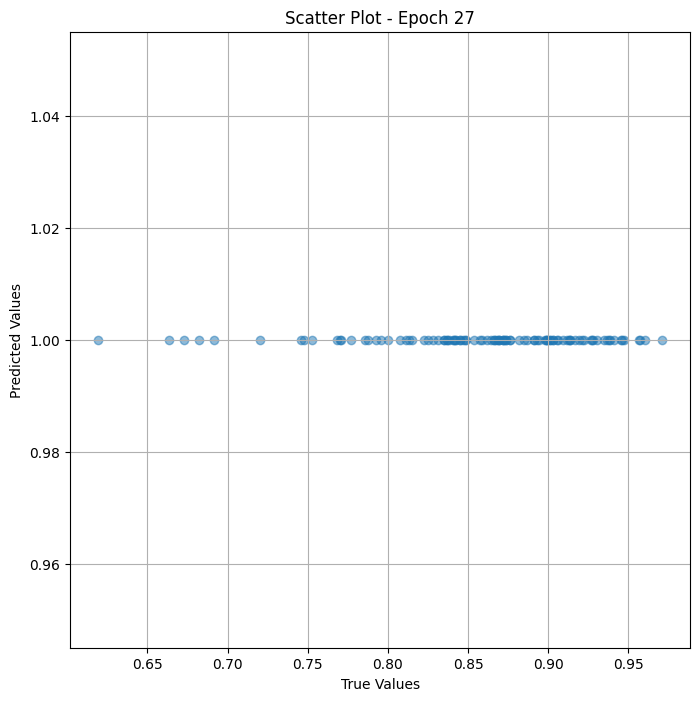

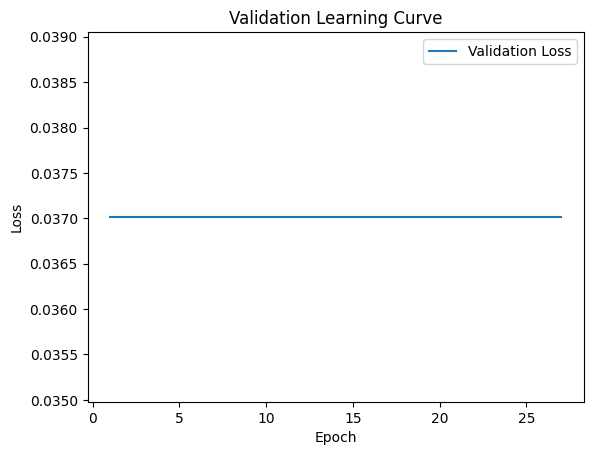


 Epoch: (28/50) Loss = 0.03701549395918846

 Epoch: (28/50) Loss_rmse = 0.19239410758018494

 Epoch: (28/50) R^2 = -1.9556353092193604

 Epoch: (28/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

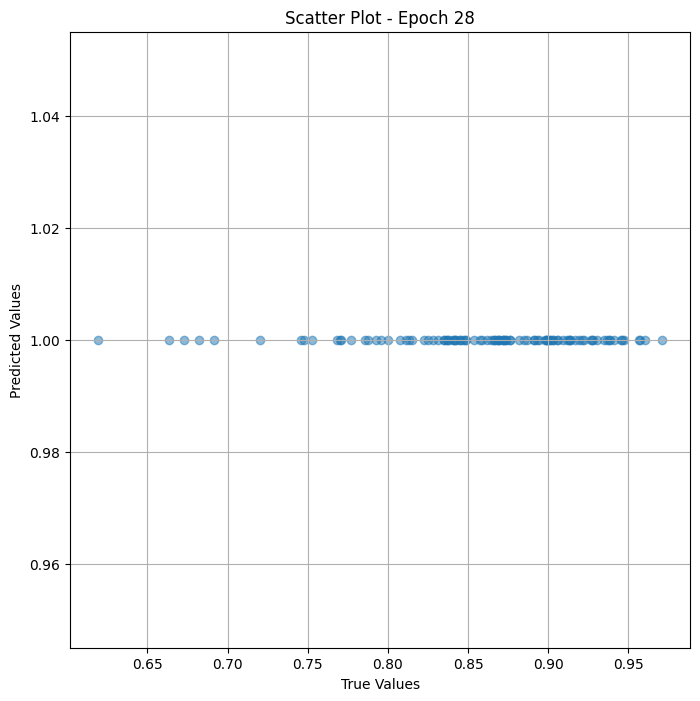

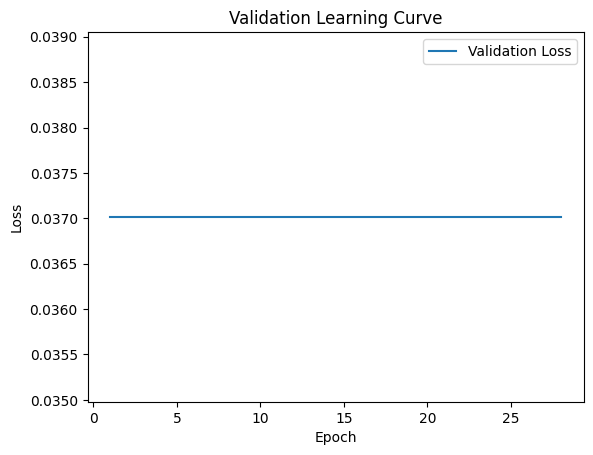


 Epoch: (29/50) Loss = 0.03701549395918846

 Epoch: (29/50) Loss_rmse = 0.19239410758018494

 Epoch: (29/50) R^2 = -1.9556353092193604

 Epoch: (29/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

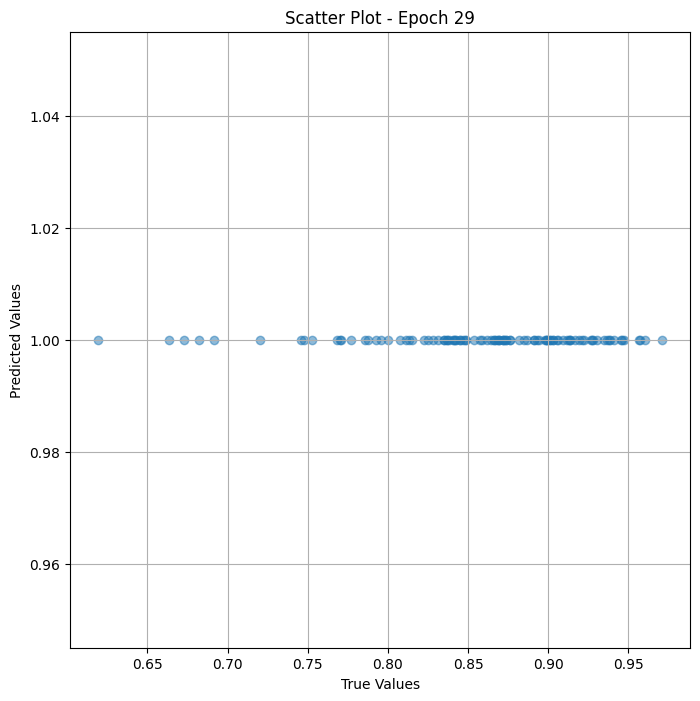

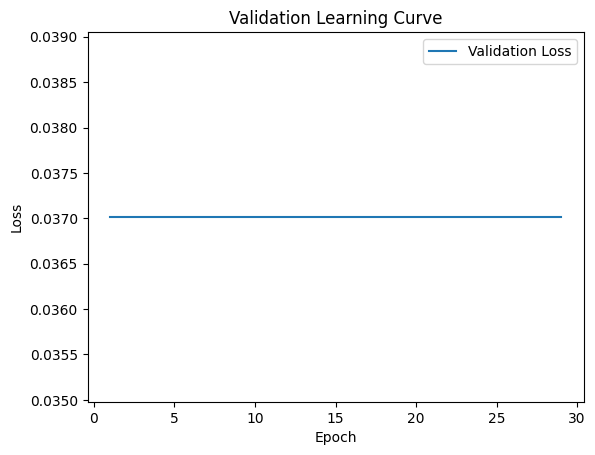


 Epoch: (30/50) Loss = 0.03701549395918846

 Epoch: (30/50) Loss_rmse = 0.19239410758018494

 Epoch: (30/50) R^2 = -1.9556353092193604

 Epoch: (30/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

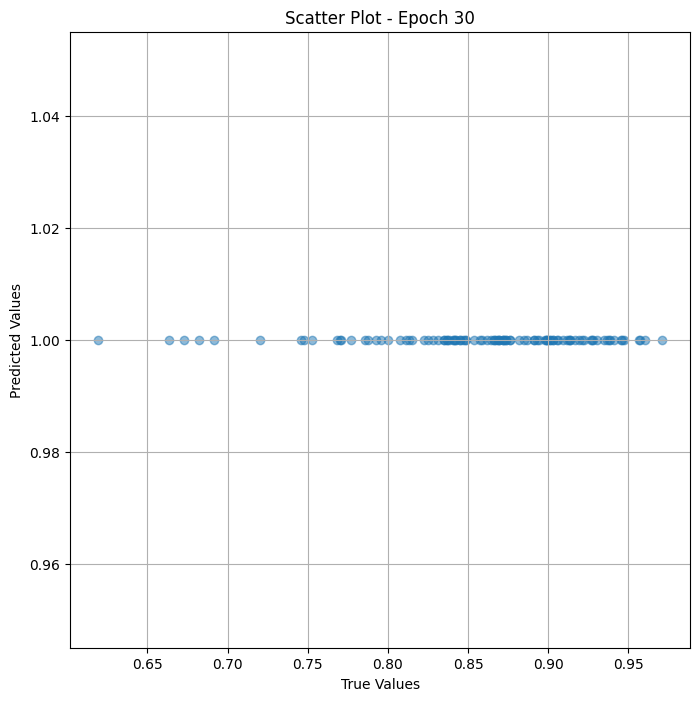

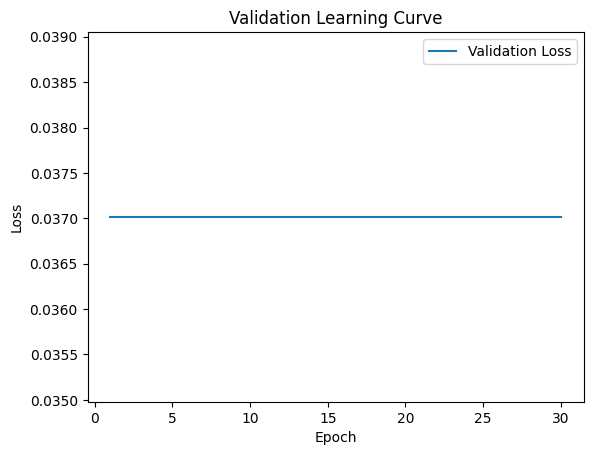


 Epoch: (31/50) Loss = 0.03701549395918846

 Epoch: (31/50) Loss_rmse = 0.19239410758018494

 Epoch: (31/50) R^2 = -1.9556353092193604

 Epoch: (31/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

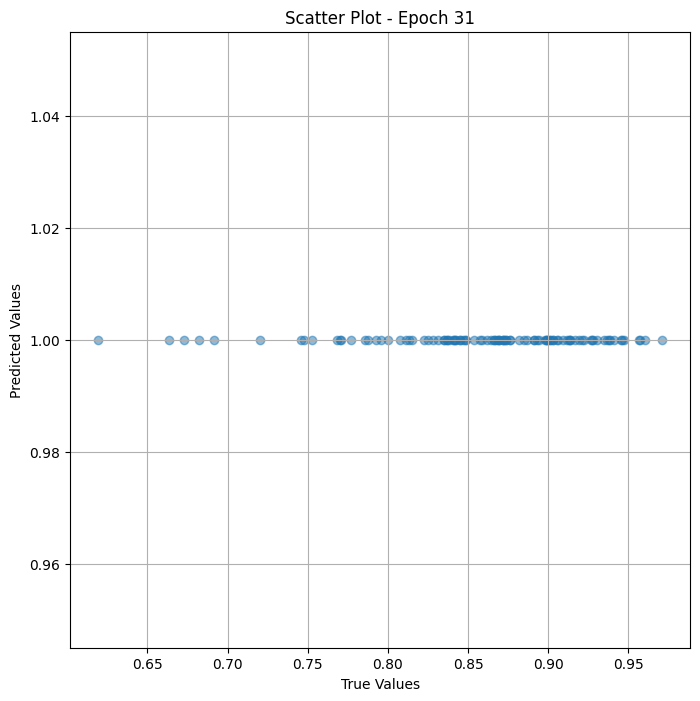

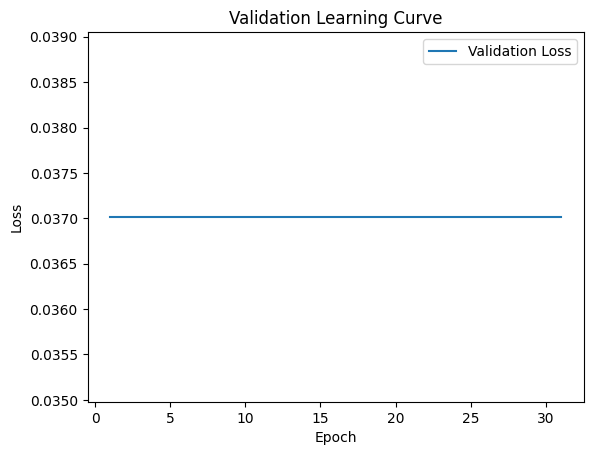


 Epoch: (32/50) Loss = 0.03701549395918846

 Epoch: (32/50) Loss_rmse = 0.19239410758018494

 Epoch: (32/50) R^2 = -1.9556353092193604

 Epoch: (32/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

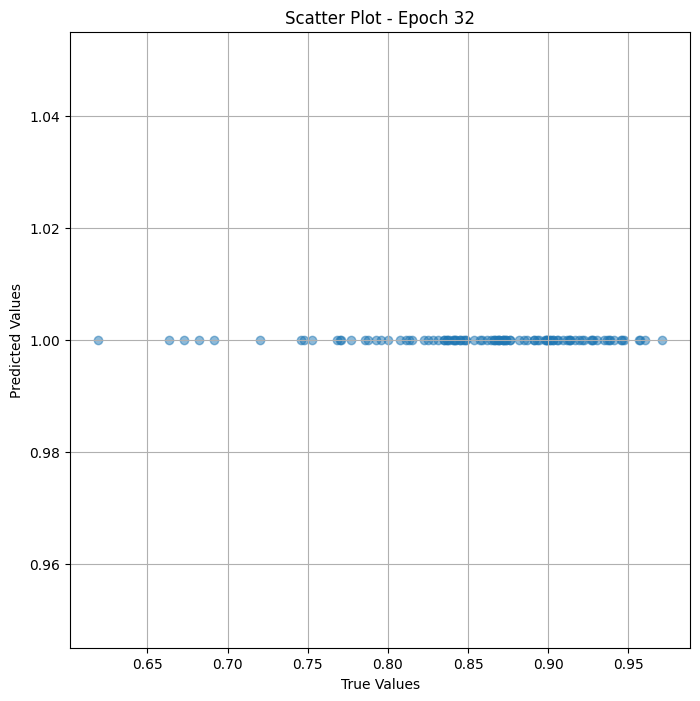

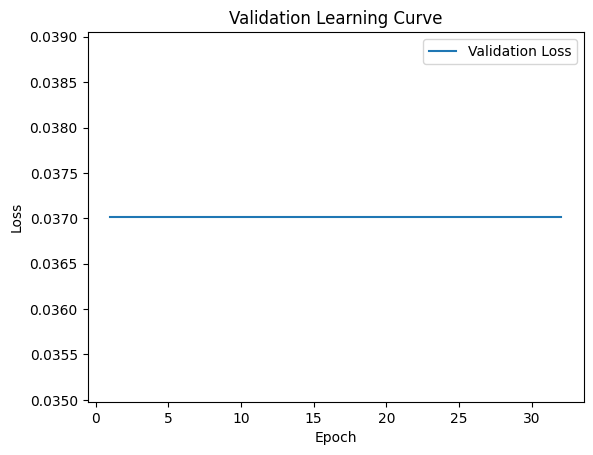


 Epoch: (33/50) Loss = 0.03701549395918846

 Epoch: (33/50) Loss_rmse = 0.19239410758018494

 Epoch: (33/50) R^2 = -1.9556353092193604

 Epoch: (33/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

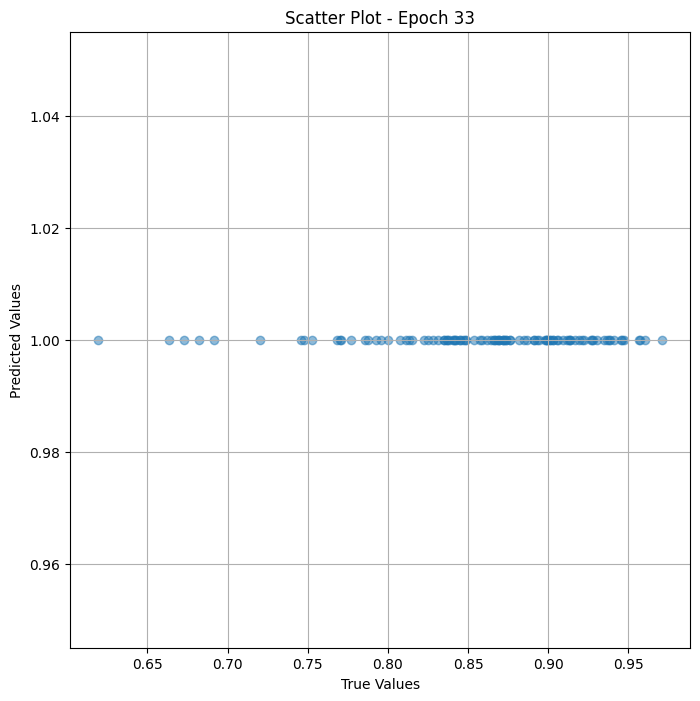

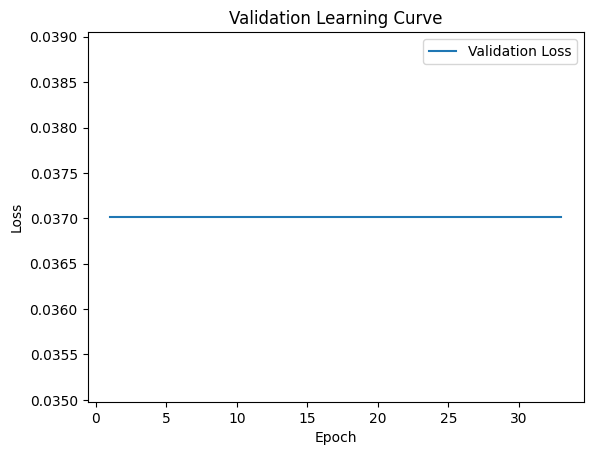


 Epoch: (34/50) Loss = 0.03701549395918846

 Epoch: (34/50) Loss_rmse = 0.19239410758018494

 Epoch: (34/50) R^2 = -1.9556353092193604

 Epoch: (34/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

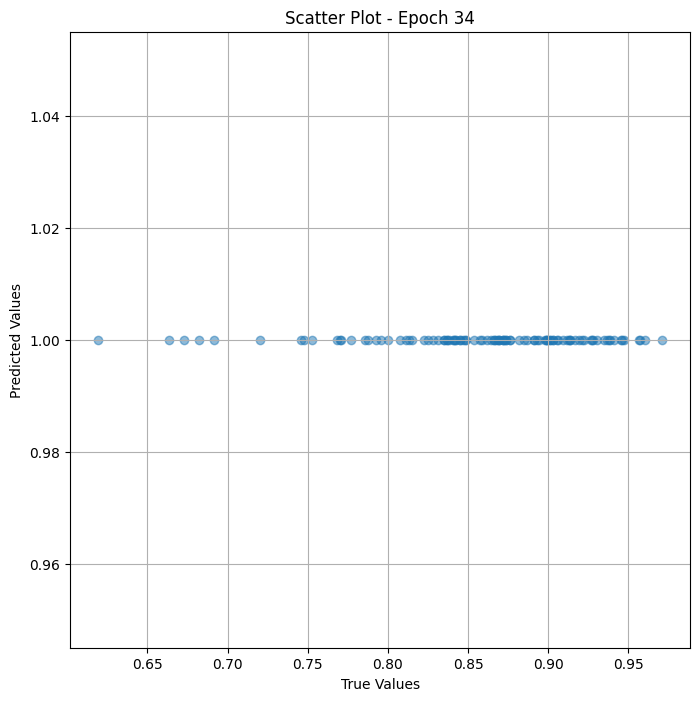

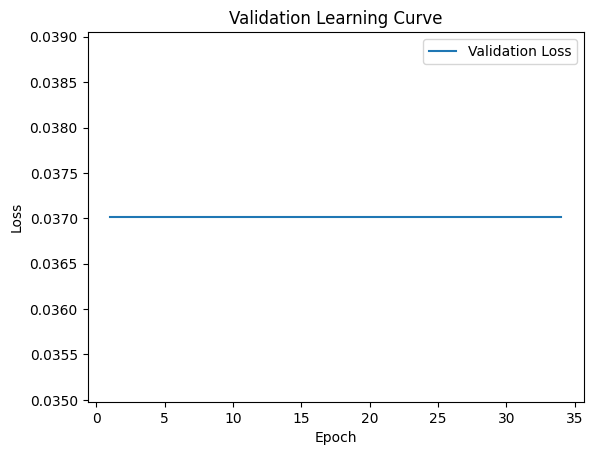


 Epoch: (35/50) Loss = 0.03701549395918846

 Epoch: (35/50) Loss_rmse = 0.19239410758018494

 Epoch: (35/50) R^2 = -1.9556353092193604

 Epoch: (35/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

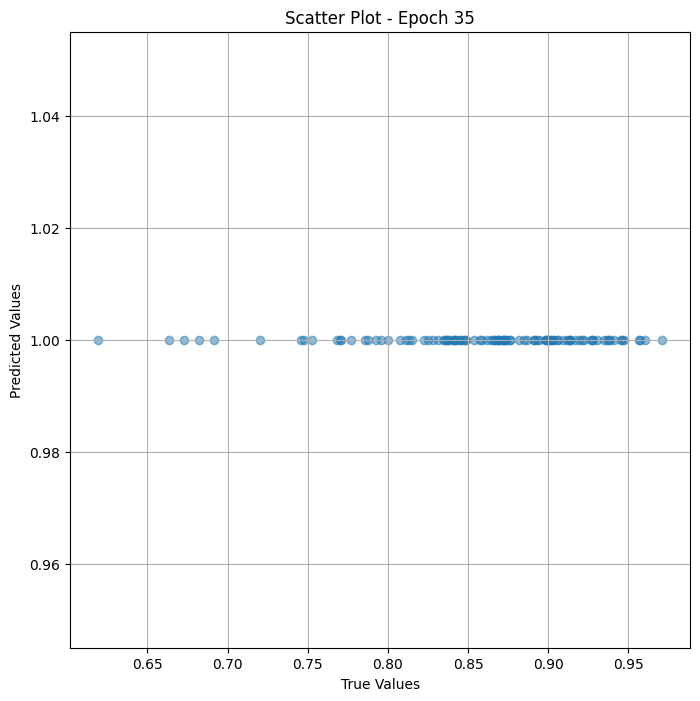

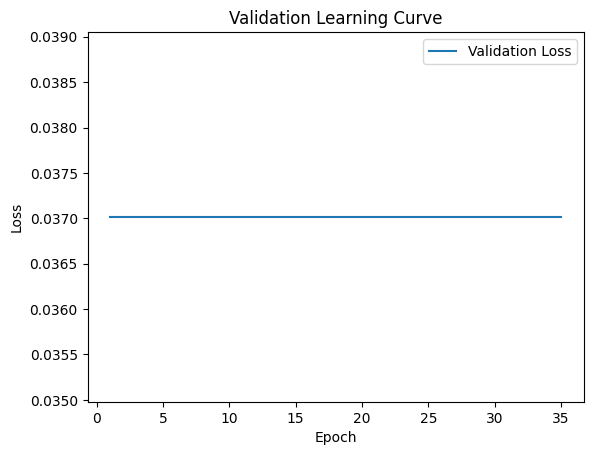


 Epoch: (36/50) Loss = 0.03701549395918846

 Epoch: (36/50) Loss_rmse = 0.19239410758018494

 Epoch: (36/50) R^2 = -1.9556353092193604

 Epoch: (36/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

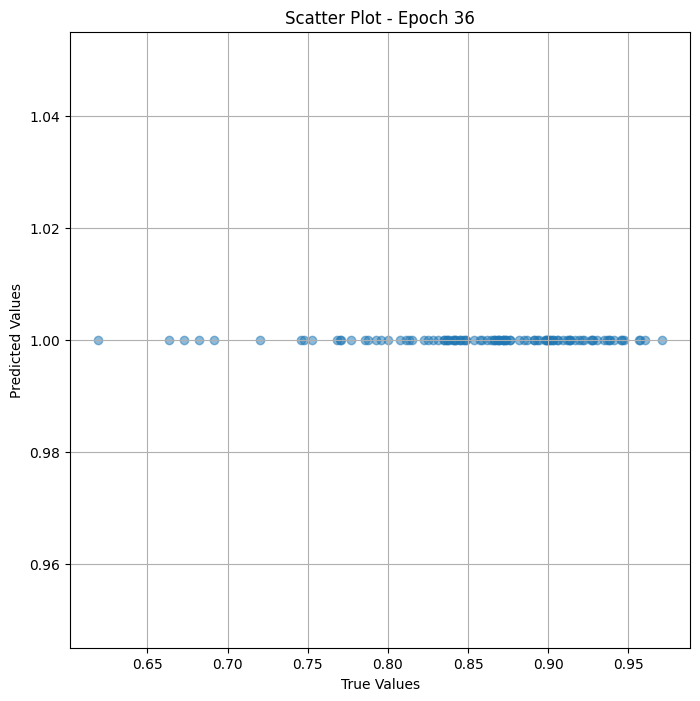

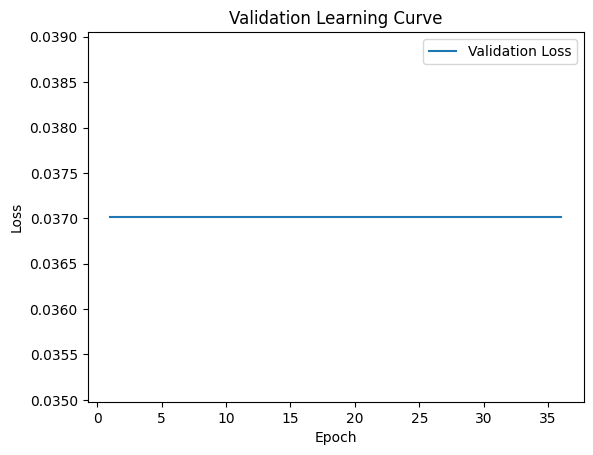


 Epoch: (37/50) Loss = 0.03701549395918846

 Epoch: (37/50) Loss_rmse = 0.19239410758018494

 Epoch: (37/50) R^2 = -1.9556353092193604

 Epoch: (37/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

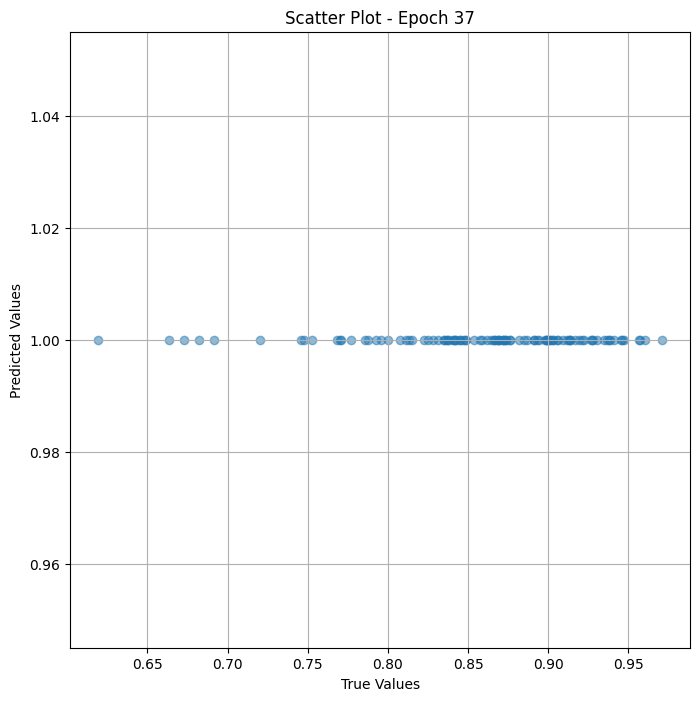

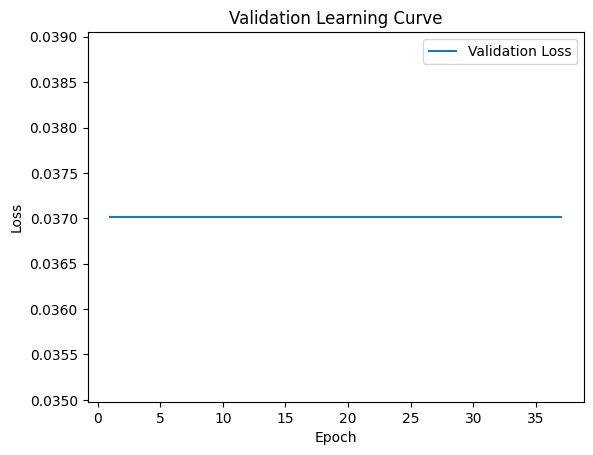


 Epoch: (38/50) Loss = 0.03701549395918846

 Epoch: (38/50) Loss_rmse = 0.19239410758018494

 Epoch: (38/50) R^2 = -1.9556353092193604

 Epoch: (38/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

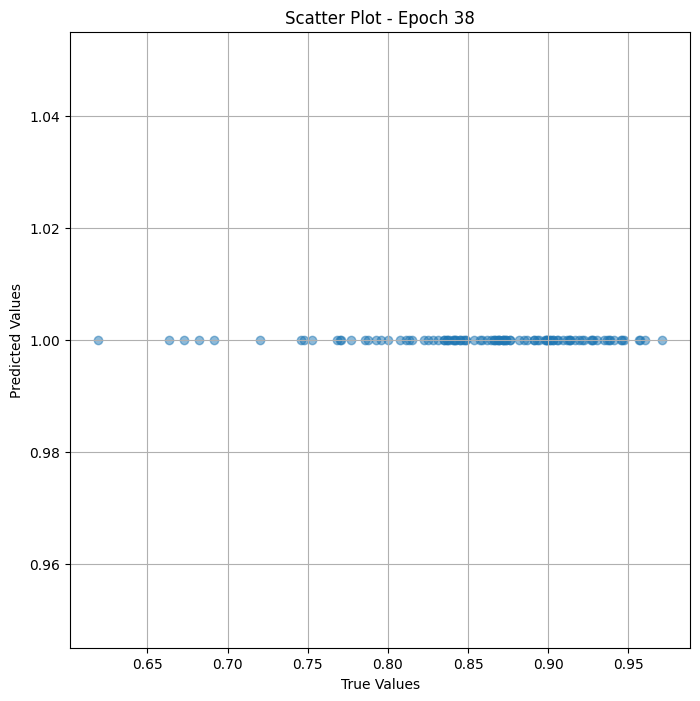

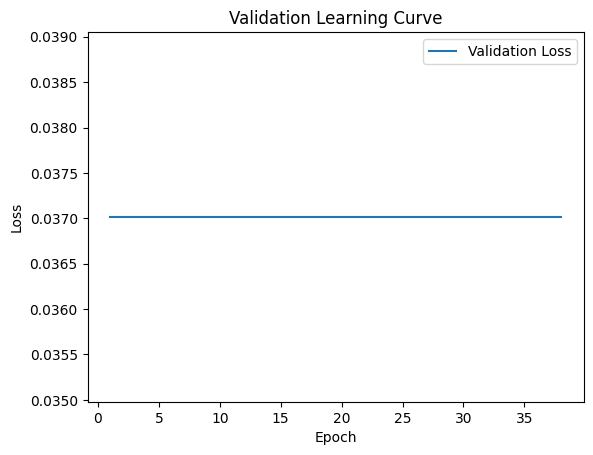


 Epoch: (39/50) Loss = 0.03701549395918846

 Epoch: (39/50) Loss_rmse = 0.19239410758018494

 Epoch: (39/50) R^2 = -1.9556353092193604

 Epoch: (39/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

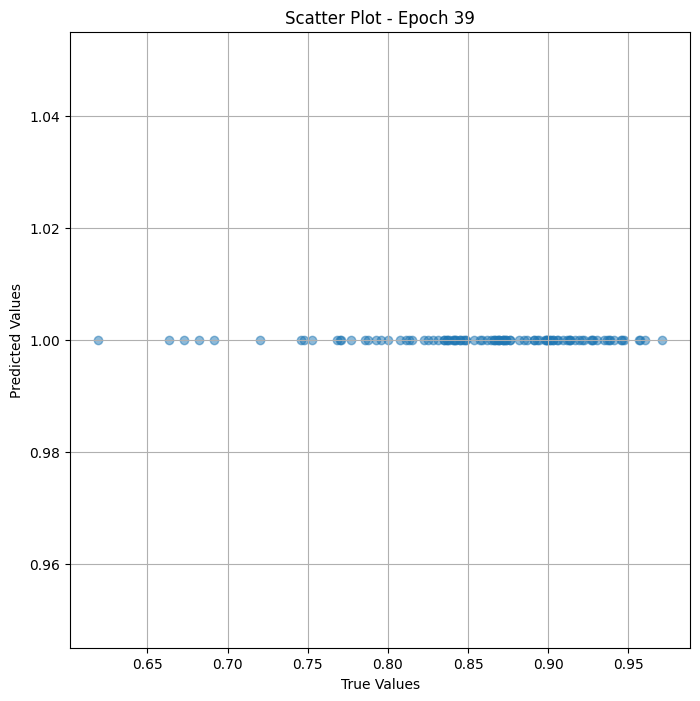

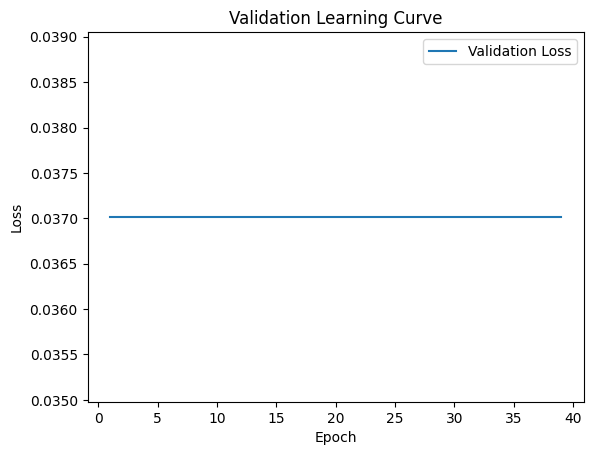


 Epoch: (40/50) Loss = 0.03701549395918846

 Epoch: (40/50) Loss_rmse = 0.19239410758018494

 Epoch: (40/50) R^2 = -1.9556353092193604

 Epoch: (40/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

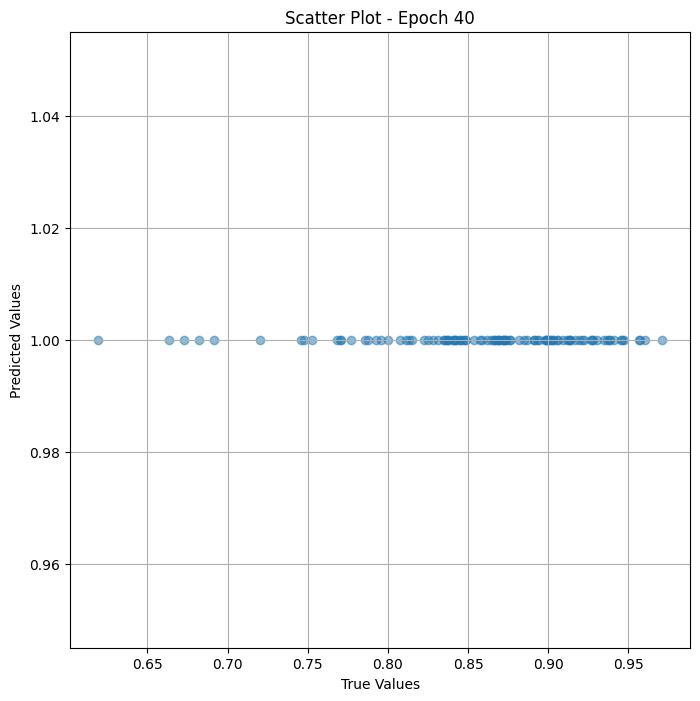

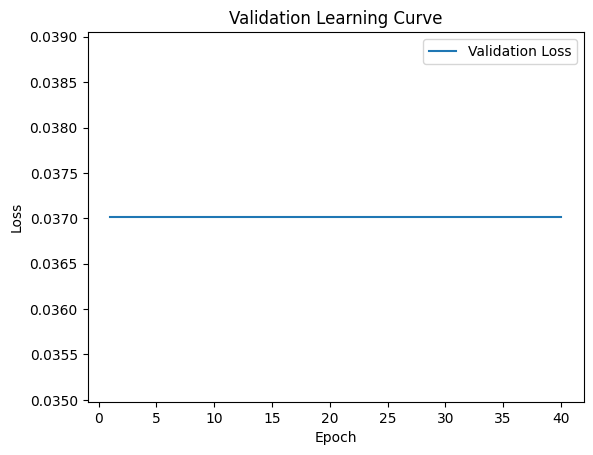


 Epoch: (41/50) Loss = 0.03701549395918846

 Epoch: (41/50) Loss_rmse = 0.19239410758018494

 Epoch: (41/50) R^2 = -1.9556353092193604

 Epoch: (41/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

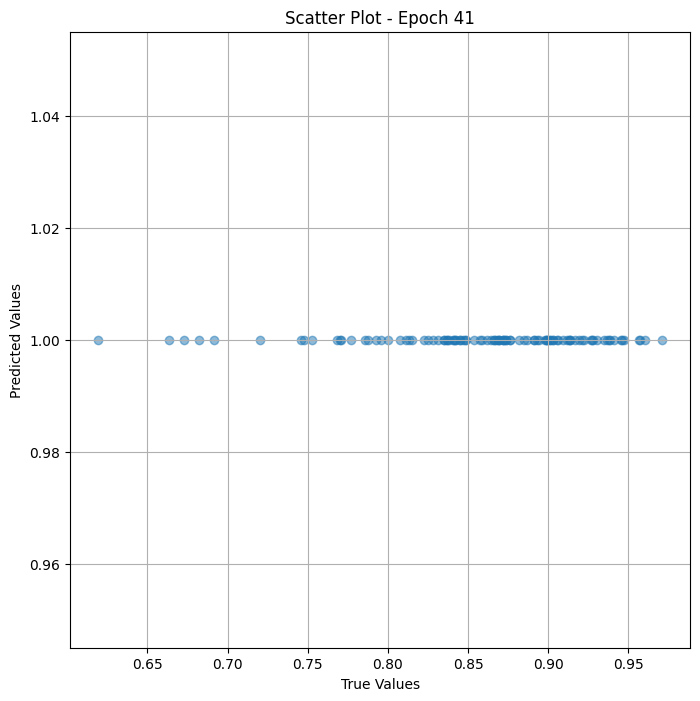

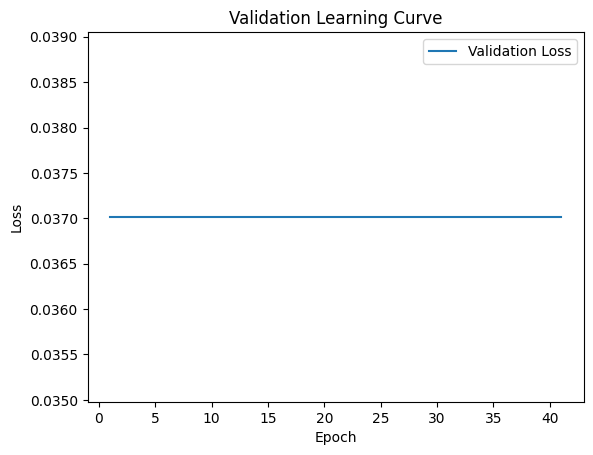


 Epoch: (42/50) Loss = 0.03701549395918846

 Epoch: (42/50) Loss_rmse = 0.19239410758018494

 Epoch: (42/50) R^2 = -1.9556353092193604

 Epoch: (42/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

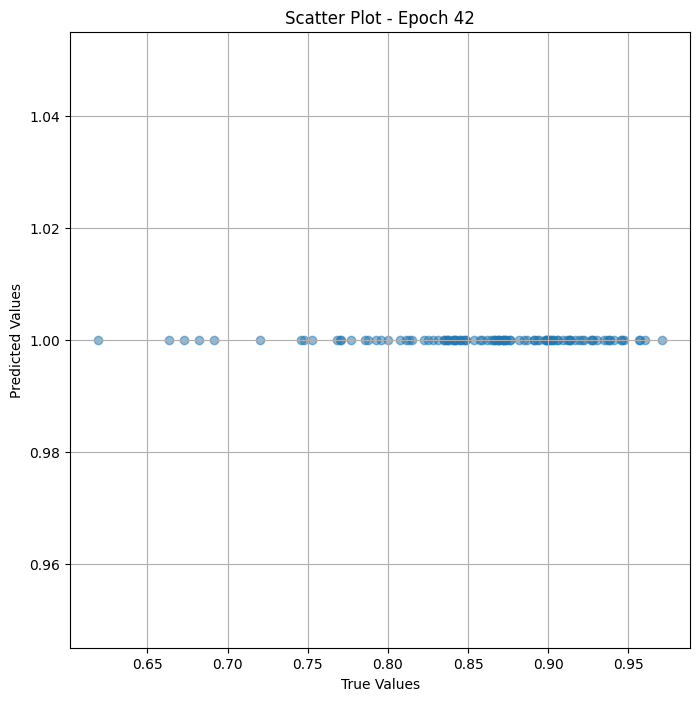

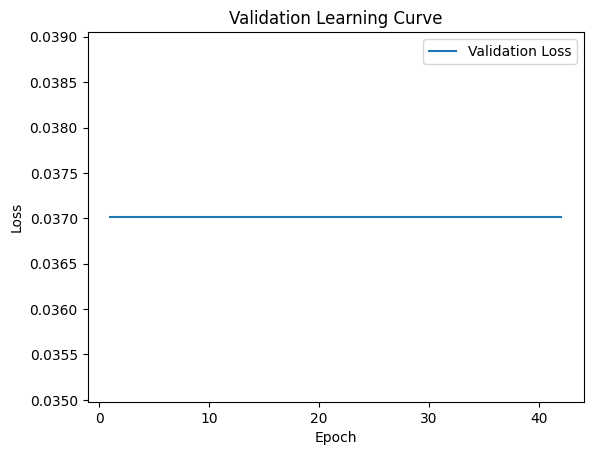


 Epoch: (43/50) Loss = 0.03701549395918846

 Epoch: (43/50) Loss_rmse = 0.19239410758018494

 Epoch: (43/50) R^2 = -1.9556353092193604

 Epoch: (43/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

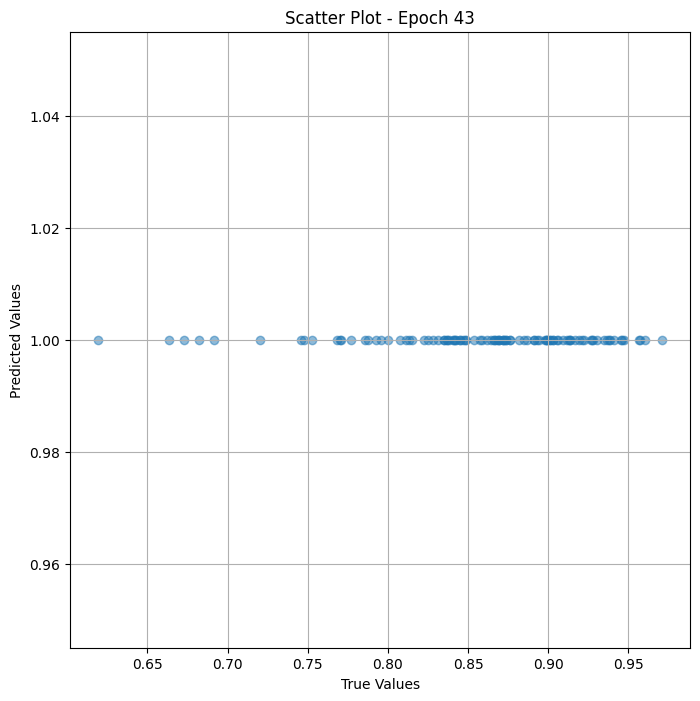

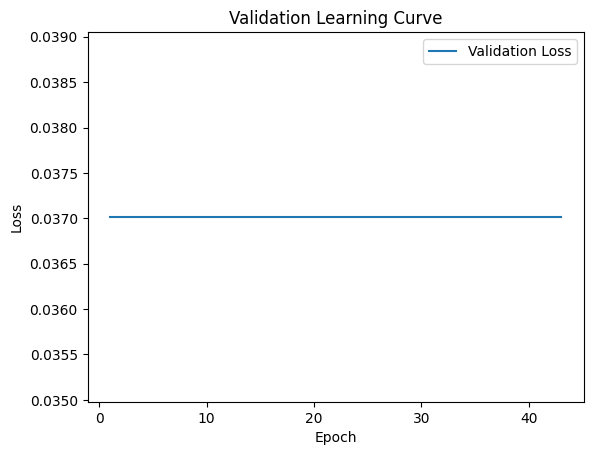


 Epoch: (44/50) Loss = 0.03701549395918846

 Epoch: (44/50) Loss_rmse = 0.19239410758018494

 Epoch: (44/50) R^2 = -1.9556353092193604

 Epoch: (44/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

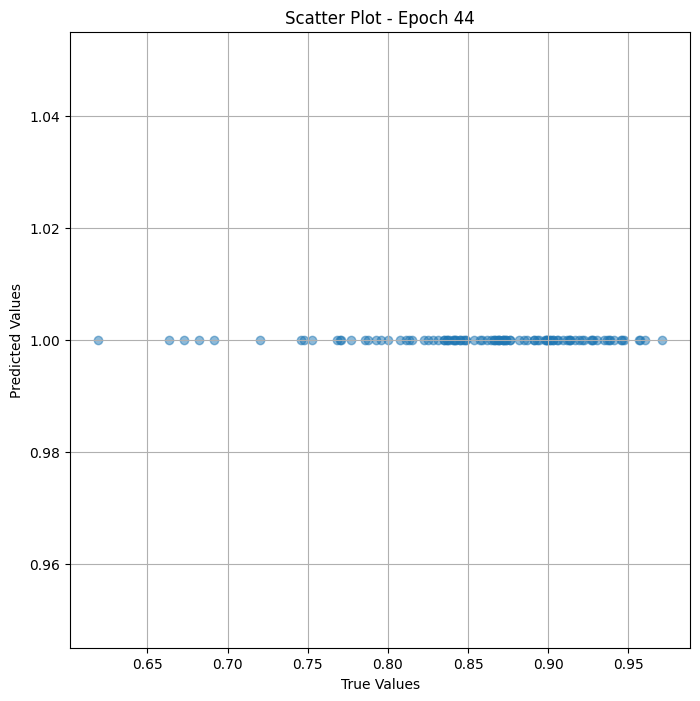

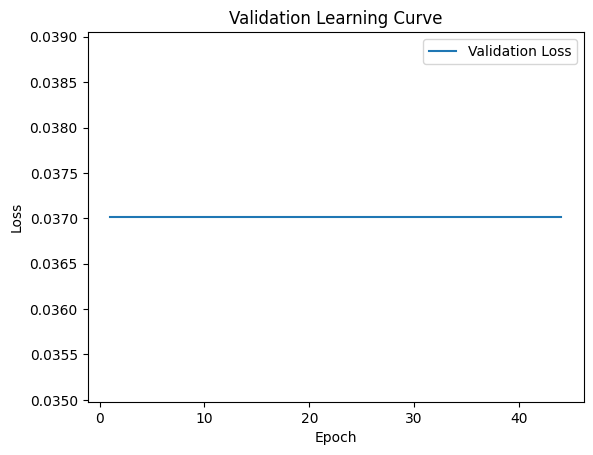


 Epoch: (45/50) Loss = 0.03701549395918846

 Epoch: (45/50) Loss_rmse = 0.19239410758018494

 Epoch: (45/50) R^2 = -1.9556353092193604

 Epoch: (45/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

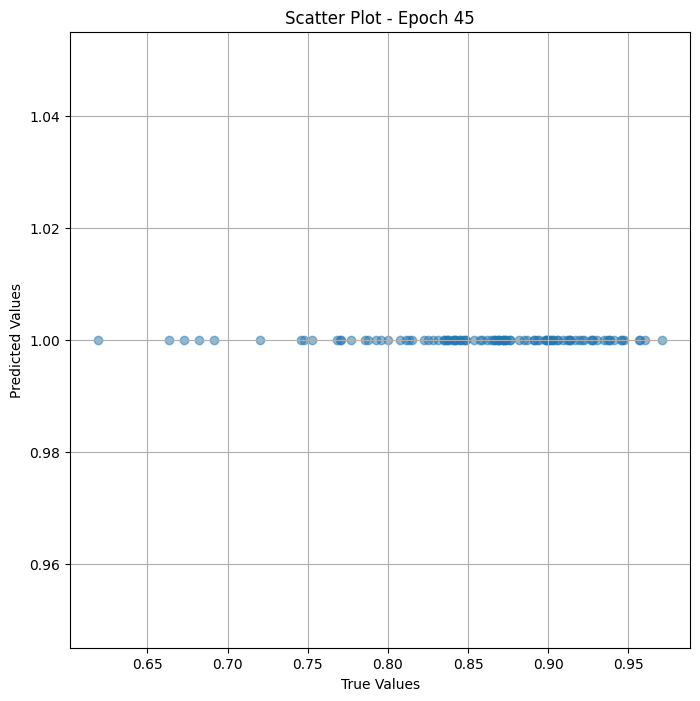

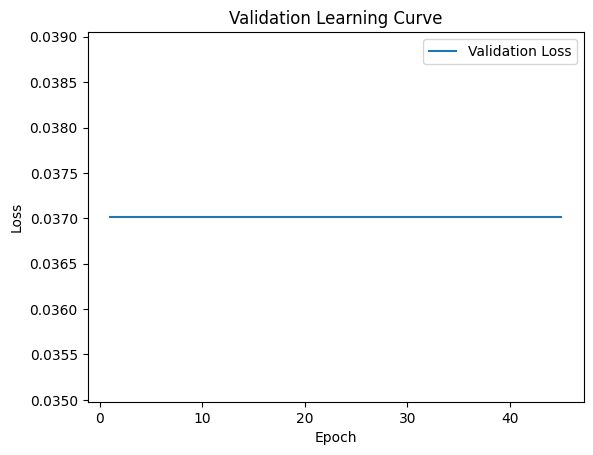


 Epoch: (46/50) Loss = 0.03701549395918846

 Epoch: (46/50) Loss_rmse = 0.19239410758018494

 Epoch: (46/50) R^2 = -1.9556353092193604

 Epoch: (46/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

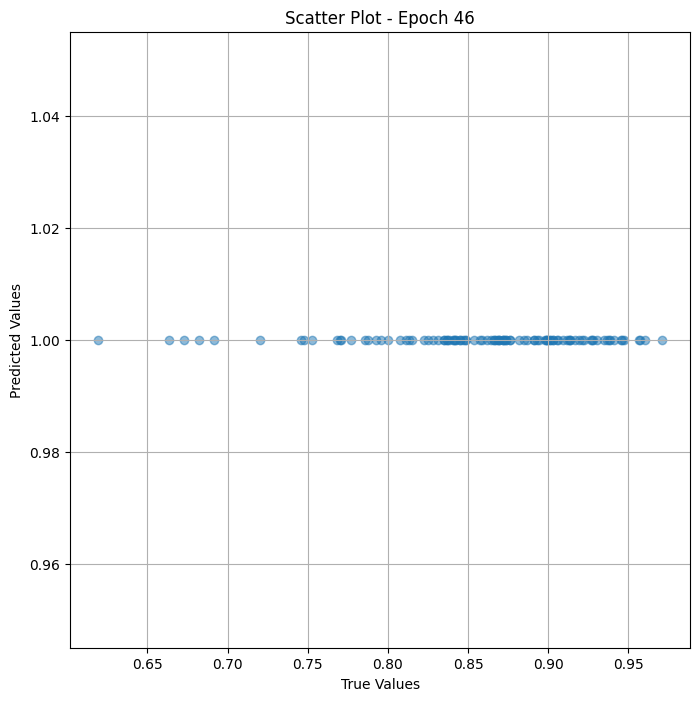

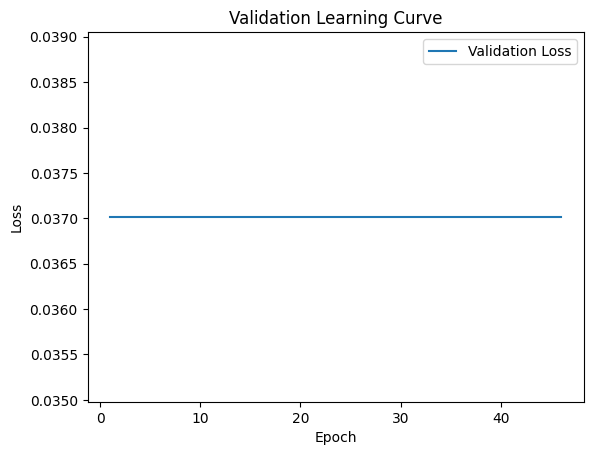


 Epoch: (47/50) Loss = 0.03701549395918846

 Epoch: (47/50) Loss_rmse = 0.19239410758018494

 Epoch: (47/50) R^2 = -1.9556353092193604

 Epoch: (47/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

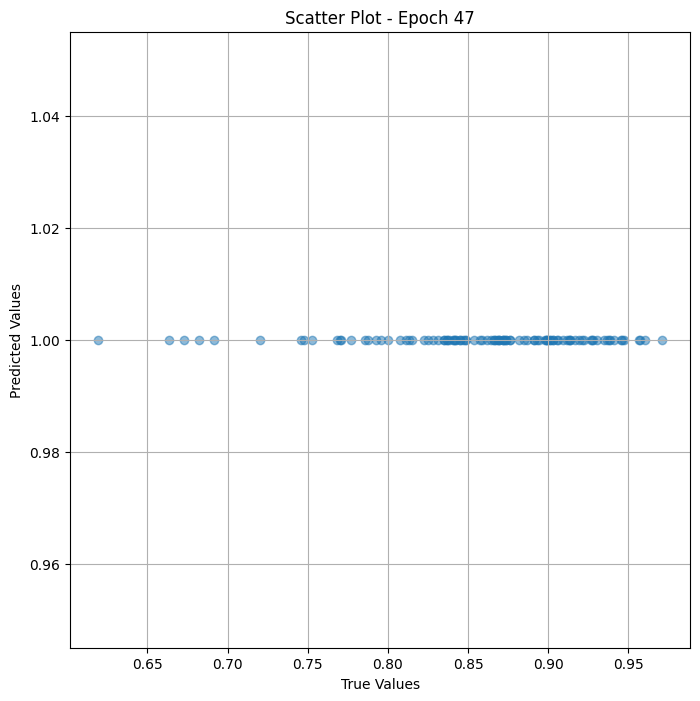

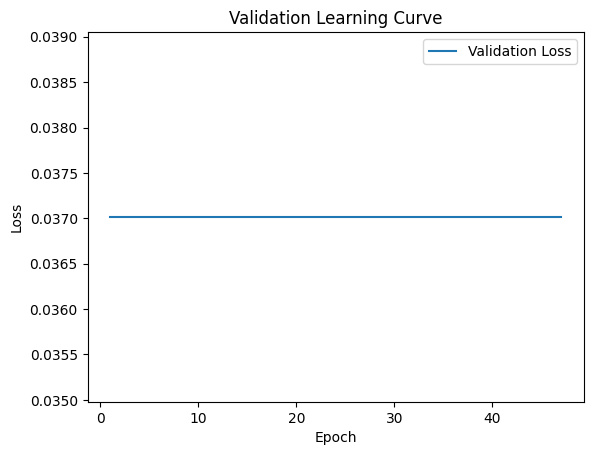


 Epoch: (48/50) Loss = 0.03701549395918846

 Epoch: (48/50) Loss_rmse = 0.19239410758018494

 Epoch: (48/50) R^2 = -1.9556353092193604

 Epoch: (48/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

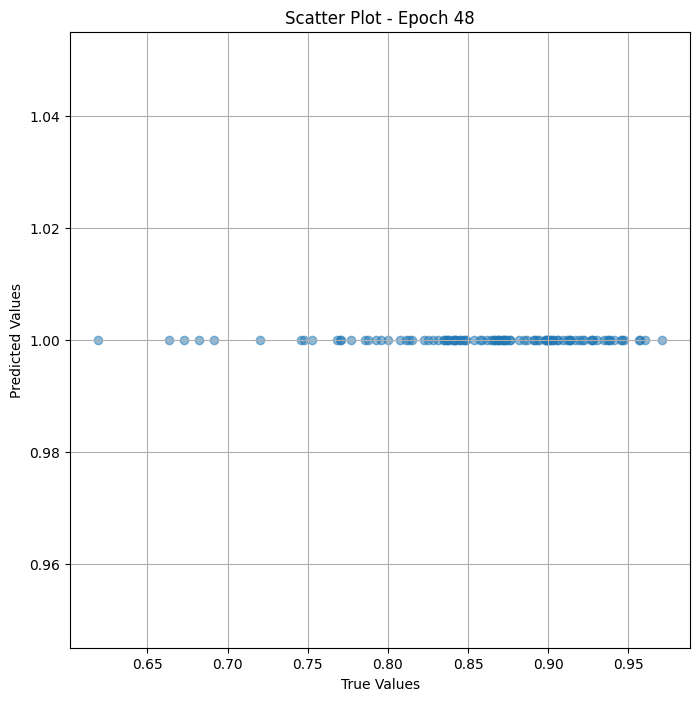

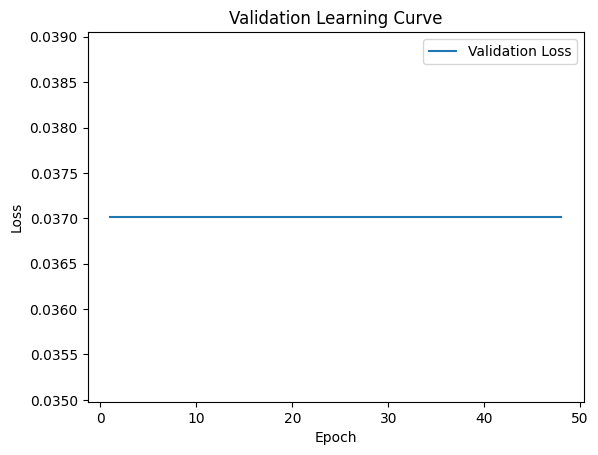


 Epoch: (49/50) Loss = 0.03701549395918846

 Epoch: (49/50) Loss_rmse = 0.19239410758018494

 Epoch: (49/50) R^2 = -1.9556353092193604

 Epoch: (49/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

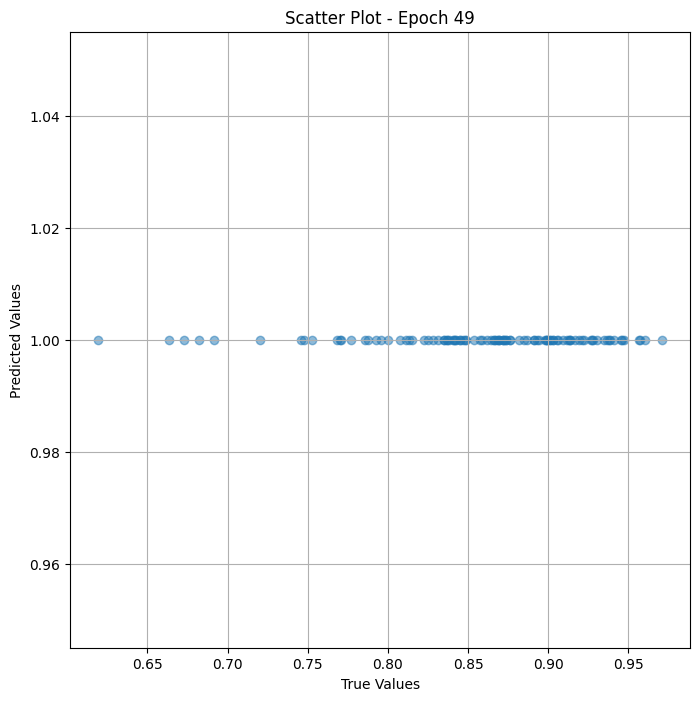

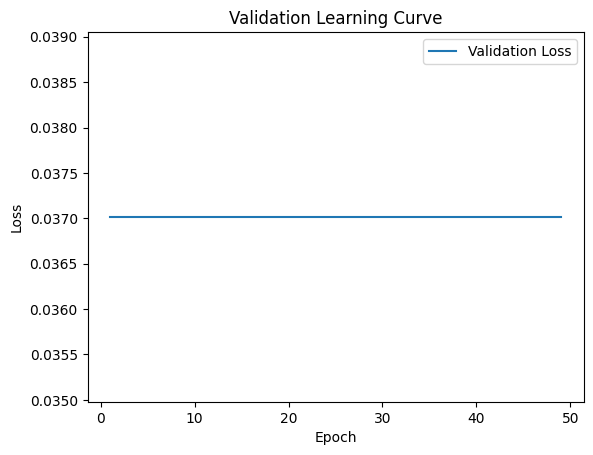


 Epoch: (50/50) Loss = 0.03701549395918846

 Epoch: (50/50) Loss_rmse = 0.19239410758018494

 Epoch: (50/50) R^2 = -1.9556353092193604

 Epoch: (50/50) MAE = 0.15649853646755219
Spearman correlation coefficient: SignificanceResult(statistic=nan, pvalue=nan)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.913461

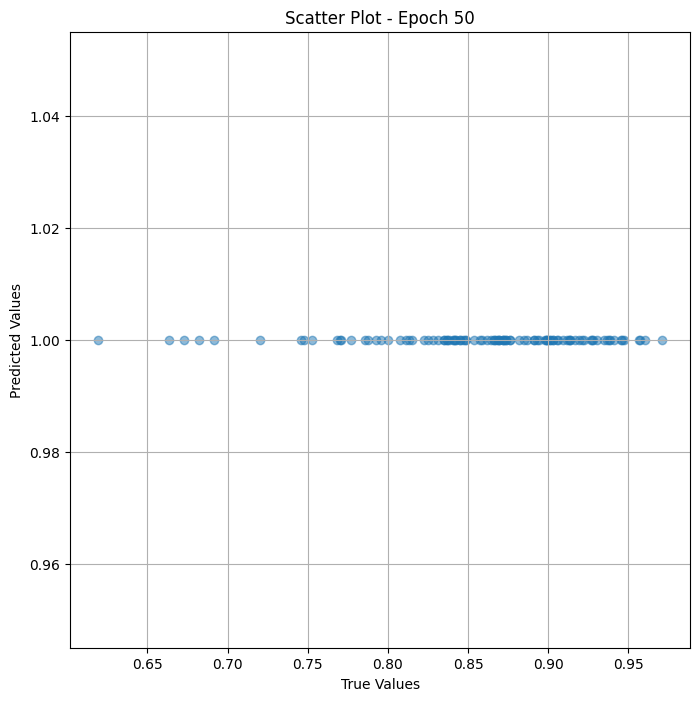

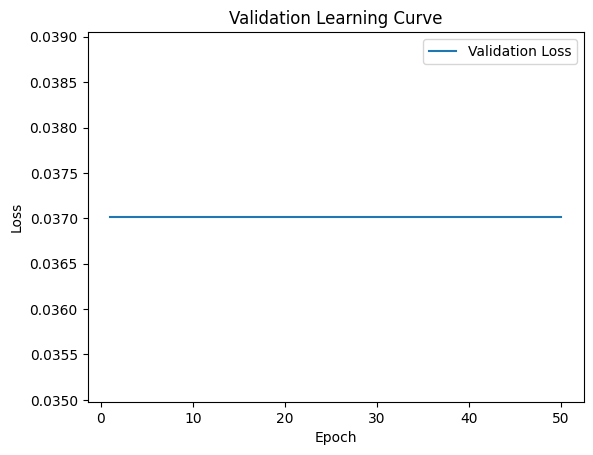

In [ ]:
# Training the model and save weights
fit(50, model_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_vr_val")

## Test

In [ ]:
class Dataset_test_food(Dataset):
    def __init__(self, df, trans_transform=None, res_transform=None):
        self.labels = df["memoscore"]
        self.images = df["preprocessed_image_path"]
        self.trans_transform = trans_transform
        self.res_transform = res_transform

    def __len__ (self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(np.array(image), return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        image_res = self.res_transform(image)


        label = self.labels[idx]

        return image_trans, image_res, label

trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
res_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0]),
])


train_ds = Dataset_test_food(df_test_food, trans_transform=trans_transform, res_transform=res_transform)
train_dl_test = DataLoader(train_ds, batch_size=16, shuffle= False)

In [ ]:
# Modify the model - ResNet
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
count = 0
for child in model_Res.children():
    count += 1
    if count < 8:
        for param in child.parameters():
            param.requires_grad = False

print(model_Res )


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)


In [ ]:
# Modify the model - ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = False

layers_trans = list(model_trans.children()) # Get all the layers from the Transformer model
model_trans_top = nn.Sequential(*layers_trans[:-2]) # Remove the normalization layer and pooler layer
trans_layer_norm = list(model_trans.children())[2] # Get the normalization layer
mymodel = nn.Sigmoid()

In [ ]:
# Merge the two models
class model_merge_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_test = model_merge_test(model_trans_top, trans_layer_norm, model_Res,mymodel )
#model.load_state_dict(torch.load('model_weights'))

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_test = to_device(model_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_test.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_test, train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_test(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)



 Epoch: (1/50) Loss = 0.16086933016777039

 Epoch: (1/50) Loss_rmse = 0.4010851979255676

 Epoch: (1/50) R^2 = -147.31436157226562

 Epoch: (1/50) MAE = 0.3244234621524811

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.868686

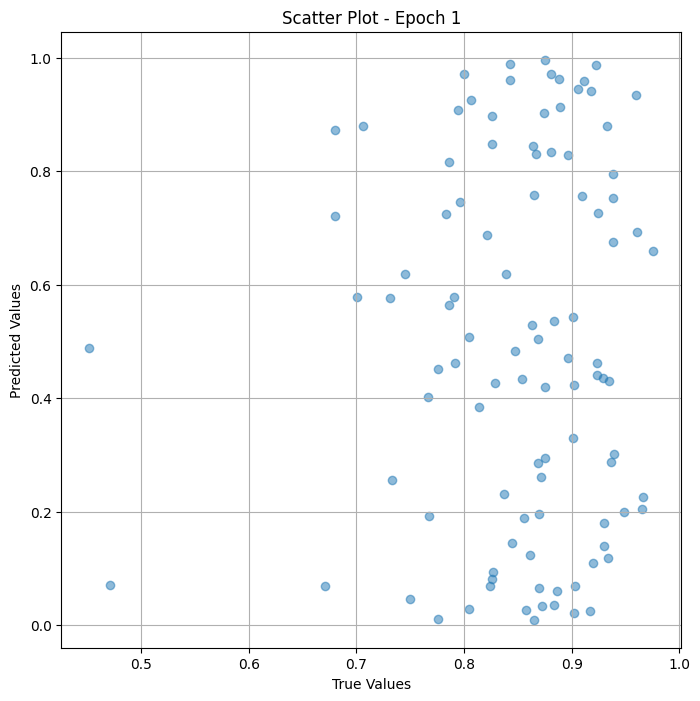


 Epoch: (2/50) Loss = 0.04429977014660835

 Epoch: (2/50) Loss_rmse = 0.2104751020669937

 Epoch: (2/50) R^2 = -39.84241485595703

 Epoch: (2/50) MAE = 0.16881172358989716

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.868686

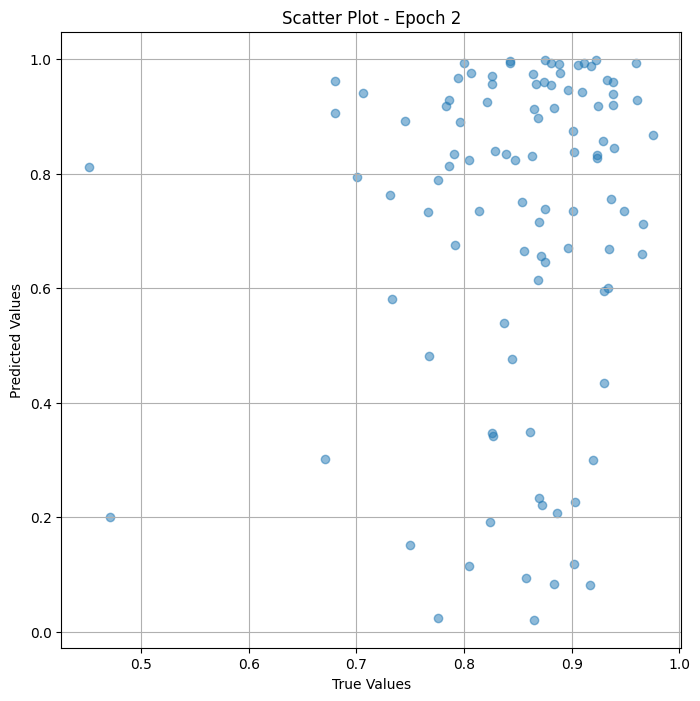


 Epoch: (3/50) Loss = 0.016870832070708275

 Epoch: (3/50) Loss_rmse = 0.12988777458667755

 Epoch: (3/50) R^2 = -14.554155349731445

 Epoch: (3/50) MAE = 0.11465984582901001

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.868

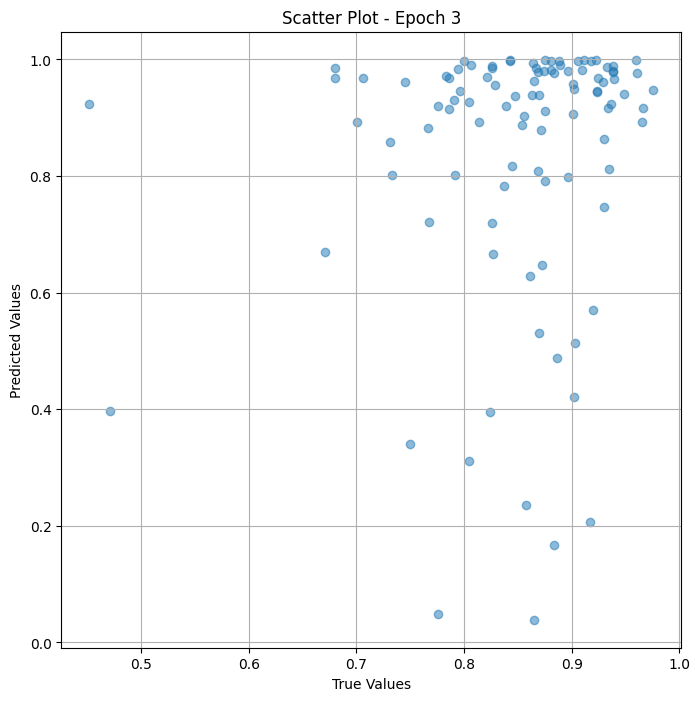


 Epoch: (4/50) Loss = 0.020210733637213707

 Epoch: (4/50) Loss_rmse = 0.1421644538640976

 Epoch: (4/50) R^2 = -17.63339614868164

 Epoch: (4/50) MAE = 0.13419517874717712

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.86868

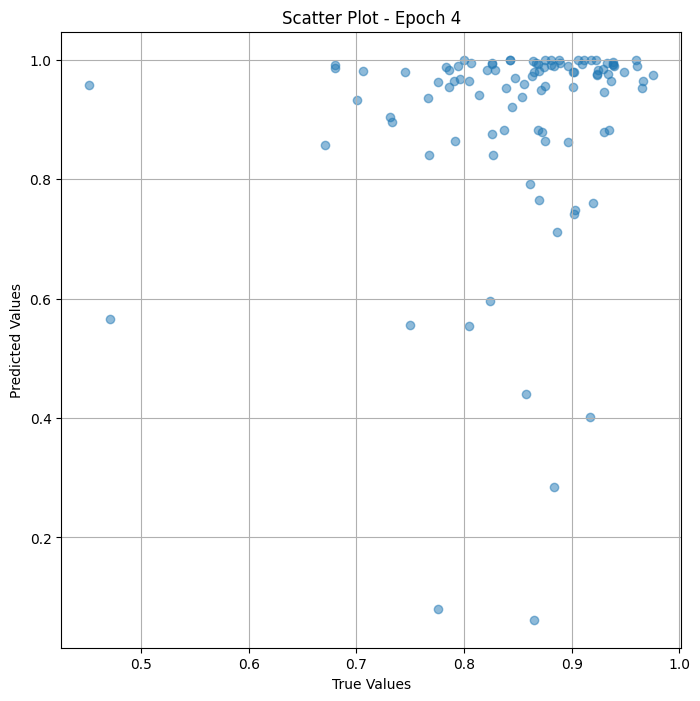


 Epoch: (5/50) Loss = 0.022260624915361404

 Epoch: (5/50) Loss_rmse = 0.1491999477148056

 Epoch: (5/50) R^2 = -19.523303985595703

 Epoch: (5/50) MAE = 0.14401337504386902

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

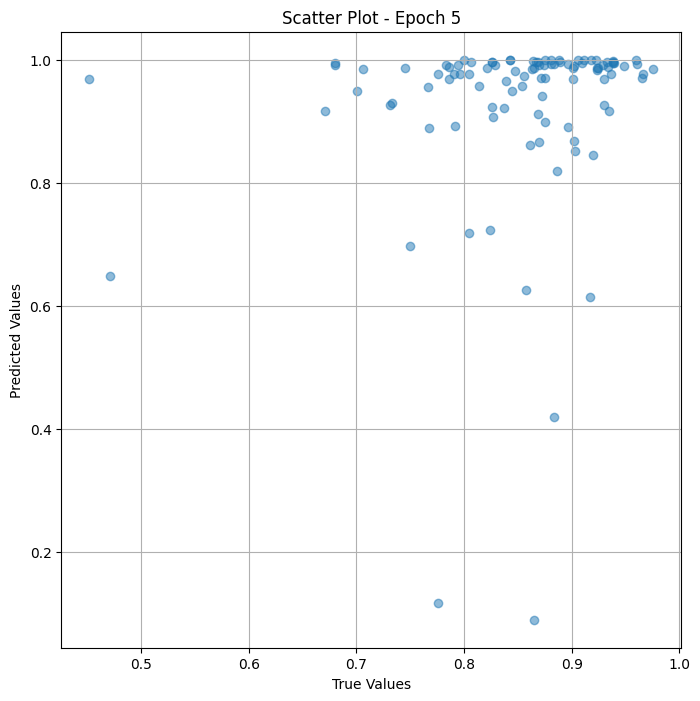


 Epoch: (6/50) Loss = 0.02302466705441475

 Epoch: (6/50) Loss_rmse = 0.15173880755901337

 Epoch: (6/50) R^2 = -20.227718353271484

 Epoch: (6/50) MAE = 0.14722485840320587

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

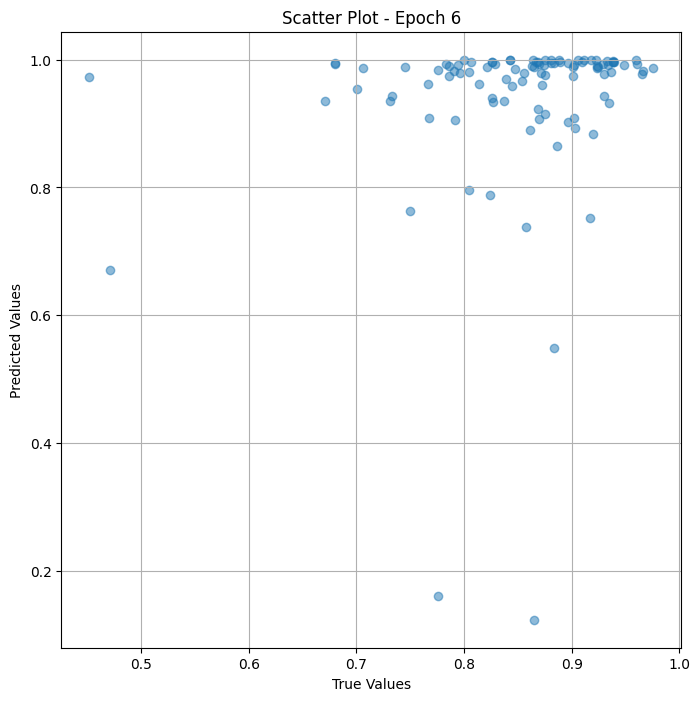


 Epoch: (7/50) Loss = 0.023188896477222443

 Epoch: (7/50) Loss_rmse = 0.15227900445461273

 Epoch: (7/50) R^2 = -20.37912940979004

 Epoch: (7/50) MAE = 0.14794617891311646

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

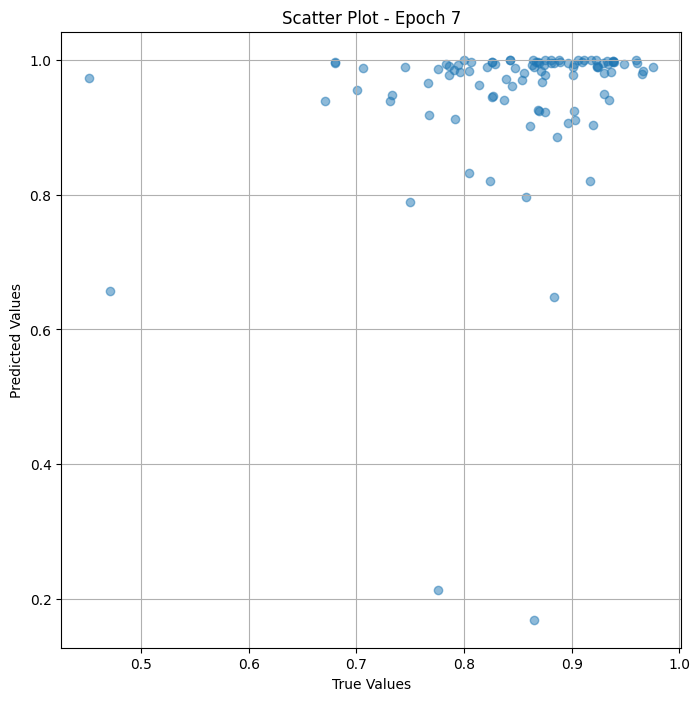


 Epoch: (8/50) Loss = 0.02304321900010109

 Epoch: (8/50) Loss_rmse = 0.15179993212223053

 Epoch: (8/50) R^2 = -20.244821548461914

 Epoch: (8/50) MAE = 0.1474507451057434

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.86868

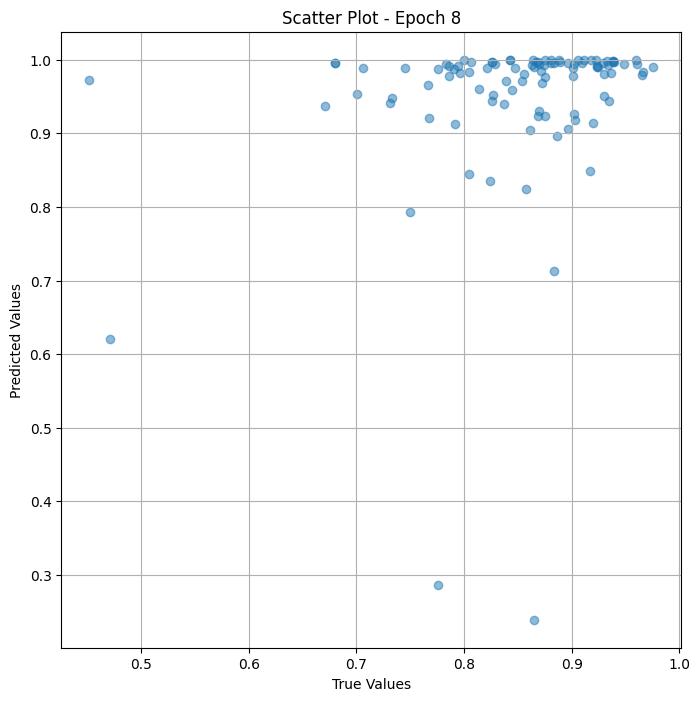


 Epoch: (9/50) Loss = 0.022705214098095894

 Epoch: (9/50) Loss_rmse = 0.1506824940443039

 Epoch: (9/50) R^2 = -19.933195114135742

 Epoch: (9/50) MAE = 0.14618560671806335

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

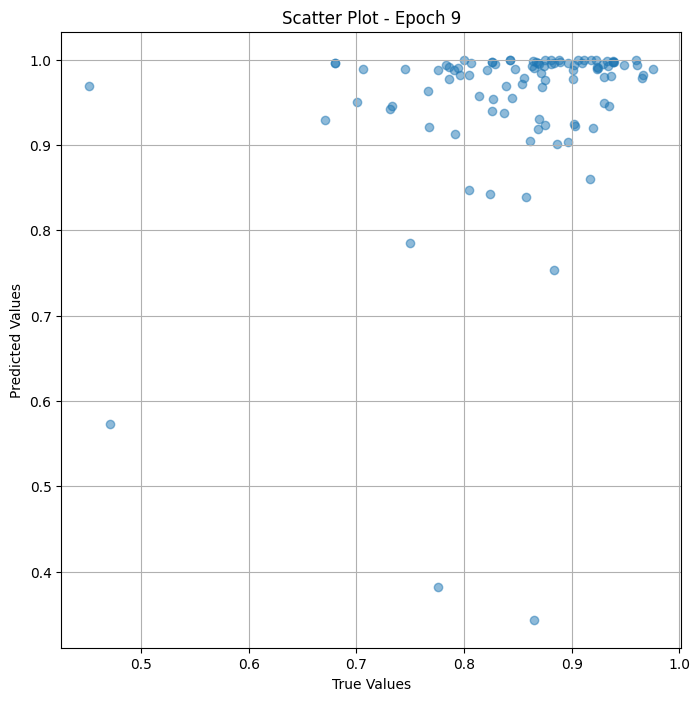


 Epoch: (10/50) Loss = 0.022203315049409866

 Epoch: (10/50) Loss_rmse = 0.14900776743888855

 Epoch: (10/50) R^2 = -19.47046661376953

 Epoch: (10/50) MAE = 0.14422665536403656

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.

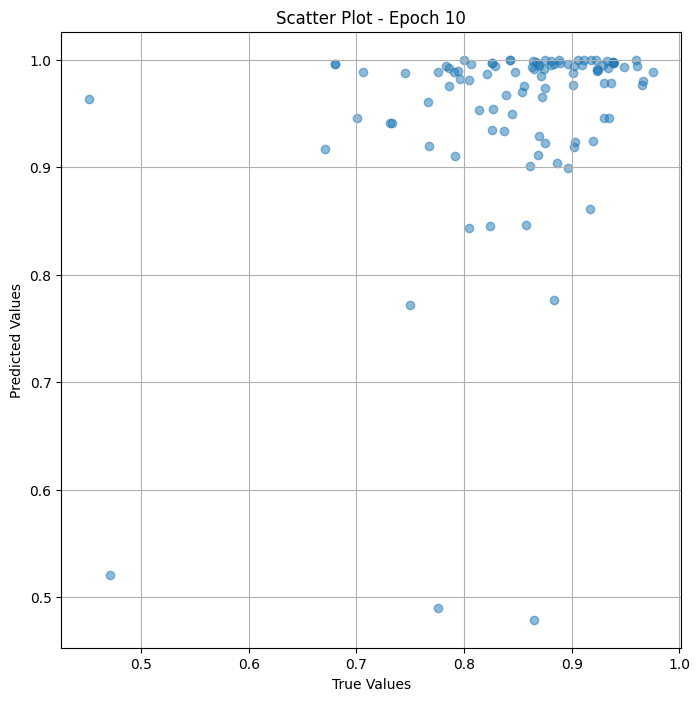


 Epoch: (11/50) Loss = 0.021505750715732574

 Epoch: (11/50) Loss_rmse = 0.14664839208126068

 Epoch: (11/50) R^2 = -18.82734489440918

 Epoch: (11/50) MAE = 0.1413906216621399

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8

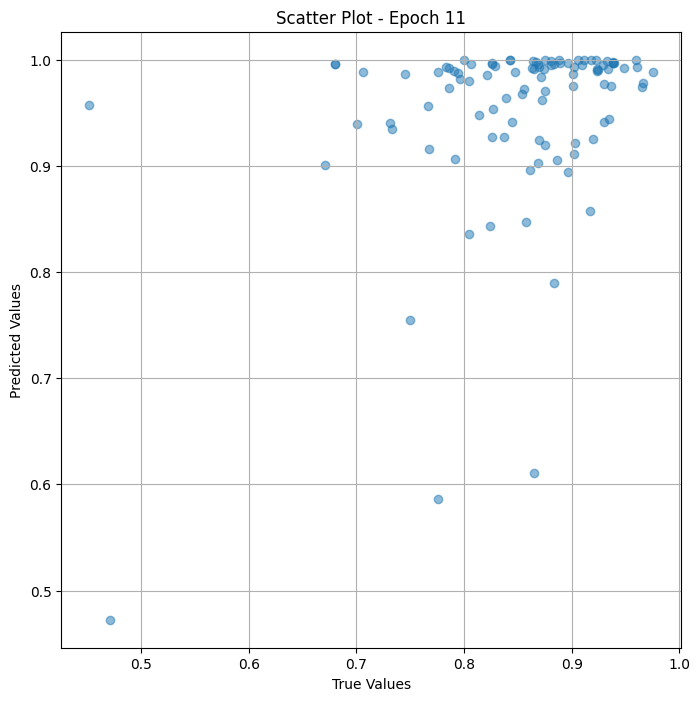


 Epoch: (12/50) Loss = 0.020556185394525528

 Epoch: (12/50) Loss_rmse = 0.1433742791414261

 Epoch: (12/50) R^2 = -17.951887130737305

 Epoch: (12/50) MAE = 0.1373339742422104

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8

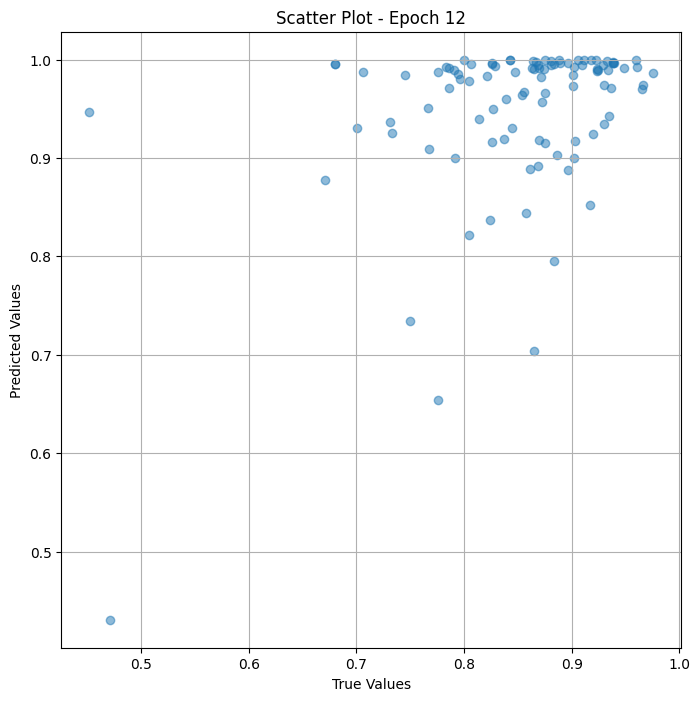


 Epoch: (13/50) Loss = 0.019312052056193352

 Epoch: (13/50) Loss_rmse = 0.13896781206130981

 Epoch: (13/50) R^2 = -16.804851531982422

 Epoch: (13/50) MAE = 0.13165664672851562

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

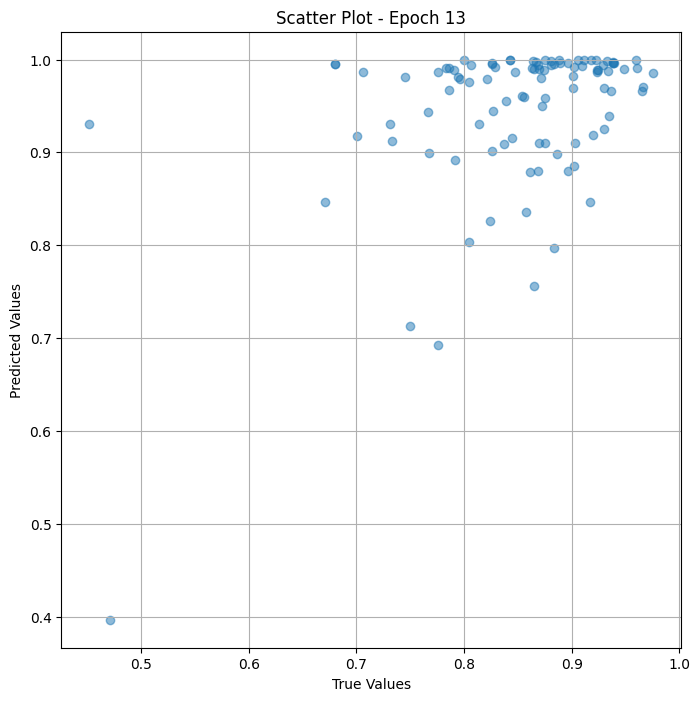


 Epoch: (14/50) Loss = 0.017757734283804893

 Epoch: (14/50) Loss_rmse = 0.1332581490278244

 Epoch: (14/50) R^2 = -15.37183952331543

 Epoch: (14/50) MAE = 0.12395283579826355

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8

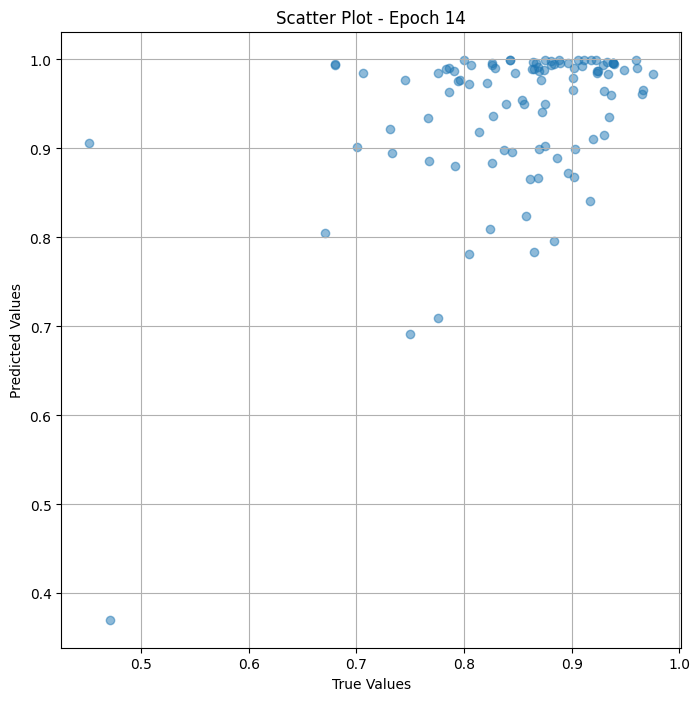


 Epoch: (15/50) Loss = 0.01589161716401577

 Epoch: (15/50) Loss_rmse = 0.12606196105480194

 Epoch: (15/50) R^2 = -13.651363372802734

 Epoch: (15/50) MAE = 0.1138983964920044

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8

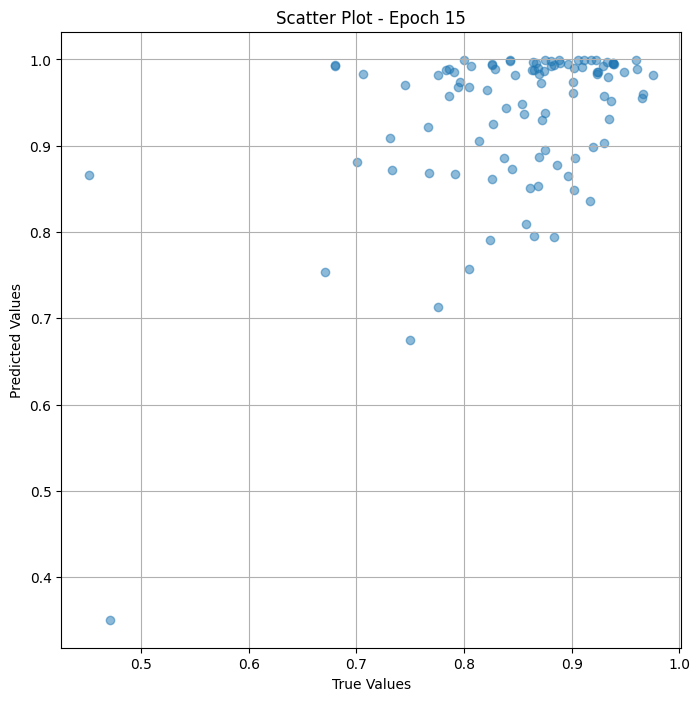


 Epoch: (16/50) Loss = 0.013661515899002552

 Epoch: (16/50) Loss_rmse = 0.11688248813152313

 Epoch: (16/50) R^2 = -11.595309257507324

 Epoch: (16/50) MAE = 0.10138428211212158

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

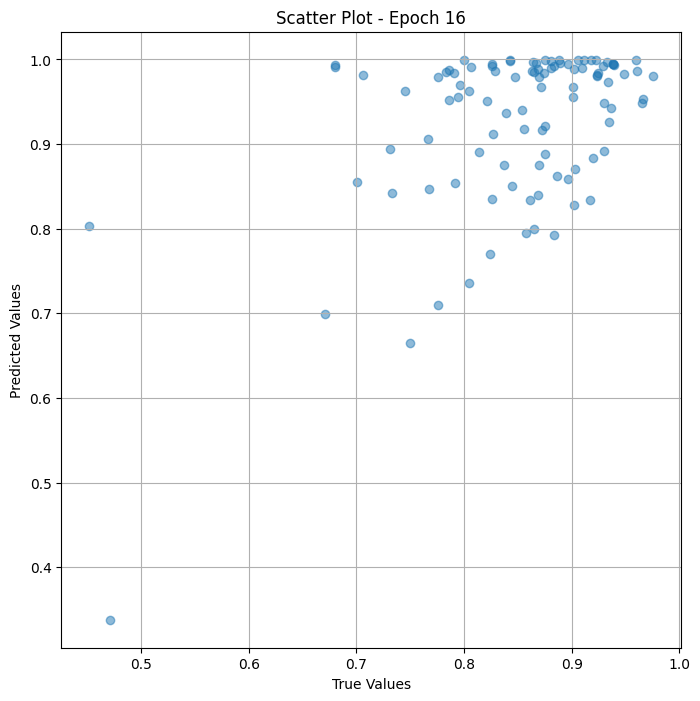


 Epoch: (17/50) Loss = 0.010881958529353142

 Epoch: (17/50) Loss_rmse = 0.10431662946939468

 Epoch: (17/50) R^2 = -9.032681465148926

 Epoch: (17/50) MAE = 0.09243497252464294

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.

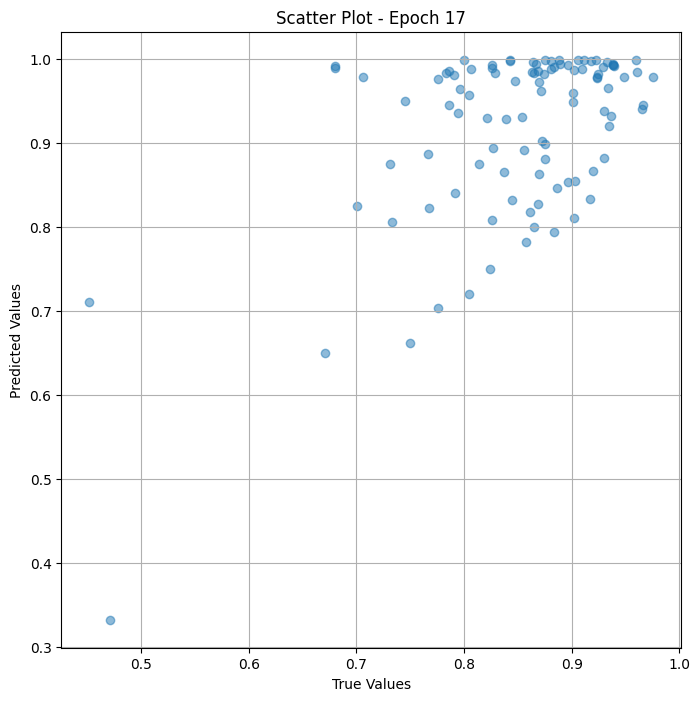


 Epoch: (18/50) Loss = 0.007444825489073992

 Epoch: (18/50) Loss_rmse = 0.08628340065479279

 Epoch: (18/50) R^2 = -5.863797664642334

 Epoch: (18/50) MAE = 0.07856632769107819

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.

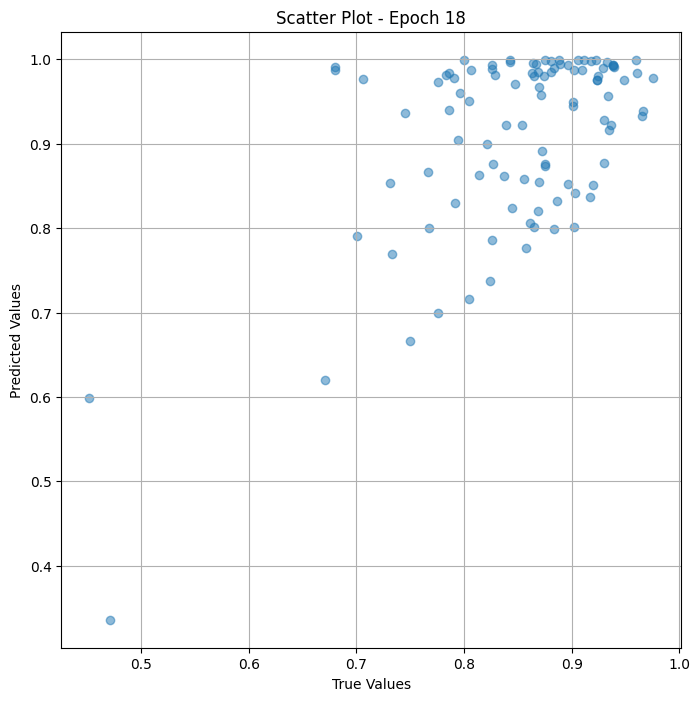


 Epoch: (19/50) Loss = 0.004101571626961231

 Epoch: (19/50) Loss_rmse = 0.06404351443052292

 Epoch: (19/50) R^2 = -2.781466245651245

 Epoch: (19/50) MAE = 0.0555415004491806

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8

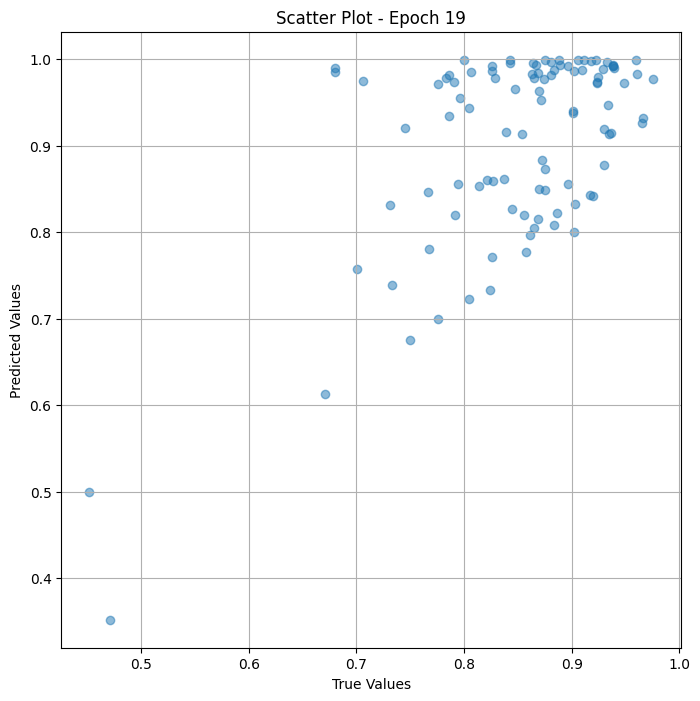


 Epoch: (20/50) Loss = 0.0026654971297830343

 Epoch: (20/50) Loss_rmse = 0.05162845179438591

 Epoch: (20/50) R^2 = -1.4574697017669678

 Epoch: (20/50) MAE = 0.02898278832435608

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

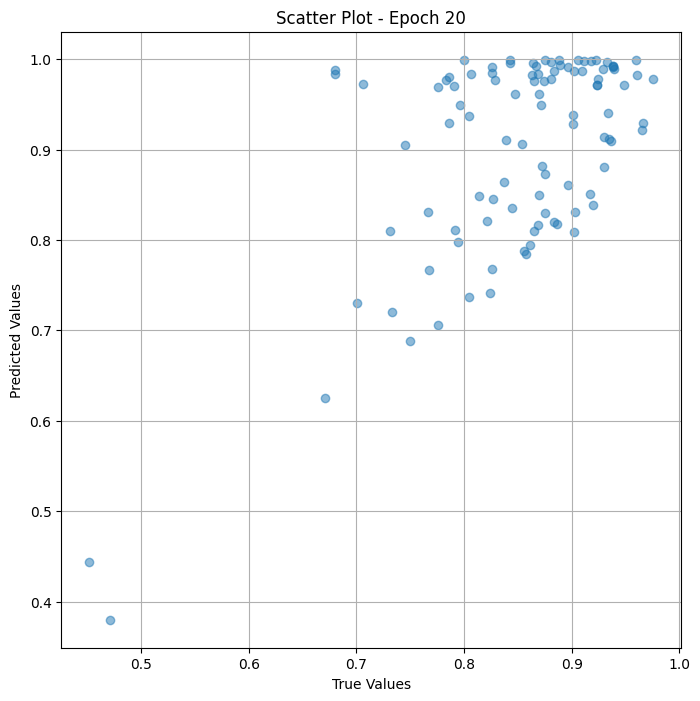


 Epoch: (21/50) Loss = 0.0028890434186905622

 Epoch: (21/50) Loss_rmse = 0.053749822080135345

 Epoch: (21/50) R^2 = -1.663569450378418

 Epoch: (21/50) MAE = 0.037140995264053345

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

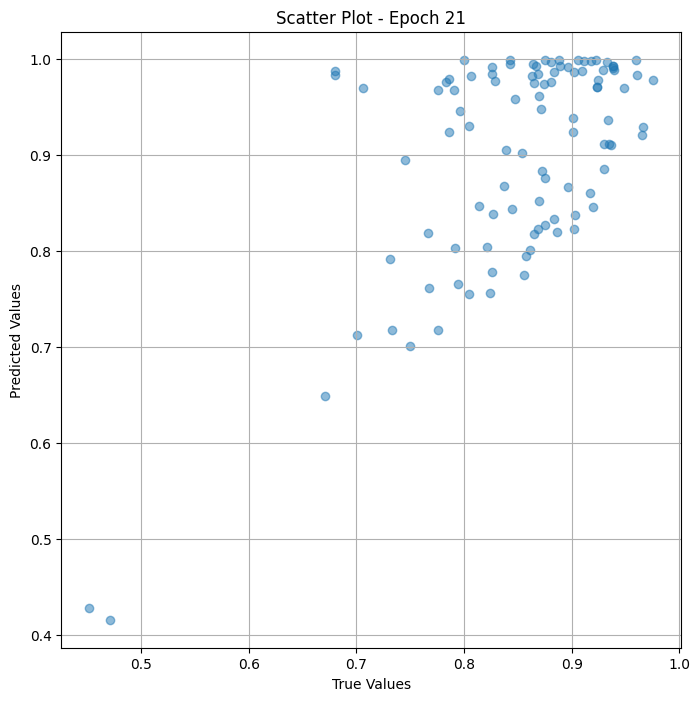


 Epoch: (22/50) Loss = 0.002703696023672819

 Epoch: (22/50) Loss_rmse = 0.05199707671999931

 Epoch: (22/50) R^2 = -1.4926872253417969

 Epoch: (22/50) MAE = 0.03378939628601074

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

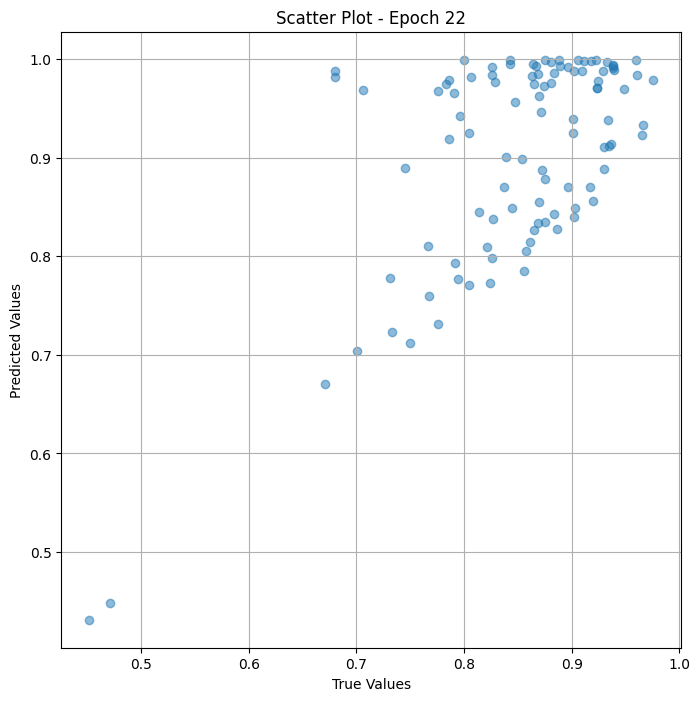


 Epoch: (23/50) Loss = 0.0025679541286081076

 Epoch: (23/50) Loss_rmse = 0.050674986094236374

 Epoch: (23/50) R^2 = -1.367539405822754

 Epoch: (23/50) MAE = 0.027659699320793152

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

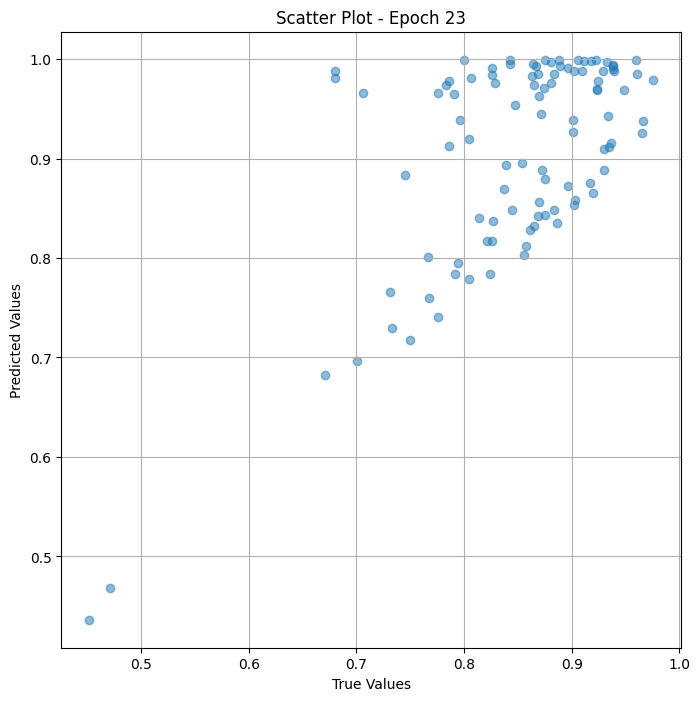


 Epoch: (24/50) Loss = 0.002508654026314616

 Epoch: (24/50) Loss_rmse = 0.05008646473288536

 Epoch: (24/50) R^2 = -1.3128671646118164

 Epoch: (24/50) MAE = 0.027729466557502747

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

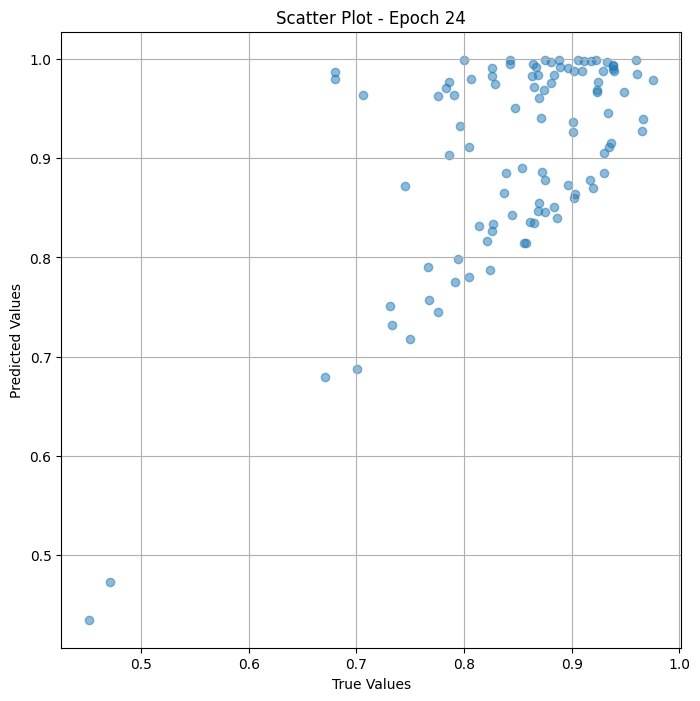


 Epoch: (25/50) Loss = 0.002449909457936883

 Epoch: (25/50) Loss_rmse = 0.04949656128883362

 Epoch: (25/50) R^2 = -1.2587072849273682

 Epoch: (25/50) MAE = 0.02902284264564514

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

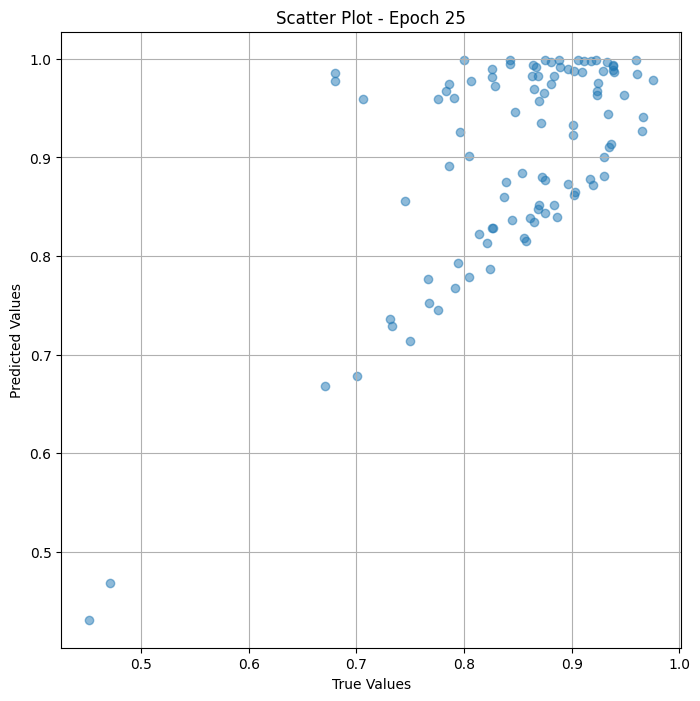


 Epoch: (26/50) Loss = 0.002395899733528495

 Epoch: (26/50) Loss_rmse = 0.048947930335998535

 Epoch: (26/50) R^2 = -1.2089128494262695

 Epoch: (26/50) MAE = 0.031172335147857666

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

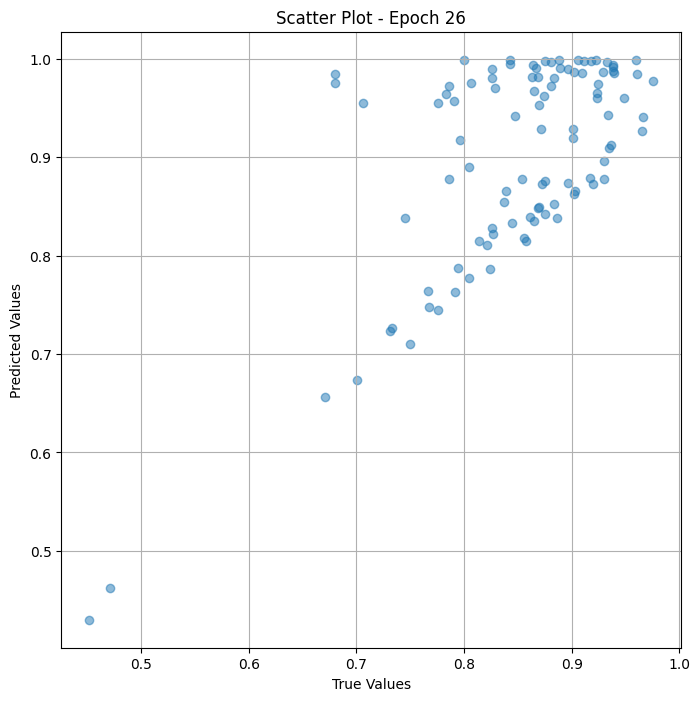


 Epoch: (27/50) Loss = 0.002292393473908305

 Epoch: (27/50) Loss_rmse = 0.047878947108983994

 Epoch: (27/50) R^2 = -1.1134846210479736

 Epoch: (27/50) MAE = 0.030175969004631042

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

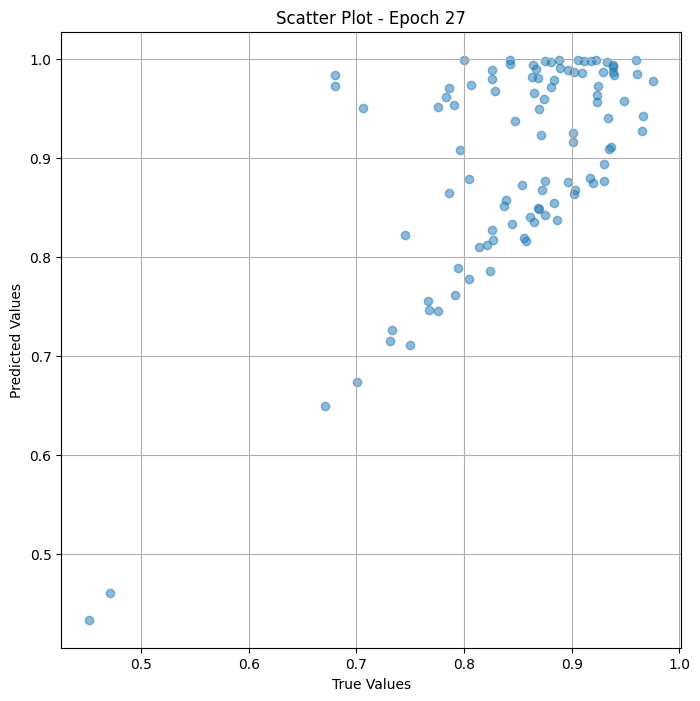


 Epoch: (28/50) Loss = 0.0021613147109746933

 Epoch: (28/50) Loss_rmse = 0.04648994281888008

 Epoch: (28/50) R^2 = -0.9926358461380005

 Epoch: (28/50) MAE = 0.02803725004196167

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

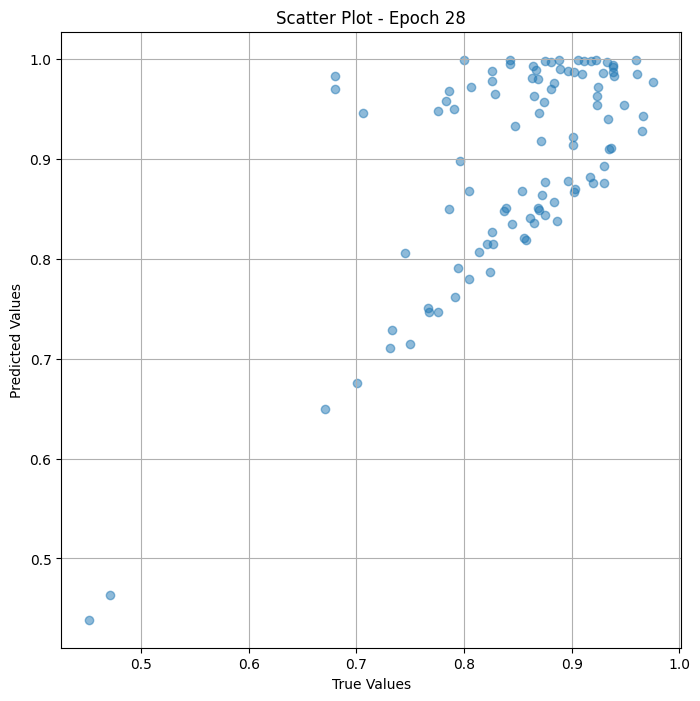


 Epoch: (29/50) Loss = 0.0020191518124192953

 Epoch: (29/50) Loss_rmse = 0.04493497312068939

 Epoch: (29/50) R^2 = -0.8615679740905762

 Epoch: (29/50) MAE = 0.026627615094184875

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

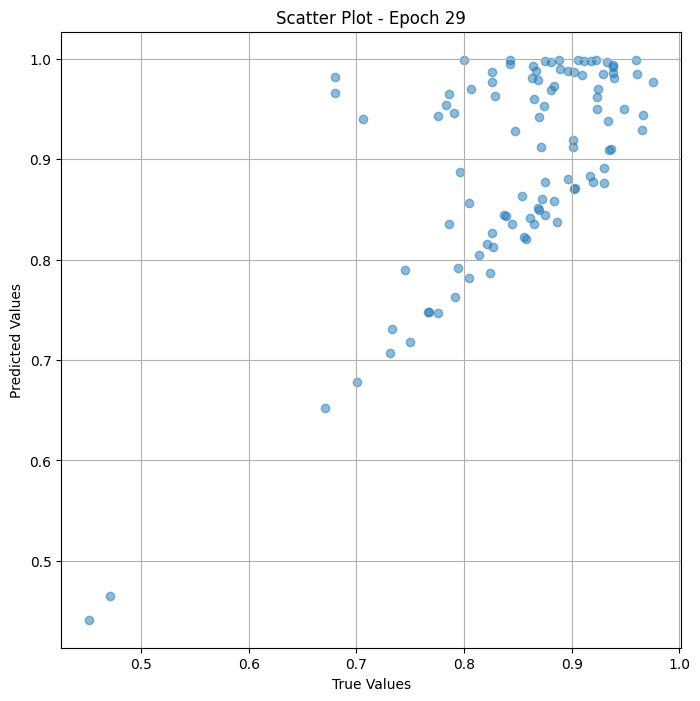


 Epoch: (30/50) Loss = 0.001857313676737249

 Epoch: (30/50) Loss_rmse = 0.04309656098484993

 Epoch: (30/50) R^2 = -0.7123605012893677

 Epoch: (30/50) MAE = 0.025857344269752502

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

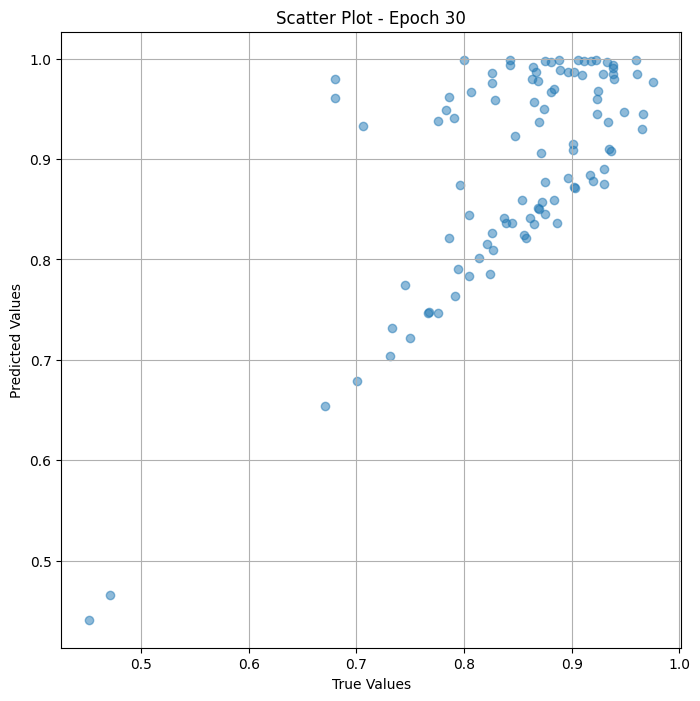


 Epoch: (31/50) Loss = 0.0016657469095662236

 Epoch: (31/50) Loss_rmse = 0.04081356152892113

 Epoch: (31/50) R^2 = -0.5357444286346436

 Epoch: (31/50) MAE = 0.024762317538261414

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

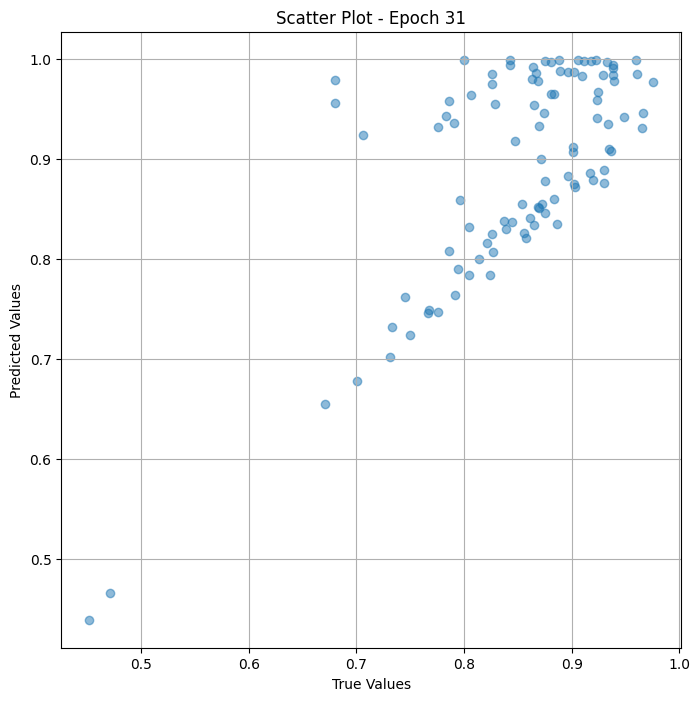


 Epoch: (32/50) Loss = 0.0014388847630470991

 Epoch: (32/50) Loss_rmse = 0.037932634353637695

 Epoch: (32/50) R^2 = -0.3265876770019531

 Epoch: (32/50) MAE = 0.02296927571296692

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

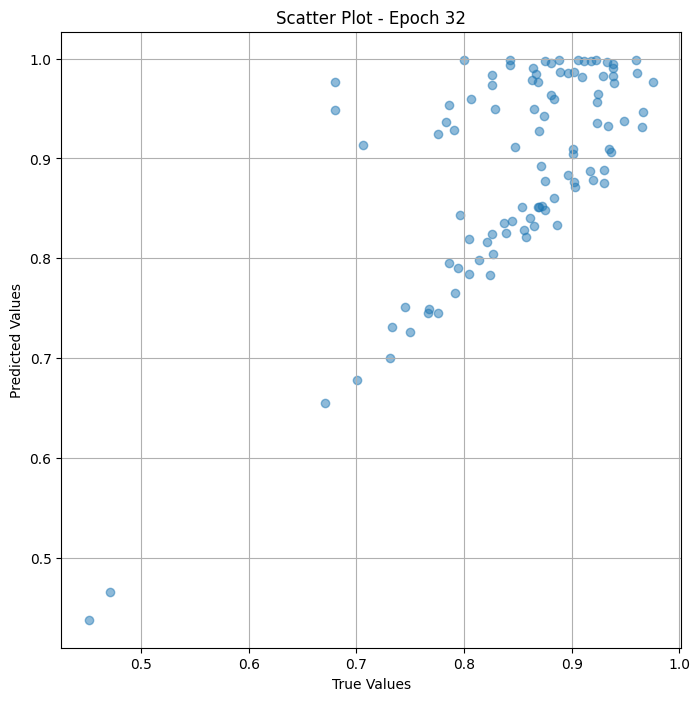


 Epoch: (33/50) Loss = 0.0011788856936618686

 Epoch: (33/50) Loss_rmse = 0.034334905445575714

 Epoch: (33/50) R^2 = -0.08688008785247803

 Epoch: (33/50) MAE = 0.020786315202713013

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

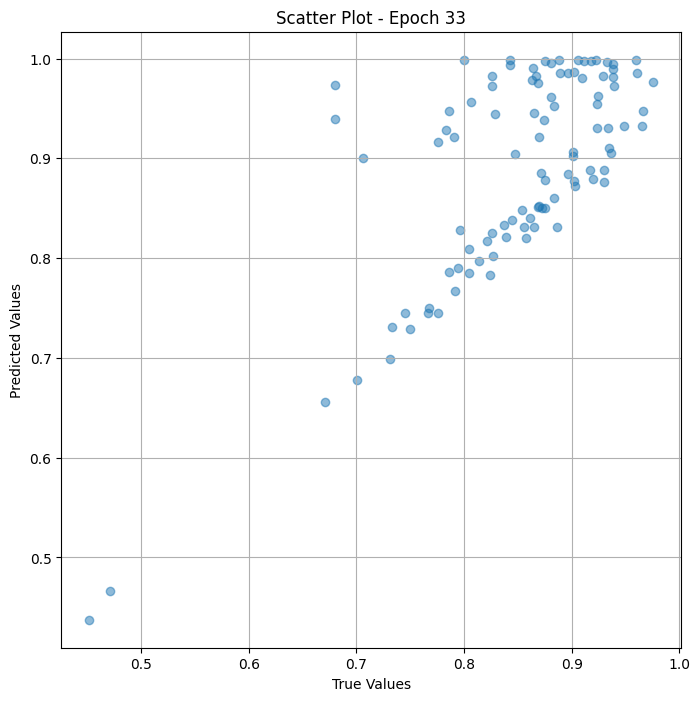


 Epoch: (34/50) Loss = 0.0008927477756515145

 Epoch: (34/50) Loss_rmse = 0.029878884553909302

 Epoch: (34/50) R^2 = 0.17692631483078003

 Epoch: (34/50) MAE = 0.0184624046087265

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

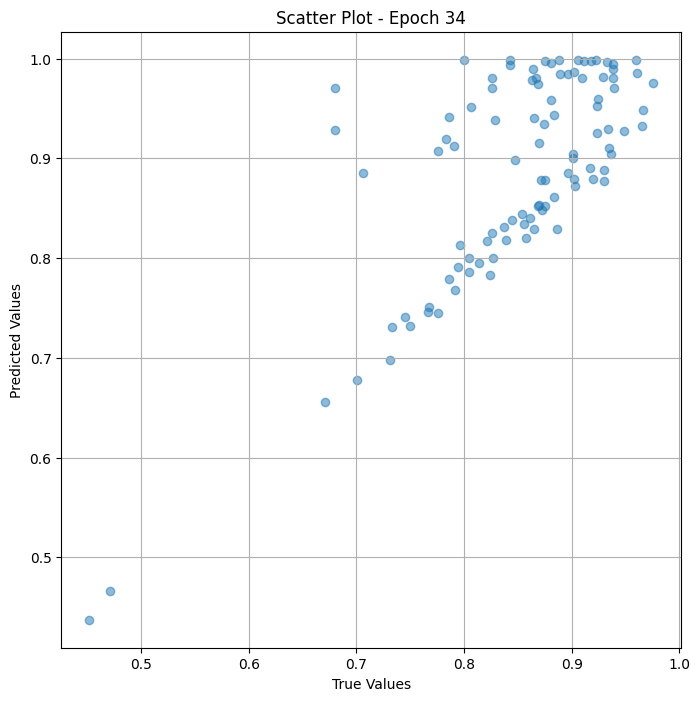


 Epoch: (35/50) Loss = 0.0005980688147246838

 Epoch: (35/50) Loss_rmse = 0.024455444887280464

 Epoch: (35/50) R^2 = 0.4486072063446045

 Epoch: (35/50) MAE = 0.01584300398826599

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

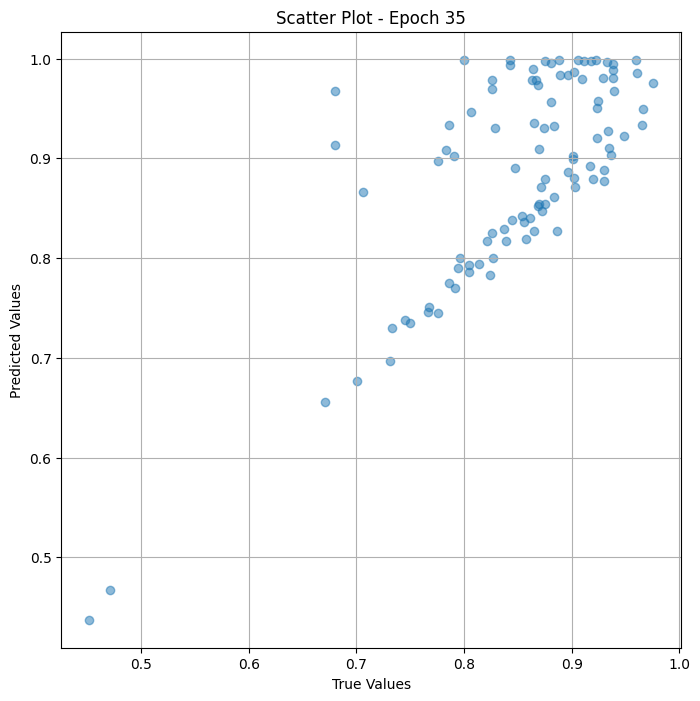


 Epoch: (36/50) Loss = 0.0003299536183476448

 Epoch: (36/50) Loss_rmse = 0.018164625391364098

 Epoch: (36/50) R^2 = 0.6957974433898926

 Epoch: (36/50) MAE = 0.012683317065238953

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

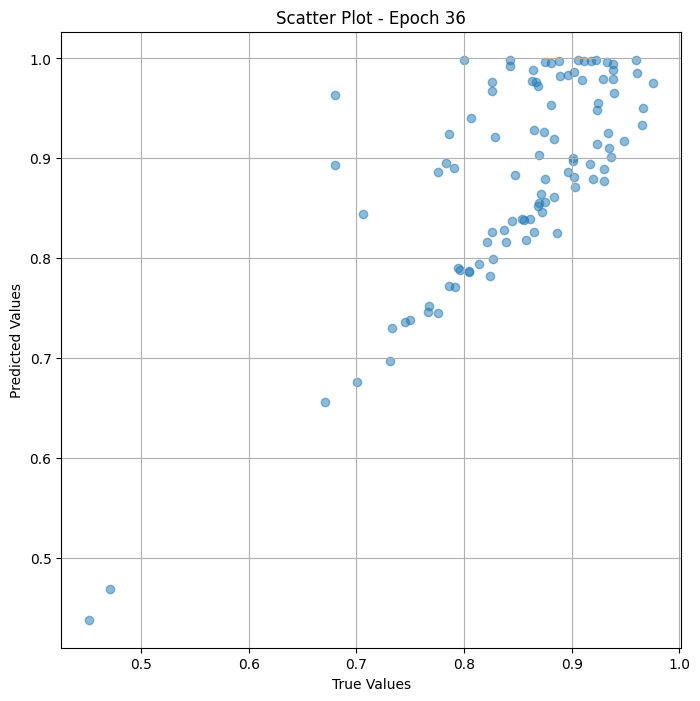


 Epoch: (37/50) Loss = 0.00013402618060354143

 Epoch: (37/50) Loss_rmse = 0.011576967313885689

 Epoch: (37/50) R^2 = 0.8764338493347168

 Epoch: (37/50) MAE = 0.009082287549972534

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307

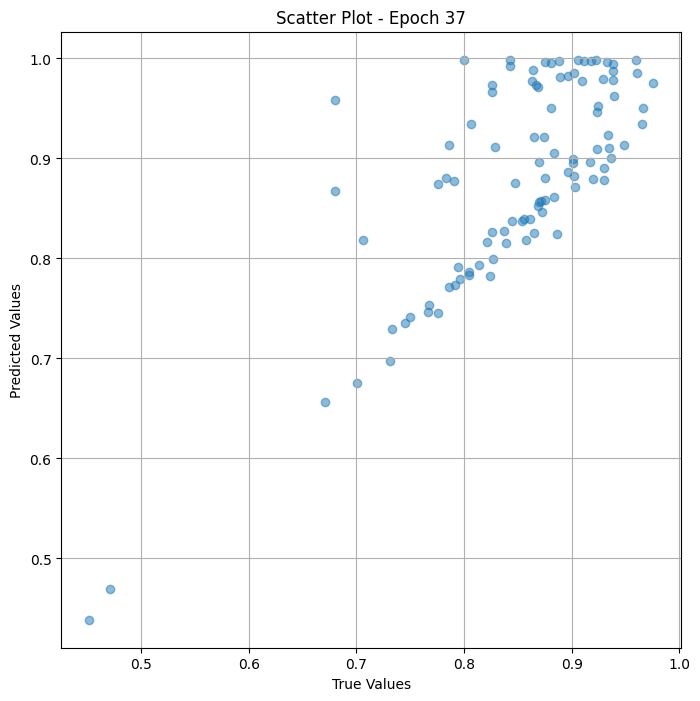


 Epoch: (38/50) Loss = 3.7416917621158063e-05

 Epoch: (38/50) Loss_rmse = 0.006116936914622784

 Epoch: (38/50) R^2 = 0.9655032753944397

 Epoch: (38/50) MAE = 0.005605608224868774

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307

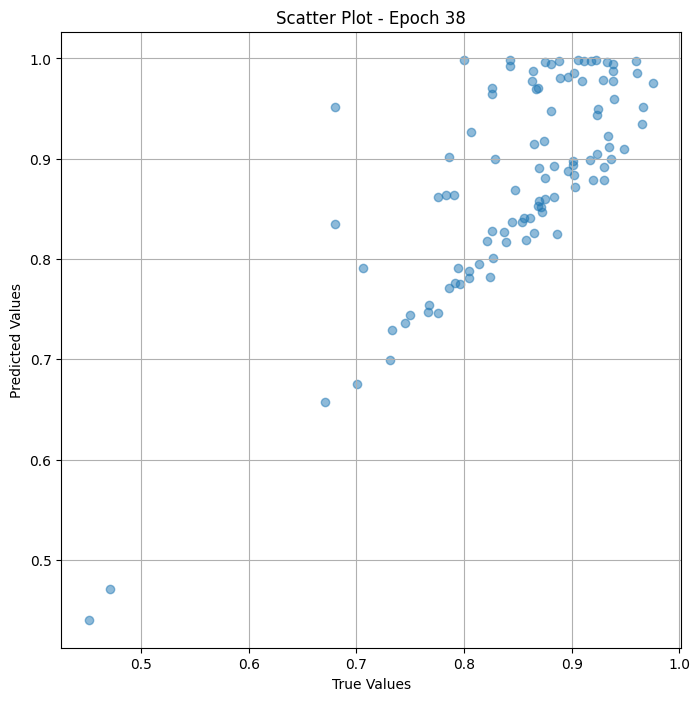


 Epoch: (39/50) Loss = 1.6630121535854414e-05

 Epoch: (39/50) Loss_rmse = 0.0040780045092105865

 Epoch: (39/50) R^2 = 0.9846677780151367

 Epoch: (39/50) MAE = 0.003192037343978882

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

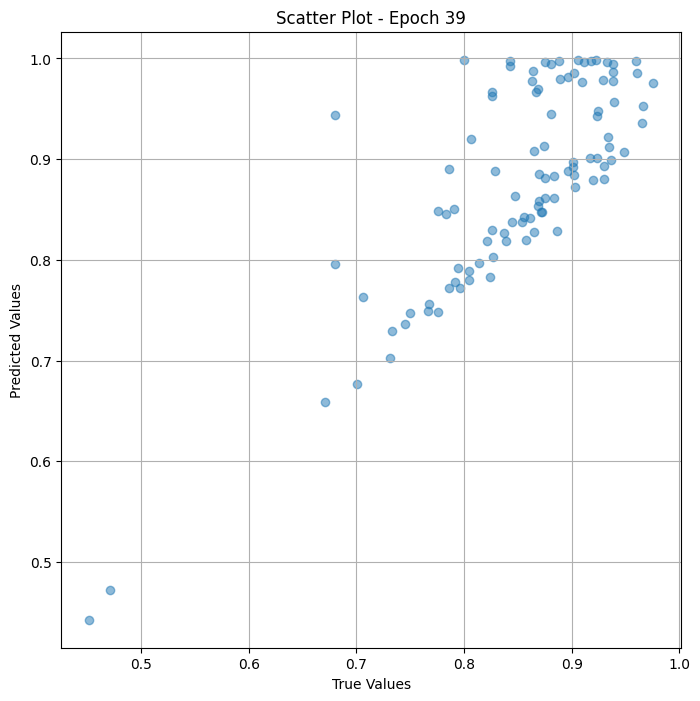


 Epoch: (40/50) Loss = 1.9118289856123738e-05

 Epoch: (40/50) Loss_rmse = 0.004372446797788143

 Epoch: (40/50) R^2 = 0.9823737740516663

 Epoch: (40/50) MAE = 0.00377771258354187

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

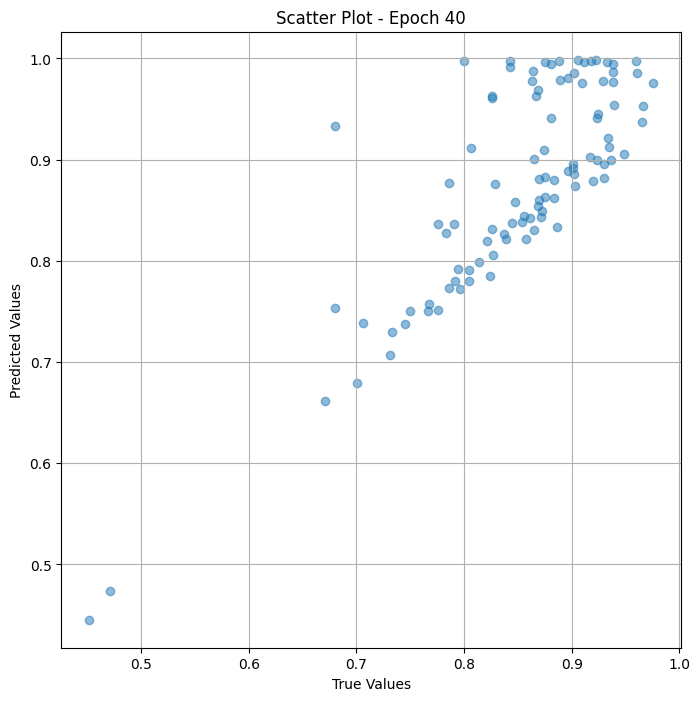


 Epoch: (41/50) Loss = 1.6634276107652113e-05

 Epoch: (41/50) Loss_rmse = 0.004078513942658901

 Epoch: (41/50) R^2 = 0.9846639633178711

 Epoch: (41/50) MAE = 0.0033894330263137817

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

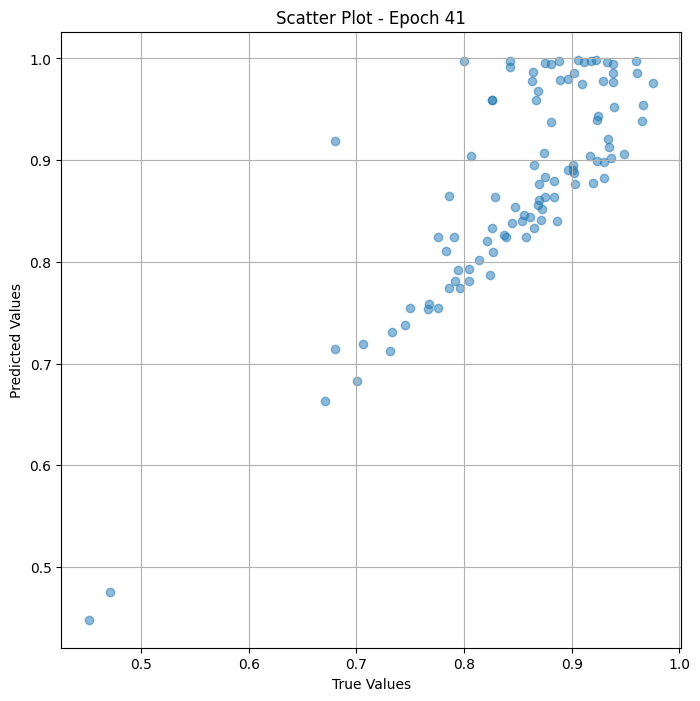


 Epoch: (42/50) Loss = 1.0894745173573028e-05

 Epoch: (42/50) Loss_rmse = 0.0033007189631462097

 Epoch: (42/50) R^2 = 0.9899555444717407

 Epoch: (42/50) MAE = 0.002633005380630493

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

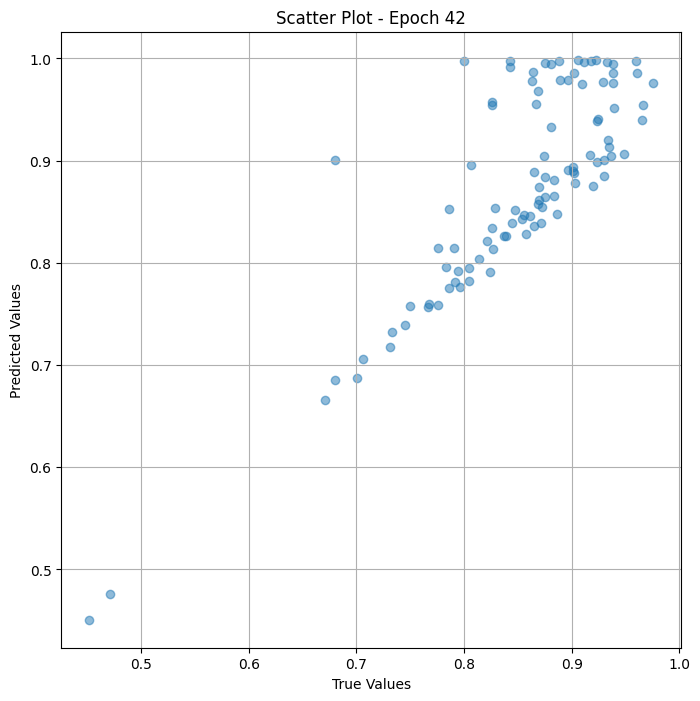


 Epoch: (43/50) Loss = 7.0792257247376256e-06

 Epoch: (43/50) Loss_rmse = 0.0026606814935803413

 Epoch: (43/50) R^2 = 0.9934732913970947

 Epoch: (43/50) MAE = 0.001975834369659424

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

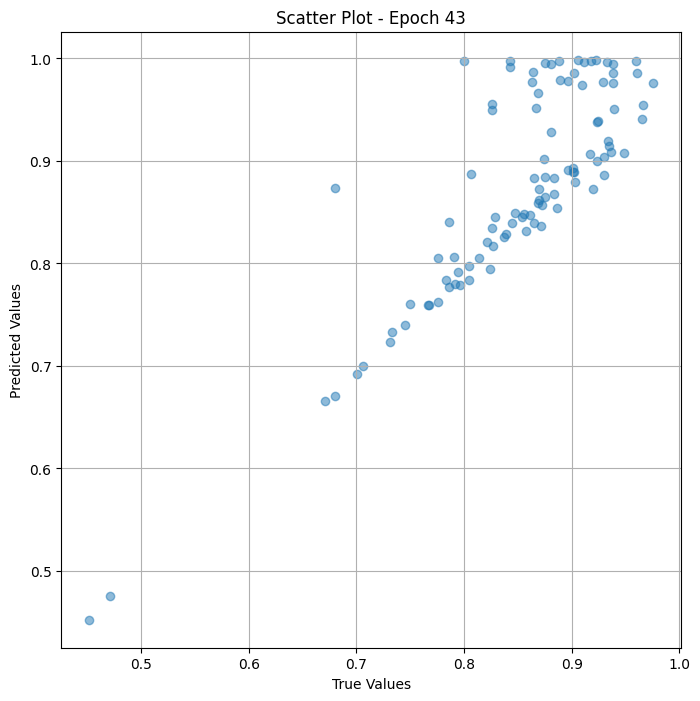


 Epoch: (44/50) Loss = 4.943993189954199e-06

 Epoch: (44/50) Loss_rmse = 0.002223509130999446

 Epoch: (44/50) R^2 = 0.9954418540000916

 Epoch: (44/50) MAE = 0.0016066431999206543

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307

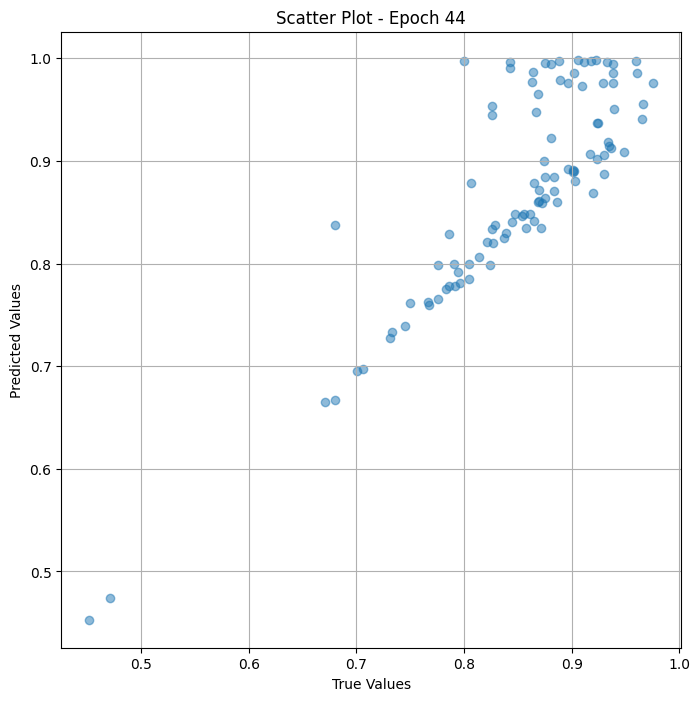


 Epoch: (45/50) Loss = 2.982569185405737e-06

 Epoch: (45/50) Loss_rmse = 0.0017270116368308663

 Epoch: (45/50) R^2 = 0.9972501993179321

 Epoch: (45/50) MAE = 0.0013727843761444092

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

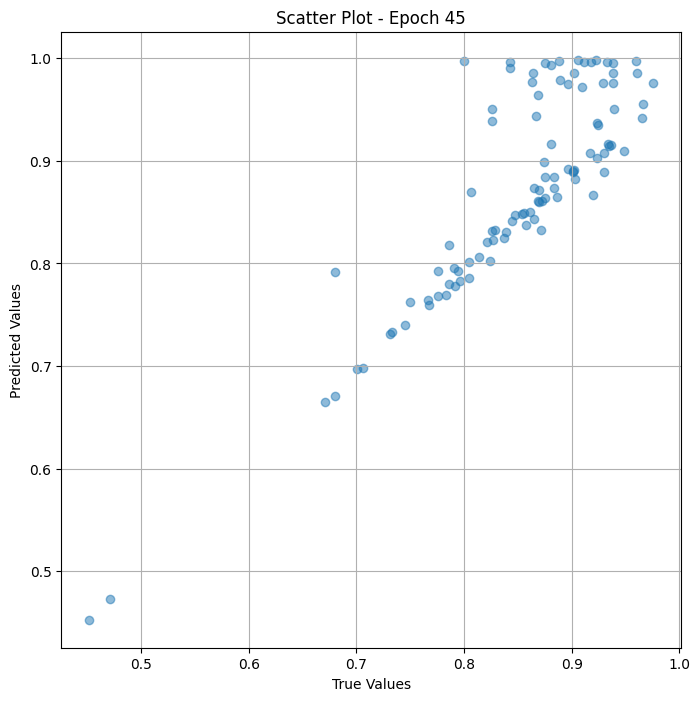


 Epoch: (46/50) Loss = 1.1097554306616075e-06

 Epoch: (46/50) Loss_rmse = 0.0010534493485465646

 Epoch: (46/50) R^2 = 0.9989768266677856

 Epoch: (46/50) MAE = 0.0008669793605804443

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.451923

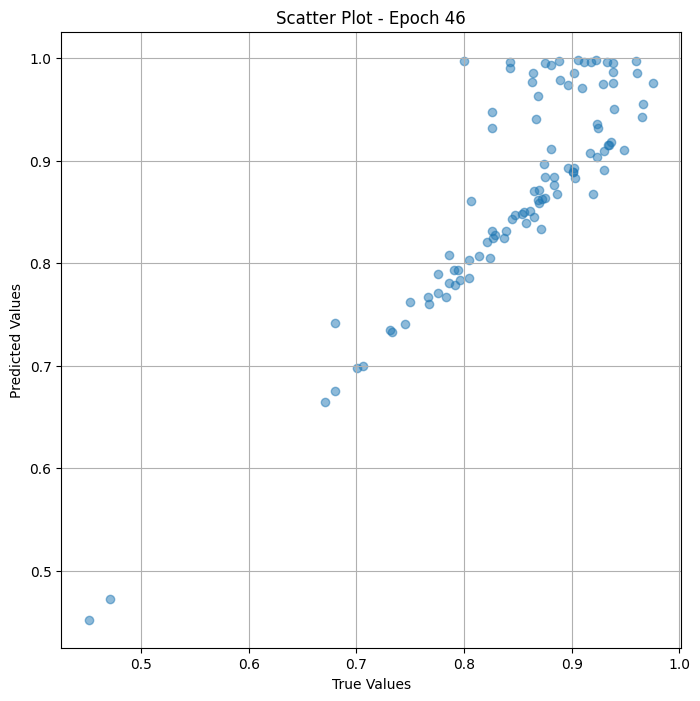


 Epoch: (47/50) Loss = 2.2437819779952406e-07

 Epoch: (47/50) Loss_rmse = 0.0004736857663374394

 Epoch: (47/50) R^2 = 0.9997931122779846

 Epoch: (47/50) MAE = 0.0003813207149505615

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.451923

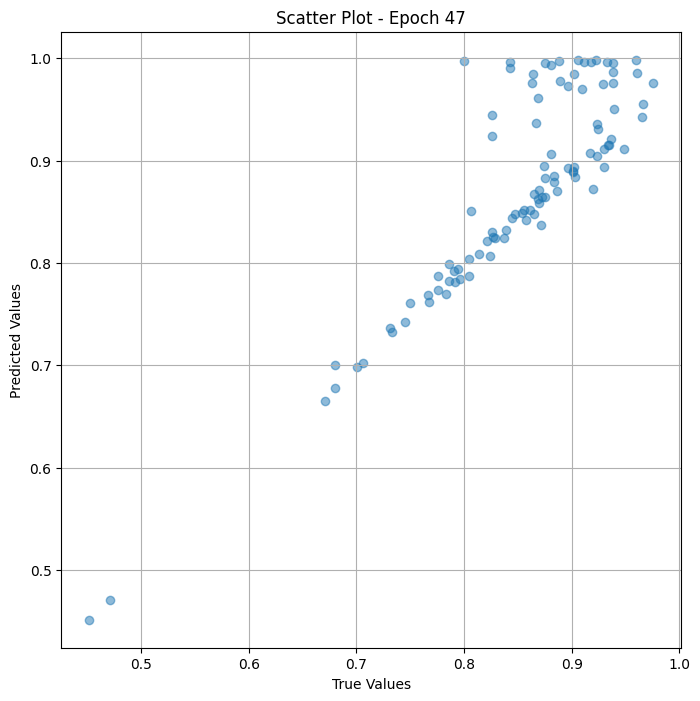


 Epoch: (48/50) Loss = 1.458782037389028e-07

 Epoch: (48/50) Loss_rmse = 0.0003819400444626808

 Epoch: (48/50) R^2 = 0.9998655319213867

 Epoch: (48/50) MAE = 0.00032551586627960205

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.451923

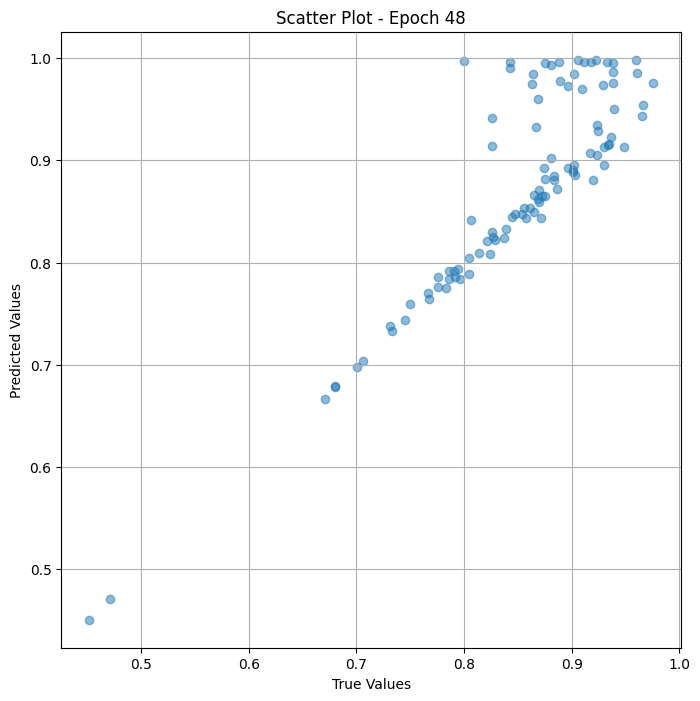


 Epoch: (49/50) Loss = 3.0341931278599077e-07

 Epoch: (49/50) Loss_rmse = 0.0005508351023308933

 Epoch: (49/50) R^2 = 0.9997202754020691

 Epoch: (49/50) MAE = 0.0004202425479888916

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.451923

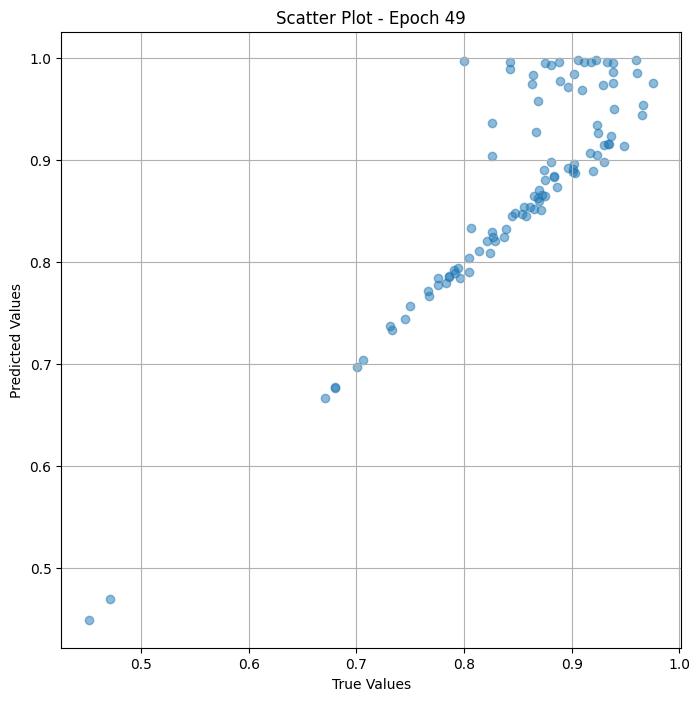


 Epoch: (50/50) Loss = 4.2355958385087433e-07

 Epoch: (50/50) Loss_rmse = 0.000650814559776336

 Epoch: (50/50) R^2 = 0.9996094703674316

 Epoch: (50/50) MAE = 0.0005766451358795166

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

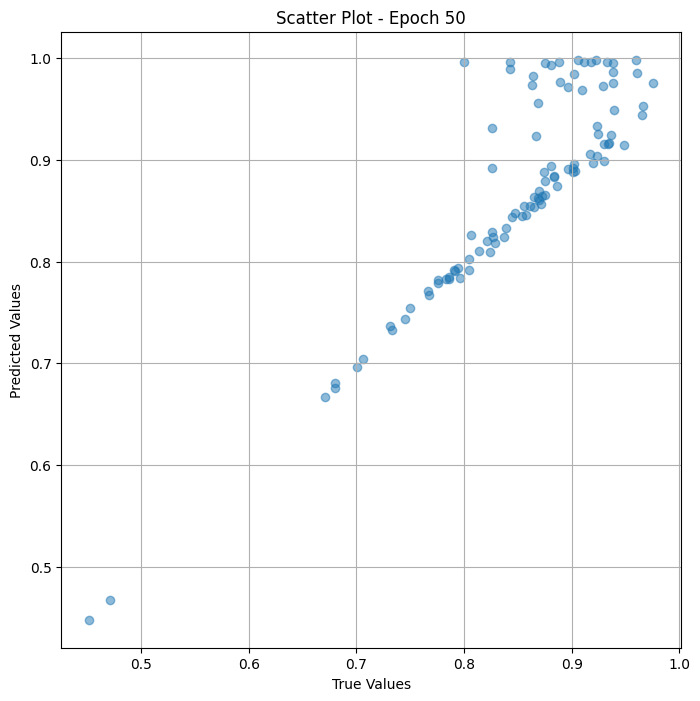

In [ ]:
# Training the model and save weights
fit(50, model_test, train_dl_test)
torch.save(model.state_dict(), "model_weights_vr_test")

In [ ]:
 true_values_list = [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394]

 predicted_values_list= [0.9991912, 0.95733744, 0.98719794, 0.86240506, 0.94259137, 0.8900393, 0.98542494]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.054056247761733546 0.9083652825239955


# Finetune


## Train

In [ ]:
# Load the pre-trained ResNet model
model_Res = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

# Remove the last layer of the model Res
layers_Res = list(model_Res.children())
model_Res = nn.Sequential(*layers_Res[:-1])

# Set the top layers to be not trainable
for param in model_Res.parameters():
    param.requires_grad = True

# Add your custom layers for fine-tuning
#num_features = model_Res[0][-1].in_features  # Get the number of features in the last layer of ResNet

custom_layers = [
    nn.Flatten(),
    nn.Linear(2048, 512),  # Example: add a fully connected layer with 512 units
    nn.ReLU(),
    nn.Dropout(0.5),  # Example: add dropout for regularization
    nn.Linear(512, 1)  # Example: add the output layer with your desired number of classes
]

# Create a new model by combining ResNet and custom layers
fine_tuned_model = nn.Sequential(
    model_Res,
    *custom_layers
)

# Optionally, you can print the fine-tuned model architecture
print(fine_tuned_model)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [ ]:
# Load the pre-trained ViT model
model_trans = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')

# Freeze some of the layers
count = 0
for child in model_trans.children():
    count += 1
    if count < 4:
        for param in child.parameters():
            param.requires_grad = True

# Extract the feature extractor
feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224-in21k')

# Remove the classification head (top layers) from the model
model_trans_top = nn.Sequential(*list(model_trans.children())[:-2])

# Access the last linear layer and adjust its bias
last_linear_layer = list(model_trans.children())[-1]
# Assuming the last layer is a Linear layer
if isinstance(last_linear_layer, nn.Linear):
    # Adjust the bias as needed
    new_bias = torch.tensor([2.0])
    last_linear_layer.bias.data = new_bias

# Add Sigmoid activation
mymodel = nn.Sequential(last_linear_layer, nn.Sigmoid())

# Optionally, you can print the modified model architecture
print(mymodel)


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

Sequential(
  (0): ViTPooler(
    (dense): Linear(in_features=768, out_features=768, bias=True)
    (activation): Tanh()
  )
  (1): Sigmoid()
)


In [ ]:
# Merge the two models
class model_merge_fine(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model = model_merge_fine(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model = to_device(model, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.01988278701901436

 Epoch: (1/50) Loss_rmse = 0.14100633561611176

 Epoch: (1/50) R^2 = -2.9298295974731445

 Epoch: (1/50) MAE = 0.12235818803310394

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.815789

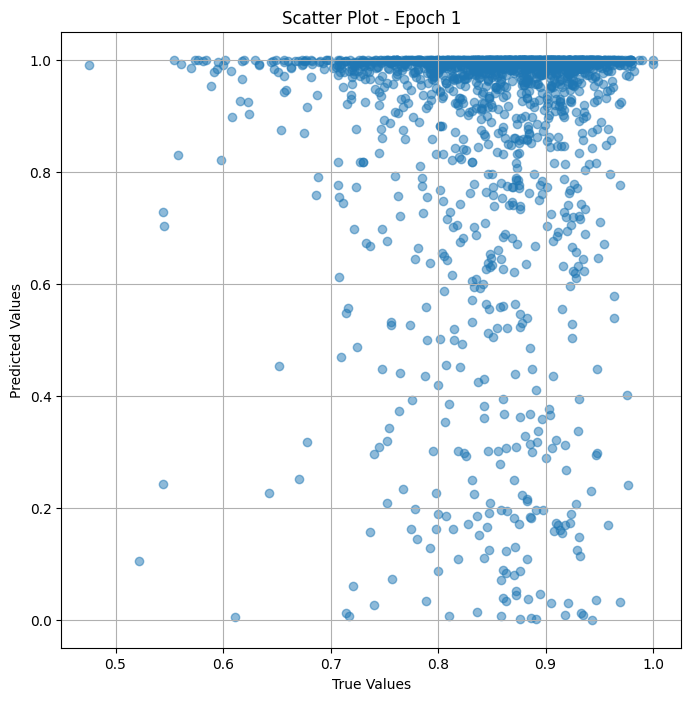


 Epoch: (2/50) Loss = 0.020140763372182846

 Epoch: (2/50) Loss_rmse = 0.1419181525707245

 Epoch: (2/50) R^2 = -2.980818510055542

 Epoch: (2/50) MAE = 0.12341716140508652

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8157894

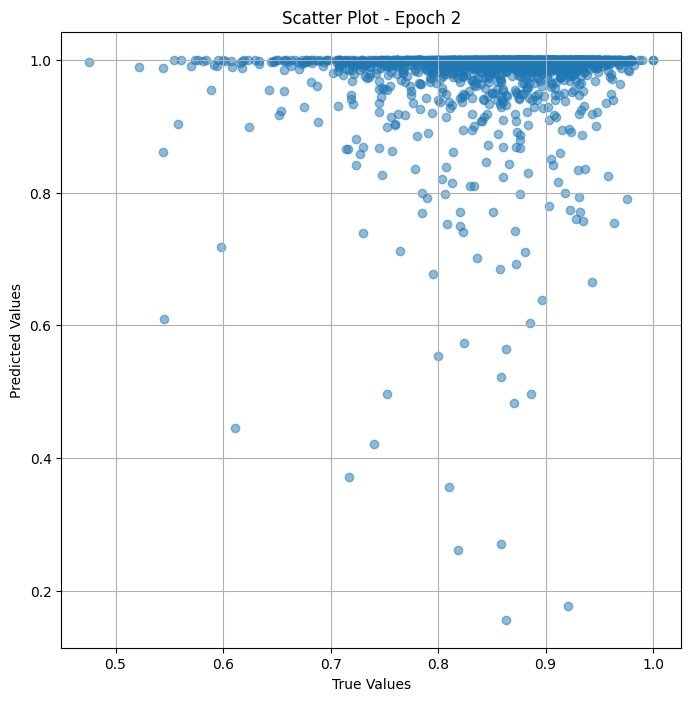


 Epoch: (3/50) Loss = 0.019737858325242996

 Epoch: (3/50) Loss_rmse = 0.14049148559570312

 Epoch: (3/50) R^2 = -2.901184558868408

 Epoch: (3/50) MAE = 0.121980220079422

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81578946

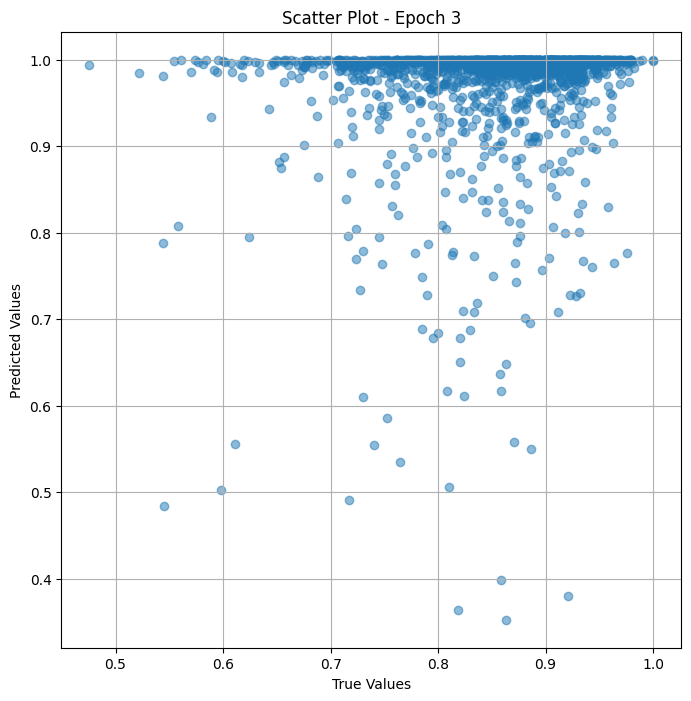


 Epoch: (4/50) Loss = 0.018593644723296165

 Epoch: (4/50) Loss_rmse = 0.13635851442813873

 Epoch: (4/50) R^2 = -2.6750307083129883

 Epoch: (4/50) MAE = 0.11781515926122665

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81578

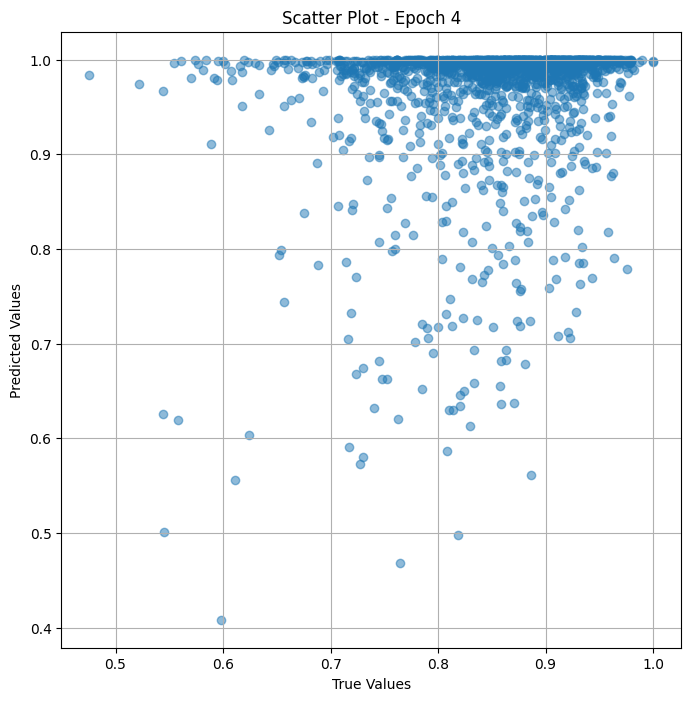


 Epoch: (5/50) Loss = 0.016768503934144974

 Epoch: (5/50) Loss_rmse = 0.12949325144290924

 Epoch: (5/50) R^2 = -2.3142919540405273

 Epoch: (5/50) MAE = 0.11010699719190598

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81578

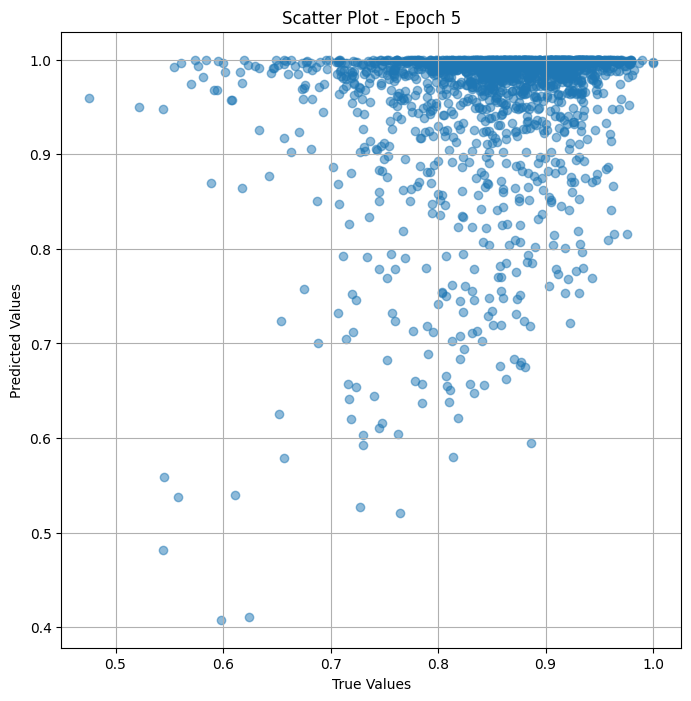


 Epoch: (6/50) Loss = 0.014778434298932552

 Epoch: (6/50) Loss_rmse = 0.12156658619642258

 Epoch: (6/50) R^2 = -1.9209551811218262

 Epoch: (6/50) MAE = 0.10096629709005356

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81578

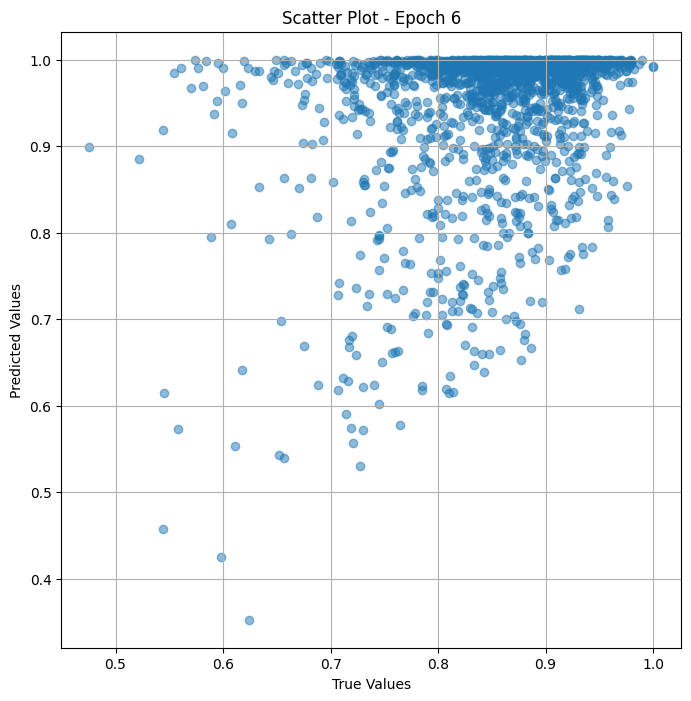


 Epoch: (7/50) Loss = 0.012924439273774624

 Epoch: (7/50) Loss_rmse = 0.11368570476770401

 Epoch: (7/50) R^2 = -1.5545132160186768

 Epoch: (7/50) MAE = 0.09931769967079163

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81578

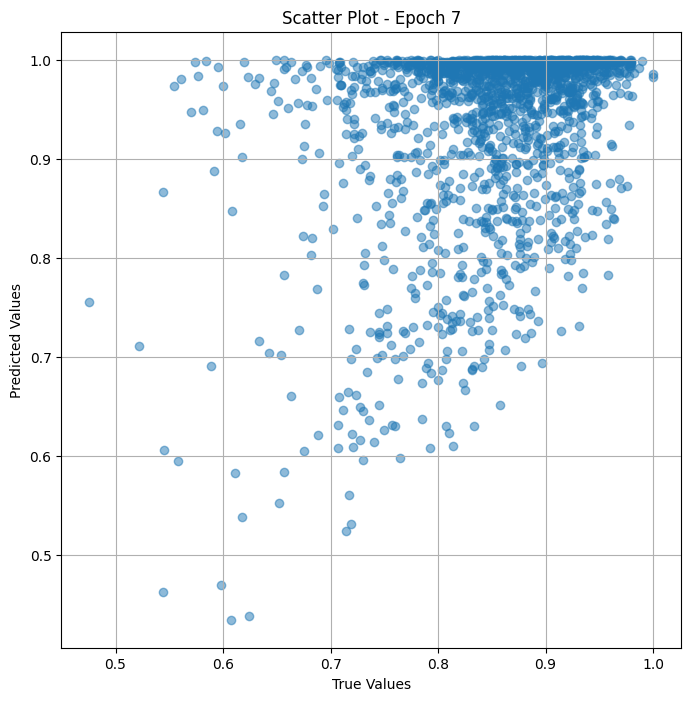


 Epoch: (8/50) Loss = 0.010176211595535278

 Epoch: (8/50) Loss_rmse = 0.10087721049785614

 Epoch: (8/50) R^2 = -1.011326551437378

 Epoch: (8/50) MAE = 0.09152249246835709

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.815789

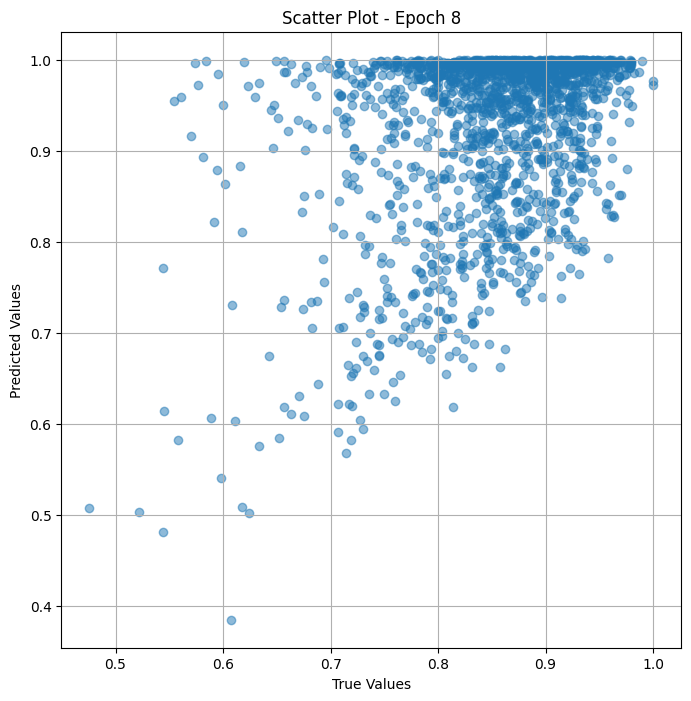


 Epoch: (9/50) Loss = 0.00710358377546072

 Epoch: (9/50) Loss_rmse = 0.0842827633023262

 Epoch: (9/50) R^2 = -0.404022216796875

 Epoch: (9/50) MAE = 0.07773564010858536

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81578946

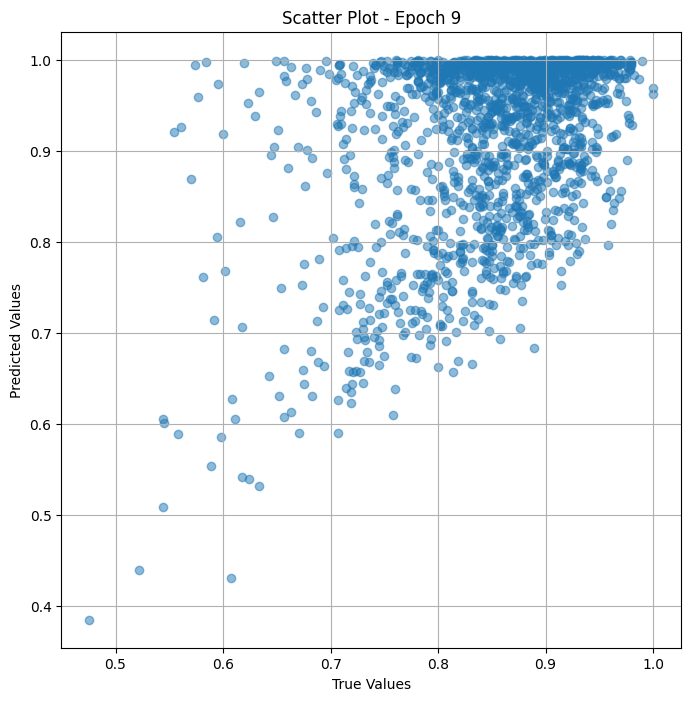


 Epoch: (10/50) Loss = 0.005660844501107931

 Epoch: (10/50) Loss_rmse = 0.07523858547210693

 Epoch: (10/50) R^2 = -0.1188650131225586

 Epoch: (10/50) MAE = 0.06458078324794769

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

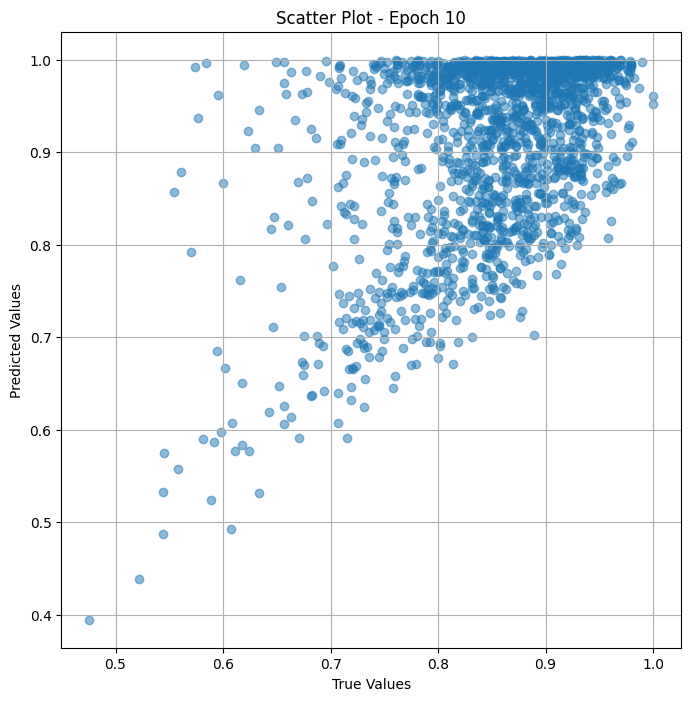


 Epoch: (11/50) Loss = 0.004824560135602951

 Epoch: (11/50) Loss_rmse = 0.06945905089378357

 Epoch: (11/50) R^2 = 0.046426475048065186

 Epoch: (11/50) MAE = 0.05743791162967682

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

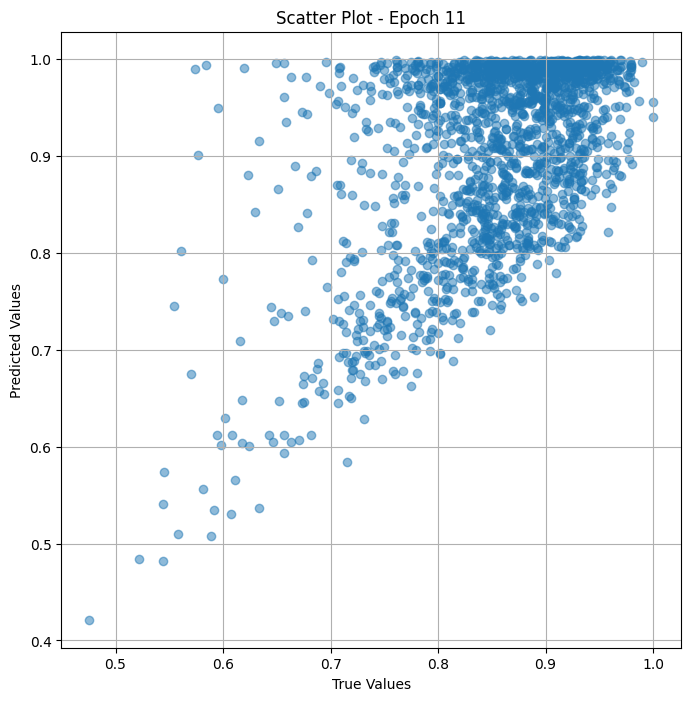


 Epoch: (12/50) Loss = 0.004100913647562265

 Epoch: (12/50) Loss_rmse = 0.06403837352991104

 Epoch: (12/50) R^2 = 0.1894550919532776

 Epoch: (12/50) MAE = 0.04829293489456177

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81

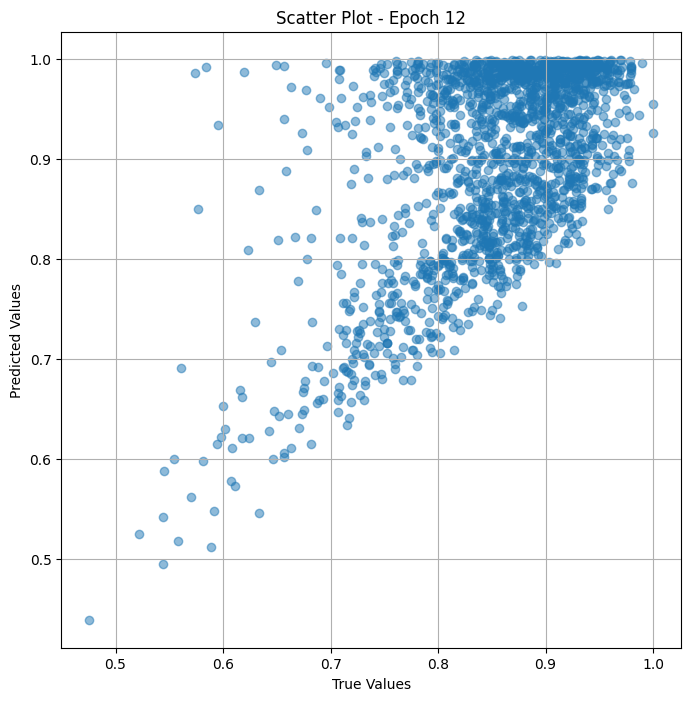


 Epoch: (13/50) Loss = 0.0037877317517995834

 Epoch: (13/50) Loss_rmse = 0.06154455244541168

 Epoch: (13/50) R^2 = 0.25135546922683716

 Epoch: (13/50) MAE = 0.048429980874061584

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0

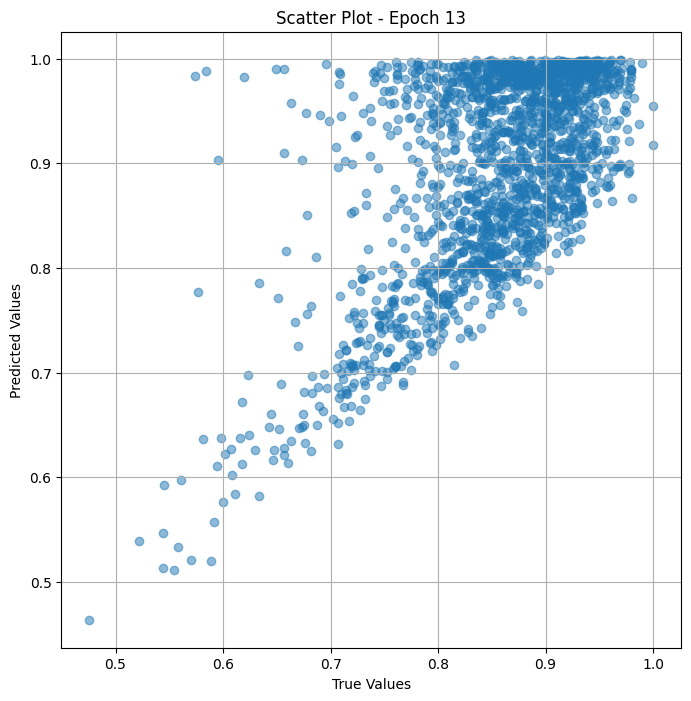


 Epoch: (14/50) Loss = 0.003589137690141797

 Epoch: (14/50) Loss_rmse = 0.059909410774707794

 Epoch: (14/50) R^2 = 0.2906075119972229

 Epoch: (14/50) MAE = 0.0473390594124794

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81

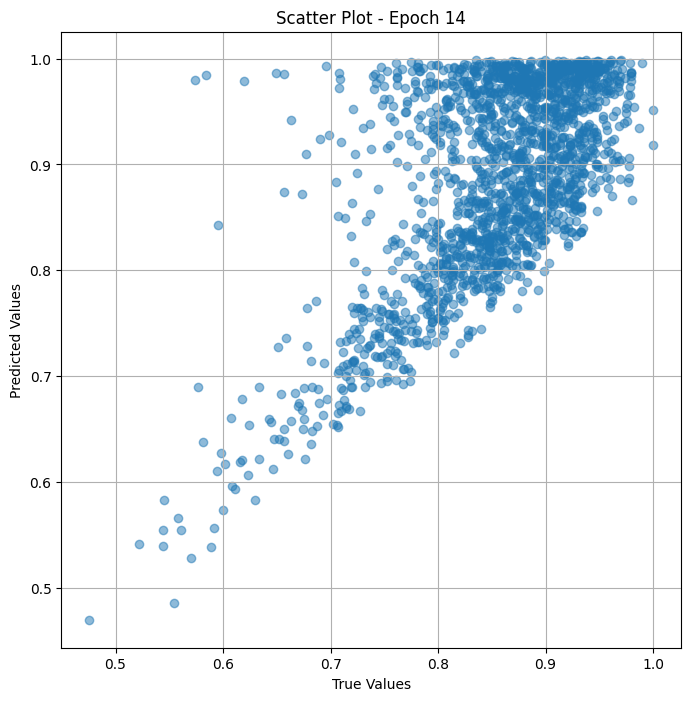


 Epoch: (15/50) Loss = 0.003127217525616288

 Epoch: (15/50) Loss_rmse = 0.0559215284883976

 Epoch: (15/50) R^2 = 0.3819059729576111

 Epoch: (15/50) MAE = 0.04323360323905945

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.815

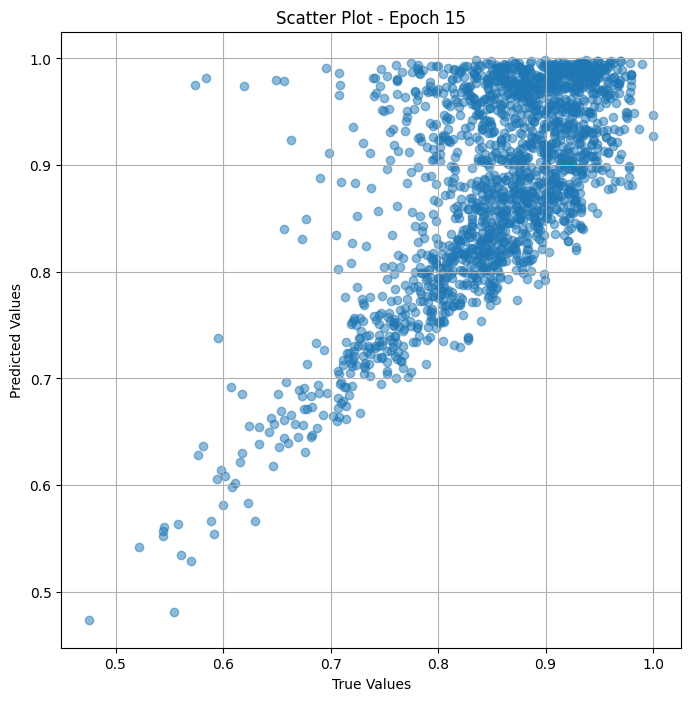


 Epoch: (16/50) Loss = 0.002666948828846216

 Epoch: (16/50) Loss_rmse = 0.051642511039972305

 Epoch: (16/50) R^2 = 0.47287797927856445

 Epoch: (16/50) MAE = 0.03842037916183472

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

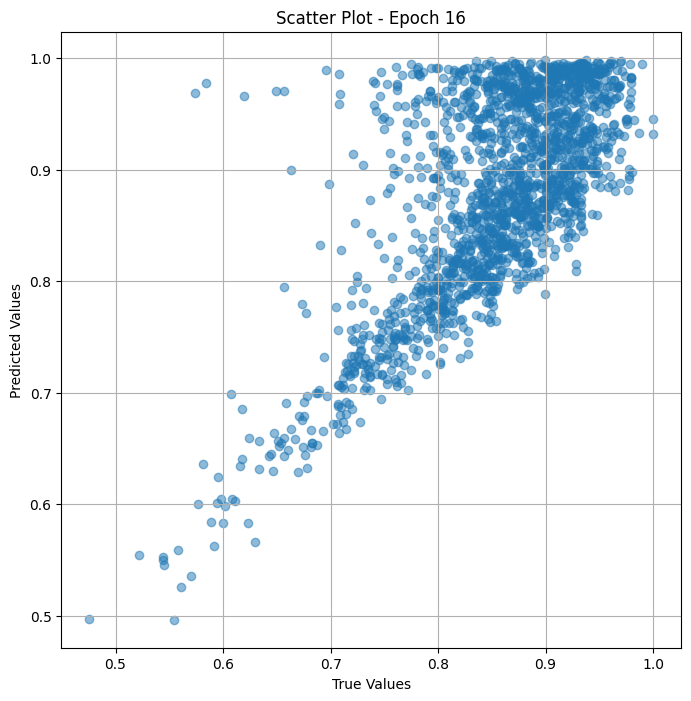


 Epoch: (17/50) Loss = 0.002219040412455797

 Epoch: (17/50) Loss_rmse = 0.04710669070482254

 Epoch: (17/50) R^2 = 0.5614070296287537

 Epoch: (17/50) MAE = 0.033698730170726776

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

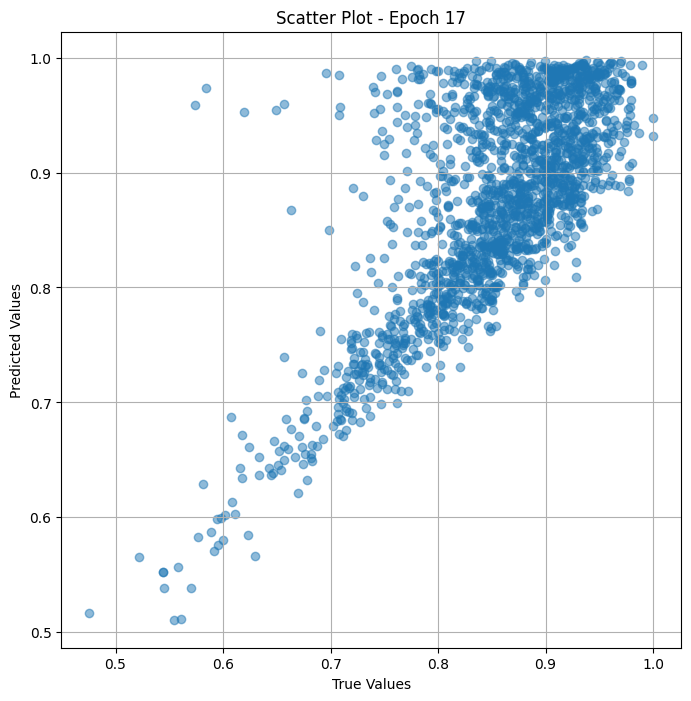


 Epoch: (18/50) Loss = 0.0017831593286246061

 Epoch: (18/50) Loss_rmse = 0.042227473109960556

 Epoch: (18/50) R^2 = 0.6475588083267212

 Epoch: (18/50) MAE = 0.029637843370437622

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0

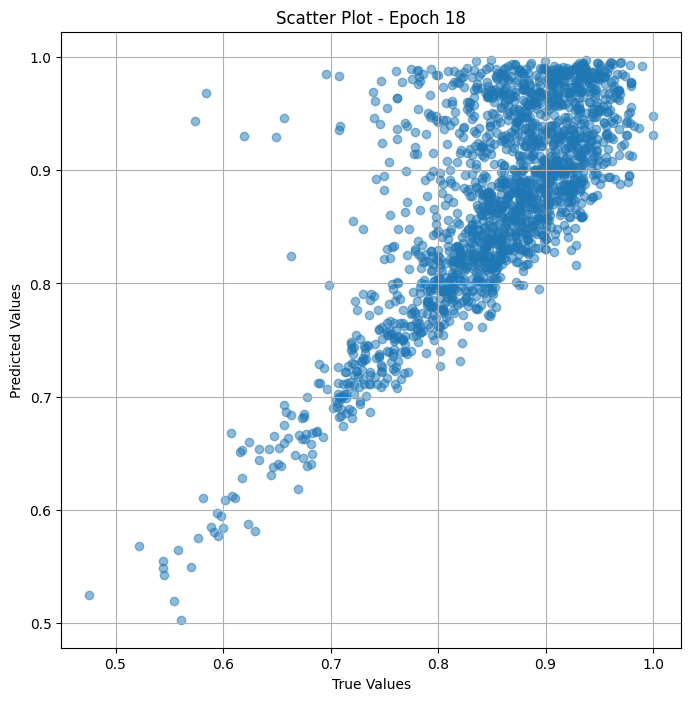


 Epoch: (19/50) Loss = 0.001313620712608099

 Epoch: (19/50) Loss_rmse = 0.03624390438199043

 Epoch: (19/50) R^2 = 0.7403631210327148

 Epoch: (19/50) MAE = 0.026631690561771393

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

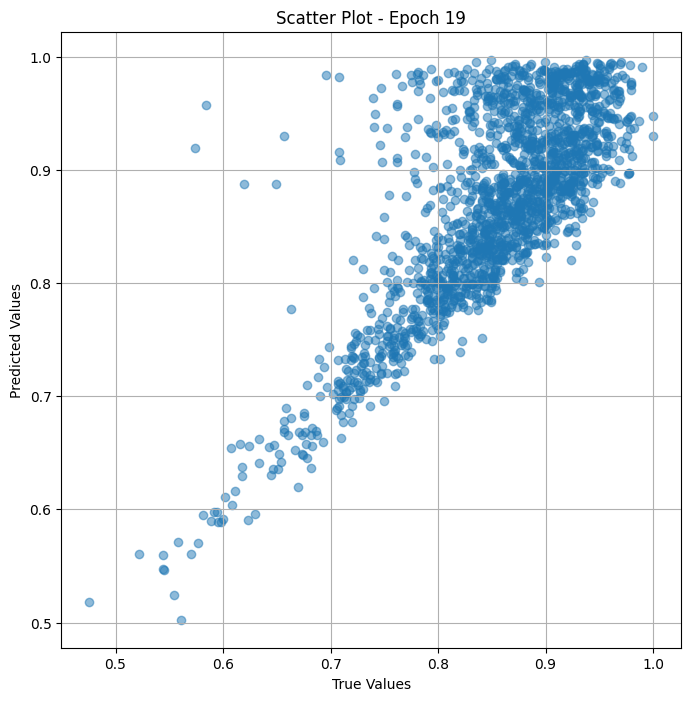


 Epoch: (20/50) Loss = 0.0008213397231884301

 Epoch: (20/50) Loss_rmse = 0.028659025207161903

 Epoch: (20/50) R^2 = 0.8376623392105103

 Epoch: (20/50) MAE = 0.02136816829442978

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

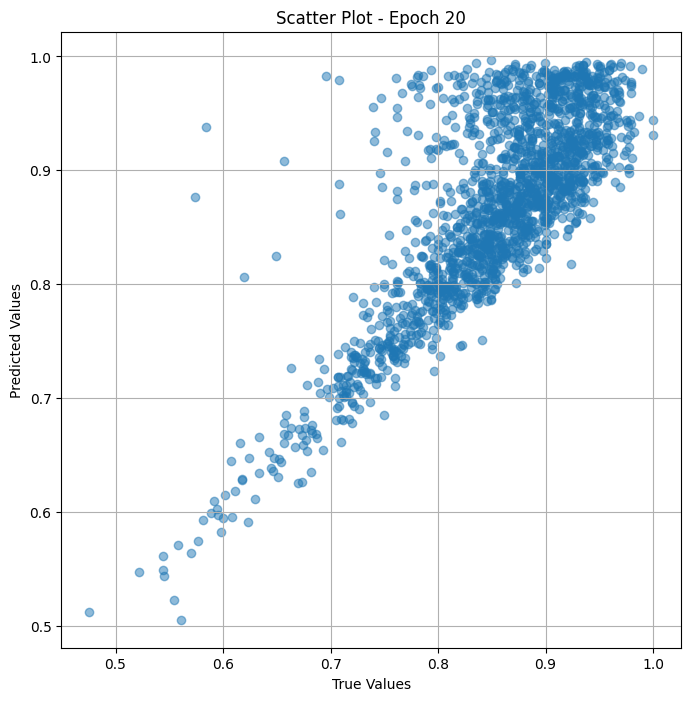


 Epoch: (21/50) Loss = 0.0004963320097886026

 Epoch: (21/50) Loss_rmse = 0.02227851003408432

 Epoch: (21/50) R^2 = 0.901900053024292

 Epoch: (21/50) MAE = 0.018387287855148315

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

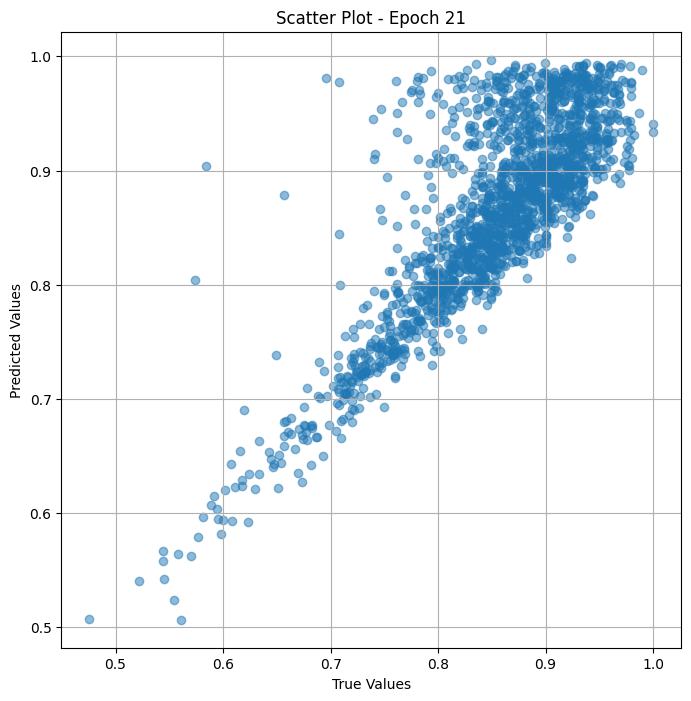


 Epoch: (22/50) Loss = 0.0002503520518075675

 Epoch: (22/50) Loss_rmse = 0.0158225167542696

 Epoch: (22/50) R^2 = 0.9505179524421692

 Epoch: (22/50) MAE = 0.012554384768009186

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

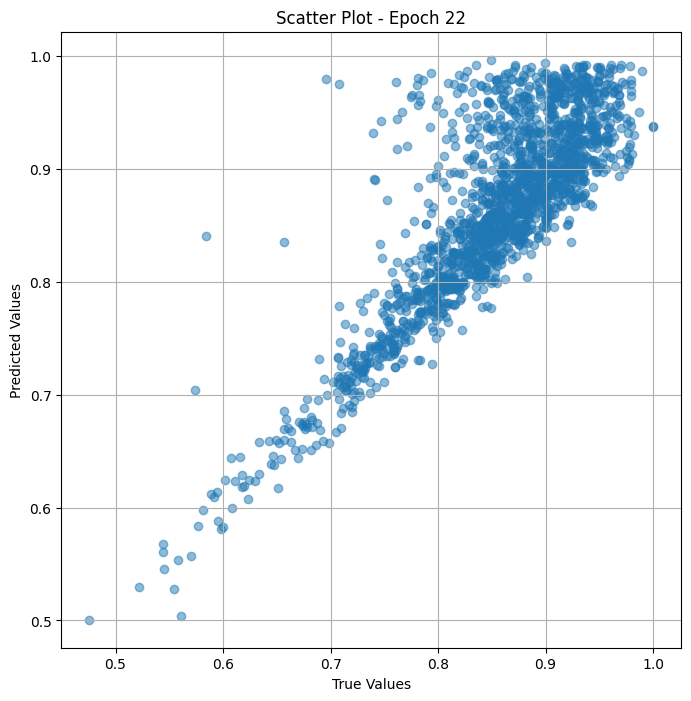


 Epoch: (23/50) Loss = 0.00012425187742337584

 Epoch: (23/50) Loss_rmse = 0.011146832257509232

 Epoch: (23/50) R^2 = 0.9754416346549988

 Epoch: (23/50) MAE = 0.009687148034572601

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 

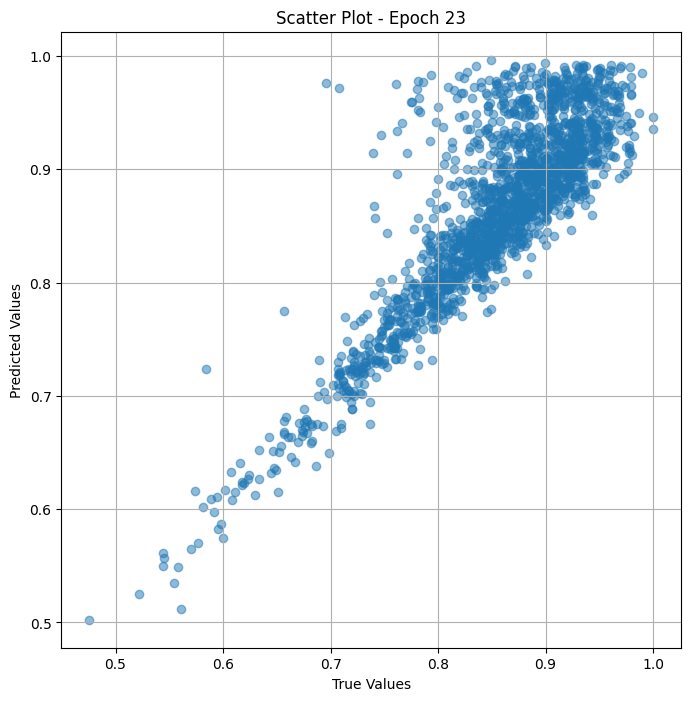


 Epoch: (24/50) Loss = 0.0001954142062459141

 Epoch: (24/50) Loss_rmse = 0.013979063369333744

 Epoch: (24/50) R^2 = 0.961376428604126

 Epoch: (24/50) MAE = 0.010774925351142883

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

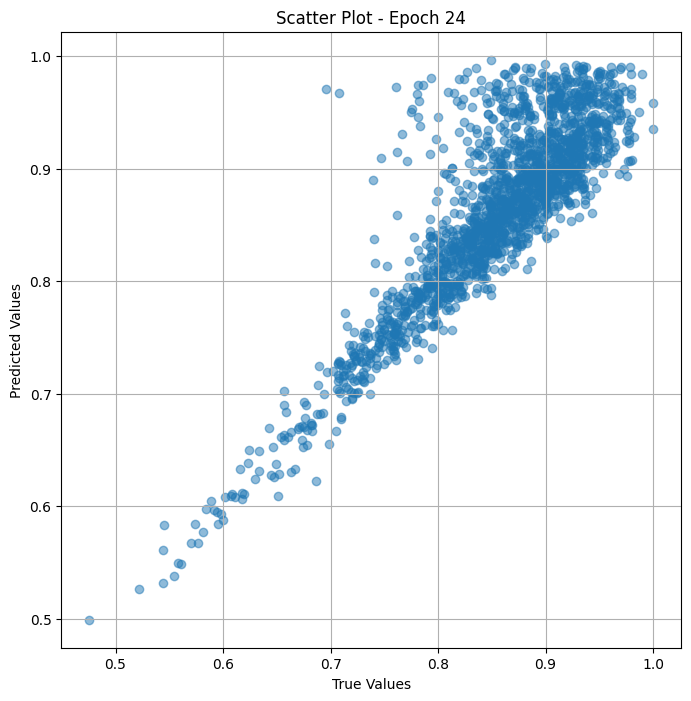


 Epoch: (25/50) Loss = 0.0002679784956853837

 Epoch: (25/50) Loss_rmse = 0.016370048746466637

 Epoch: (25/50) R^2 = 0.9470341205596924

 Epoch: (25/50) MAE = 0.013337351381778717

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0

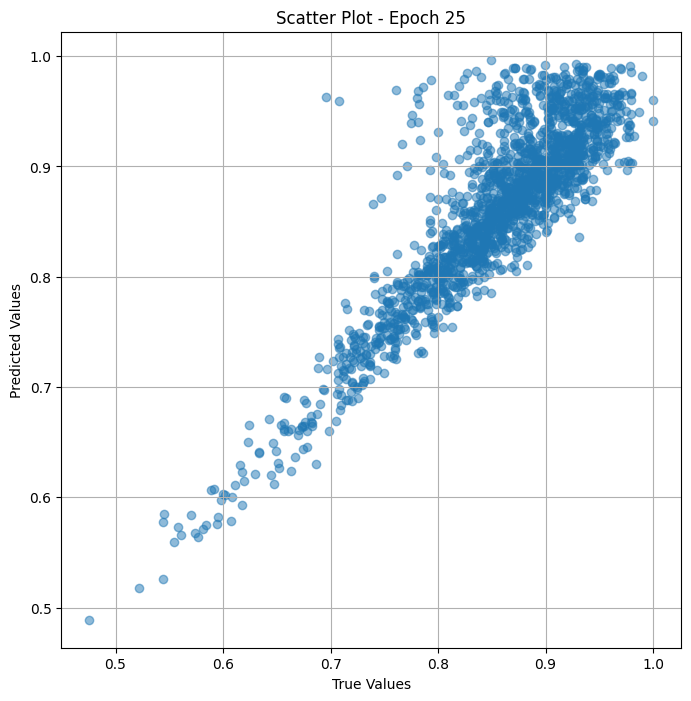


 Epoch: (26/50) Loss = 0.0003537492302712053

 Epoch: (26/50) Loss_rmse = 0.01880822330713272

 Epoch: (26/50) R^2 = 0.9300815463066101

 Epoch: (26/50) MAE = 0.015368007123470306

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

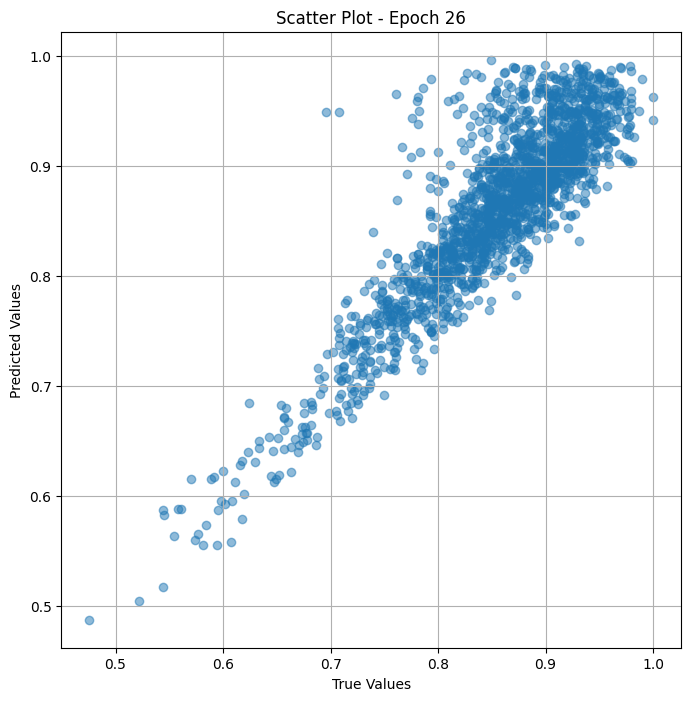


 Epoch: (27/50) Loss = 0.0011216186685487628

 Epoch: (27/50) Loss_rmse = 0.03349057585000992

 Epoch: (27/50) R^2 = 0.7783122658729553

 Epoch: (27/50) MAE = 0.021490022540092468

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

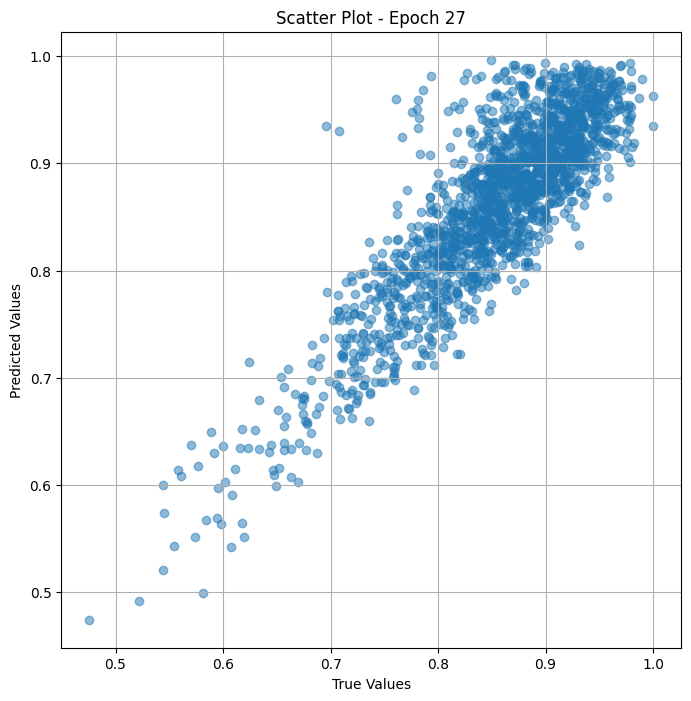


 Epoch: (28/50) Loss = 0.0006382811116054654

 Epoch: (28/50) Loss_rmse = 0.025264225900173187

 Epoch: (28/50) R^2 = 0.8738438487052917

 Epoch: (28/50) MAE = 0.02161337435245514

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

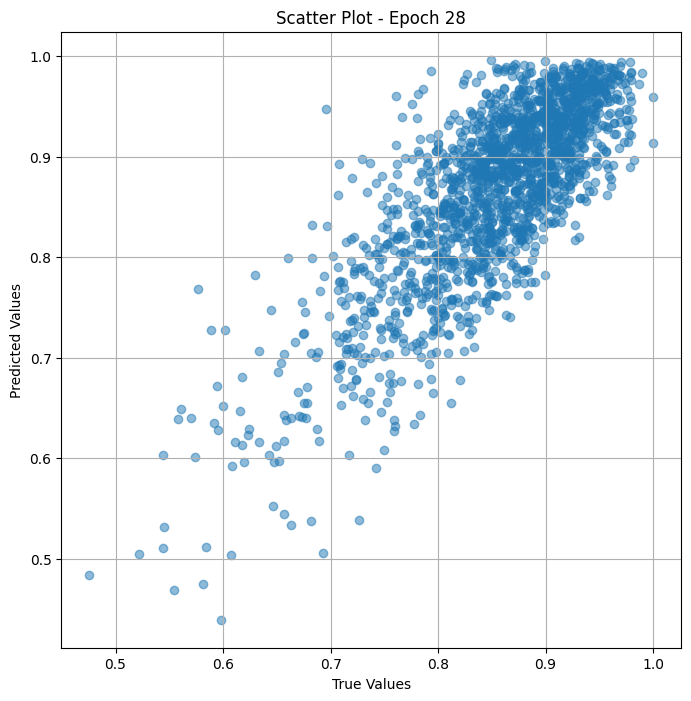


 Epoch: (29/50) Loss = 0.00833047553896904

 Epoch: (29/50) Loss_rmse = 0.09127143770456314

 Epoch: (29/50) R^2 = -0.6465171575546265

 Epoch: (29/50) MAE = 0.0724937692284584

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.815

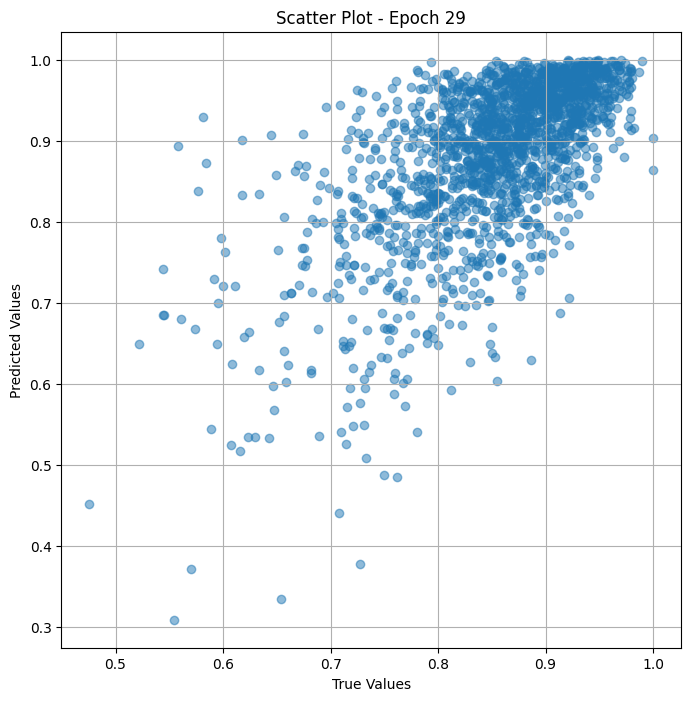


 Epoch: (30/50) Loss = 0.005621083080768585

 Epoch: (30/50) Loss_rmse = 0.07497388124465942

 Epoch: (30/50) R^2 = -0.11100614070892334

 Epoch: (30/50) MAE = 0.06212220340967178

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

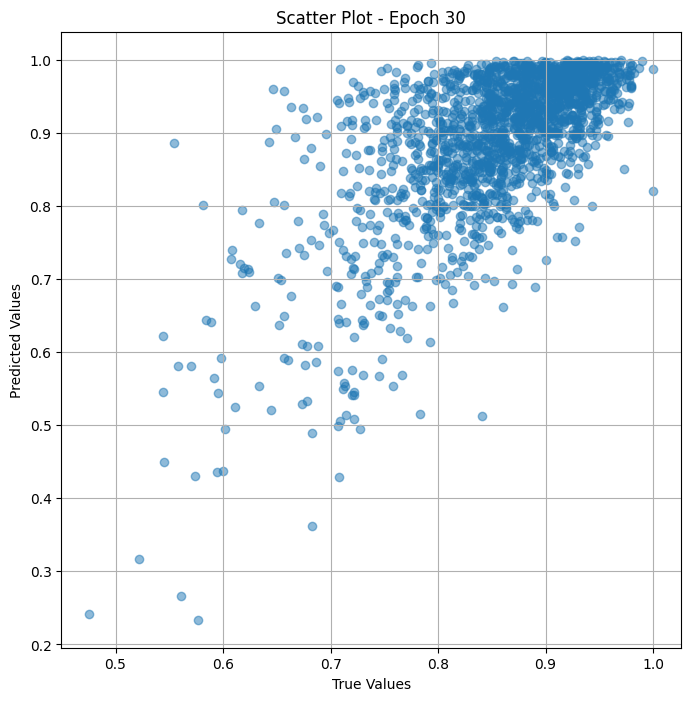


 Epoch: (31/50) Loss = 0.0016975139733403921

 Epoch: (31/50) Loss_rmse = 0.041200898587703705

 Epoch: (31/50) R^2 = 0.6644866466522217

 Epoch: (31/50) MAE = 0.03441450744867325

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

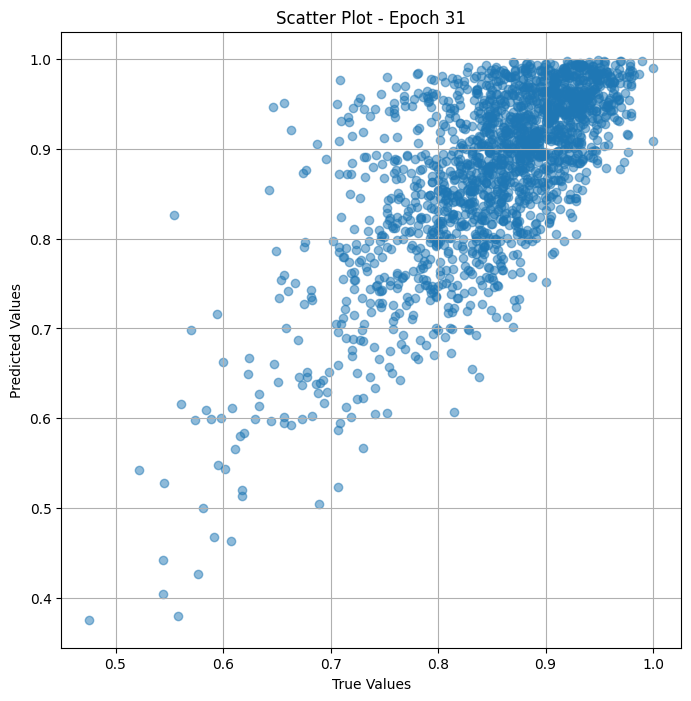


 Epoch: (32/50) Loss = 0.003035325789824128

 Epoch: (32/50) Loss_rmse = 0.05509379133582115

 Epoch: (32/50) R^2 = 0.40006834268569946

 Epoch: (32/50) MAE = 0.04185014218091965

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

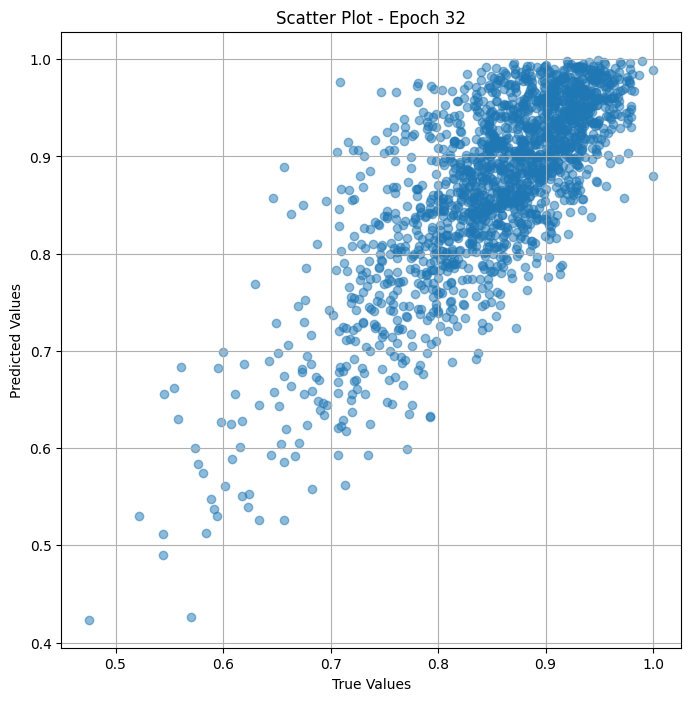


 Epoch: (33/50) Loss = 0.002245175652205944

 Epoch: (33/50) Loss_rmse = 0.04738328605890274

 Epoch: (33/50) R^2 = 0.5562413930892944

 Epoch: (33/50) MAE = 0.03433214873075485

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81

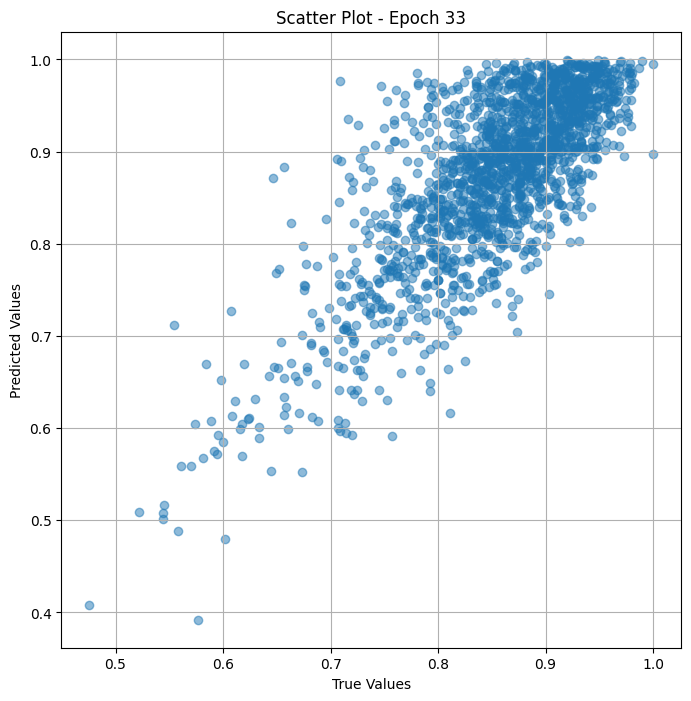


 Epoch: (34/50) Loss = 0.0015804754802957177

 Epoch: (34/50) Loss_rmse = 0.0397551953792572

 Epoch: (34/50) R^2 = 0.6876192688941956

 Epoch: (34/50) MAE = 0.032439522445201874

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

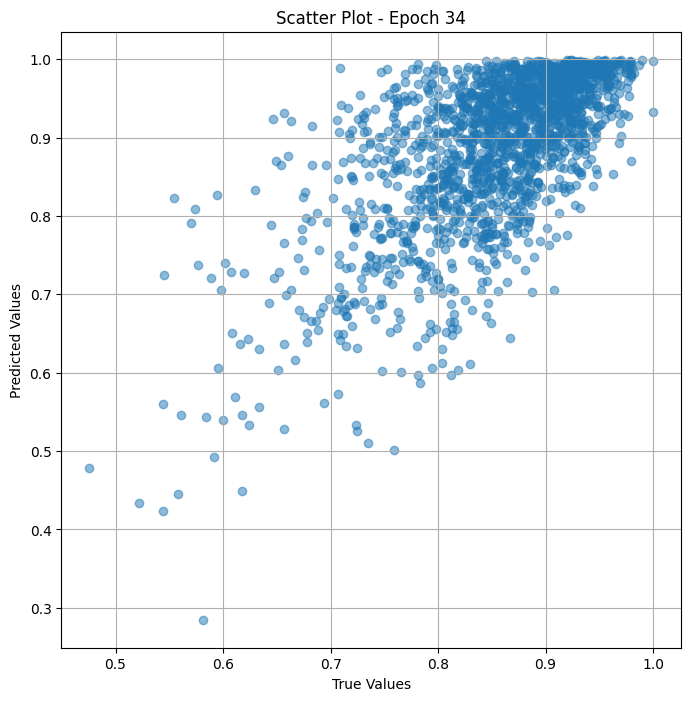


 Epoch: (35/50) Loss = 0.007903415709733963

 Epoch: (35/50) Loss_rmse = 0.08890115469694138

 Epoch: (35/50) R^2 = -0.5621088743209839

 Epoch: (35/50) MAE = 0.07089462131261826

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

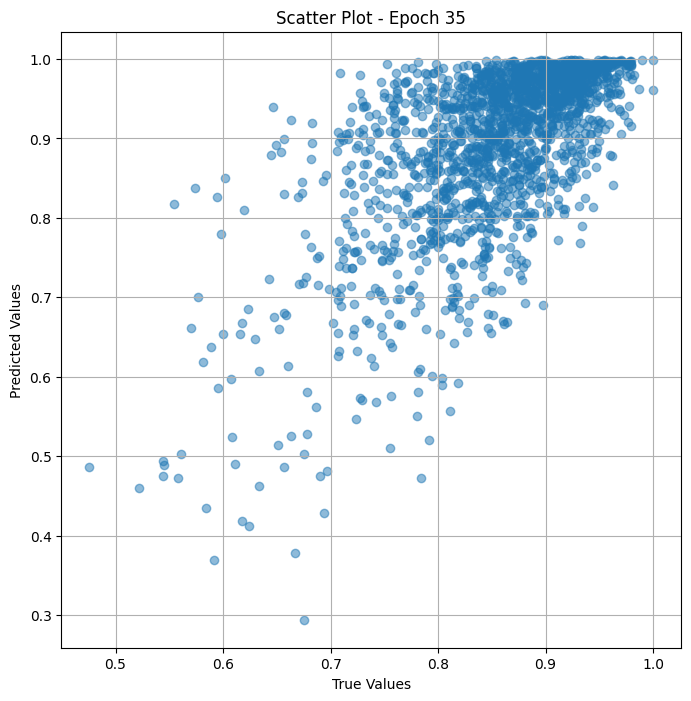


 Epoch: (36/50) Loss = 0.009637311100959778

 Epoch: (36/50) Loss_rmse = 0.09816981106996536

 Epoch: (36/50) R^2 = -0.9048129320144653

 Epoch: (36/50) MAE = 0.08214972913265228

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

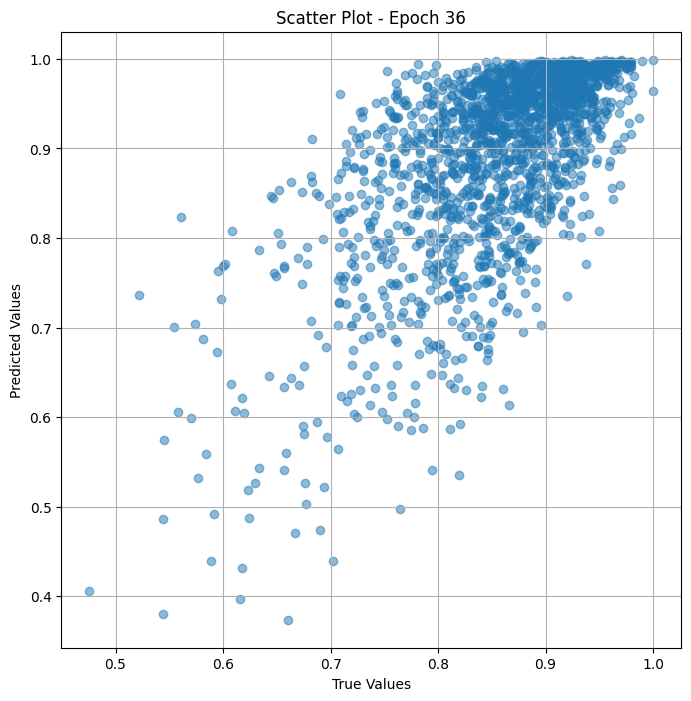


 Epoch: (37/50) Loss = 0.011212704703211784

 Epoch: (37/50) Loss_rmse = 0.10589005798101425

 Epoch: (37/50) R^2 = -1.2161891460418701

 Epoch: (37/50) MAE = 0.08886030316352844

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

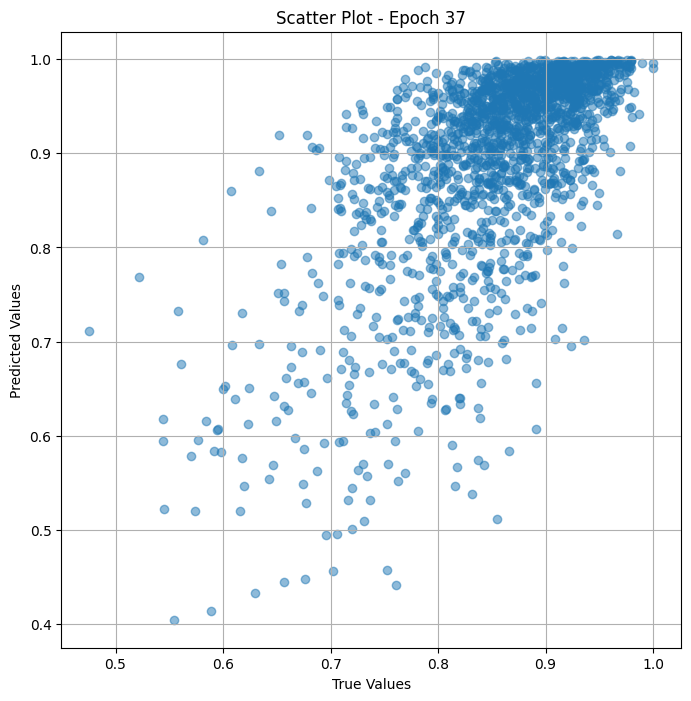


 Epoch: (38/50) Loss = 0.0049661388620734215

 Epoch: (38/50) Loss_rmse = 0.07047083973884583

 Epoch: (38/50) R^2 = 0.01844346523284912

 Epoch: (38/50) MAE = 0.06390213966369629

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

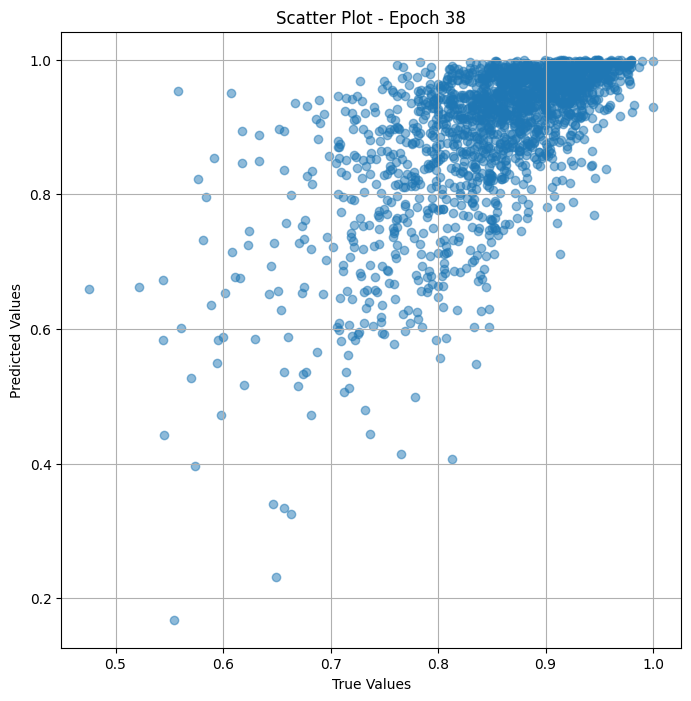


 Epoch: (39/50) Loss = 0.0021402579732239246

 Epoch: (39/50) Loss_rmse = 0.04626292362809181

 Epoch: (39/50) R^2 = 0.576978325843811

 Epoch: (39/50) MAE = 0.04085657000541687

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.81

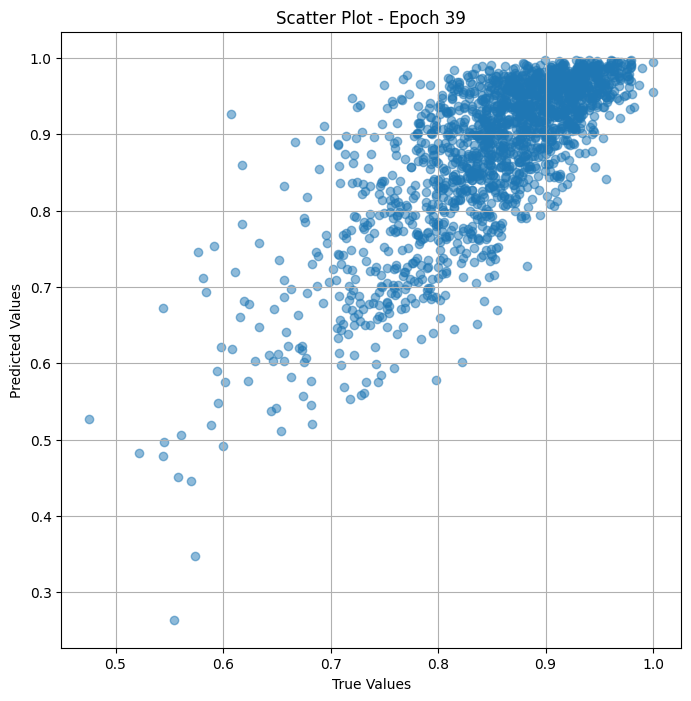


 Epoch: (40/50) Loss = 0.0013425268698483706

 Epoch: (40/50) Loss_rmse = 0.036640509963035583

 Epoch: (40/50) R^2 = 0.7346497774124146

 Epoch: (40/50) MAE = 0.03328830003738403

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

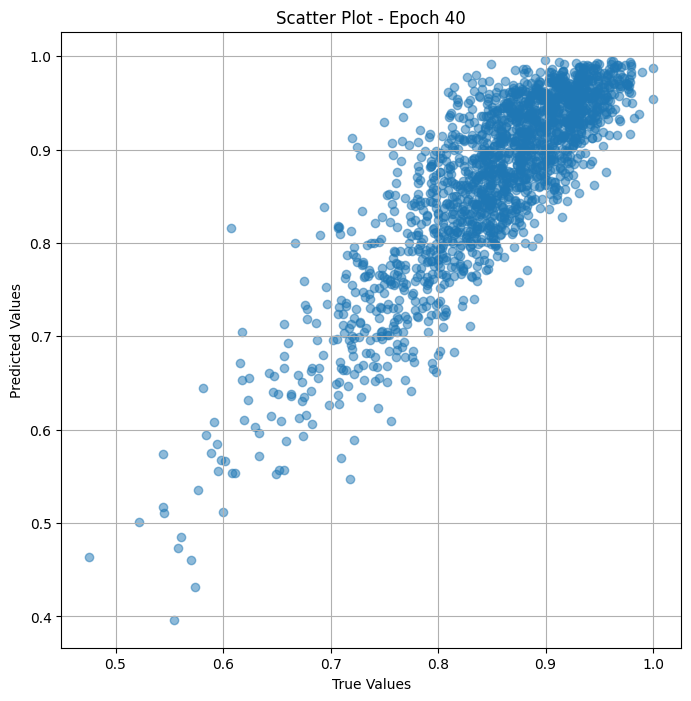


 Epoch: (41/50) Loss = 0.0007664263248443604

 Epoch: (41/50) Loss_rmse = 0.02768440544605255

 Epoch: (41/50) R^2 = 0.8485159873962402

 Epoch: (41/50) MAE = 0.02527717500925064

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

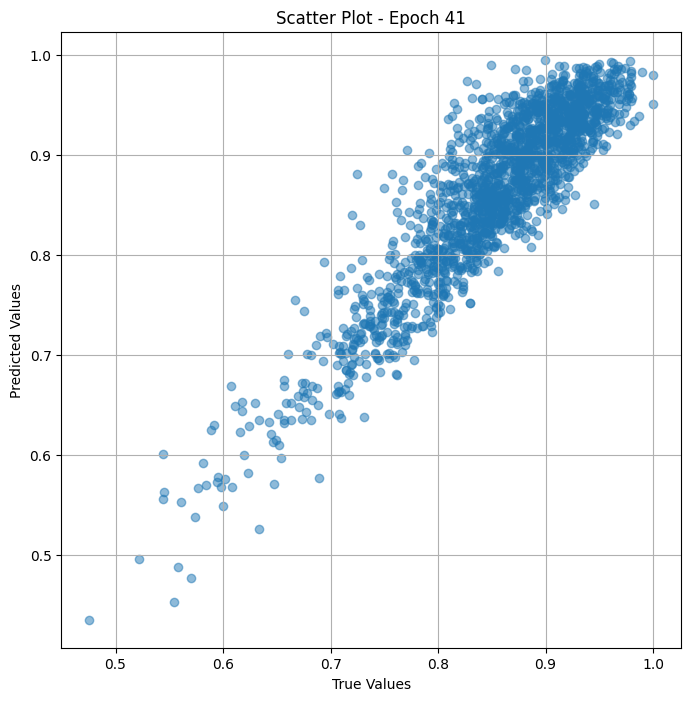


 Epoch: (42/50) Loss = 0.0003497922734823078

 Epoch: (42/50) Loss_rmse = 0.018702734261751175

 Epoch: (42/50) R^2 = 0.930863618850708

 Epoch: (42/50) MAE = 0.014412283897399902

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.

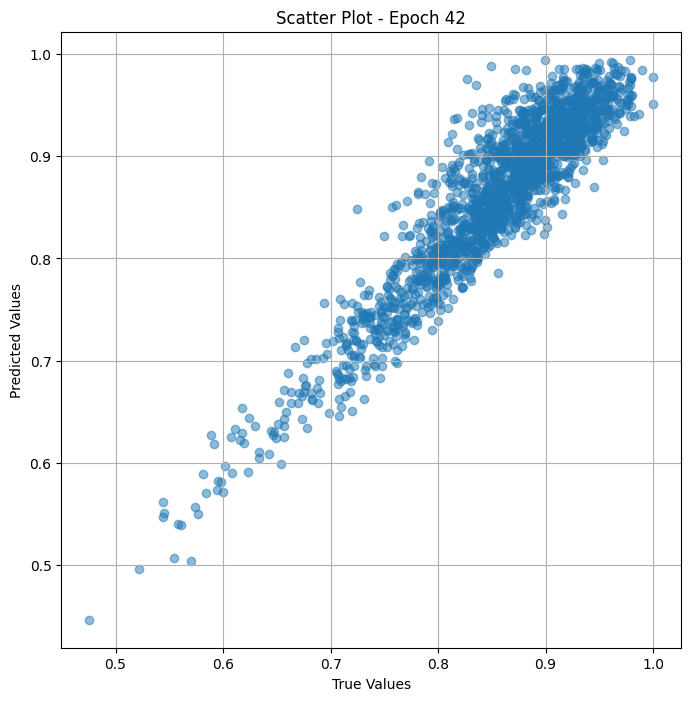


 Epoch: (43/50) Loss = 0.00020250433590263128

 Epoch: (43/50) Loss_rmse = 0.014230402186512947

 Epoch: (43/50) R^2 = 0.9599750638008118

 Epoch: (43/50) MAE = 0.012169249355793

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

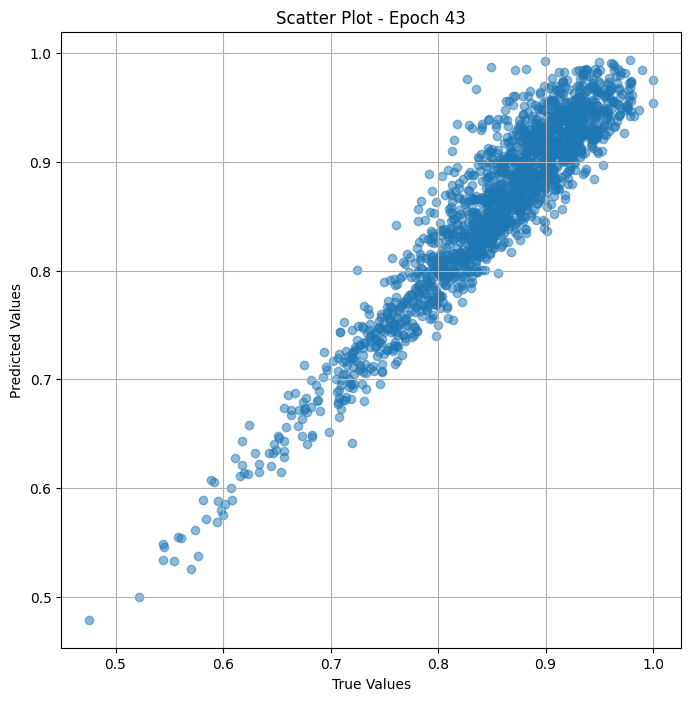


 Epoch: (44/50) Loss = 0.00011567107867449522

 Epoch: (44/50) Loss_rmse = 0.01075504906475544

 Epoch: (44/50) R^2 = 0.9771376252174377

 Epoch: (44/50) MAE = 0.010137282311916351

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0

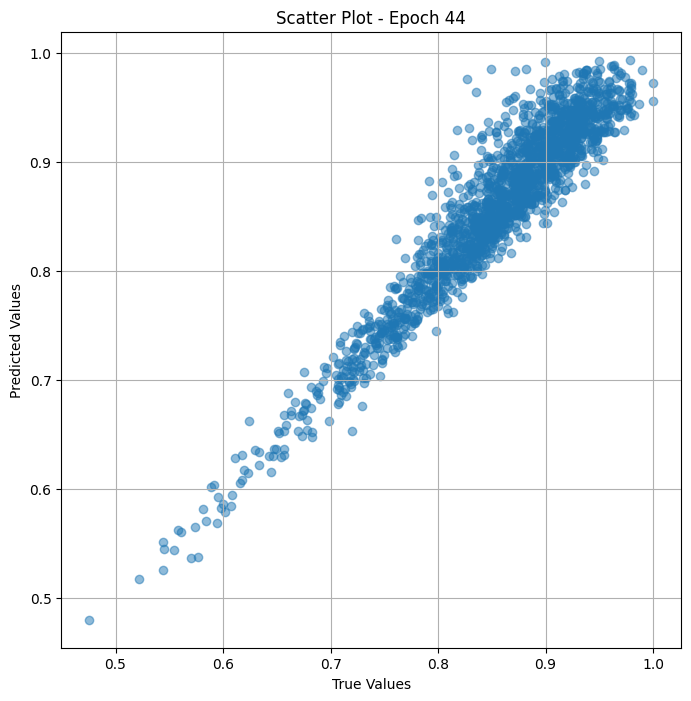


 Epoch: (45/50) Loss = 6.816519453423098e-05

 Epoch: (45/50) Loss_rmse = 0.008256221190094948

 Epoch: (45/50) R^2 = 0.986527144908905

 Epoch: (45/50) MAE = 0.0072898417711257935

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0

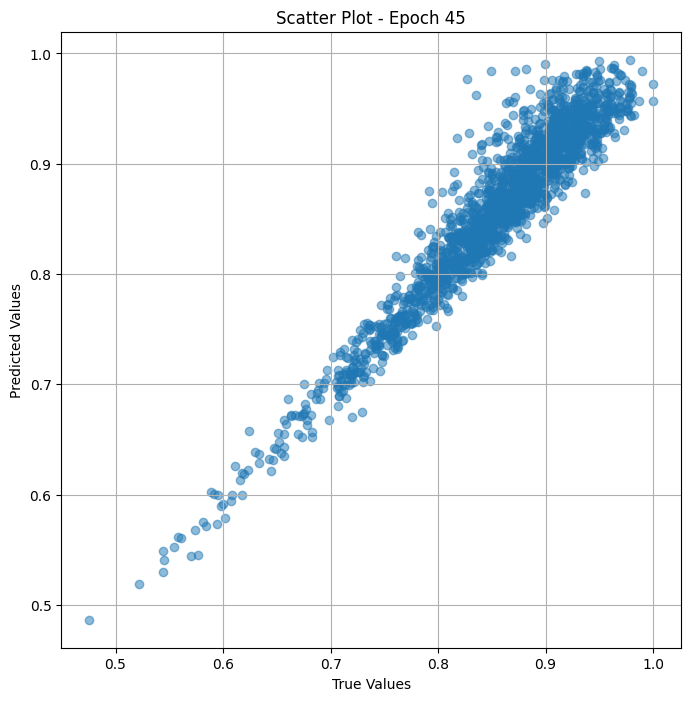


 Epoch: (46/50) Loss = 5.1429371524136513e-05

 Epoch: (46/50) Loss_rmse = 0.0071714273653924465

 Epoch: (46/50) R^2 = 0.9898349642753601

 Epoch: (46/50) MAE = 0.005782321095466614

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093,

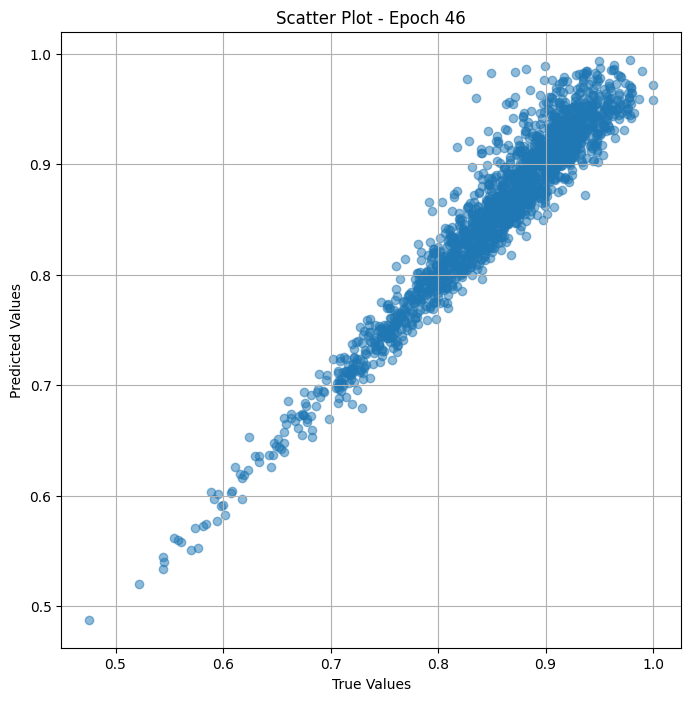


 Epoch: (47/50) Loss = 5.04239033034537e-05

 Epoch: (47/50) Loss_rmse = 0.007100978866219521

 Epoch: (47/50) R^2 = 0.990033745765686

 Epoch: (47/50) MAE = 0.006014376878738403

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

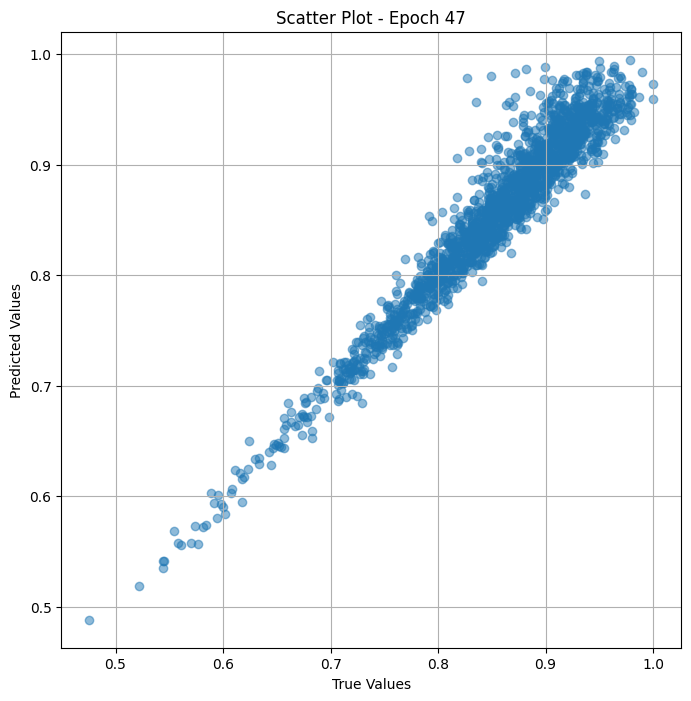


 Epoch: (48/50) Loss = 5.4524611186934635e-05

 Epoch: (48/50) Loss_rmse = 0.007384078111499548

 Epoch: (48/50) R^2 = 0.9892232418060303

 Epoch: (48/50) MAE = 0.006549760699272156

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 

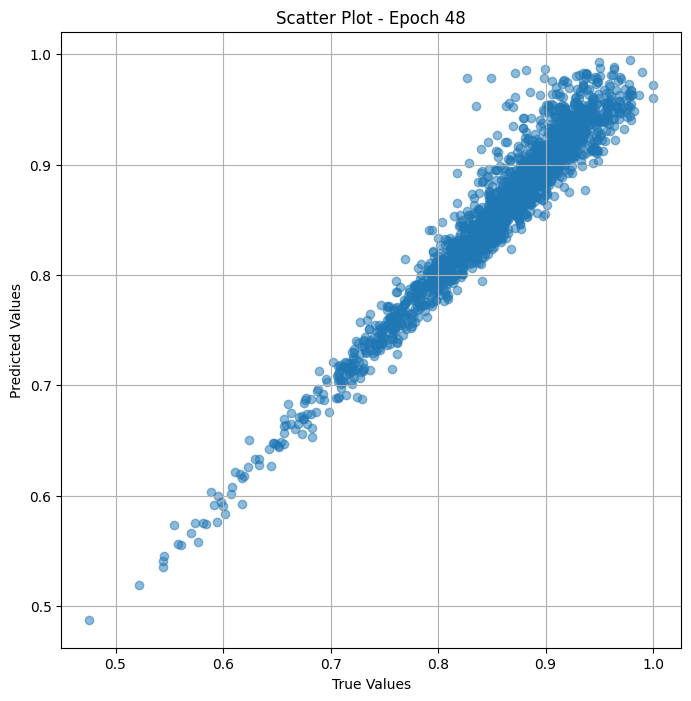


 Epoch: (49/50) Loss = 6.50219080853276e-05

 Epoch: (49/50) Loss_rmse = 0.00806361623108387

 Epoch: (49/50) R^2 = 0.9871484041213989

 Epoch: (49/50) MAE = 0.007570624351501465

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0.8

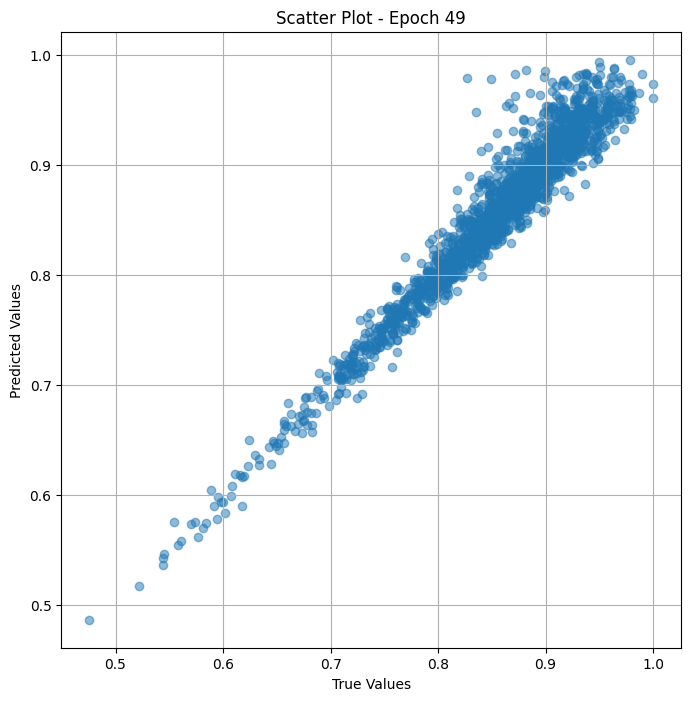


 Epoch: (50/50) Loss = 9.240803774446249e-05

 Epoch: (50/50) Loss_rmse = 0.009612909518182278

 Epoch: (50/50) R^2 = 0.9817355871200562

 Epoch: (50/50) MAE = 0.009147390723228455

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.9433962, 0.88235295, 0.92941177, 0.814433, 0.8378378, 0.8947368, 0.7647059, 0.827957, 0.9166667, 0.83495146, 0.68604654, 0.93700784, 0.9313725, 0.8854167, 0.7078652, 0.9285714, 0.7882353, 0.8817204, 0.78846157, 0.8703704, 0.8854167, 0.84615386, 0.71428573, 0.7980769, 0.90677965, 0.9368421, 0.86, 0.9238095, 0.9052632, 0.9770115, 0.8202247, 0.7816092, 0.96, 0.73636365, 0.9468085, 0.5221239, 0.9318182, 0.8425926, 0.9166667, 0.6781609, 0.8333333, 0.8842105, 0.8736842, 0.8348624, 0.9484536, 0.9111111, 0.872549, 0.8913044, 0.88659793, 0.96938777, 0.8761905, 0.67826086, 0.6111111, 0.84615386, 0.8172043, 0.8913044, 0.86170214, 0.87, 0.9191919, 0.87826085, 0.9375, 0.74, 0.925, 0.95049506, 0.7638889, 0.84313726, 0.88372093, 0

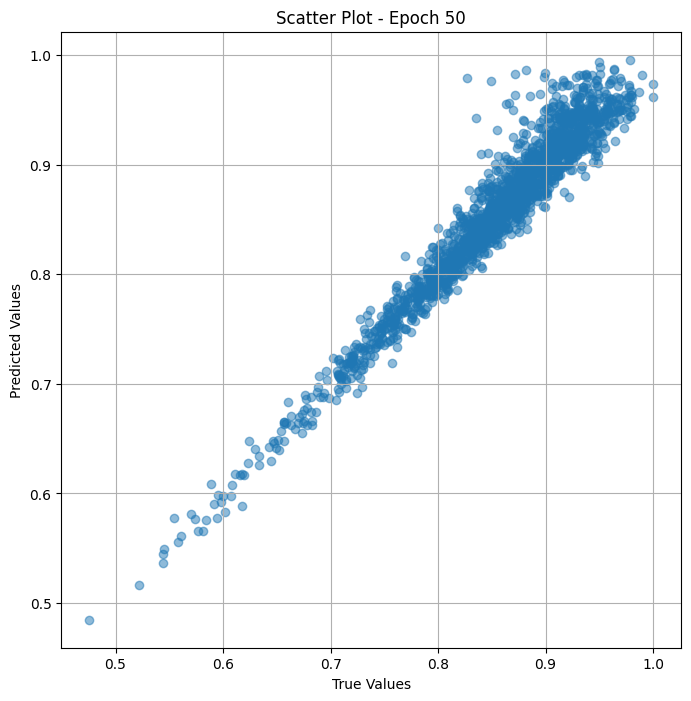

In [ ]:
# Training the model and save weights
fit(50, model, train_dl)
torch.save(model.state_dict(), "model_weights_S_")

## Valid

In [ ]:
# Merge the two models
class model_merge_fine_val(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


modelfine_val = model_merge_fine_val(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_val = DeviceDataLoader(train_dl_val, device)
modelfine_val = to_device(modelfine_val, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(modelfine_val.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,modelfine_val, train_dl_val):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        modelfine_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_val:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = modelfine_val(x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.029871145263314247

 Epoch: (1/50) Loss_rmse = 0.17283271253108978

 Epoch: (1/50) R^2 = -1.3851690292358398

 Epoch: (1/50) MAE = 0.1347983330488205

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055, 

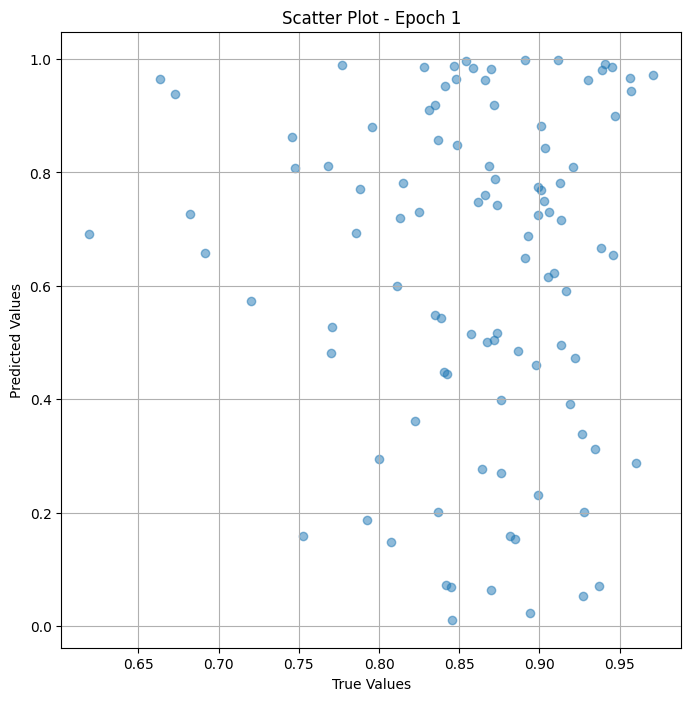


 Epoch: (2/50) Loss = 0.02857808582484722

 Epoch: (2/50) Loss_rmse = 0.16905054450035095

 Epoch: (2/50) R^2 = -1.2819201946258545

 Epoch: (2/50) MAE = 0.12167468667030334

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055, 

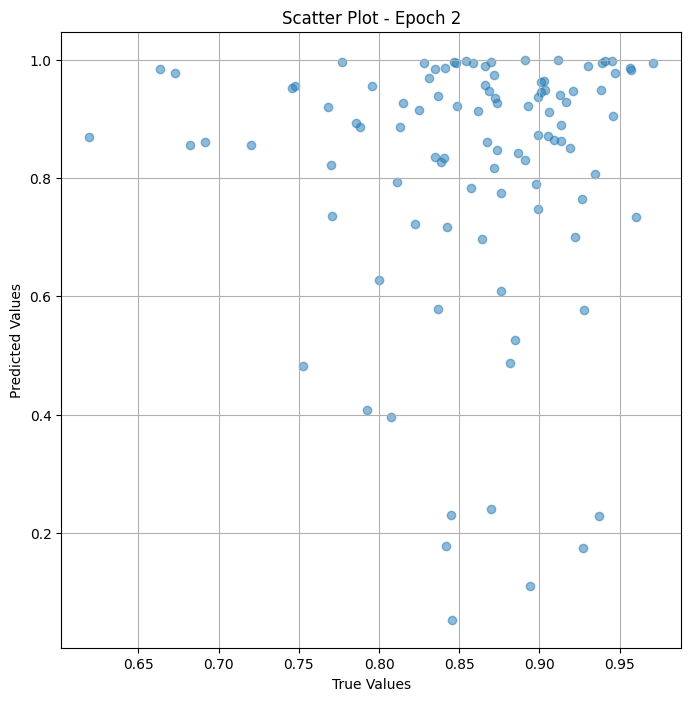


 Epoch: (3/50) Loss = 0.032508134841918945

 Epoch: (3/50) Loss_rmse = 0.18030013144016266

 Epoch: (3/50) R^2 = -1.595728874206543

 Epoch: (3/50) MAE = 0.14121916890144348

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055, 

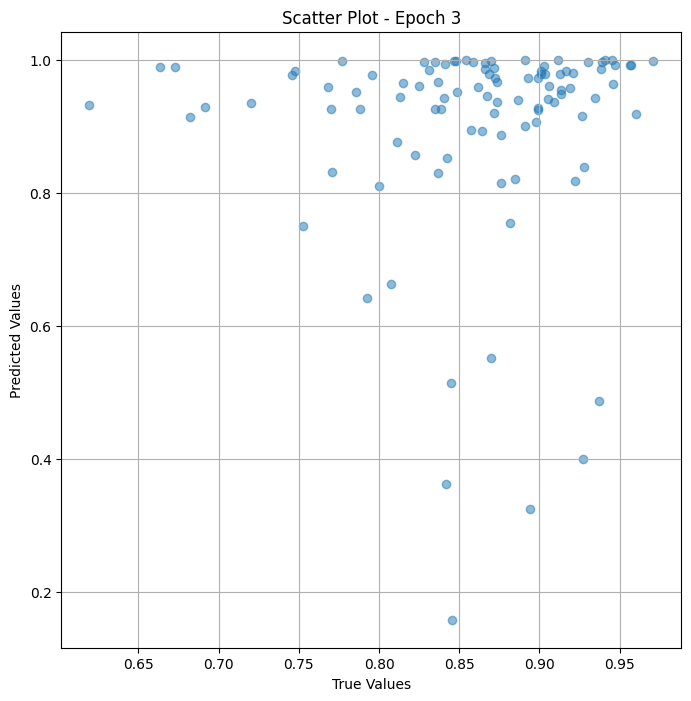


 Epoch: (4/50) Loss = 0.0339125320315361

 Epoch: (4/50) Loss_rmse = 0.18415355682373047

 Epoch: (4/50) R^2 = -1.7078680992126465

 Epoch: (4/50) MAE = 0.14684198796749115

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055, 0

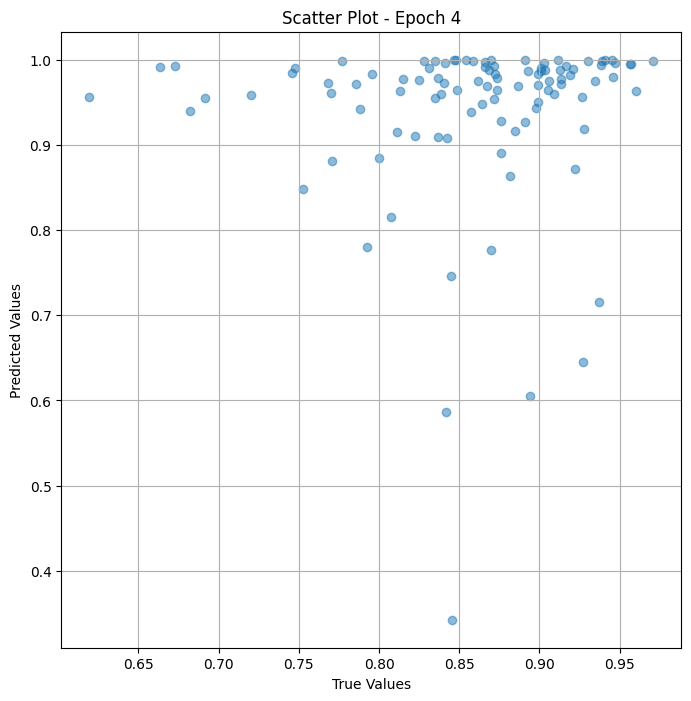


 Epoch: (5/50) Loss = 0.034335505217313766

 Epoch: (5/50) Loss_rmse = 0.18529842793941498

 Epoch: (5/50) R^2 = -1.7416419982910156

 Epoch: (5/50) MAE = 0.14846867322921753

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055,

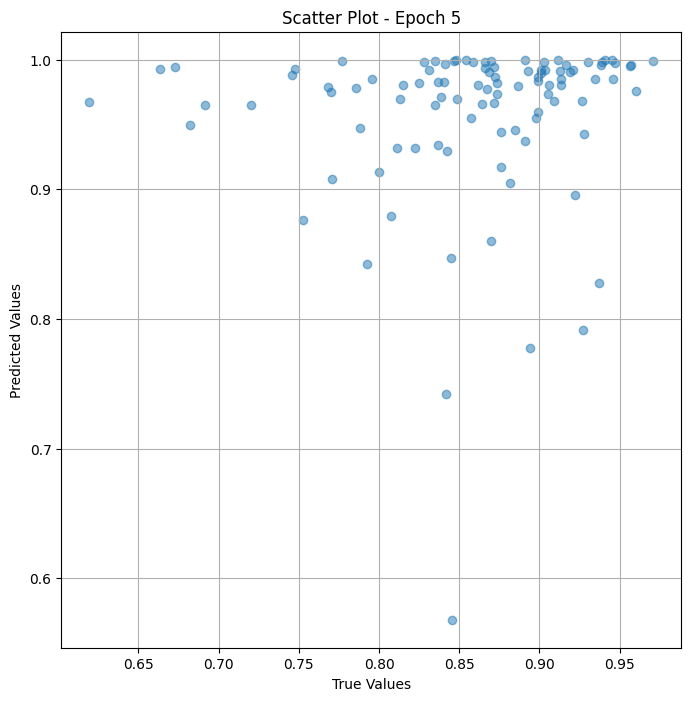


 Epoch: (6/50) Loss = 0.03433338180184364

 Epoch: (6/50) Loss_rmse = 0.18529269099235535

 Epoch: (6/50) R^2 = -1.7414724826812744

 Epoch: (6/50) MAE = 0.14863227307796478

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055, 

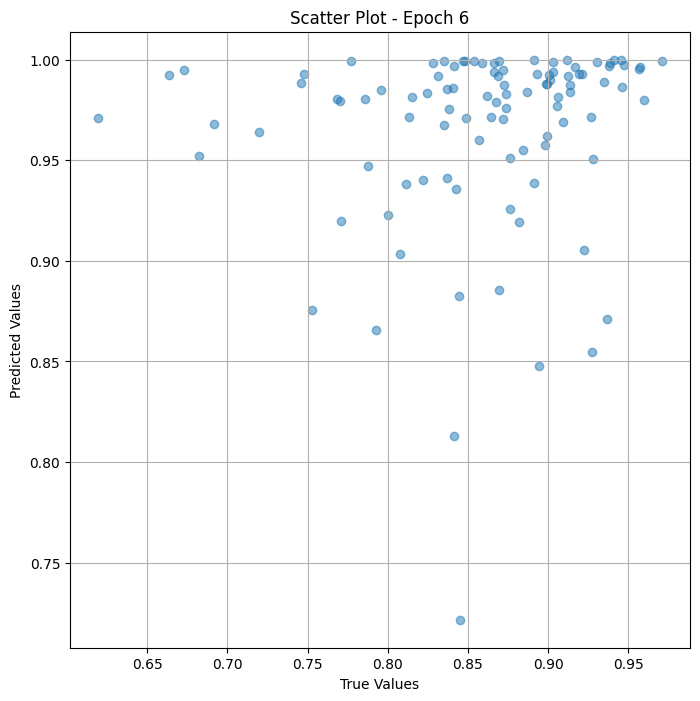


 Epoch: (7/50) Loss = 0.034040503203868866

 Epoch: (7/50) Loss_rmse = 0.18450067937374115

 Epoch: (7/50) R^2 = -1.7180864810943604

 Epoch: (7/50) MAE = 0.14786922931671143

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055,

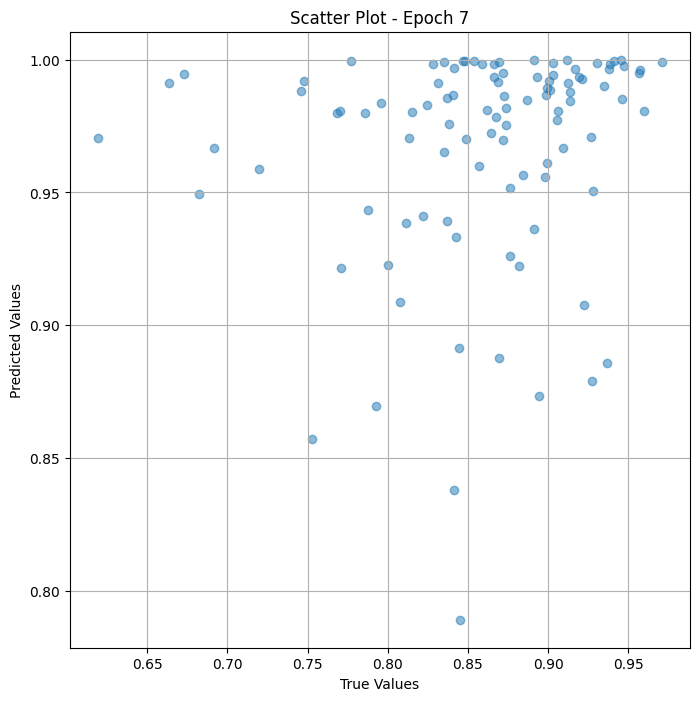


 Epoch: (8/50) Loss = 0.03348231688141823

 Epoch: (8/50) Loss_rmse = 0.18298174440860748

 Epoch: (8/50) R^2 = -1.673516035079956

 Epoch: (8/50) MAE = 0.1463298350572586

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055, 0.

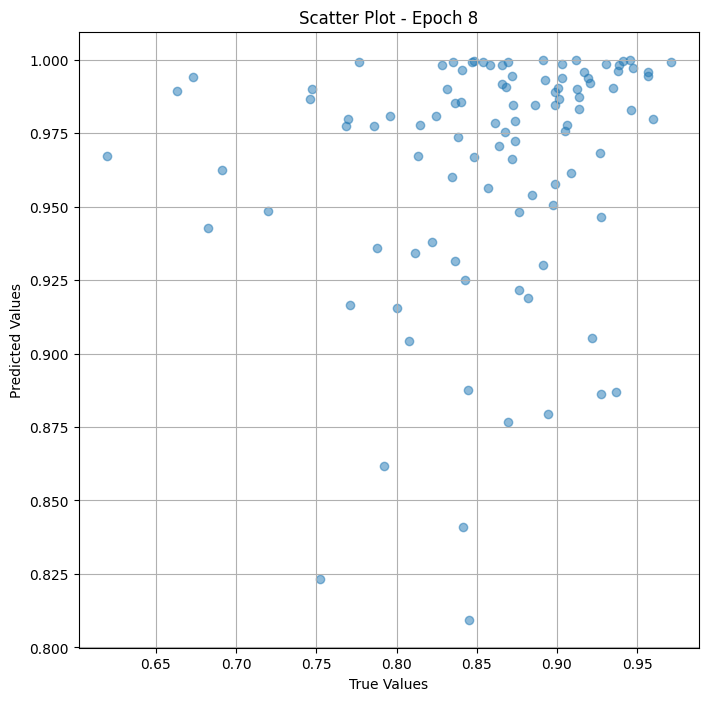


 Epoch: (9/50) Loss = 0.032588567584753036

 Epoch: (9/50) Loss_rmse = 0.18052303791046143

 Epoch: (9/50) R^2 = -1.6021513938903809

 Epoch: (9/50) MAE = 0.14385759830474854

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055,

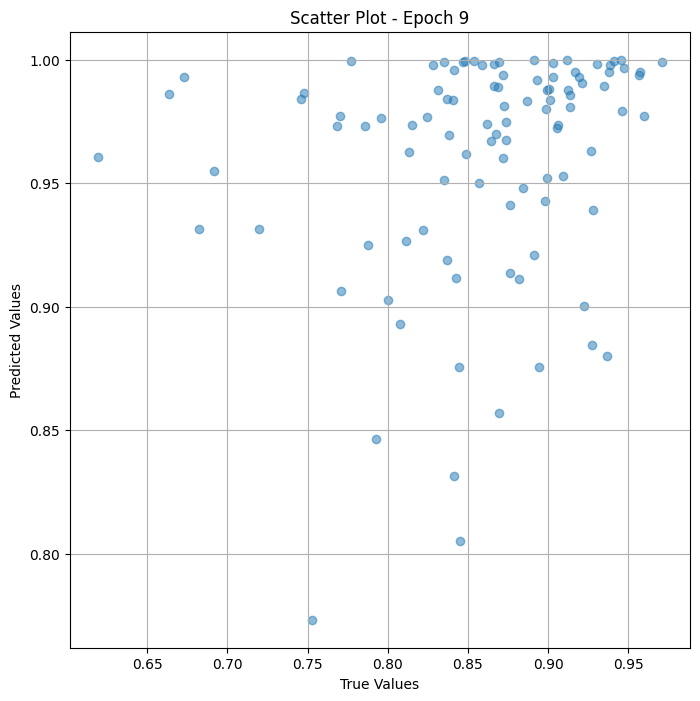


 Epoch: (10/50) Loss = 0.031191319227218628

 Epoch: (10/50) Loss_rmse = 0.17661064863204956

 Epoch: (10/50) R^2 = -1.4905831813812256

 Epoch: (10/50) MAE = 0.14005447924137115

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266

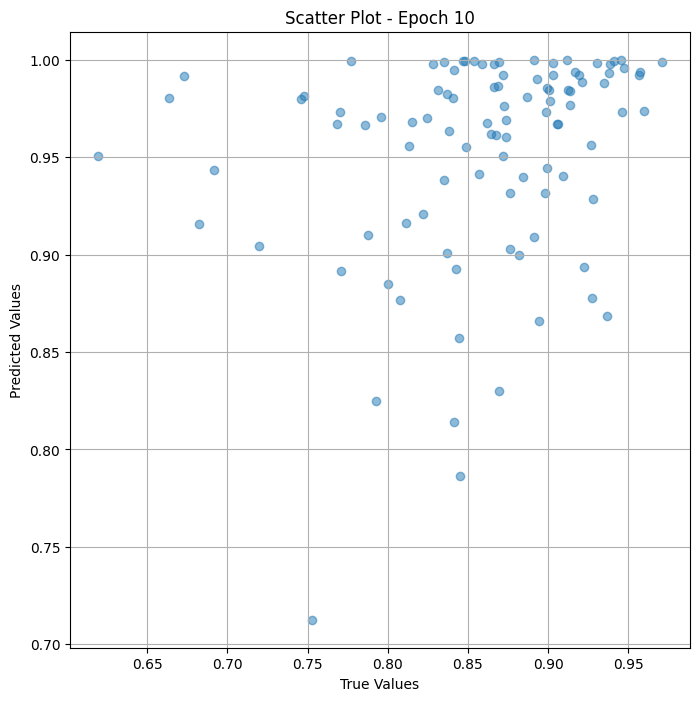


 Epoch: (11/50) Loss = 0.0289495550096035

 Epoch: (11/50) Loss_rmse = 0.1701456904411316

 Epoch: (11/50) R^2 = -1.3115813732147217

 Epoch: (11/50) MAE = 0.13415557146072388

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055

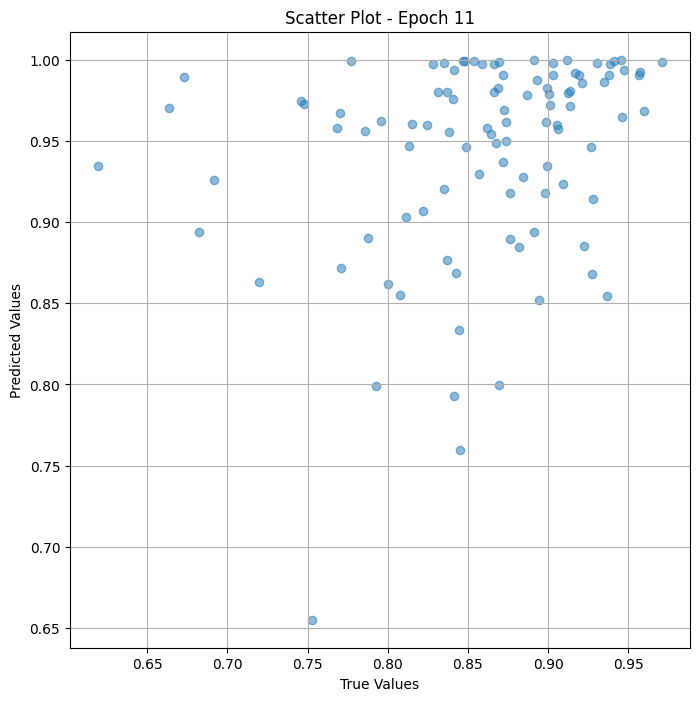


 Epoch: (12/50) Loss = 0.025114651769399643

 Epoch: (12/50) Loss_rmse = 0.15847602486610413

 Epoch: (12/50) R^2 = -1.0053696632385254

 Epoch: (12/50) MAE = 0.12451934814453125

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266

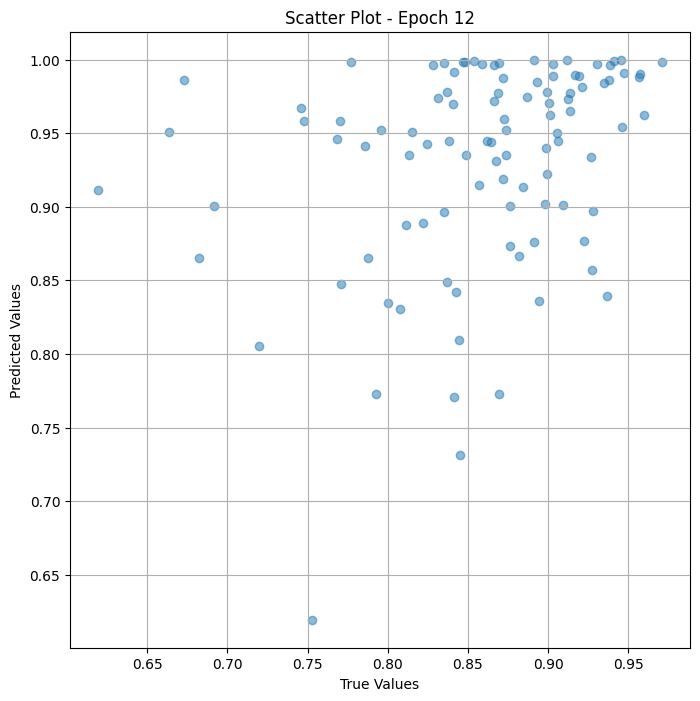


 Epoch: (13/50) Loss = 0.01801193319261074

 Epoch: (13/50) Loss_rmse = 0.134208545088768

 Epoch: (13/50) R^2 = -0.43822765350341797

 Epoch: (13/50) MAE = 0.106887087225914

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055,

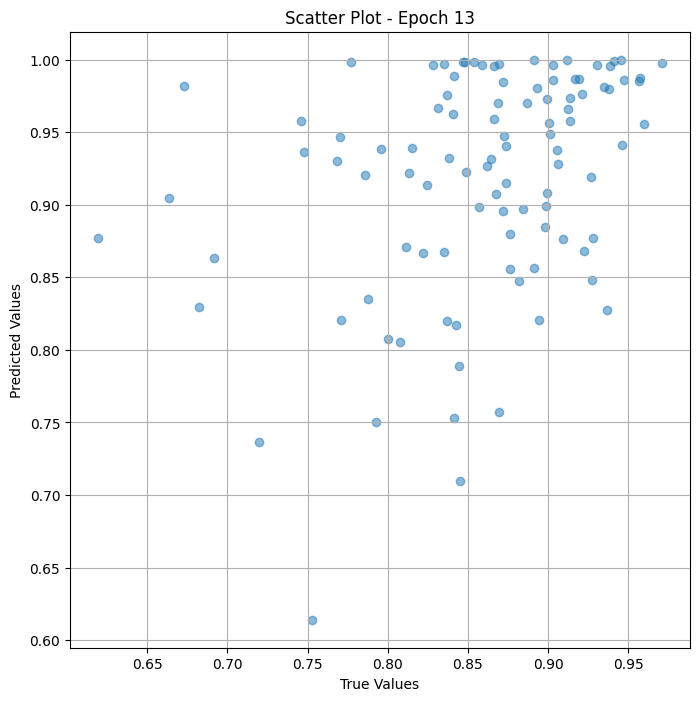


 Epoch: (14/50) Loss = 0.0063826171681284904

 Epoch: (14/50) Loss_rmse = 0.07989128679037094

 Epoch: (14/50) R^2 = 0.490356981754303

 Epoch: (14/50) MAE = 0.070671945810318

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266055

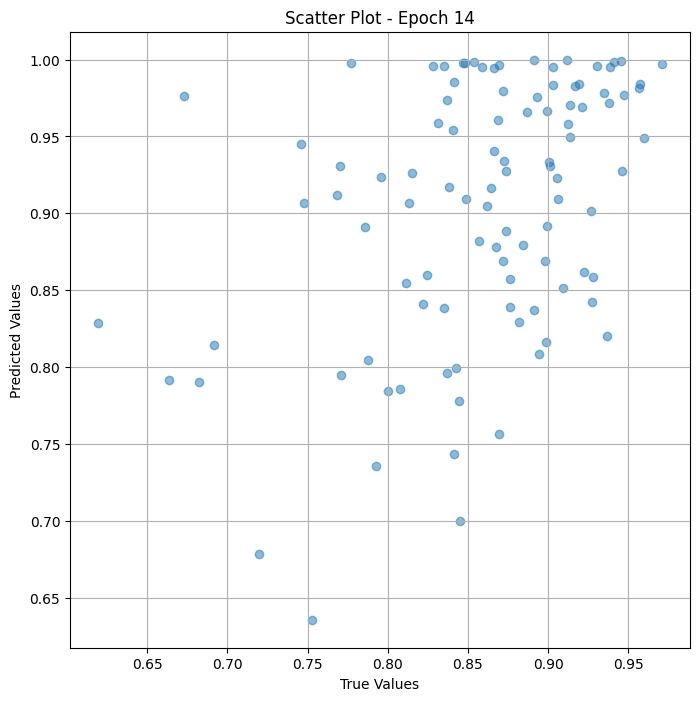


 Epoch: (15/50) Loss = 0.002021524589508772

 Epoch: (15/50) Loss_rmse = 0.044961366802453995

 Epoch: (15/50) R^2 = 0.8385840654373169

 Epoch: (15/50) MAE = 0.04354079067707062

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266

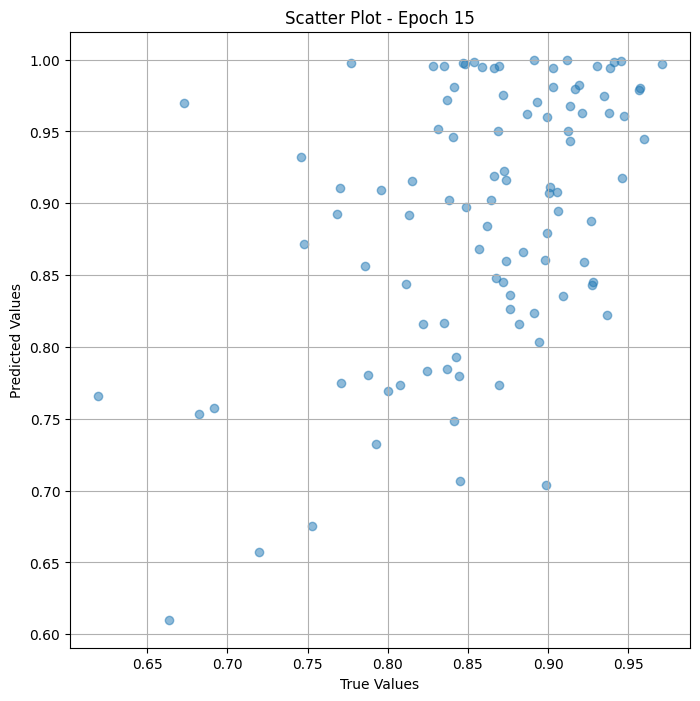


 Epoch: (16/50) Loss = 0.0008804143872112036

 Epoch: (16/50) Loss_rmse = 0.02967177703976631

 Epoch: (16/50) R^2 = 0.9297001361846924

 Epoch: (16/50) MAE = 0.029142335057258606

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.926

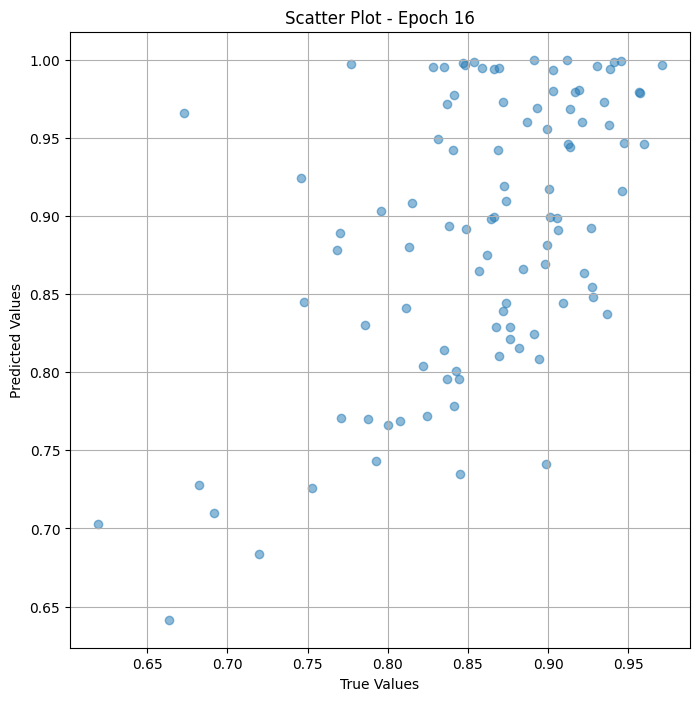


 Epoch: (17/50) Loss = 0.000890741590410471

 Epoch: (17/50) Loss_rmse = 0.02984529361128807

 Epoch: (17/50) R^2 = 0.9288755655288696

 Epoch: (17/50) MAE = 0.02764219045639038

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92660

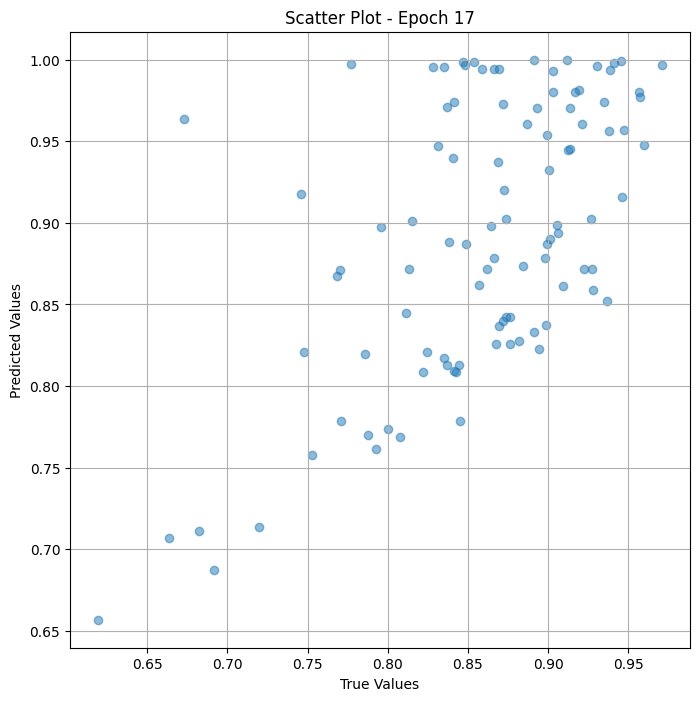


 Epoch: (18/50) Loss = 0.0003395468811504543

 Epoch: (18/50) Loss_rmse = 0.018426798284053802

 Epoch: (18/50) R^2 = 0.9728876352310181

 Epoch: (18/50) MAE = 0.01742406189441681

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.926

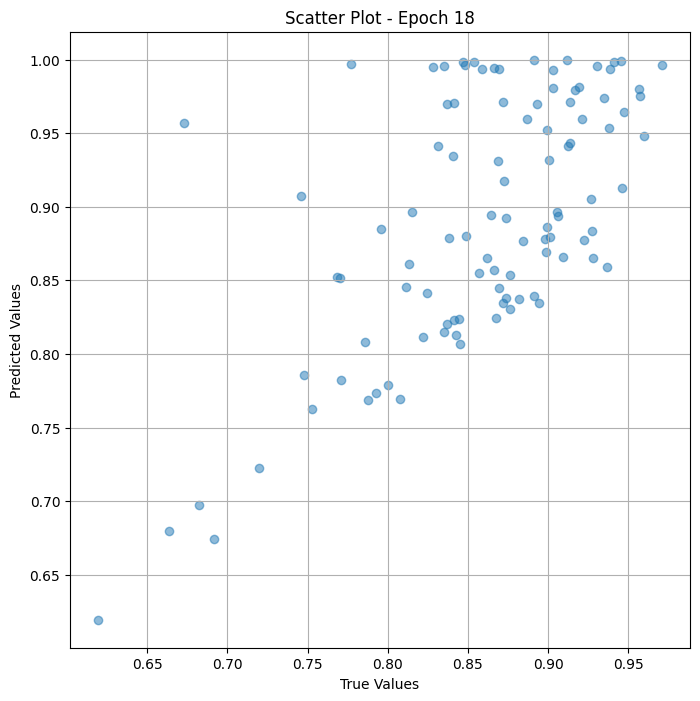


 Epoch: (19/50) Loss = 0.00039803050458431244

 Epoch: (19/50) Loss_rmse = 0.019950702786445618

 Epoch: (19/50) R^2 = 0.9682178497314453

 Epoch: (19/50) MAE = 0.018863871693611145

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

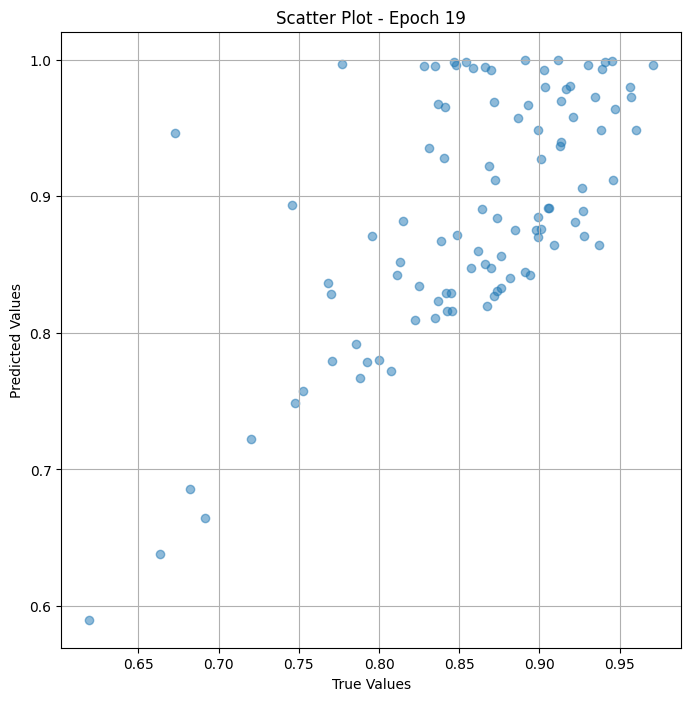


 Epoch: (20/50) Loss = 0.000185355544090271

 Epoch: (20/50) Loss_rmse = 0.0136145344004035

 Epoch: (20/50) R^2 = 0.9851996302604675

 Epoch: (20/50) MAE = 0.01080043613910675

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.926605

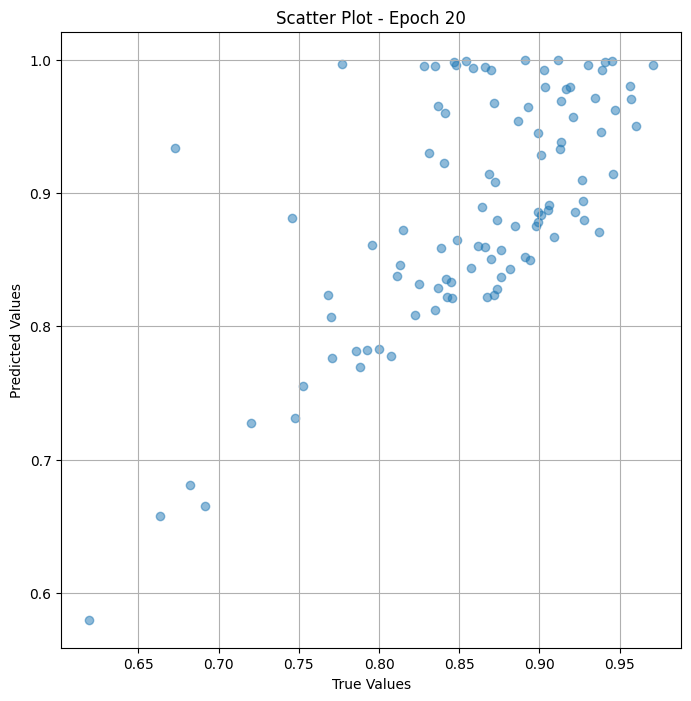


 Epoch: (21/50) Loss = 0.00017234774713870138

 Epoch: (21/50) Loss_rmse = 0.0131281279027462

 Epoch: (21/50) R^2 = 0.9862383008003235

 Epoch: (21/50) MAE = 0.00904776155948639

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266

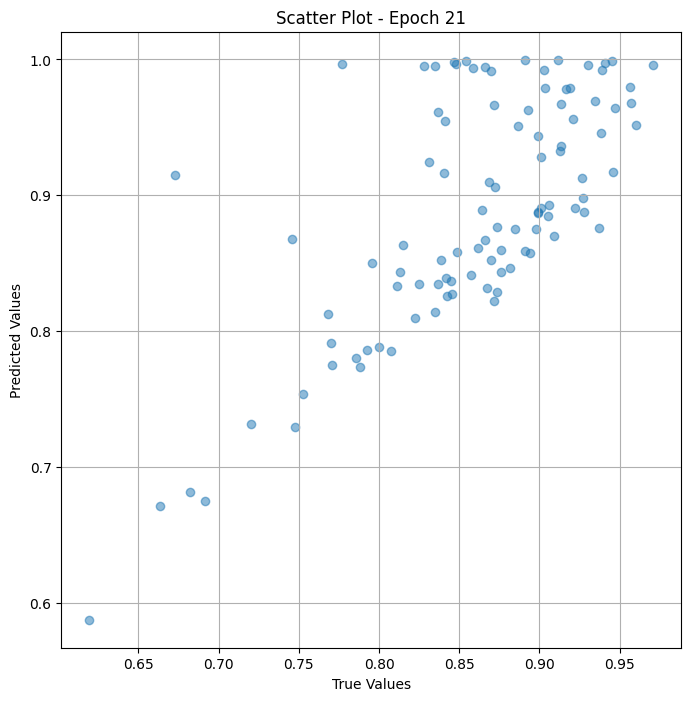


 Epoch: (22/50) Loss = 0.00015742535470053554

 Epoch: (22/50) Loss_rmse = 0.01254692580550909

 Epoch: (22/50) R^2 = 0.9874297976493835

 Epoch: (22/50) MAE = 0.007704883813858032

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

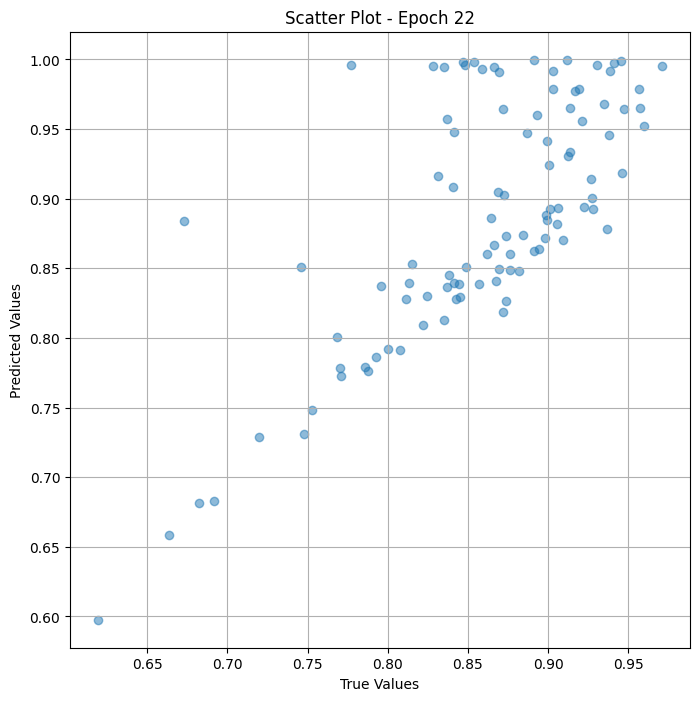


 Epoch: (23/50) Loss = 0.00016439387400168926

 Epoch: (23/50) Loss_rmse = 0.012821617536246777

 Epoch: (23/50) R^2 = 0.9868733882904053

 Epoch: (23/50) MAE = 0.009079456329345703

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

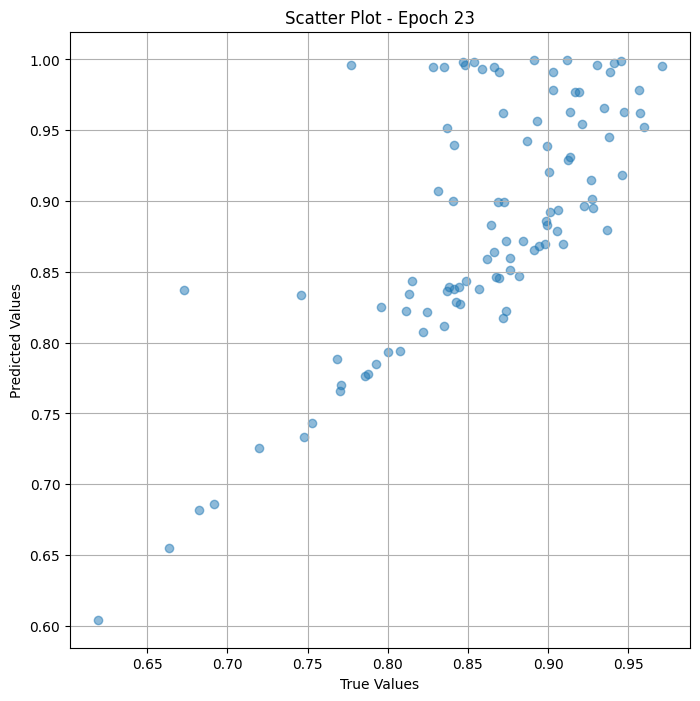


 Epoch: (24/50) Loss = 0.00014458807709161192

 Epoch: (24/50) Loss_rmse = 0.012024478055536747

 Epoch: (24/50) R^2 = 0.9884548187255859

 Epoch: (24/50) MAE = 0.007461845874786377

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

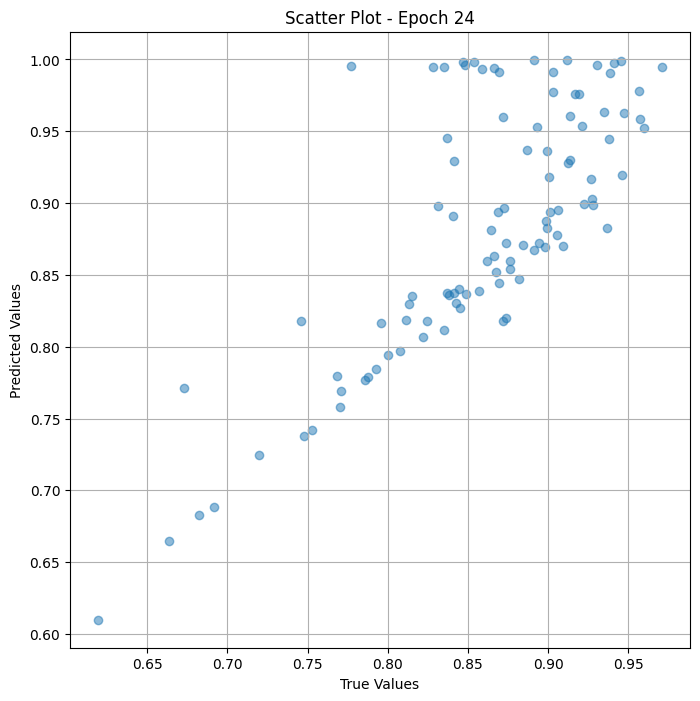


 Epoch: (25/50) Loss = 0.00013967575796414167

 Epoch: (25/50) Loss_rmse = 0.011818449944257736

 Epoch: (25/50) R^2 = 0.9888470768928528

 Epoch: (25/50) MAE = 0.007185950875282288

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

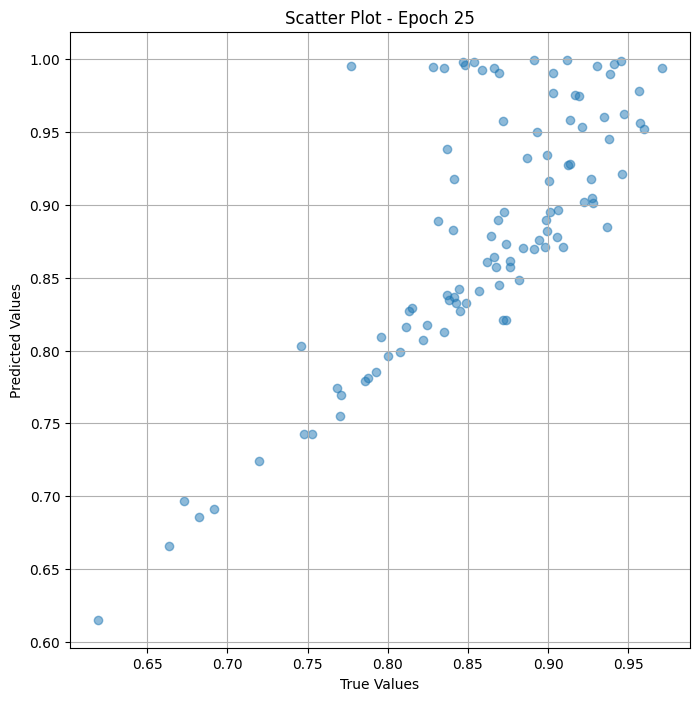


 Epoch: (26/50) Loss = 0.0001325206976616755

 Epoch: (26/50) Loss_rmse = 0.01151176355779171

 Epoch: (26/50) R^2 = 0.9894183874130249

 Epoch: (26/50) MAE = 0.005804881453514099

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.926

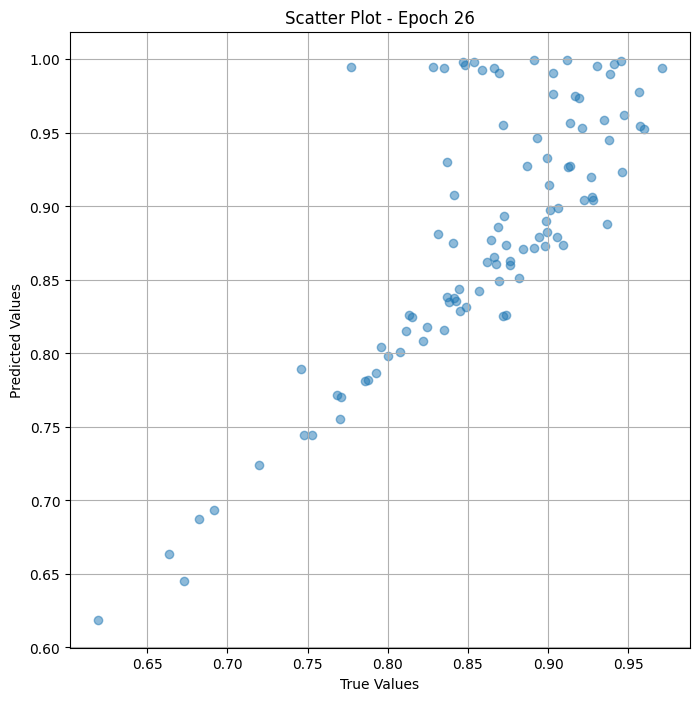


 Epoch: (27/50) Loss = 0.00012848411279264838

 Epoch: (27/50) Loss_rmse = 0.011335083283483982

 Epoch: (27/50) R^2 = 0.9897407293319702

 Epoch: (27/50) MAE = 0.006206393241882324

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

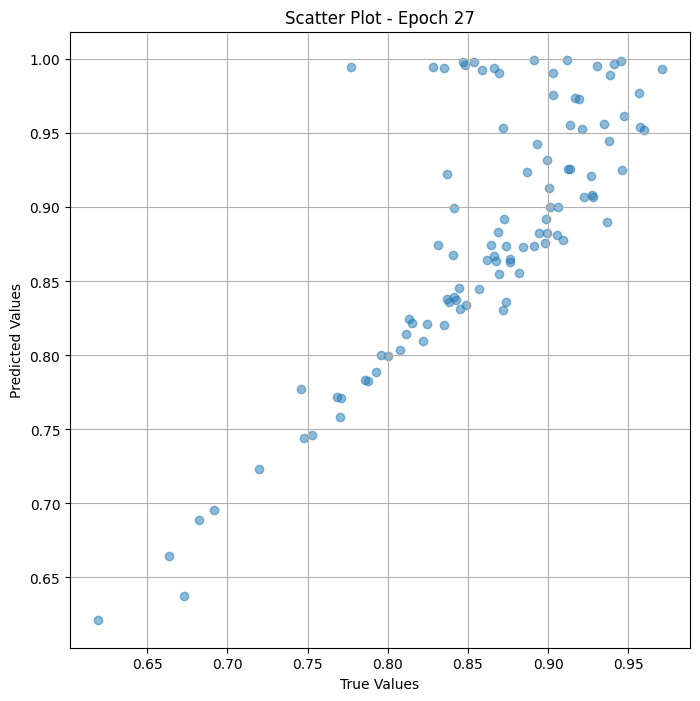


 Epoch: (28/50) Loss = 0.0001227816246682778

 Epoch: (28/50) Loss_rmse = 0.011080686934292316

 Epoch: (28/50) R^2 = 0.9901960492134094

 Epoch: (28/50) MAE = 0.005597308278083801

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

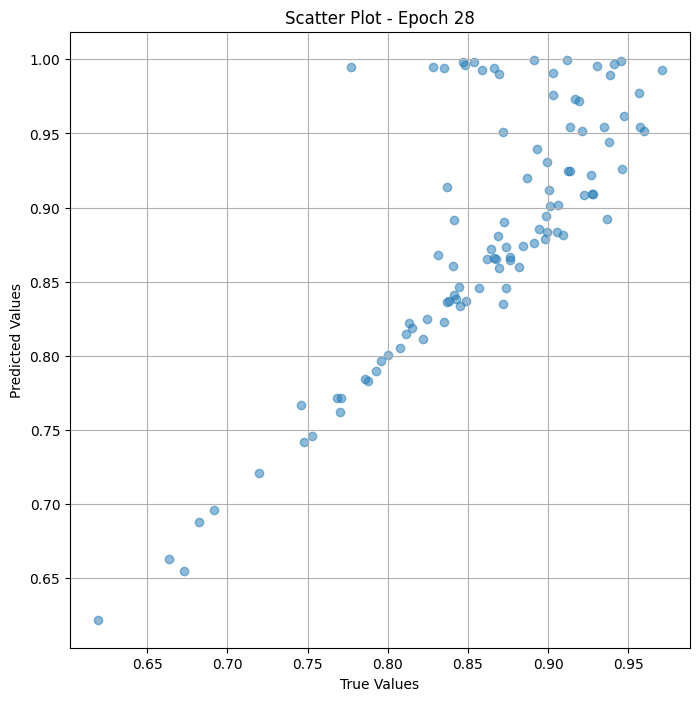


 Epoch: (29/50) Loss = 0.00011841514060506597

 Epoch: (29/50) Loss_rmse = 0.010881871916353703

 Epoch: (29/50) R^2 = 0.9905447363853455

 Epoch: (29/50) MAE = 0.00647309422492981

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

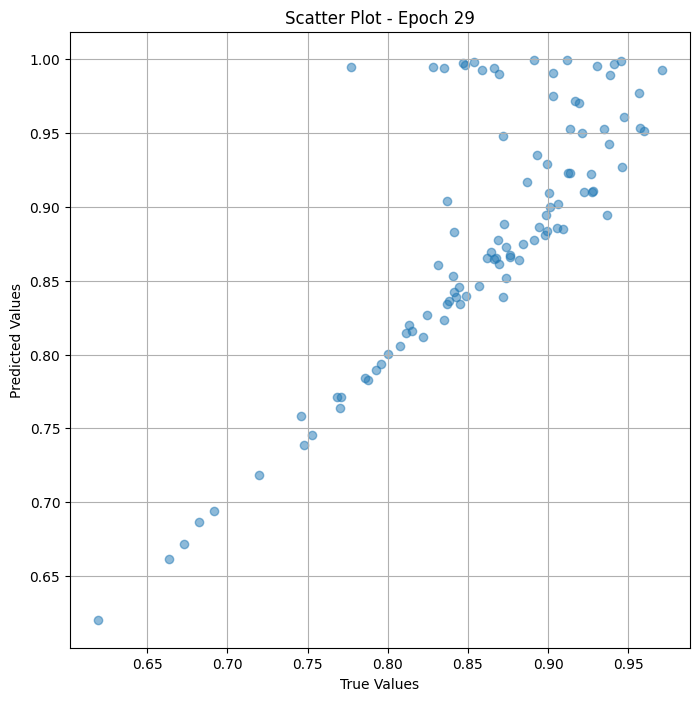


 Epoch: (30/50) Loss = 0.00011264954082434997

 Epoch: (30/50) Loss_rmse = 0.010613649152219296

 Epoch: (30/50) R^2 = 0.9910050630569458

 Epoch: (30/50) MAE = 0.006340637803077698

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

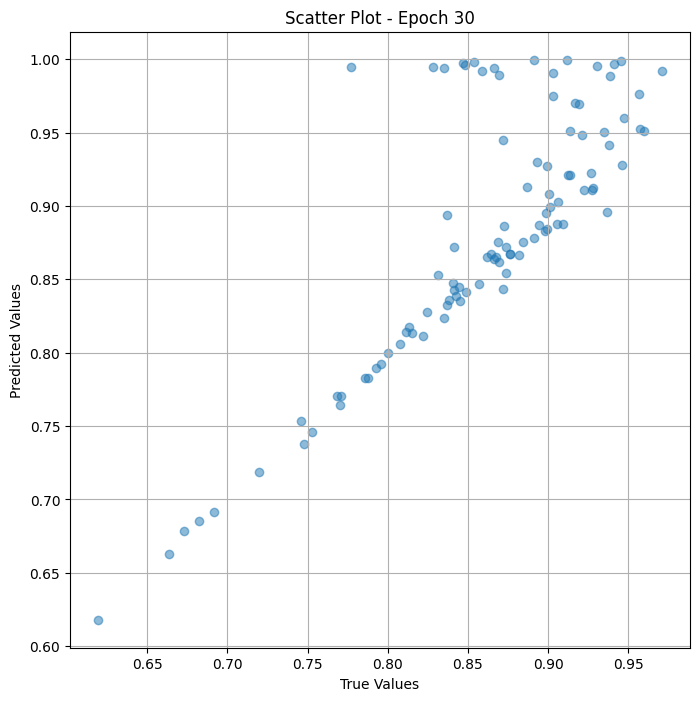


 Epoch: (31/50) Loss = 0.00010611559264361858

 Epoch: (31/50) Loss_rmse = 0.010301242582499981

 Epoch: (31/50) R^2 = 0.9915268421173096

 Epoch: (31/50) MAE = 0.005891352891921997

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

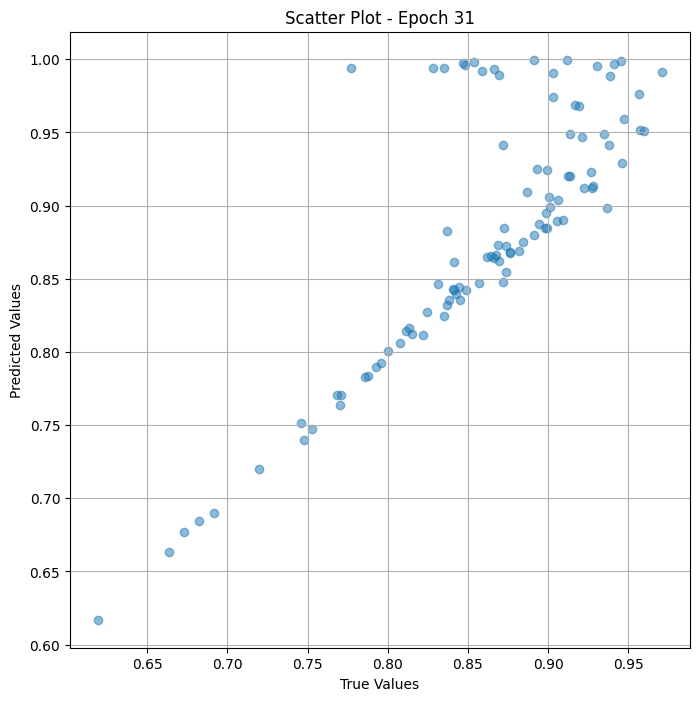


 Epoch: (32/50) Loss = 9.99540279735811e-05

 Epoch: (32/50) Loss_rmse = 0.009997701272368431

 Epoch: (32/50) R^2 = 0.9920188188552856

 Epoch: (32/50) MAE = 0.005666807293891907

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.926

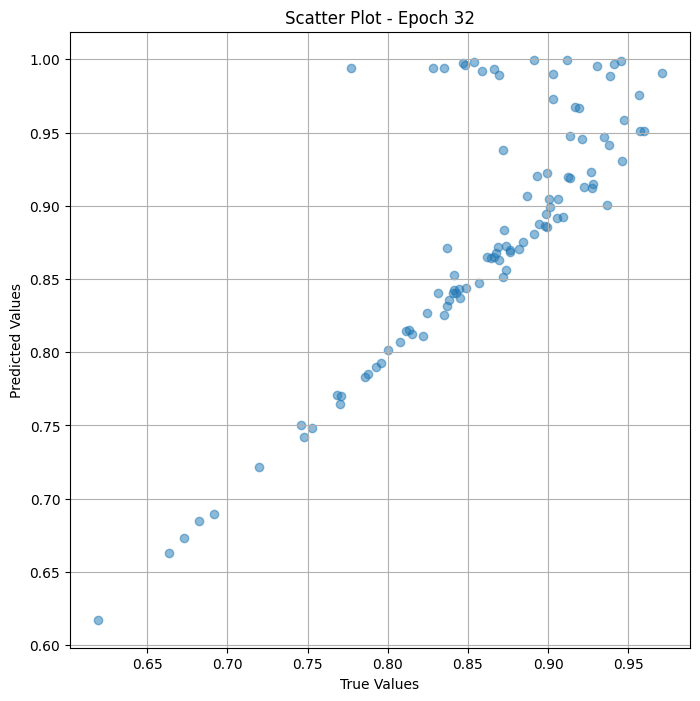


 Epoch: (33/50) Loss = 9.398863767273724e-05

 Epoch: (33/50) Loss_rmse = 0.009694773703813553

 Epoch: (33/50) R^2 = 0.9924951195716858

 Epoch: (33/50) MAE = 0.005384653806686401

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

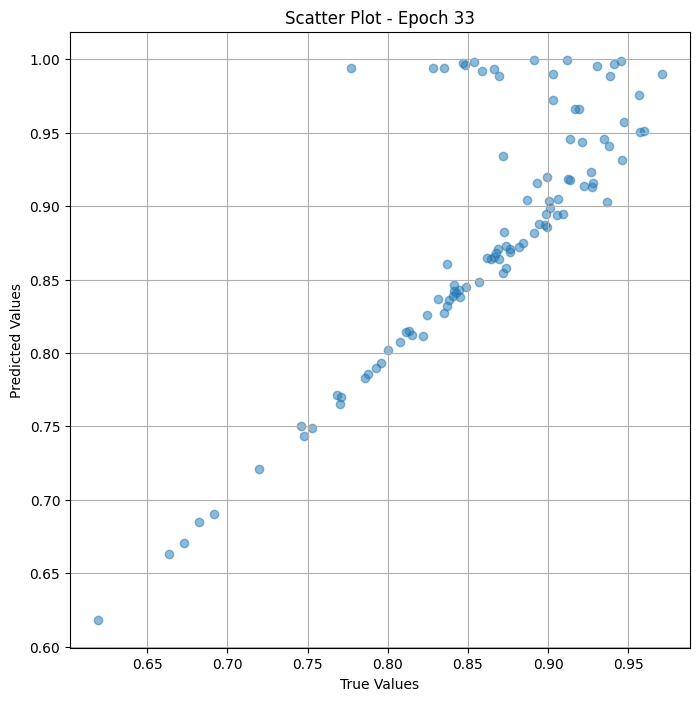


 Epoch: (34/50) Loss = 8.832543971948326e-05

 Epoch: (34/50) Loss_rmse = 0.009398161433637142

 Epoch: (34/50) R^2 = 0.9929473400115967

 Epoch: (34/50) MAE = 0.005236178636550903

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

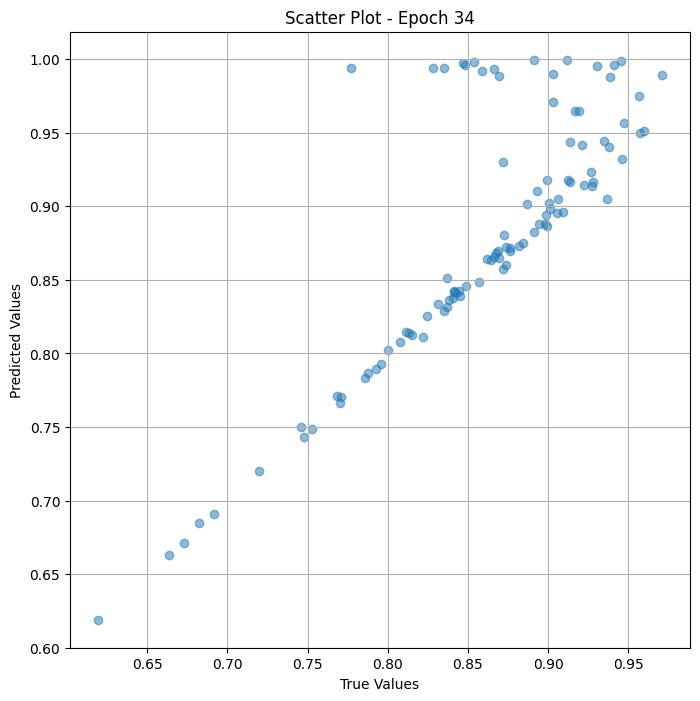


 Epoch: (35/50) Loss = 8.28667834866792e-05

 Epoch: (35/50) Loss_rmse = 0.009103119373321533

 Epoch: (35/50) R^2 = 0.9933832287788391

 Epoch: (35/50) MAE = 0.00517609715461731

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9266

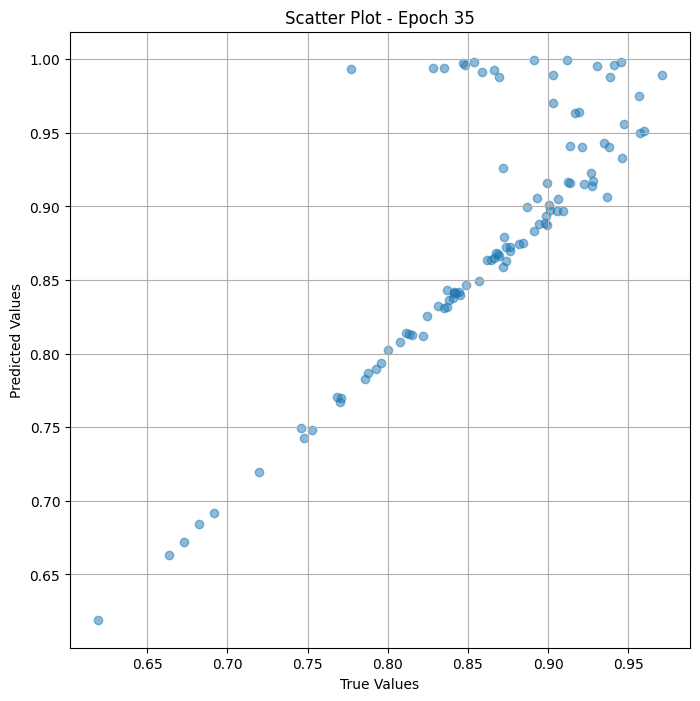


 Epoch: (36/50) Loss = 7.751656085019931e-05

 Epoch: (36/50) Loss_rmse = 0.008804349228739738

 Epoch: (36/50) R^2 = 0.9938104152679443

 Epoch: (36/50) MAE = 0.0050343722105026245

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

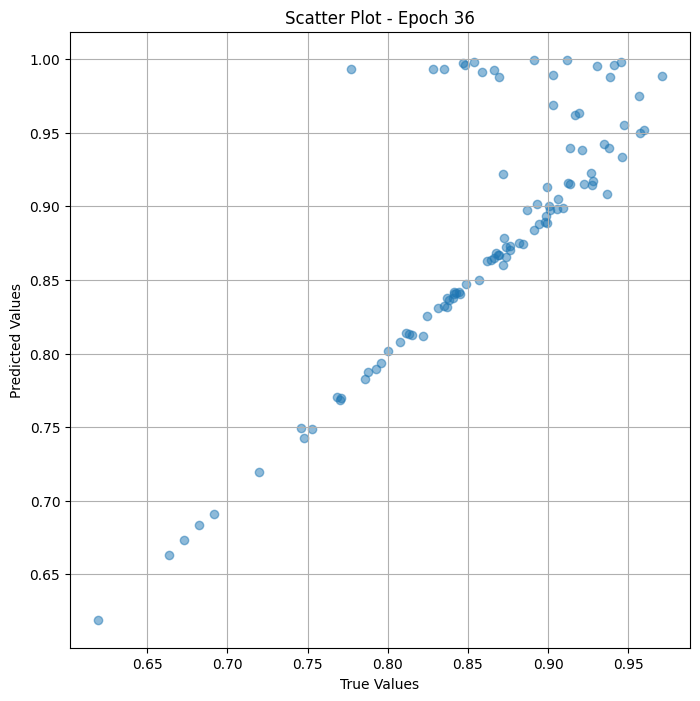


 Epoch: (37/50) Loss = 7.234478835016489e-05

 Epoch: (37/50) Loss_rmse = 0.008505573496222496

 Epoch: (37/50) R^2 = 0.9942233562469482

 Epoch: (37/50) MAE = 0.004843160510063171

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

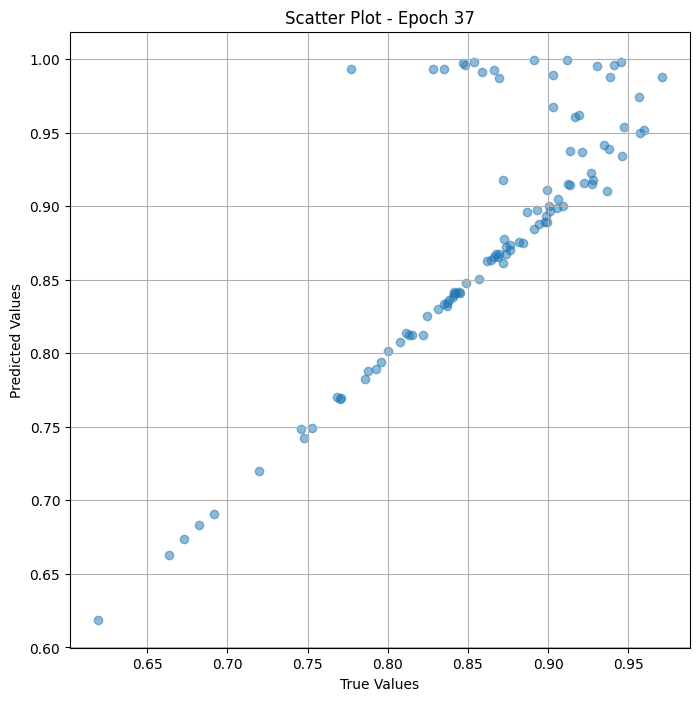


 Epoch: (38/50) Loss = 6.746272265445441e-05

 Epoch: (38/50) Loss_rmse = 0.008213569410145283

 Epoch: (38/50) R^2 = 0.9946131706237793

 Epoch: (38/50) MAE = 0.0046977996826171875

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

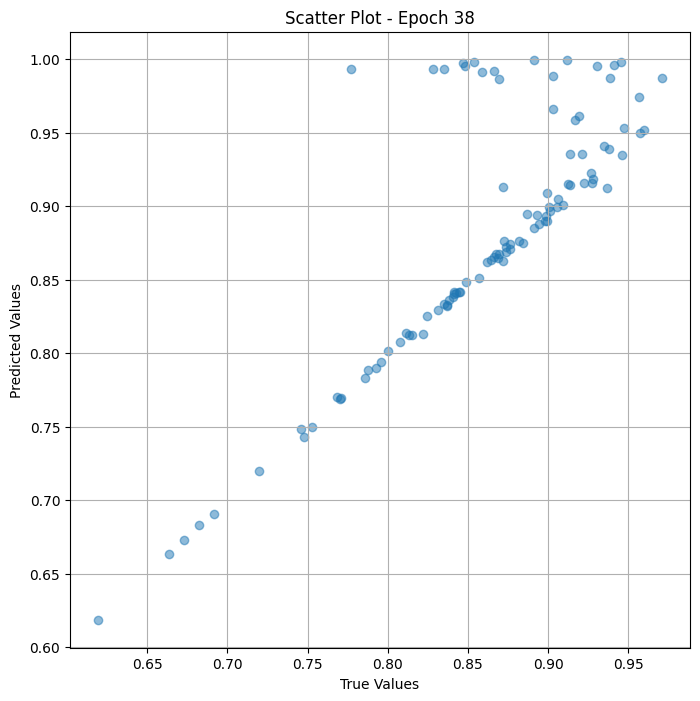


 Epoch: (39/50) Loss = 6.287123687798157e-05

 Epoch: (39/50) Loss_rmse = 0.007929138839244843

 Epoch: (39/50) R^2 = 0.9949797987937927

 Epoch: (39/50) MAE = 0.004531189799308777

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

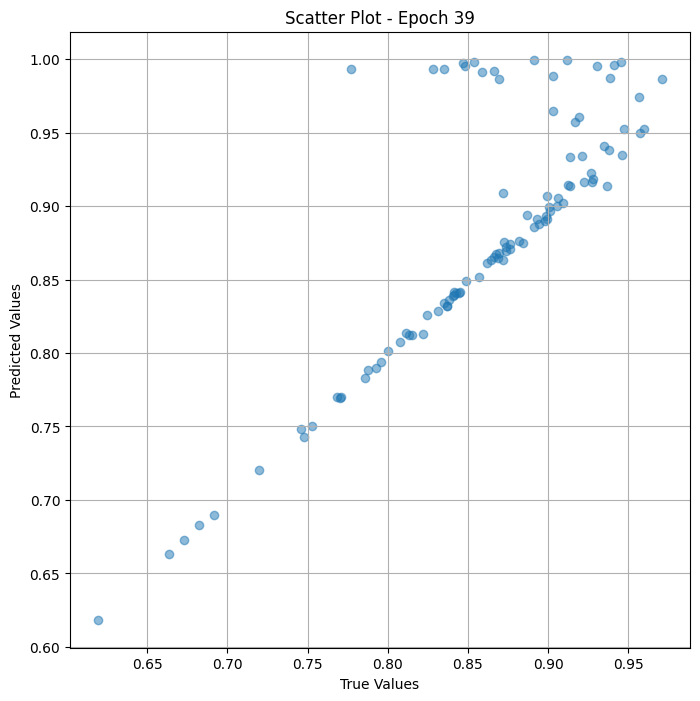


 Epoch: (40/50) Loss = 5.860784585820511e-05

 Epoch: (40/50) Loss_rmse = 0.007655576337128878

 Epoch: (40/50) R^2 = 0.9953202605247498

 Epoch: (40/50) MAE = 0.004393026232719421

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

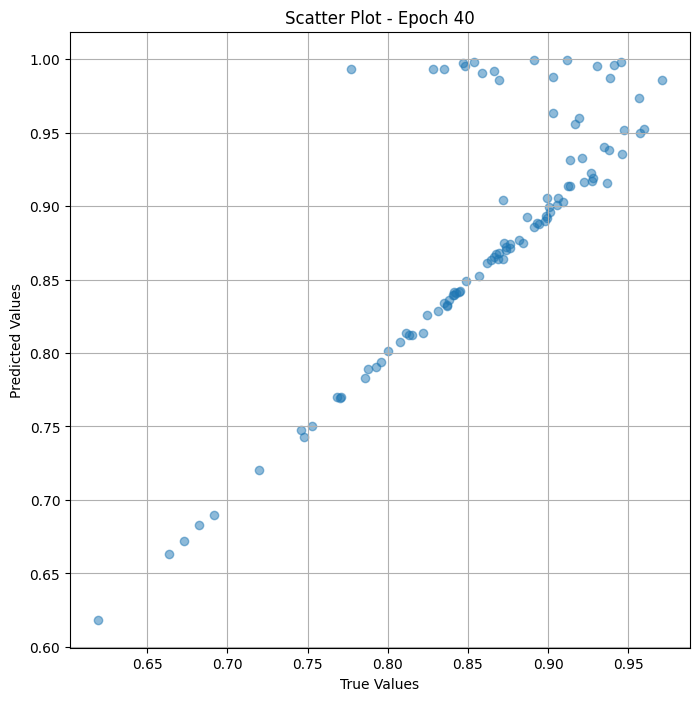


 Epoch: (41/50) Loss = 5.459678504848853e-05

 Epoch: (41/50) Loss_rmse = 0.007388963829725981

 Epoch: (41/50) R^2 = 0.9956405162811279

 Epoch: (41/50) MAE = 0.004247024655342102

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

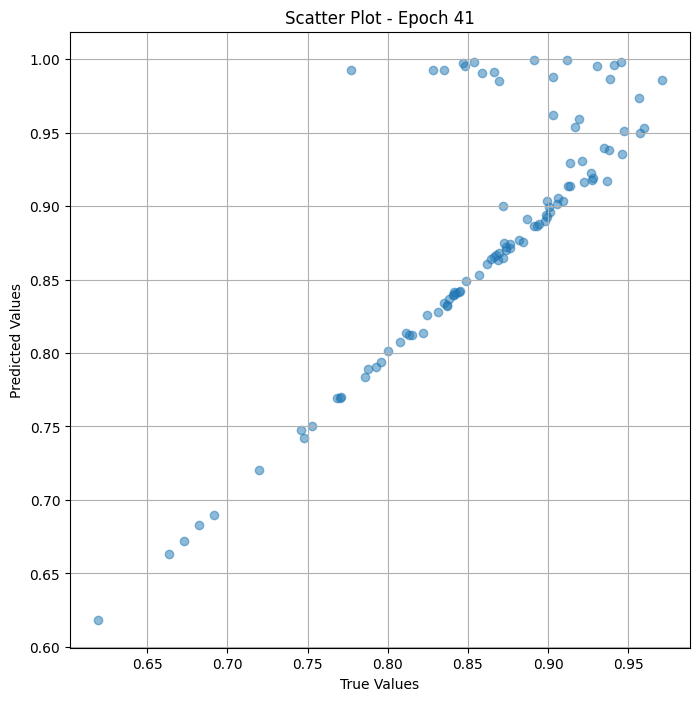


 Epoch: (42/50) Loss = 5.08563534822315e-05

 Epoch: (42/50) Loss_rmse = 0.007131364196538925

 Epoch: (42/50) R^2 = 0.9959391951560974

 Epoch: (42/50) MAE = 0.004105016589164734

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.926

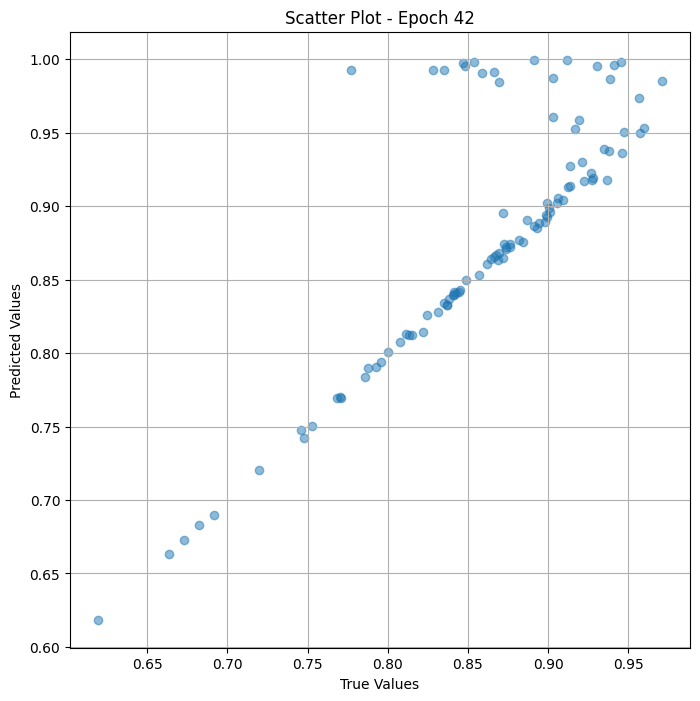


 Epoch: (43/50) Loss = 4.734712638310157e-05

 Epoch: (43/50) Loss_rmse = 0.006880925036966801

 Epoch: (43/50) R^2 = 0.9962193965911865

 Epoch: (43/50) MAE = 0.003974616527557373

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

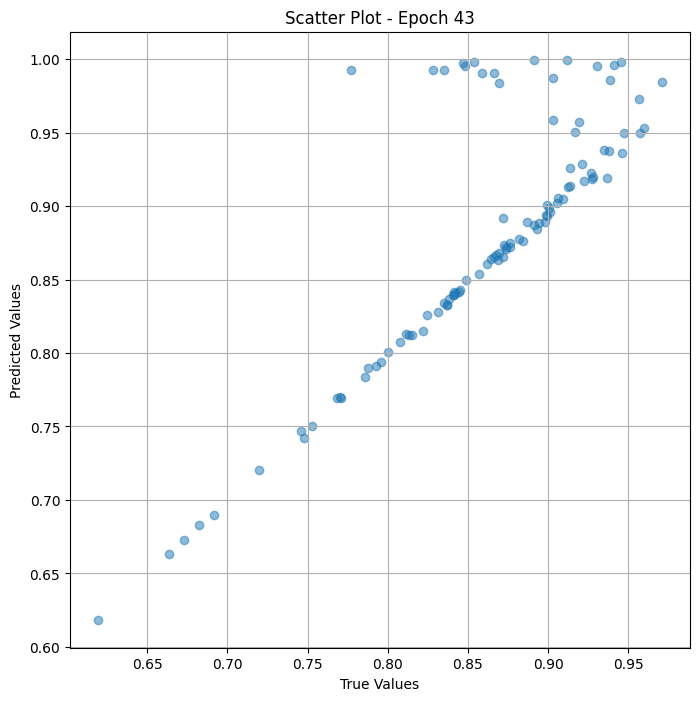


 Epoch: (44/50) Loss = 4.401530895847827e-05

 Epoch: (44/50) Loss_rmse = 0.006634403485804796

 Epoch: (44/50) R^2 = 0.9964854121208191

 Epoch: (44/50) MAE = 0.0038398802280426025

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

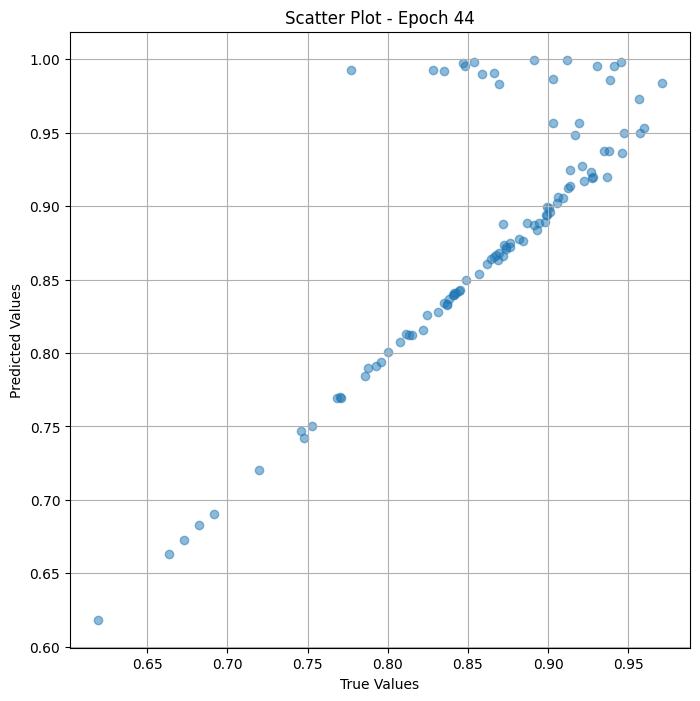


 Epoch: (45/50) Loss = 4.085104228579439e-05

 Epoch: (45/50) Loss_rmse = 0.006391481962054968

 Epoch: (45/50) R^2 = 0.996738076210022

 Epoch: (45/50) MAE = 0.0037125498056411743

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

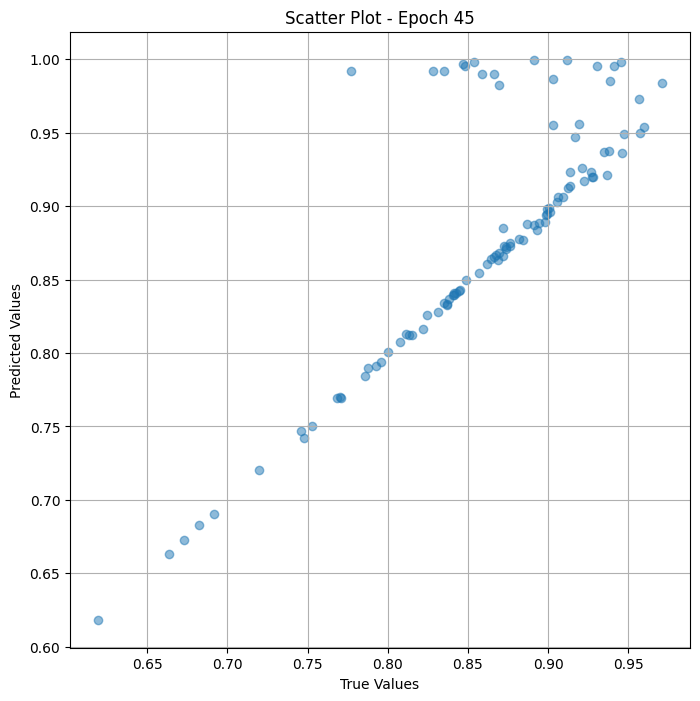


 Epoch: (46/50) Loss = 3.782142448471859e-05

 Epoch: (46/50) Loss_rmse = 0.006149912718683481

 Epoch: (46/50) R^2 = 0.9969800114631653

 Epoch: (46/50) MAE = 0.003575056791305542

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

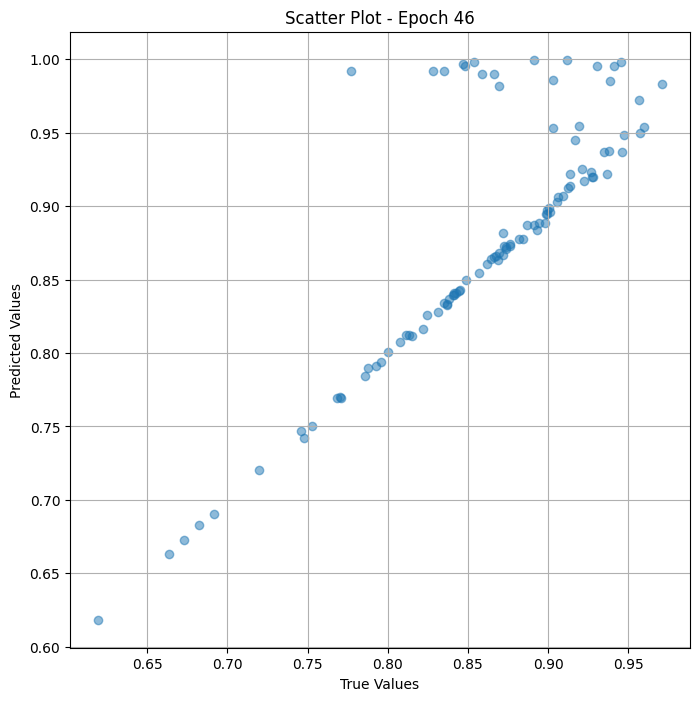


 Epoch: (47/50) Loss = 3.4898752346634865e-05

 Epoch: (47/50) Loss_rmse = 0.005907516460865736

 Epoch: (47/50) R^2 = 0.9972133636474609

 Epoch: (47/50) MAE = 0.0034540295600891113

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.

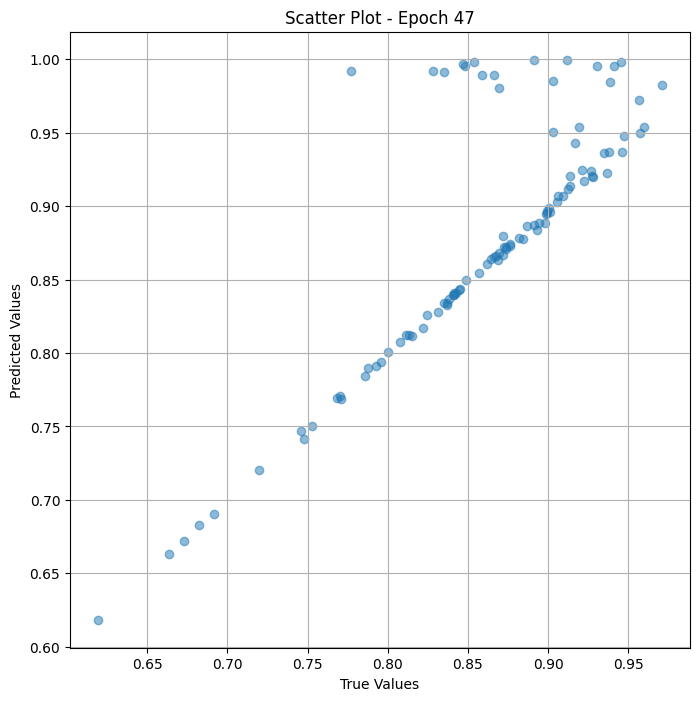


 Epoch: (48/50) Loss = 3.207269401173107e-05

 Epoch: (48/50) Loss_rmse = 0.005663275718688965

 Epoch: (48/50) R^2 = 0.9974390268325806

 Epoch: (48/50) MAE = 0.003324955701828003

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.92

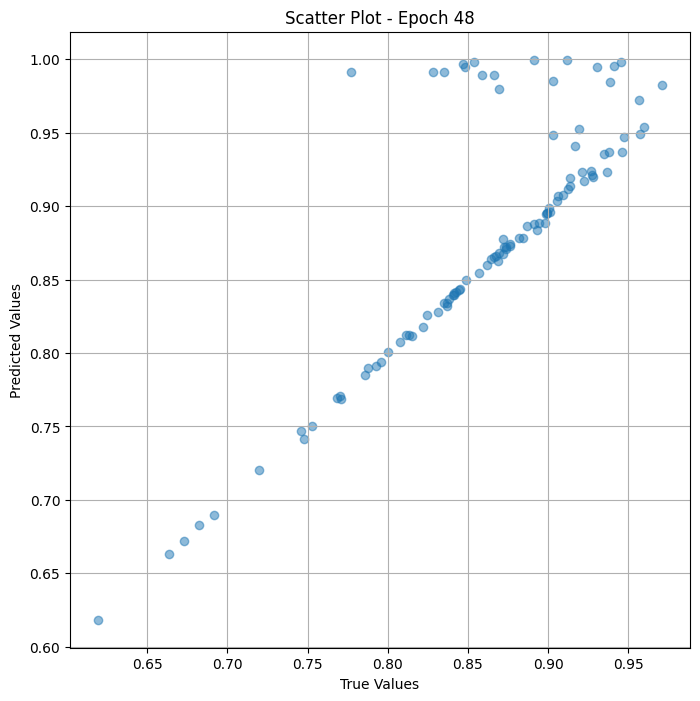


 Epoch: (49/50) Loss = 2.9352037017815746e-05

 Epoch: (49/50) Loss_rmse = 0.005417752079665661

 Epoch: (49/50) R^2 = 0.9976562857627869

 Epoch: (49/50) MAE = 0.0032047629356384277

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.

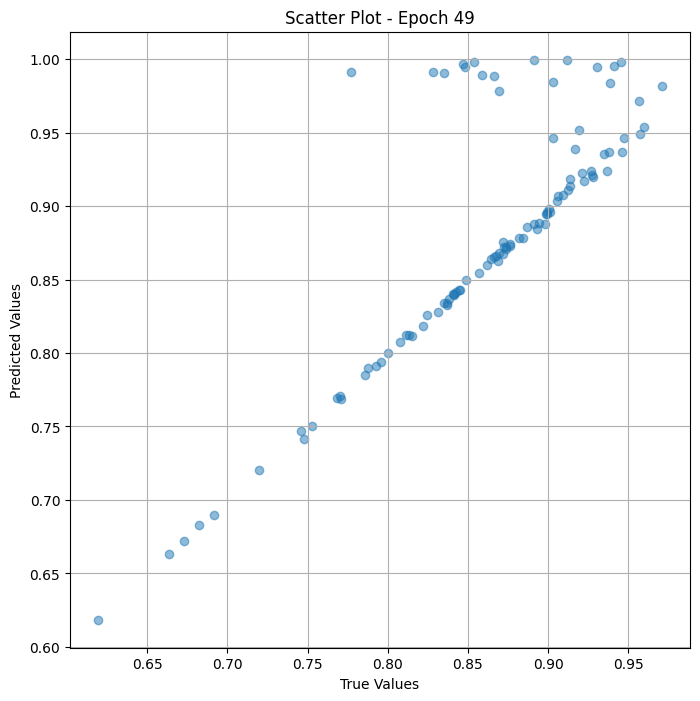


 Epoch: (50/50) Loss = 2.6693793188314885e-05

 Epoch: (50/50) Loss_rmse = 0.005166603717952967

 Epoch: (50/50) R^2 = 0.997868537902832

 Epoch: (50/50) MAE = 0.0030665695667266846

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.69148934, 0.8761905, 0.8452381, 0.61946905, 0.8695652, 0.8684211, 0.8, 0.8761905, 0.94736844, 0.9191919, 0.8943089, 0.77, 0.86734694, 0.8817204, 0.8989899, 0.9029126, 0.9347826, 0.7924528, 0.9126214, 0.92727274, 0.78571427, 0.9052632, 0.77678573, 0.8367347, 0.9032258, 0.83516484, 0.82222223, 0.9117647, 0.88659793, 0.7708333, 0.9381443, 0.8076923, 0.8411215, 0.9166667, 0.90625, 0.87234044, 0.88461536, 0.8446602, 0.7878788, 0.8736842, 0.9207921, 0.84810126, 0.89285713, 0.8131868, 0.9220779, 0.8113208, 0.82474226, 0.682243, 0.94545454, 0.8367347, 0.83838385, 0.9569892, 0.85858583, 0.8484849, 0.8660714, 0.74757284, 0.76842105, 0.8913044, 0.91346157, 0.93043476, 0.8717949, 0.90909094, 0.8988764, 0.92771083, 0.8148148, 0.9

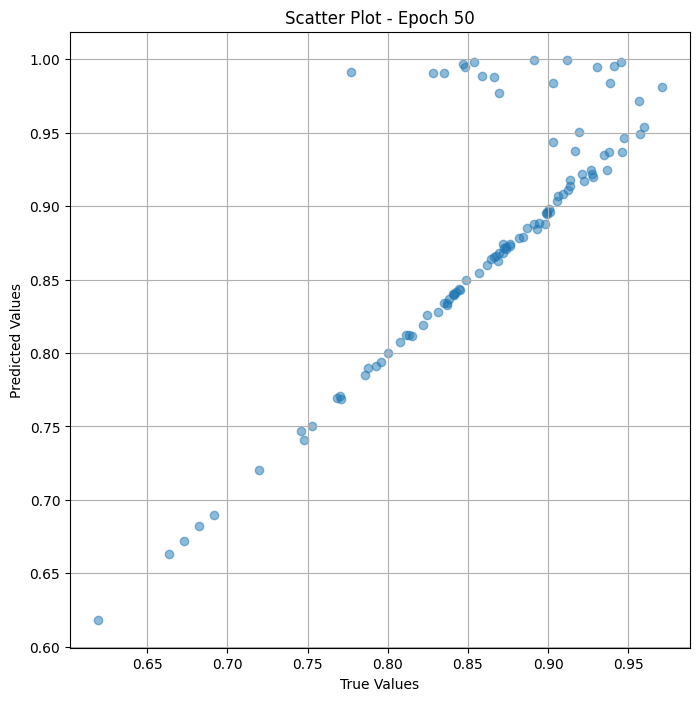

In [ ]:
# Training the model and save weights
fit(50, modelfine_val, train_dl_val)
torch.save(model.state_dict(), "model_weights_valr_fine")

## Test

In [ ]:
# Merge the two models
class model_merge_fine_test(nn.Module):
    def __init__(self, model_trans_top, trans_layer_norm, model_Res,mymodel ):
        super().__init__()
        # All the trans model layers
        self.model_trans_top = model_trans_top
        self.trans_layer_norm = trans_layer_norm
        self.trans_flatten = nn.Flatten()
        self.trans_linear = nn.Linear(150528, 2048)

        # All the ResNet model
        self.model_Res = model_Res

        # Merge the result and pass the
        #self.dropout = nn.Dropout(dp_rate)
        self.linear1 = nn.Linear(4096, 500)
        self.linear2 = nn.Linear(500,1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, trans_b, res_b):
        # Get intermediate outputs using hidden layer
        result_trans = self.model_trans_top(trans_b)
        patch_state = result_trans.last_hidden_state[:,1:,:] # Remove the classification token and get the last hidden state of all patchs
        result_trans = self.trans_layer_norm(patch_state)
        result_trans = self.trans_flatten(patch_state)
        #result_trans = self.dropout(result_trans)
        result_trans = self.trans_linear(result_trans)

        result_res = self.model_Res(res_b)
        result_res = result_res.view(result_res.size(0), -1)  # Equivalent to squeeze and reshape

        result_merge = torch.cat((result_trans, result_res),1)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear1(result_merge)
        #result_merge = self.dropout(result_merge)
        result_merge = self.linear2(result_merge)
        result_merge = self.sigmoid(result_merge)
        return result_merge


model_fine_test = model_merge_fine_test(model_trans_top, trans_layer_norm, model_Res,mymodel )

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_test = DeviceDataLoader(train_dl_test, device)
model_fine_test = to_device(model_fine_test, device)

In [ ]:
# Define optimizer and learning_rate scheduler
params = [param for param in list(model_fine_test.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-7 , weight_decay=1e-7)
lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_fine_test , train_dl_test ):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_fine_test .eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, x_res, yb in train_dl_test :
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_fine_test (x_trans,x_res)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.0446014478802681

 Epoch: (1/50) Loss_rmse = 0.21119055151939392

 Epoch: (1/50) R^2 = -40.120548248291016

 Epoch: (1/50) MAE = 0.13220664858818054

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.86868

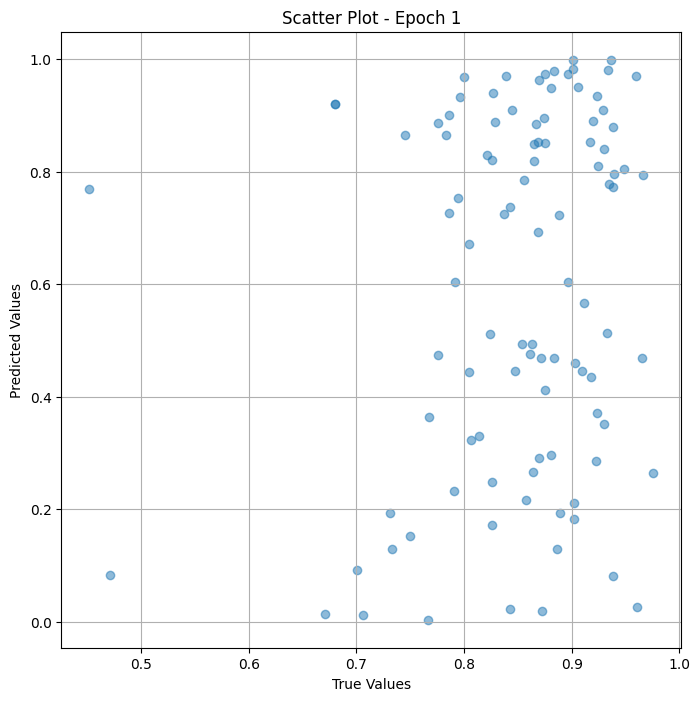


 Epoch: (2/50) Loss = 0.010608861222863197

 Epoch: (2/50) Loss_rmse = 0.10299932956695557

 Epoch: (2/50) R^2 = -8.78089714050293

 Epoch: (2/50) MAE = 0.09602567553520203

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.86868

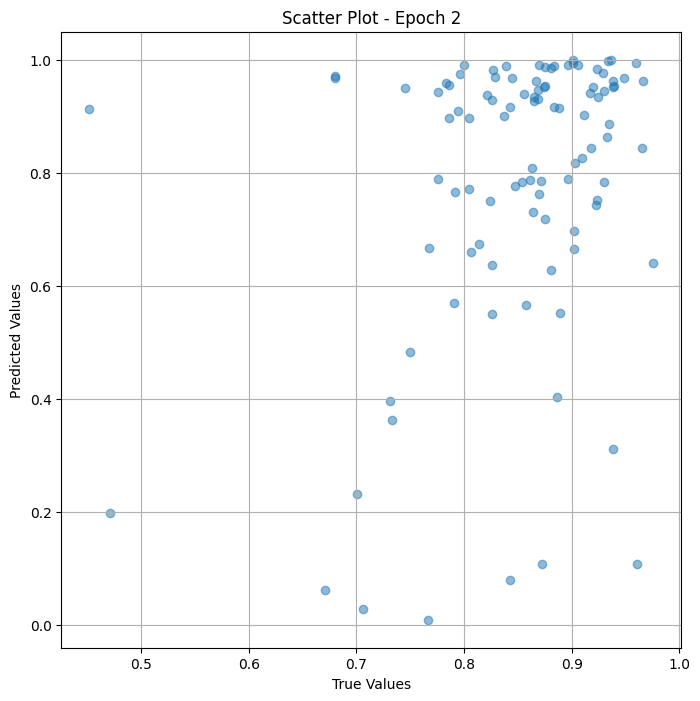


 Epoch: (3/50) Loss = 0.01811414211988449

 Epoch: (3/50) Loss_rmse = 0.1345887929201126

 Epoch: (3/50) R^2 = -15.700431823730469

 Epoch: (3/50) MAE = 0.13267196714878082

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.86868

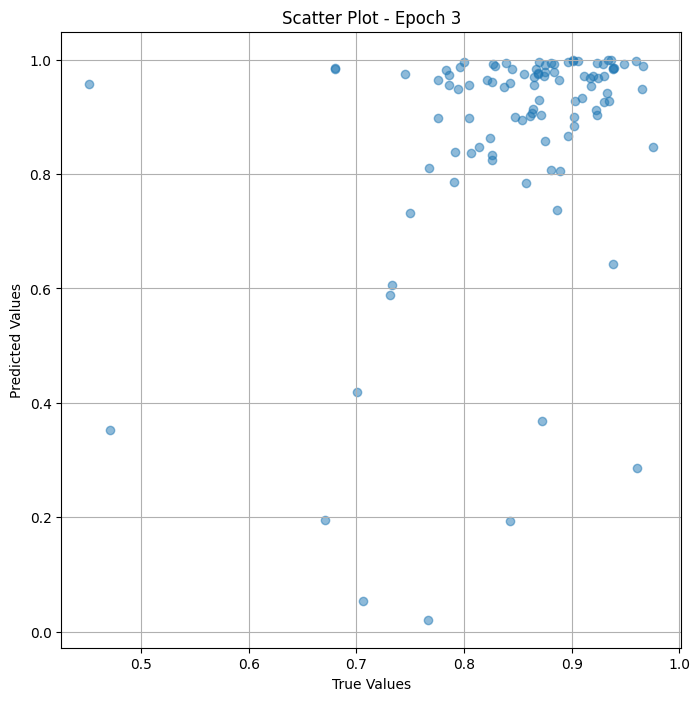


 Epoch: (4/50) Loss = 0.020640511065721512

 Epoch: (4/50) Loss_rmse = 0.1436680555343628

 Epoch: (4/50) R^2 = -18.029632568359375

 Epoch: (4/50) MAE = 0.14195983111858368

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

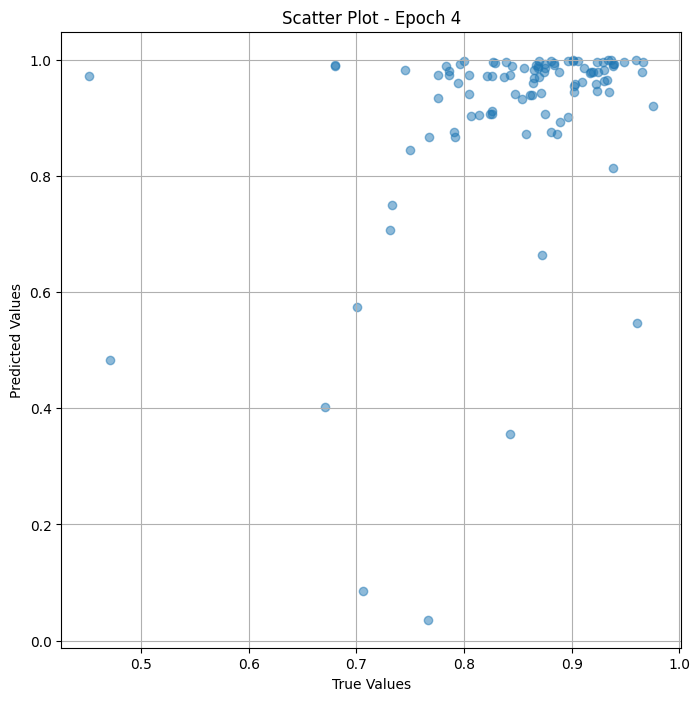


 Epoch: (5/50) Loss = 0.021220549941062927

 Epoch: (5/50) Loss_rmse = 0.1456727534532547

 Epoch: (5/50) R^2 = -18.564401626586914

 Epoch: (5/50) MAE = 0.14407913386821747

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

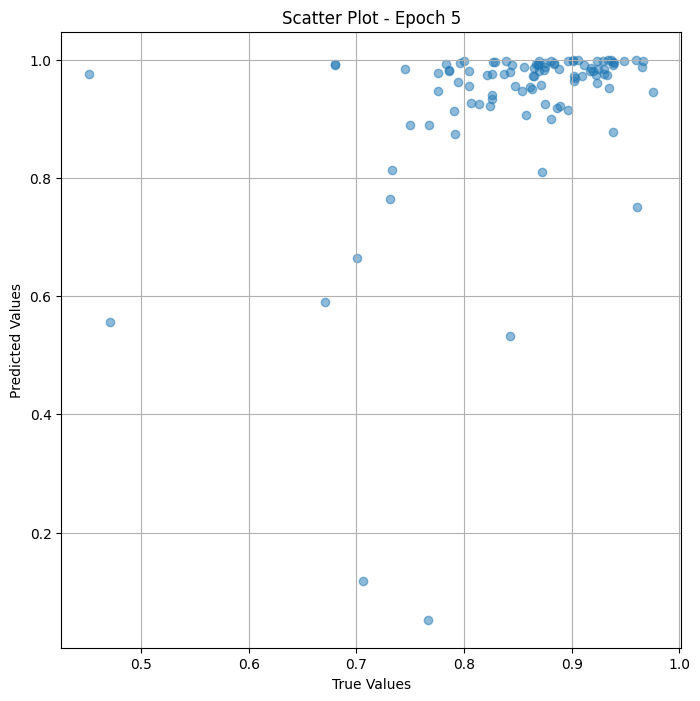


 Epoch: (6/50) Loss = 0.020741134881973267

 Epoch: (6/50) Loss_rmse = 0.14401783049106598

 Epoch: (6/50) R^2 = -18.12240219116211

 Epoch: (6/50) MAE = 0.14268213510513306

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

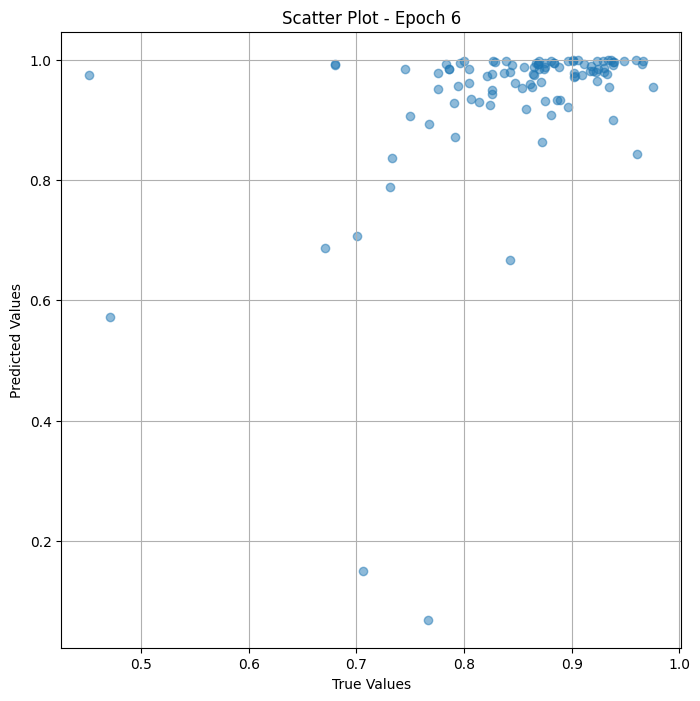


 Epoch: (7/50) Loss = 0.019389163702726364

 Epoch: (7/50) Loss_rmse = 0.13924497365951538

 Epoch: (7/50) R^2 = -16.875946044921875

 Epoch: (7/50) MAE = 0.1383073478937149

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

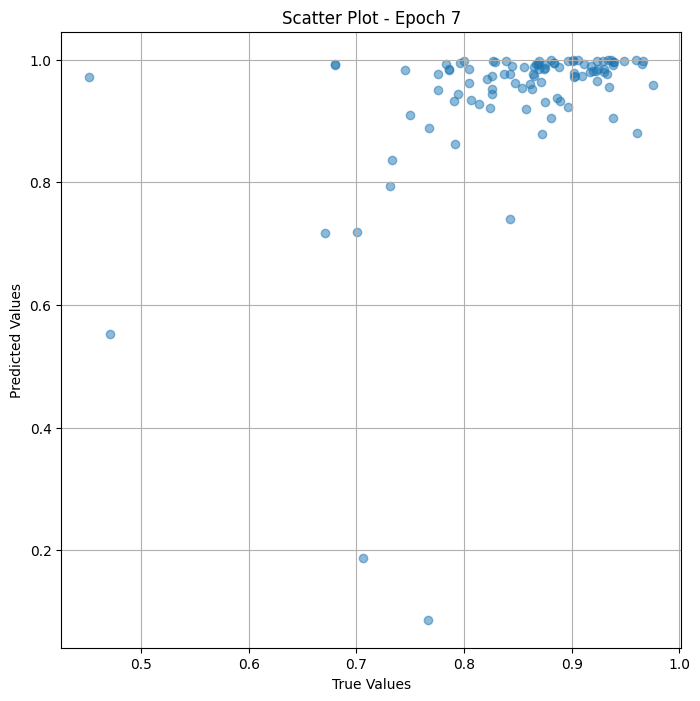


 Epoch: (8/50) Loss = 0.017088070511817932

 Epoch: (8/50) Loss_rmse = 0.1307213455438614

 Epoch: (8/50) R^2 = -14.754440307617188

 Epoch: (8/50) MAE = 0.13006429374217987

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8686

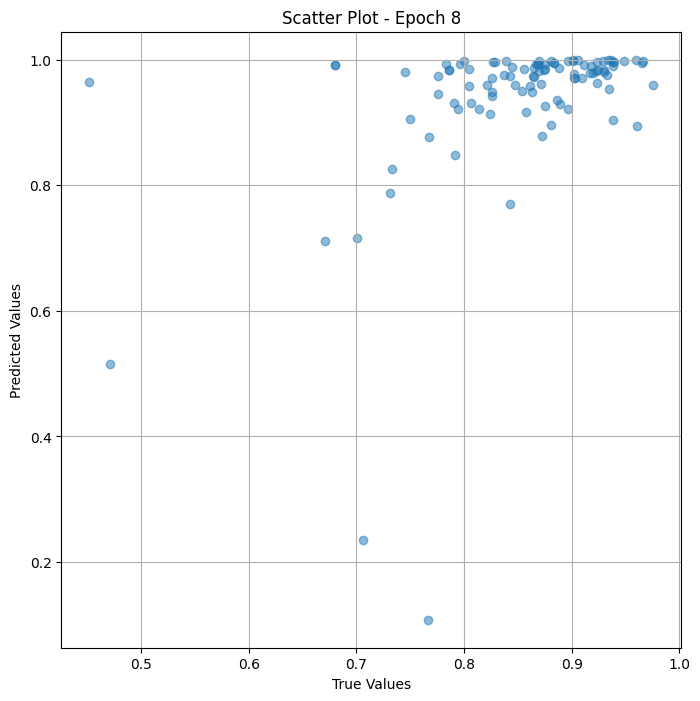


 Epoch: (9/50) Loss = 0.013855444267392159

 Epoch: (9/50) Loss_rmse = 0.11770915240049362

 Epoch: (9/50) R^2 = -11.774102210998535

 Epoch: (9/50) MAE = 0.11567533016204834

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.868

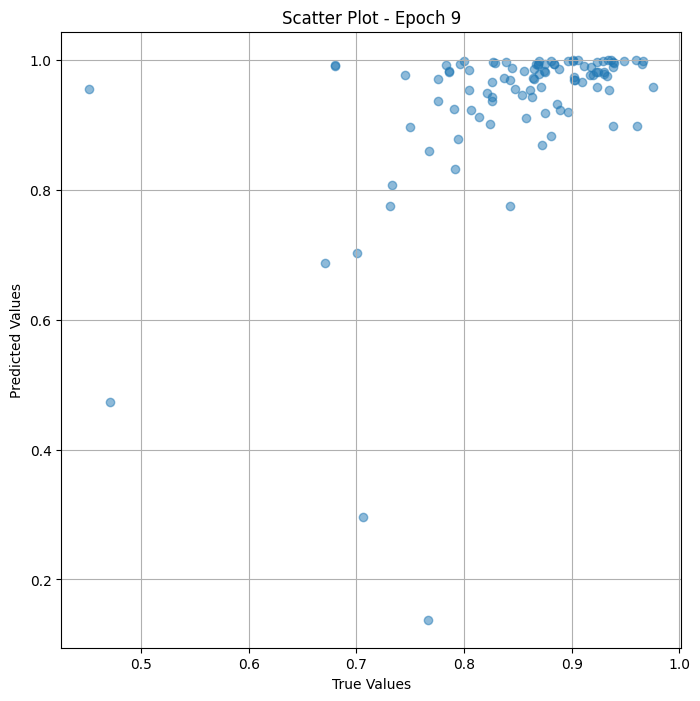


 Epoch: (10/50) Loss = 0.010835329070687294

 Epoch: (10/50) Loss_rmse = 0.10409288853406906

 Epoch: (10/50) R^2 = -8.989690780639648

 Epoch: (10/50) MAE = 0.09265537559986115

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.

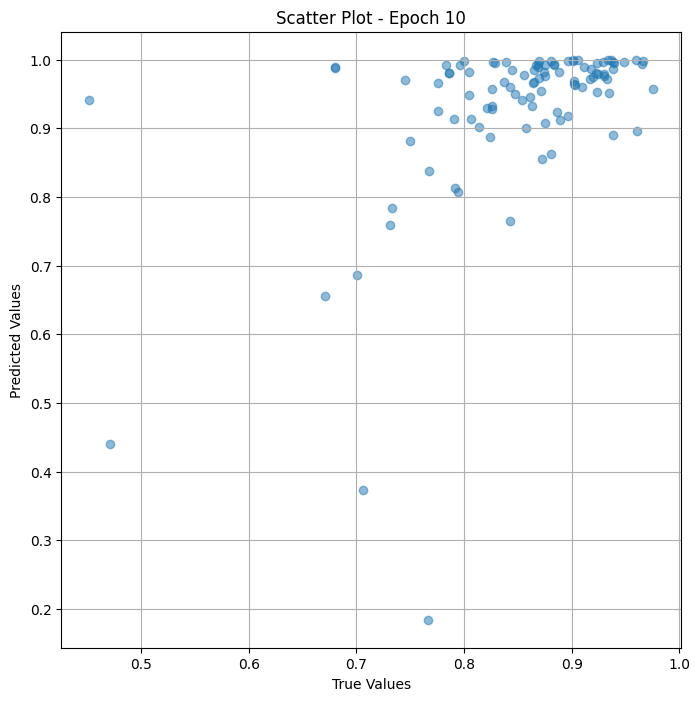


 Epoch: (11/50) Loss = 0.00997239537537098

 Epoch: (11/50) Loss_rmse = 0.09986188262701035

 Epoch: (11/50) R^2 = -8.194104194641113

 Epoch: (11/50) MAE = 0.09495045244693756

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8

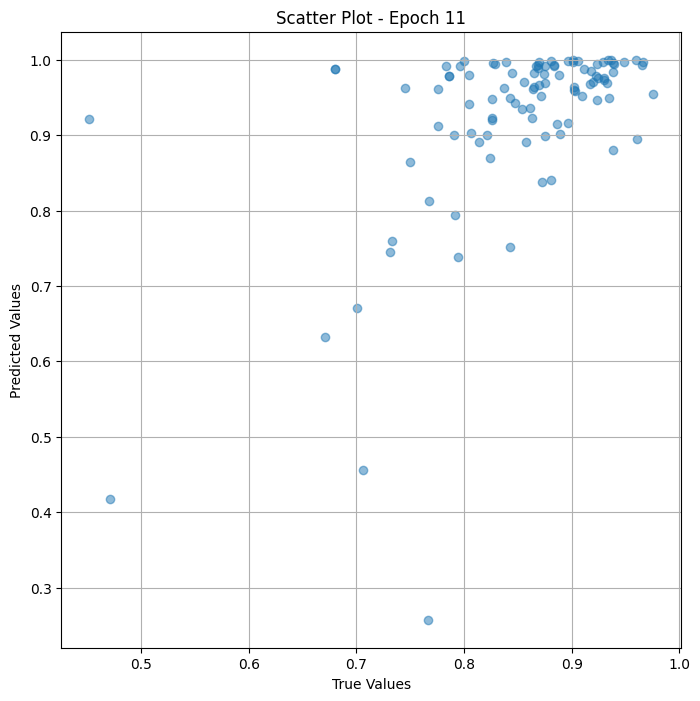


 Epoch: (12/50) Loss = 0.0084611214697361

 Epoch: (12/50) Loss_rmse = 0.0919843539595604

 Epoch: (12/50) R^2 = -6.800776958465576

 Epoch: (12/50) MAE = 0.08293959498405457

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.868

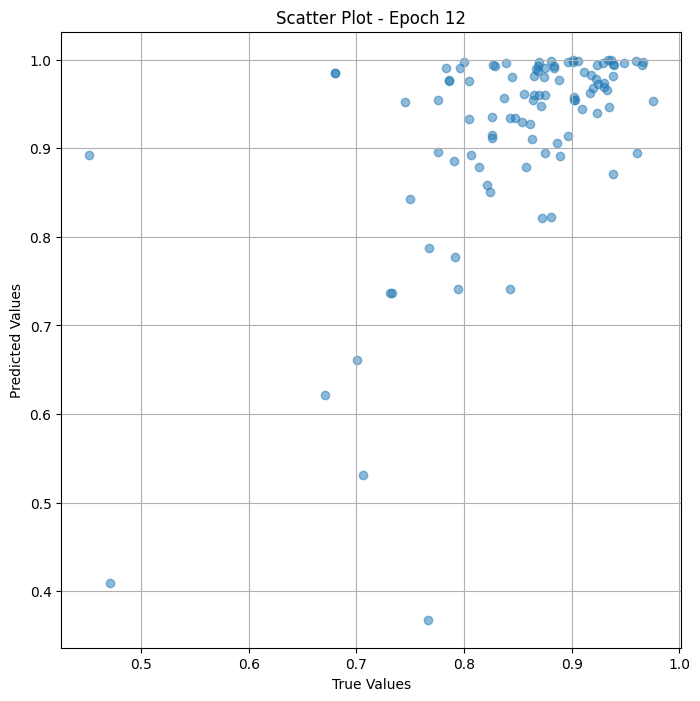


 Epoch: (13/50) Loss = 0.0072335368022322655

 Epoch: (13/50) Loss_rmse = 0.08505020290613174

 Epoch: (13/50) R^2 = -5.668998718261719

 Epoch: (13/50) MAE = 0.06625205278396606

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

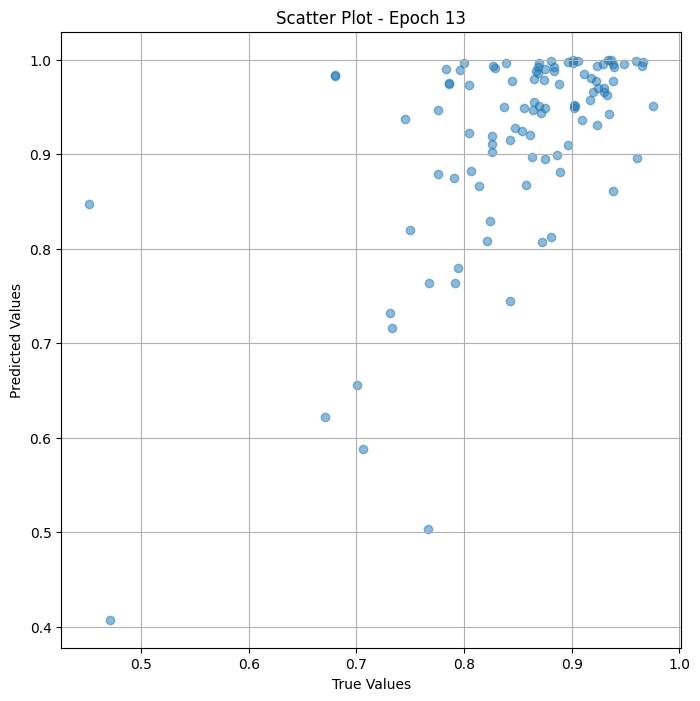


 Epoch: (14/50) Loss = 0.00736440671607852

 Epoch: (14/50) Loss_rmse = 0.08581612259149551

 Epoch: (14/50) R^2 = -5.789654731750488

 Epoch: (14/50) MAE = 0.07112476229667664

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.8

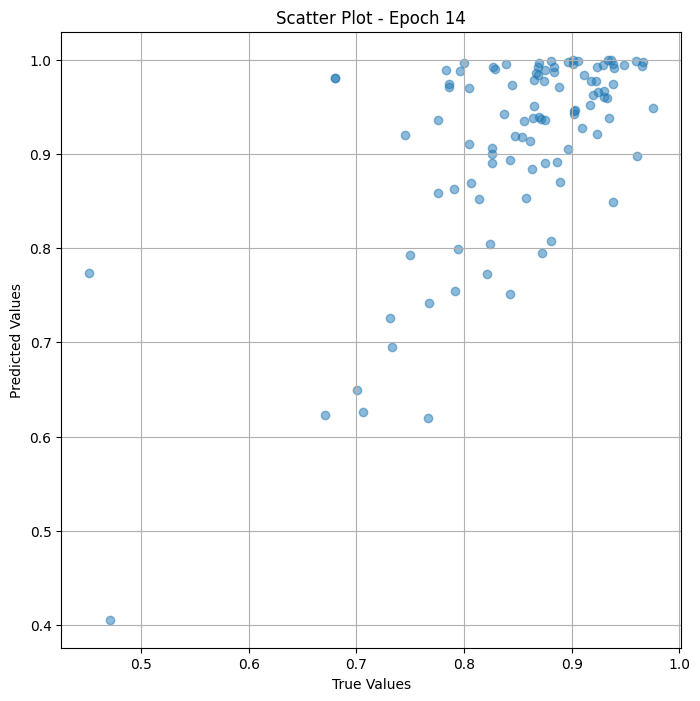


 Epoch: (15/50) Loss = 0.0068014152348041534

 Epoch: (15/50) Loss_rmse = 0.08247069269418716

 Epoch: (15/50) R^2 = -5.270601749420166

 Epoch: (15/50) MAE = 0.06756962835788727

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

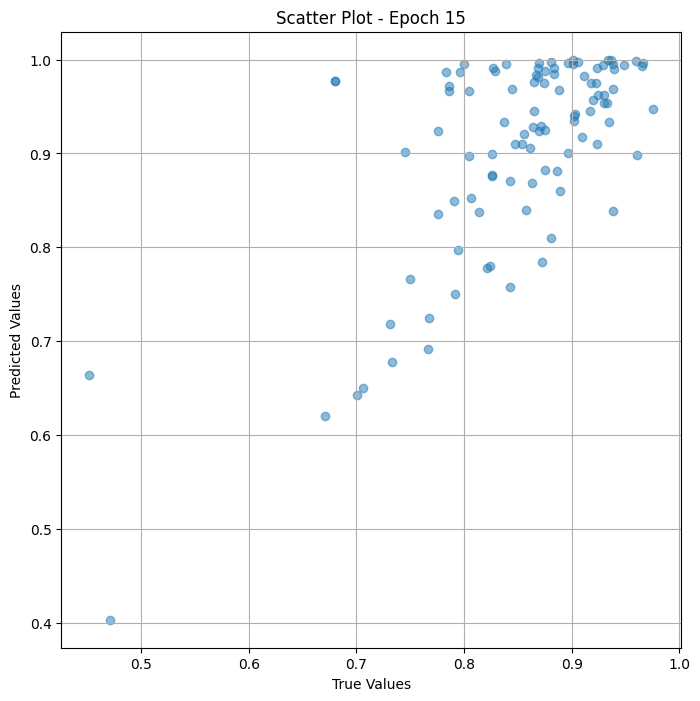


 Epoch: (16/50) Loss = 0.0059573035687208176

 Epoch: (16/50) Loss_rmse = 0.0771835669875145

 Epoch: (16/50) R^2 = -4.492368698120117

 Epoch: (16/50) MAE = 0.06029960513114929

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.

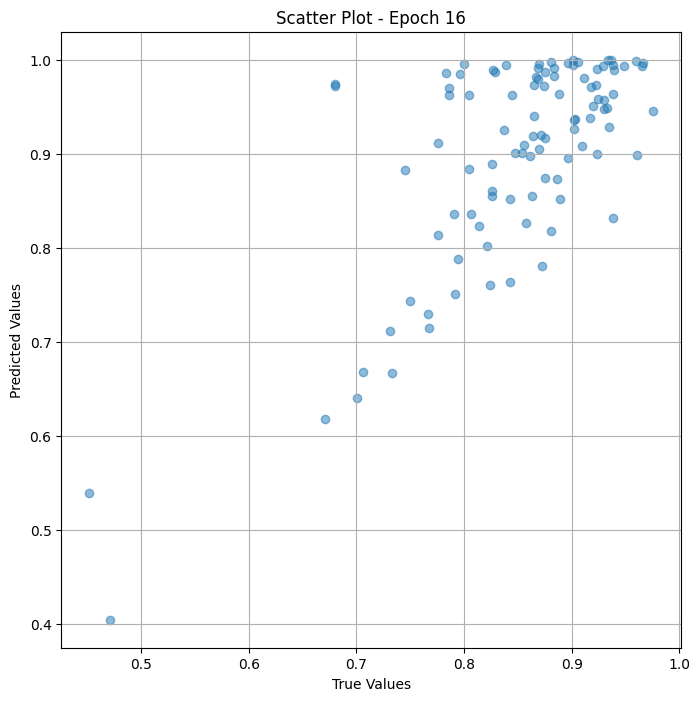


 Epoch: (17/50) Loss = 0.005377645138651133

 Epoch: (17/50) Loss_rmse = 0.07333242893218994

 Epoch: (17/50) R^2 = -3.957949161529541

 Epoch: (17/50) MAE = 0.05522303283214569

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0.

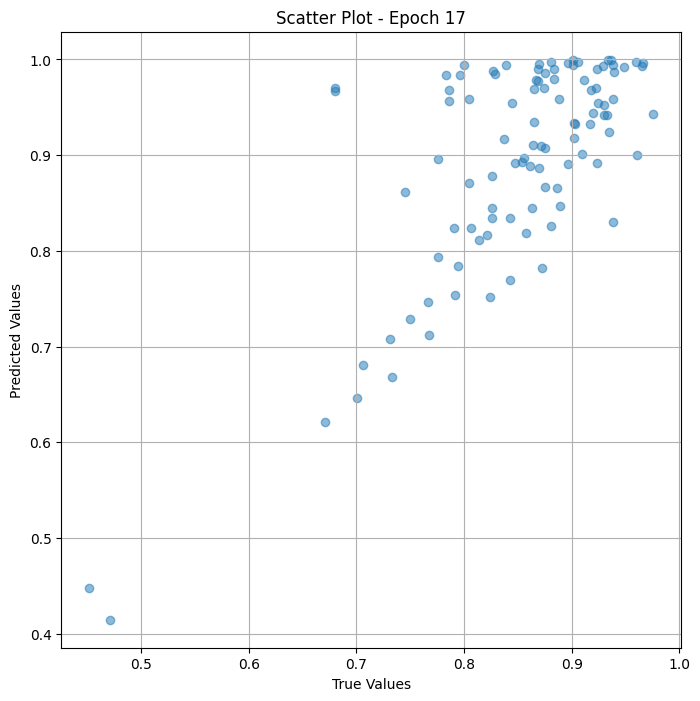


 Epoch: (18/50) Loss = 0.0048310584388673306

 Epoch: (18/50) Loss_rmse = 0.06950581818819046

 Epoch: (18/50) R^2 = -3.4540205001831055

 Epoch: (18/50) MAE = 0.051077768206596375

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

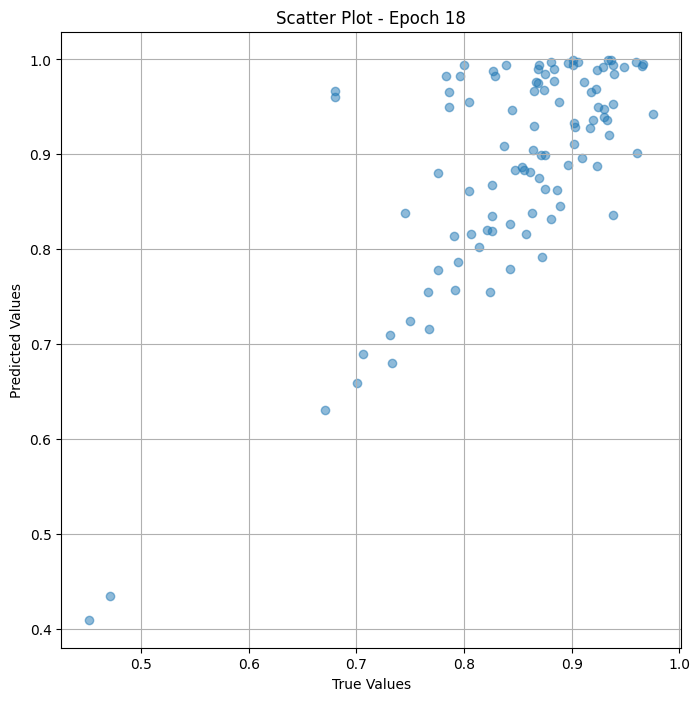


 Epoch: (19/50) Loss = 0.004218732006847858

 Epoch: (19/50) Loss_rmse = 0.06495177000761032

 Epoch: (19/50) R^2 = -2.8894829750061035

 Epoch: (19/50) MAE = 0.04794245958328247

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

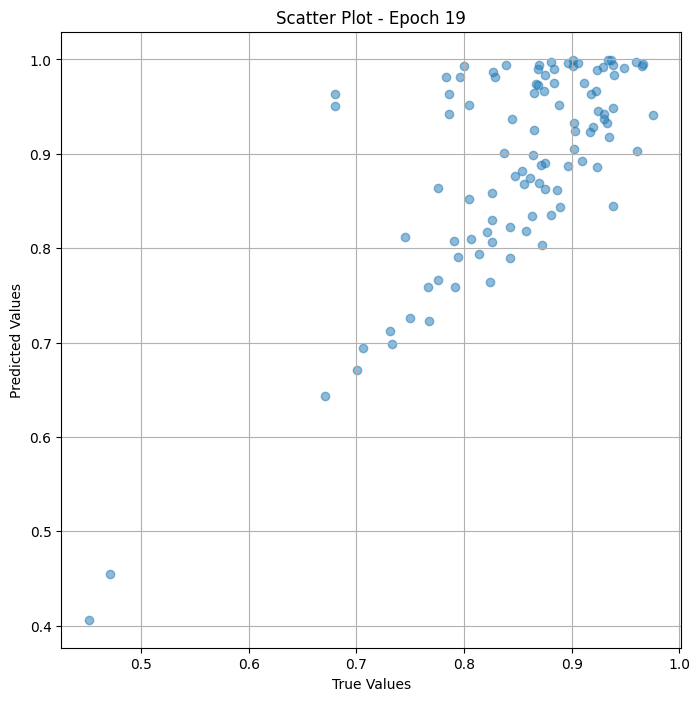


 Epoch: (20/50) Loss = 0.0035211273934692144

 Epoch: (20/50) Loss_rmse = 0.05933908745646477

 Epoch: (20/50) R^2 = -2.2463226318359375

 Epoch: (20/50) MAE = 0.04464210569858551

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

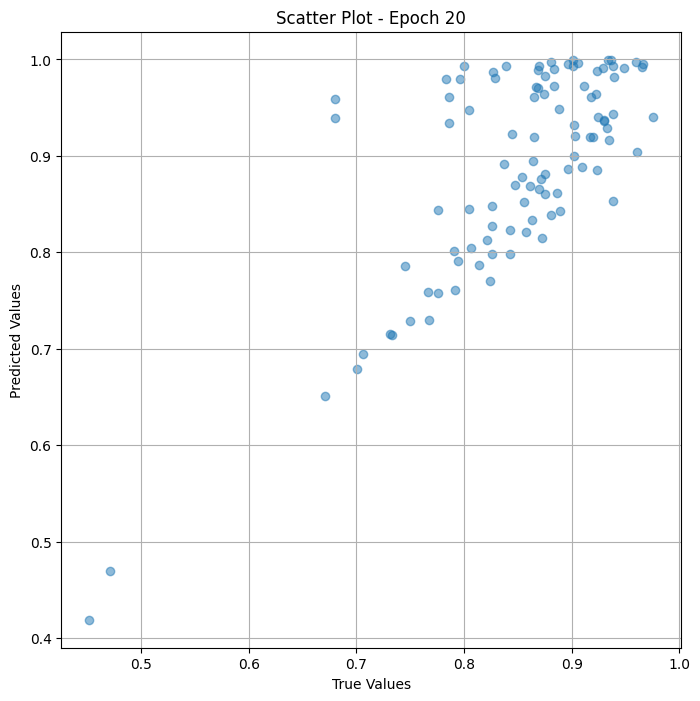


 Epoch: (21/50) Loss = 0.0027566878125071526

 Epoch: (21/50) Loss_rmse = 0.052504170686006546

 Epoch: (21/50) R^2 = -1.5415434837341309

 Epoch: (21/50) MAE = 0.03947950899600983

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

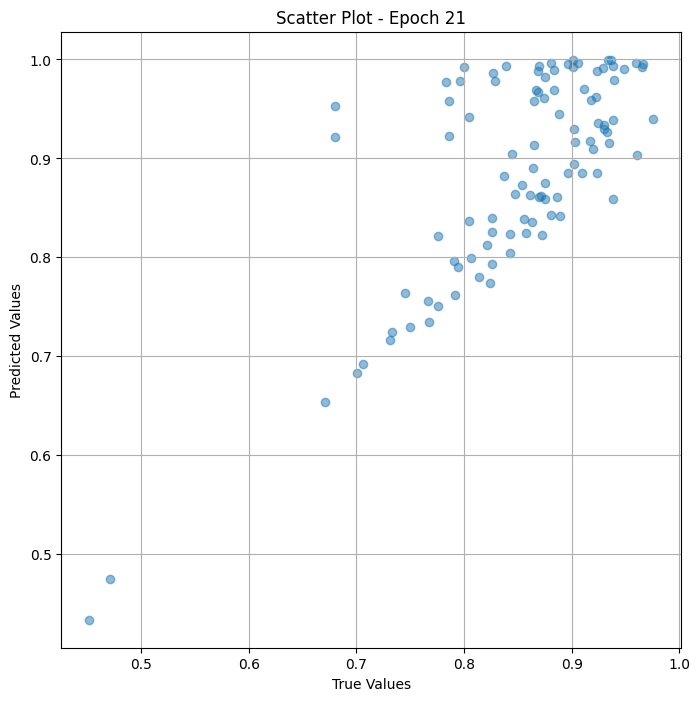


 Epoch: (22/50) Loss = 0.0020535343792289495

 Epoch: (22/50) Loss_rmse = 0.0453159399330616

 Epoch: (22/50) R^2 = -0.8932672739028931

 Epoch: (22/50) MAE = 0.03209985792636871

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

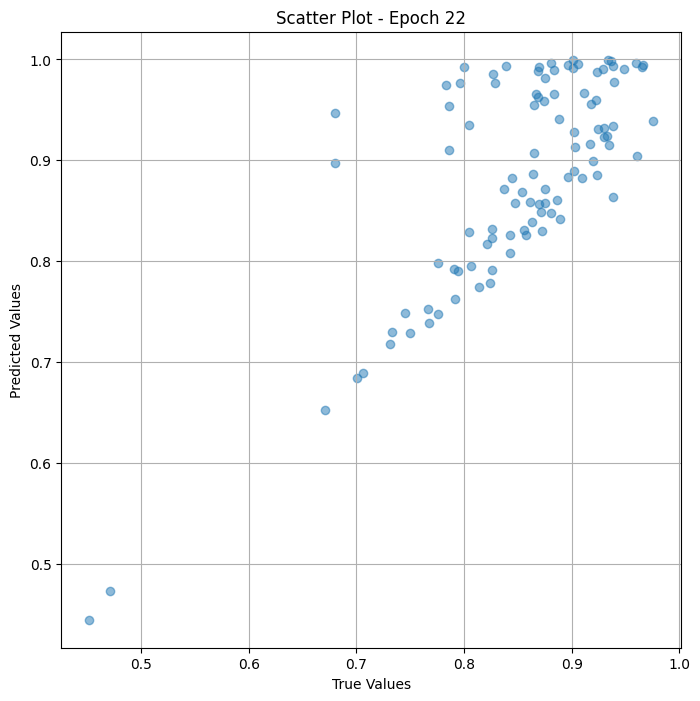


 Epoch: (23/50) Loss = 0.0015833611832931638

 Epoch: (23/50) Loss_rmse = 0.039791472256183624

 Epoch: (23/50) R^2 = -0.45978844165802

 Epoch: (23/50) MAE = 0.02406078577041626

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 0

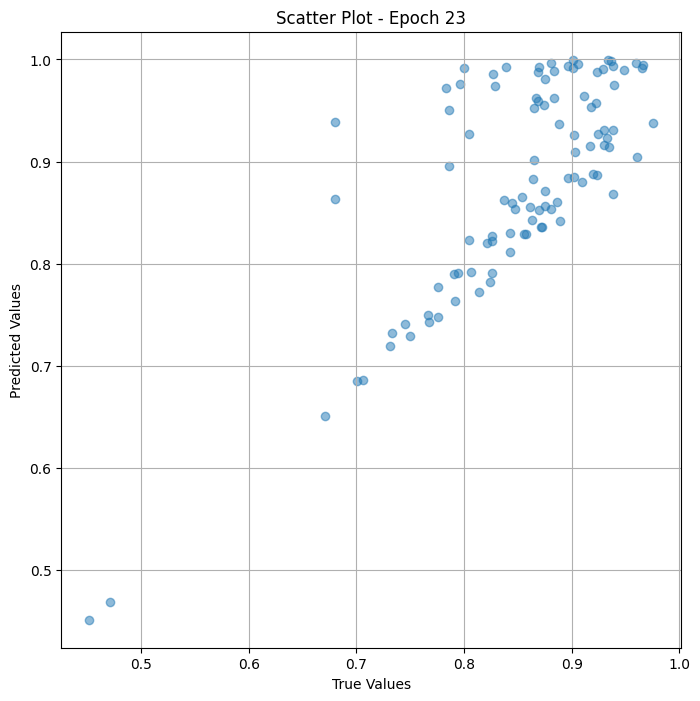


 Epoch: (24/50) Loss = 0.0013652165653184056

 Epoch: (24/50) Loss_rmse = 0.03694883733987808

 Epoch: (24/50) R^2 = -0.2586688995361328

 Epoch: (24/50) MAE = 0.020124614238739014

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

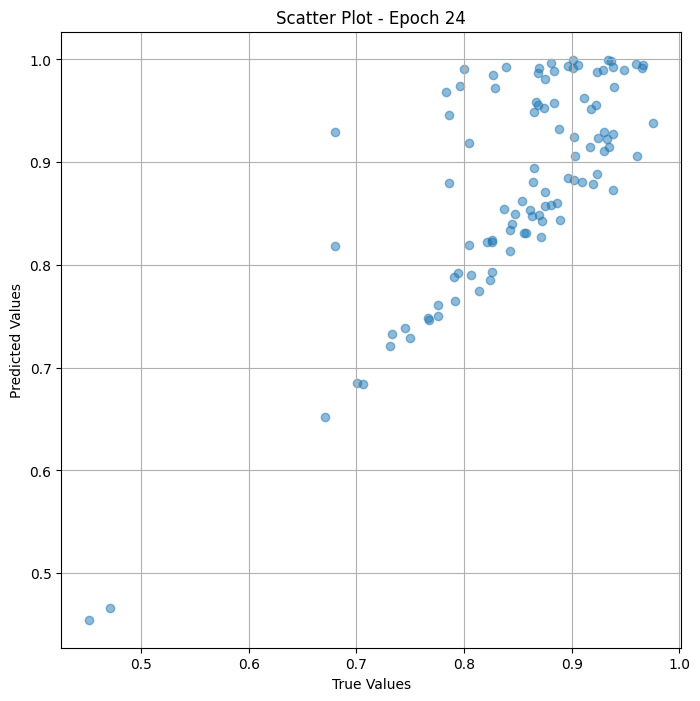


 Epoch: (25/50) Loss = 0.0012116488069295883

 Epoch: (25/50) Loss_rmse = 0.034808747470378876

 Epoch: (25/50) R^2 = -0.11708617210388184

 Epoch: (25/50) MAE = 0.02068626880645752

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307

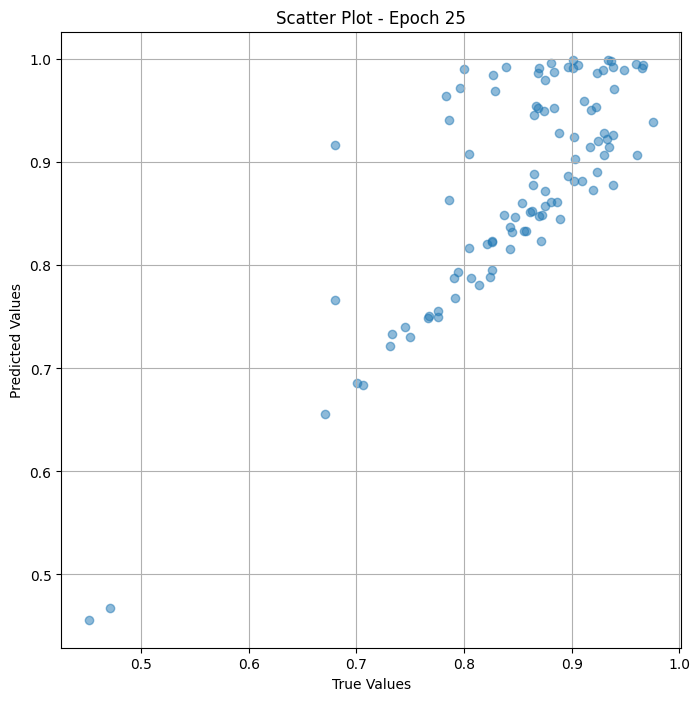


 Epoch: (26/50) Loss = 0.0009945728816092014

 Epoch: (26/50) Loss_rmse = 0.031536851078271866

 Epoch: (26/50) R^2 = 0.08304810523986816

 Epoch: (26/50) MAE = 0.01917313039302826

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

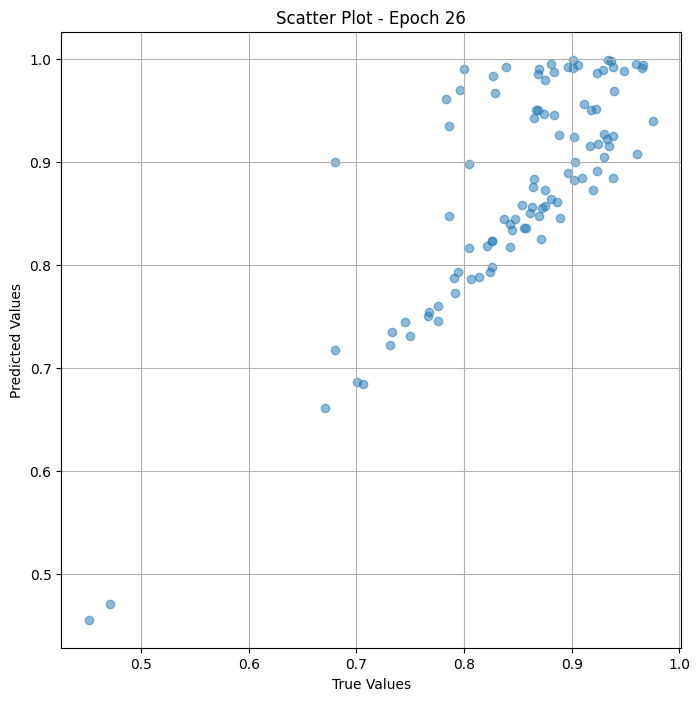


 Epoch: (27/50) Loss = 0.0007480705389752984

 Epoch: (27/50) Loss_rmse = 0.027350878342986107

 Epoch: (27/50) R^2 = 0.31031227111816406

 Epoch: (27/50) MAE = 0.01657705008983612

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

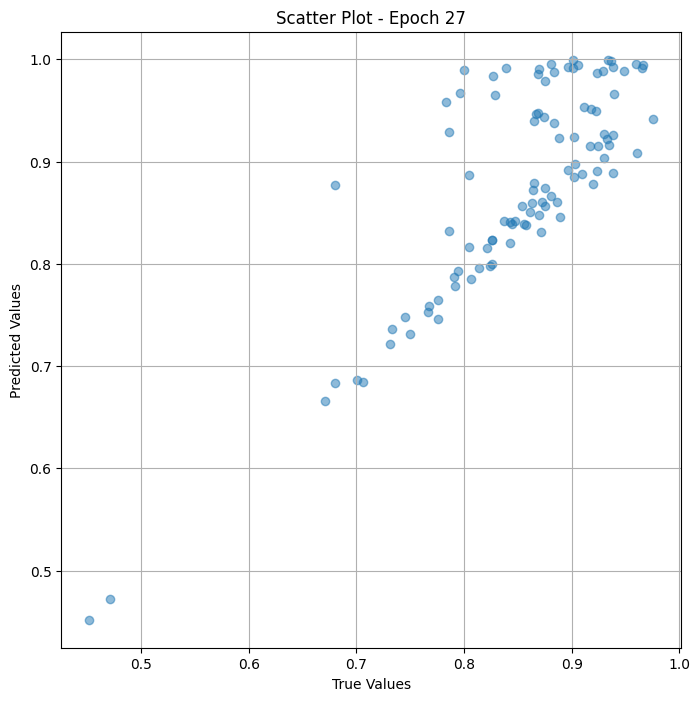


 Epoch: (28/50) Loss = 0.0005073266220279038

 Epoch: (28/50) Loss_rmse = 0.02252391166985035

 Epoch: (28/50) R^2 = 0.5322674512863159

 Epoch: (28/50) MAE = 0.013640239834785461

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

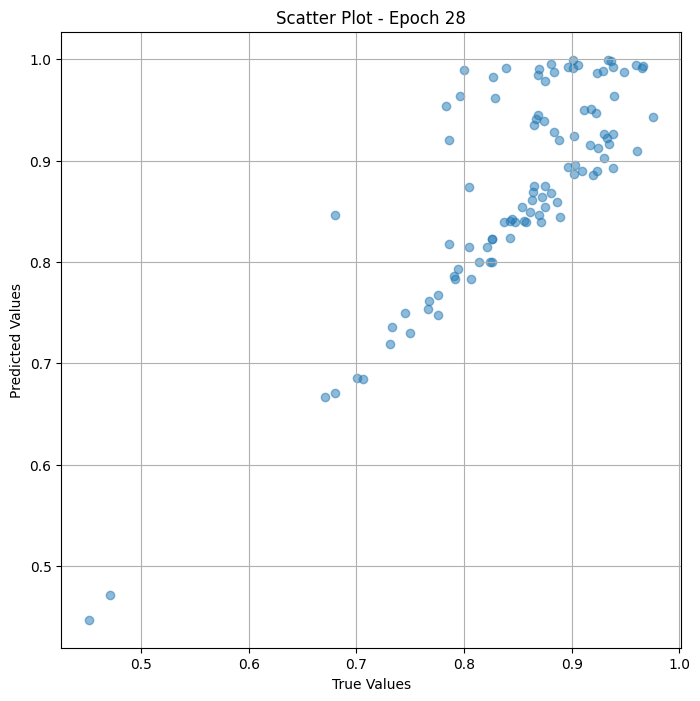


 Epoch: (29/50) Loss = 0.00029233068926259875

 Epoch: (29/50) Loss_rmse = 0.017097679898142815

 Epoch: (29/50) R^2 = 0.730484127998352

 Epoch: (29/50) MAE = 0.01049908995628357

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307, 

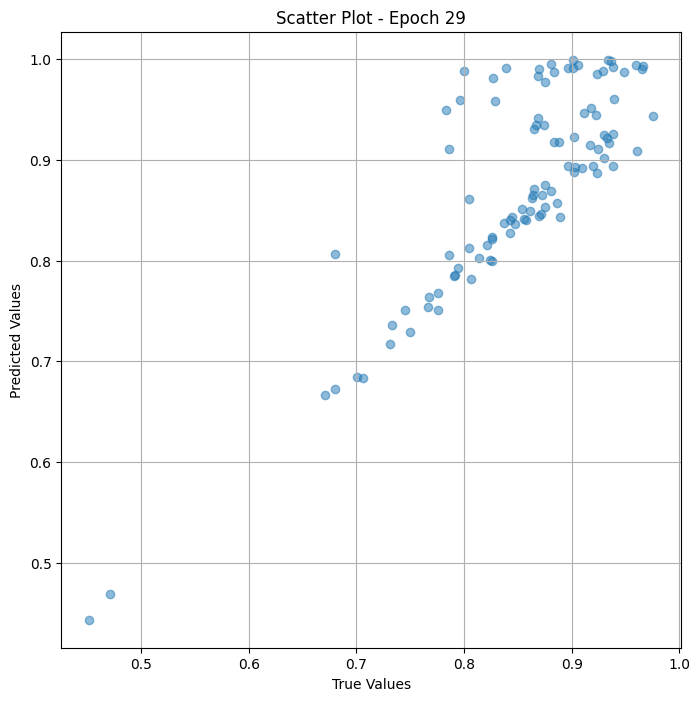


 Epoch: (30/50) Loss = 0.0001335080887656659

 Epoch: (30/50) Loss_rmse = 0.011554569937288761

 Epoch: (30/50) R^2 = 0.8769115209579468

 Epoch: (30/50) MAE = 0.007316067814826965

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

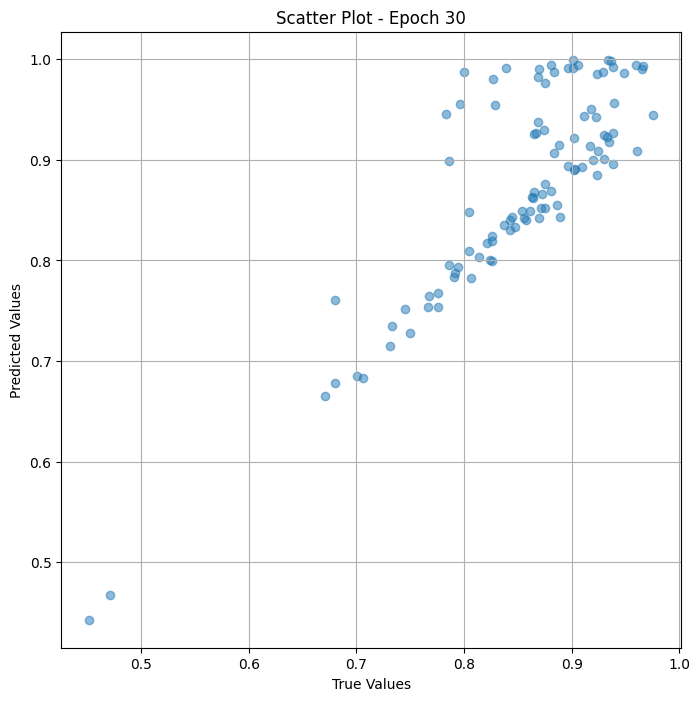


 Epoch: (31/50) Loss = 4.5128468627808616e-05

 Epoch: (31/50) Loss_rmse = 0.00671777268871665

 Epoch: (31/50) R^2 = 0.9583935737609863

 Epoch: (31/50) MAE = 0.004460066556930542

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

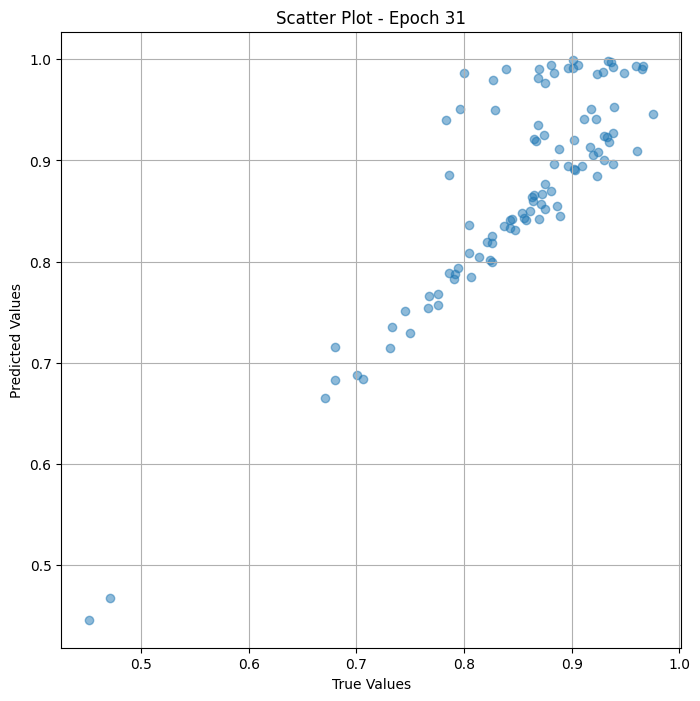


 Epoch: (32/50) Loss = 1.1247348083998077e-05

 Epoch: (32/50) Loss_rmse = 0.0033537065610289574

 Epoch: (32/50) R^2 = 0.9896304607391357

 Epoch: (32/50) MAE = 0.002500101923942566

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

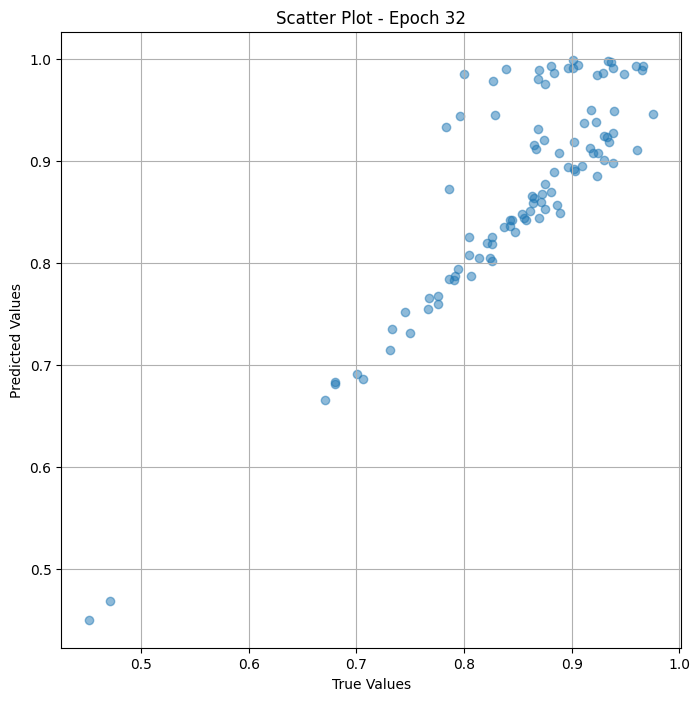


 Epoch: (33/50) Loss = 3.164510417263955e-06

 Epoch: (33/50) Loss_rmse = 0.0017789071425795555

 Epoch: (33/50) R^2 = 0.9970824718475342

 Epoch: (33/50) MAE = 0.0014755725860595703

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

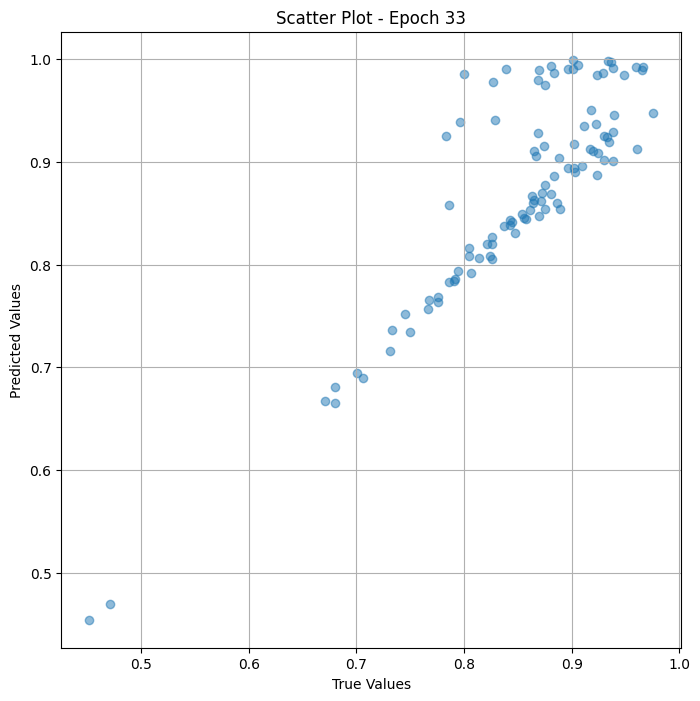


 Epoch: (34/50) Loss = 2.8267766083445167e-06

 Epoch: (34/50) Loss_rmse = 0.001681302092038095

 Epoch: (34/50) R^2 = 0.9973938465118408

 Epoch: (34/50) MAE = 0.0012560486793518066

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

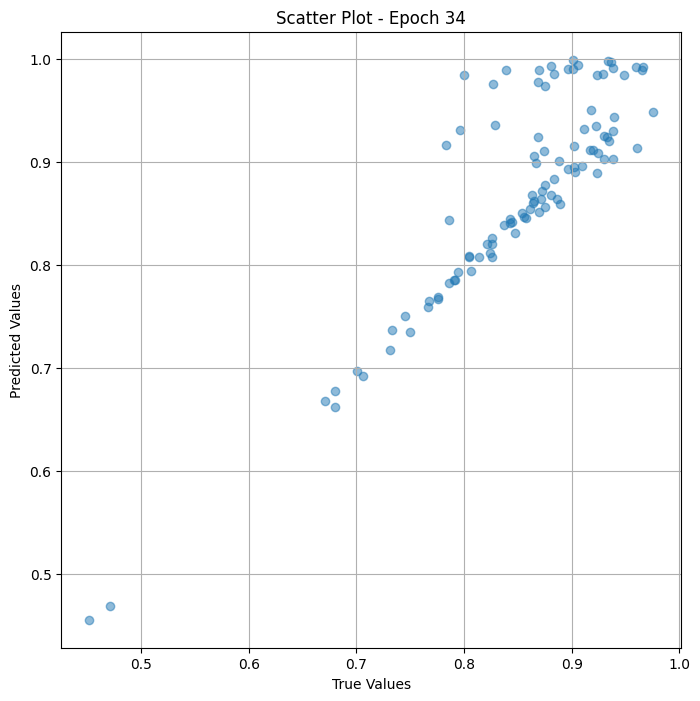


 Epoch: (35/50) Loss = 3.6038268262927886e-06

 Epoch: (35/50) Loss_rmse = 0.0018983747577294707

 Epoch: (35/50) R^2 = 0.9966774582862854

 Epoch: (35/50) MAE = 0.0014392584562301636

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.451923

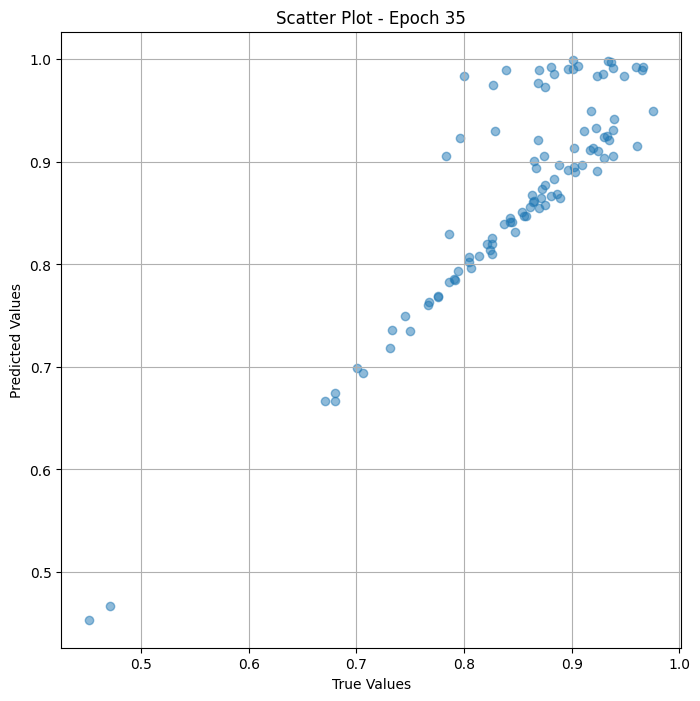


 Epoch: (36/50) Loss = 3.7341642382671125e-06

 Epoch: (36/50) Loss_rmse = 0.0019323985325172544

 Epoch: (36/50) R^2 = 0.9965572953224182

 Epoch: (36/50) MAE = 0.0013977587223052979

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.451923

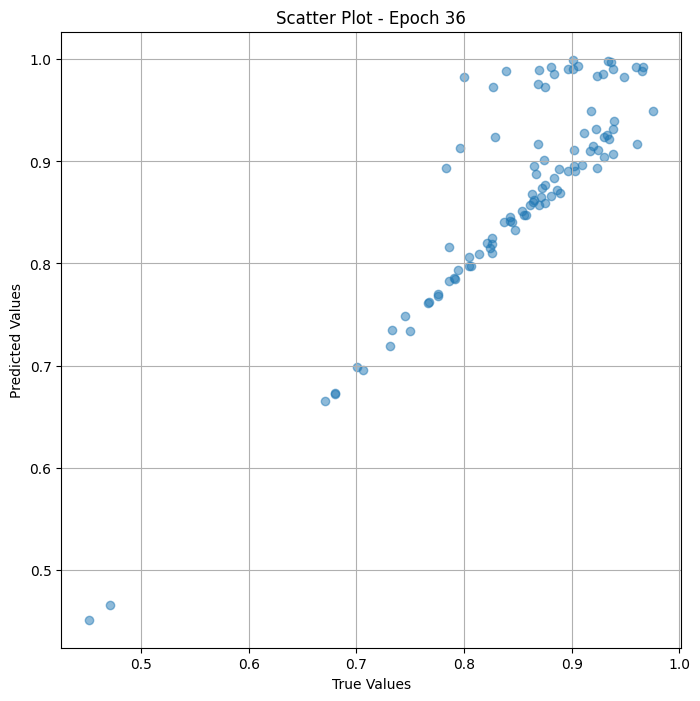


 Epoch: (37/50) Loss = 3.309905196147156e-06

 Epoch: (37/50) Loss_rmse = 0.0018193144351243973

 Epoch: (37/50) R^2 = 0.9969484210014343

 Epoch: (37/50) MAE = 0.0012015998363494873

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

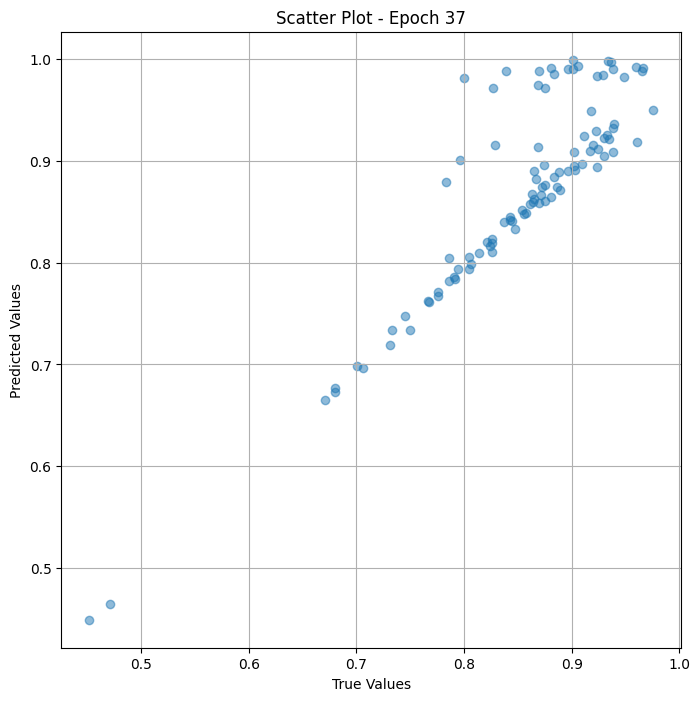


 Epoch: (38/50) Loss = 2.7323069389240118e-06

 Epoch: (38/50) Loss_rmse = 0.0016529691638424993

 Epoch: (38/50) R^2 = 0.9974809288978577

 Epoch: (38/50) MAE = 0.0010722726583480835

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.451923

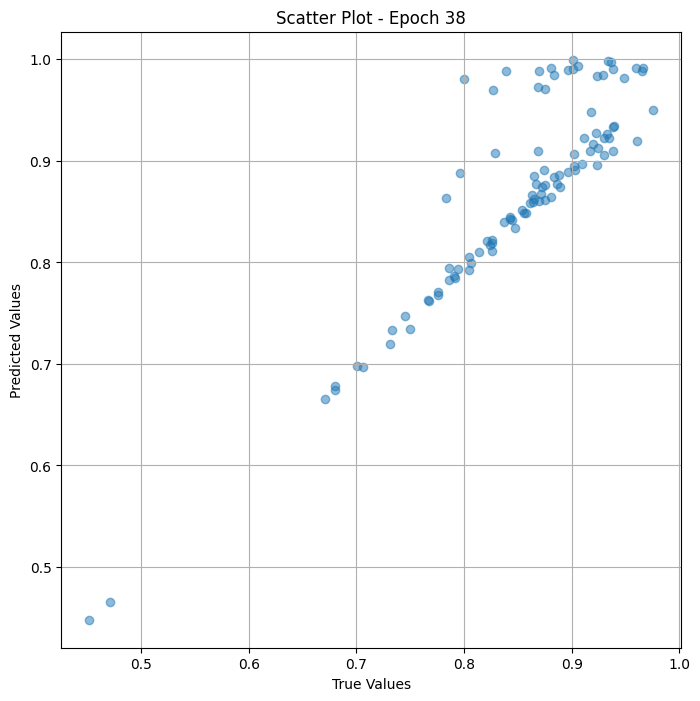


 Epoch: (39/50) Loss = 2.1370124159147963e-06

 Epoch: (39/50) Loss_rmse = 0.001461852341890335

 Epoch: (39/50) R^2 = 0.9980297684669495

 Epoch: (39/50) MAE = 0.000979498028755188

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307

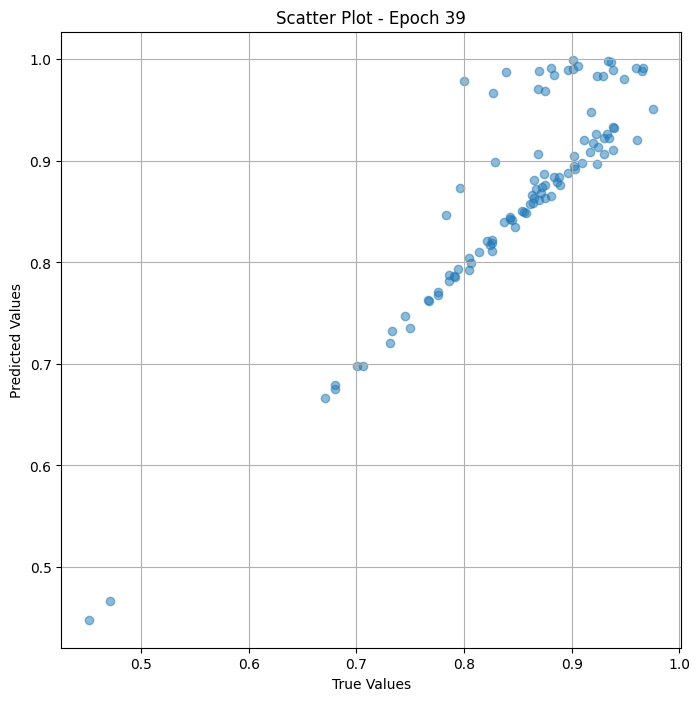


 Epoch: (40/50) Loss = 1.650324406909931e-06

 Epoch: (40/50) Loss_rmse = 0.0012846494792029262

 Epoch: (40/50) R^2 = 0.9984784722328186

 Epoch: (40/50) MAE = 0.0008937567472457886

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

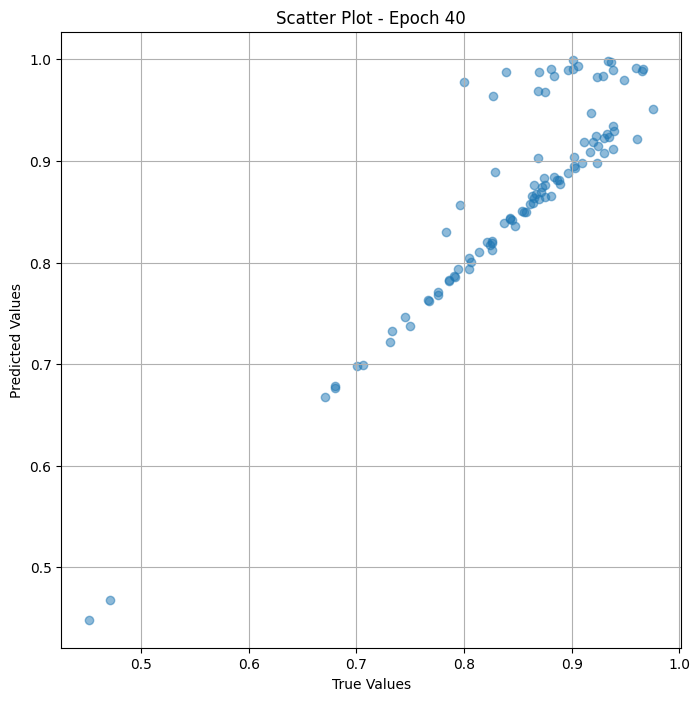


 Epoch: (41/50) Loss = 1.266933509214141e-06

 Epoch: (41/50) Loss_rmse = 0.0011255814461037517

 Epoch: (41/50) R^2 = 0.9988319277763367

 Epoch: (41/50) MAE = 0.0008074194192886353

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

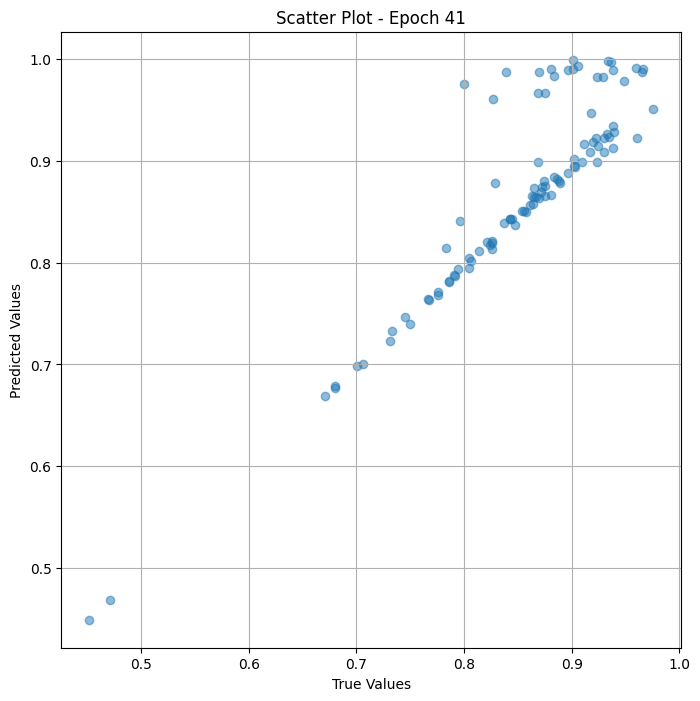


 Epoch: (42/50) Loss = 1.0342560017306823e-06

 Epoch: (42/50) Loss_rmse = 0.001016983762383461

 Epoch: (42/50) R^2 = 0.9990464448928833

 Epoch: (42/50) MAE = 0.0007854700088500977

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

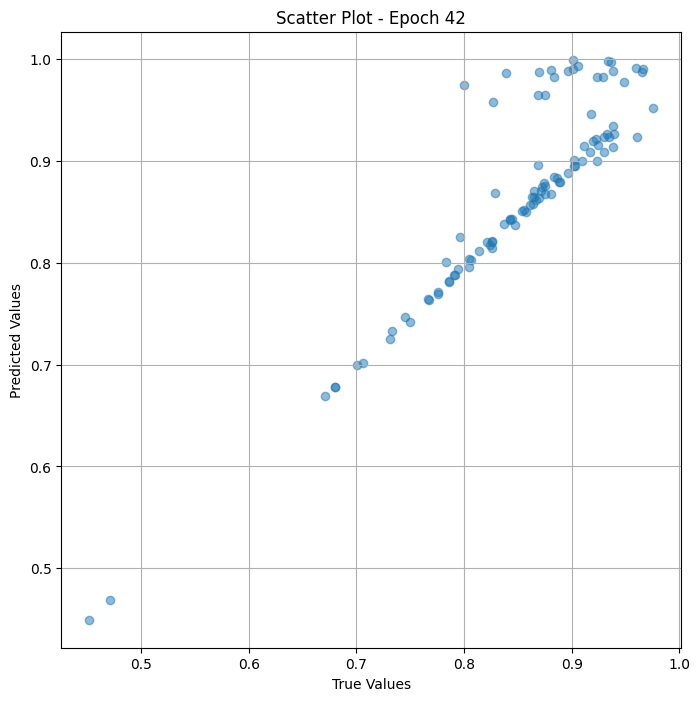


 Epoch: (43/50) Loss = 9.26505094867025e-07

 Epoch: (43/50) Loss_rmse = 0.0009625513339415193

 Epoch: (43/50) R^2 = 0.9991458058357239

 Epoch: (43/50) MAE = 0.0007658302783966064

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307

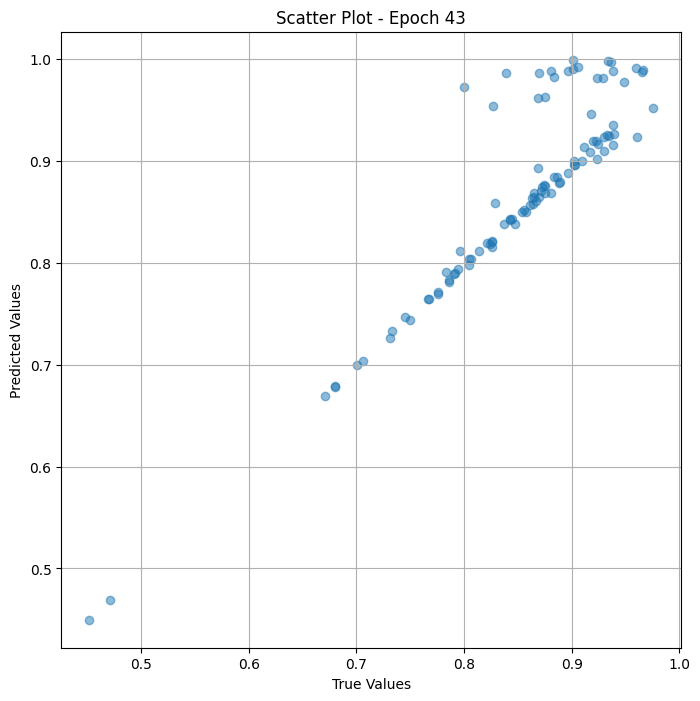


 Epoch: (44/50) Loss = 9.202040018863045e-07

 Epoch: (44/50) Loss_rmse = 0.0009592726710252464

 Epoch: (44/50) R^2 = 0.9991515874862671

 Epoch: (44/50) MAE = 0.0007601678371429443

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

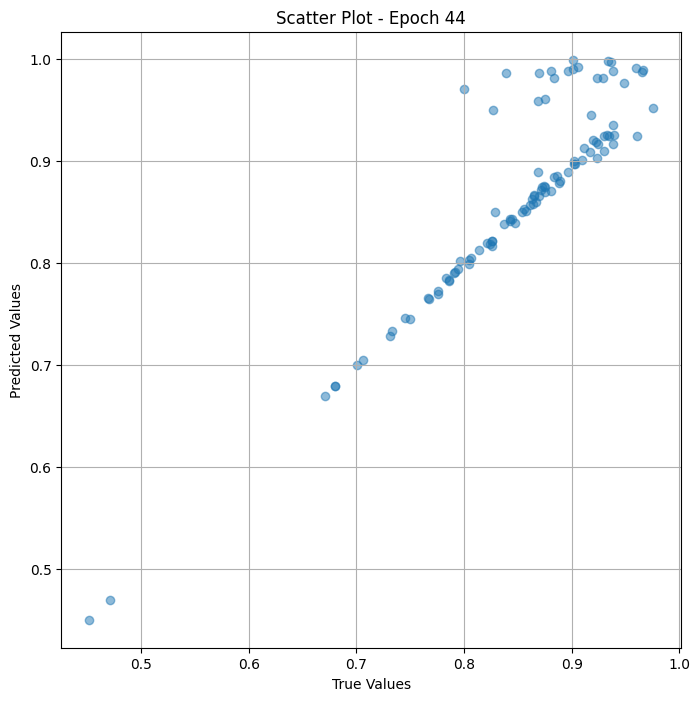


 Epoch: (45/50) Loss = 8.971931038104231e-07

 Epoch: (45/50) Loss_rmse = 0.0009472027886658907

 Epoch: (45/50) R^2 = 0.9991728067398071

 Epoch: (45/50) MAE = 0.0007183104753494263

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

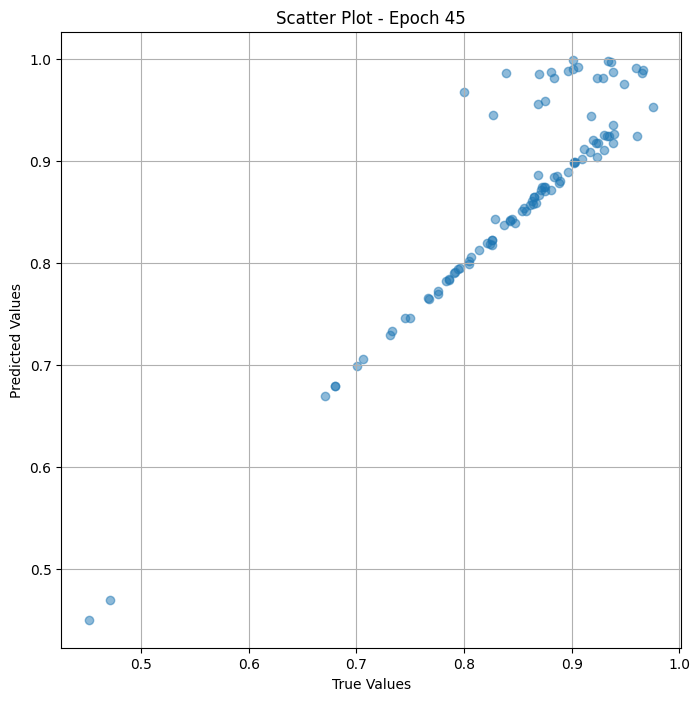


 Epoch: (46/50) Loss = 8.96279971129843e-07

 Epoch: (46/50) Loss_rmse = 0.0009467206546105444

 Epoch: (46/50) R^2 = 0.999173641204834

 Epoch: (46/50) MAE = 0.0006920844316482544

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307,

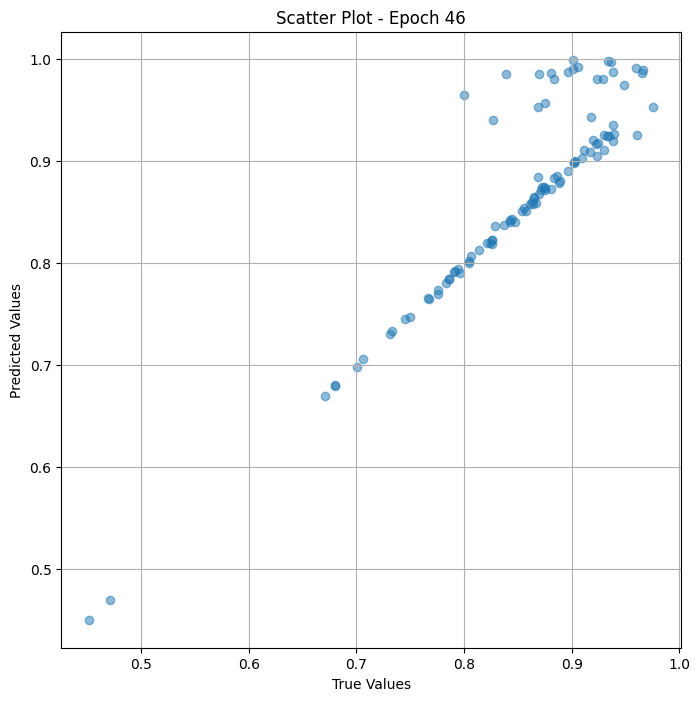


 Epoch: (47/50) Loss = 8.417814569838811e-07

 Epoch: (47/50) Loss_rmse = 0.0009174864972010255

 Epoch: (47/50) R^2 = 0.9992238879203796

 Epoch: (47/50) MAE = 0.0006753355264663696

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

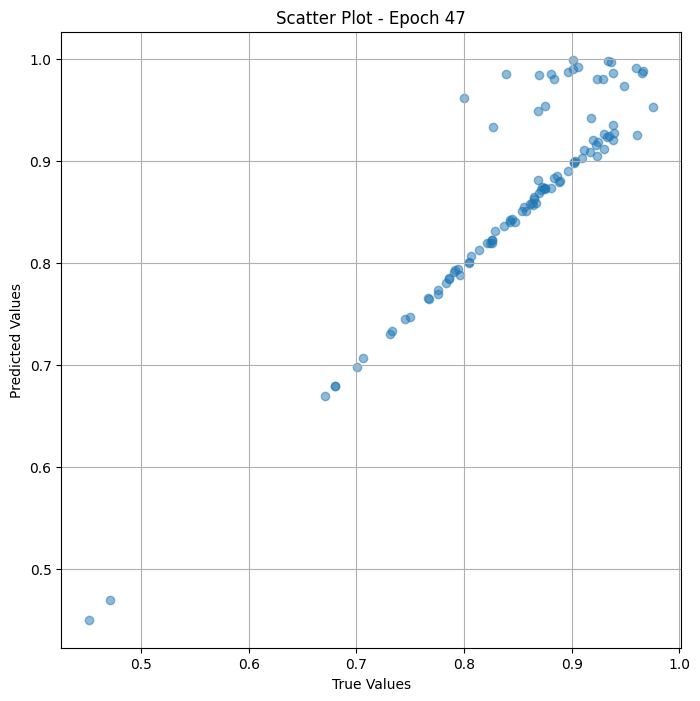


 Epoch: (48/50) Loss = 7.642693162779324e-07

 Epoch: (48/50) Loss_rmse = 0.0008742249920032918

 Epoch: (48/50) R^2 = 0.9992953538894653

 Epoch: (48/50) MAE = 0.0006764084100723267

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

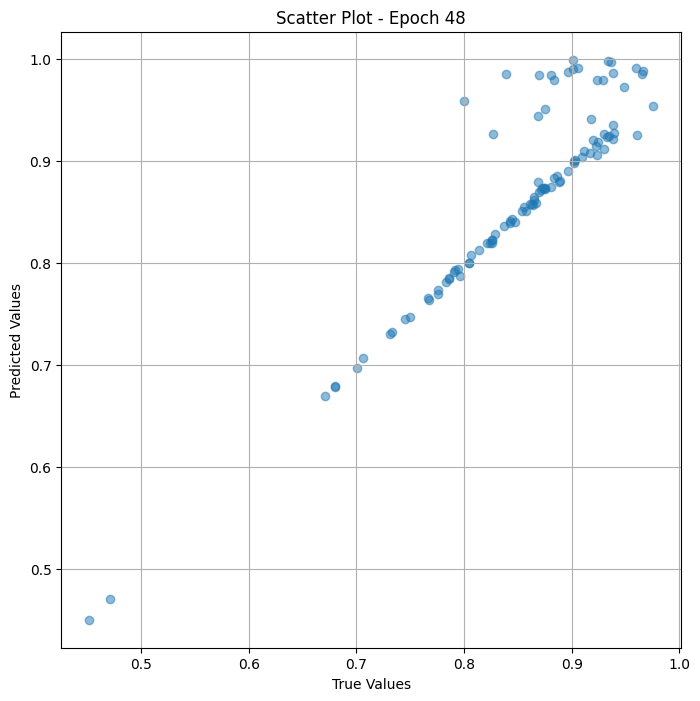


 Epoch: (49/50) Loss = 7.25918368971179e-07

 Epoch: (49/50) Loss_rmse = 0.0008520084084011614

 Epoch: (49/50) R^2 = 0.9993307590484619

 Epoch: (49/50) MAE = 0.0006674379110336304

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.45192307

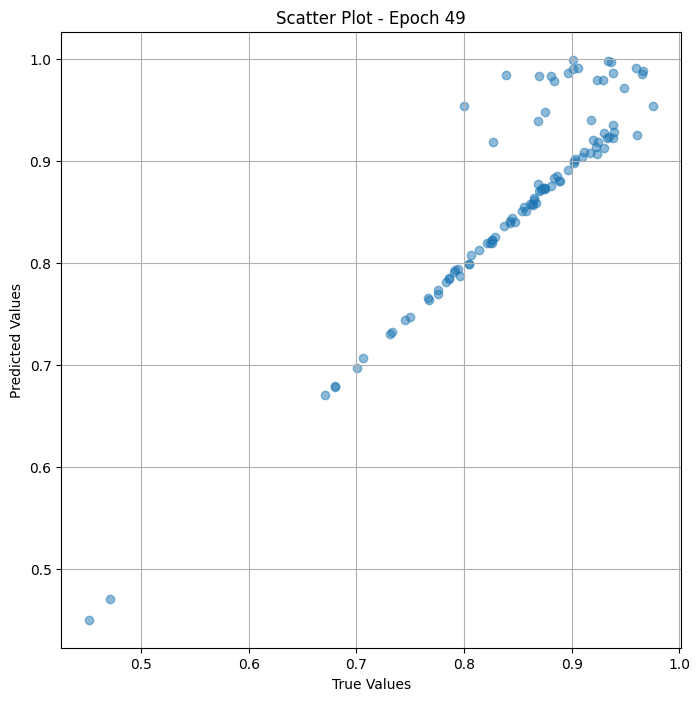


 Epoch: (50/50) Loss = 6.962077350181062e-07

 Epoch: (50/50) Loss_rmse = 0.0008343906374648213

 Epoch: (50/50) R^2 = 0.9993581175804138

 Epoch: (50/50) MAE = 0.0006522834300994873

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394, 0.67045456, 0.9326923, 0.76666665, 0.7058824, 0.872093, 0.9292929, 0.7326733, 0.75, 0.82608694, 0.8877551, 0.82653064, 0.87, 0.8558559, 0.9756098, 0.9117647, 0.68041235, 0.9652174, 0.8, 0.88659793, 0.78571427, 0.7669903, 0.8695652, 0.90625, 0.9183673, 0.8468468, 0.78571427, 0.85714287, 0.8712871, 0.86315787, 0.96, 0.96666664, 0.79591835, 0.8666667, 0.8611111, 0.8041237, 0.7758621, 0.9302326, 0.9385965, 0.82608694, 0.47115386, 0.82828283, 0.7755102, 0.96039605, 0.83870965, 0.9489796, 0.8804348, 0.8737864, 0.9032258, 0.9010989, 0.93457943, 0.7307692, 0.93877554, 0.85393256, 0.8645833, 0.9381443, 0.78313255, 0.82417583, 0.92391306, 0.4519230

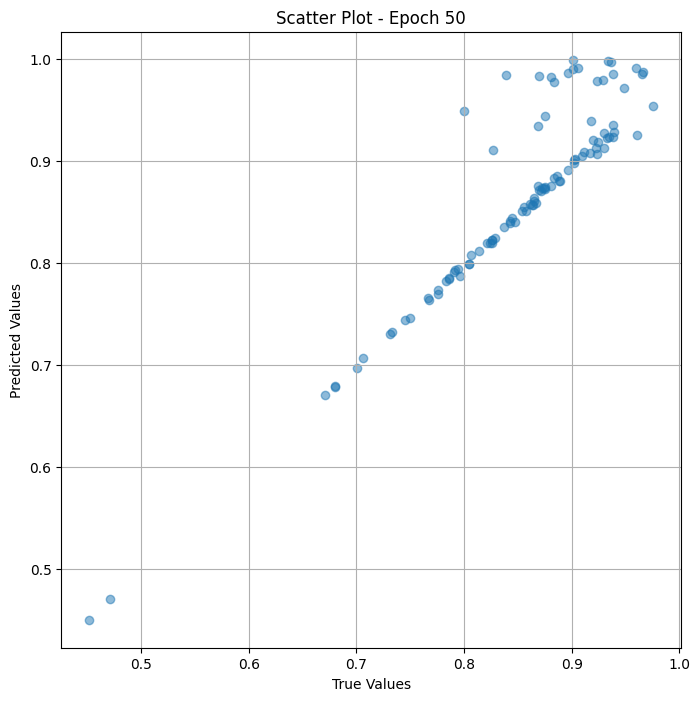

In [ ]:
# Training the model and save weights
fit(50, model_fine_test, train_dl_test)
torch.save(model_fine_test.state_dict(), "model_weights_vr_fine")

In [ ]:
 true_values_list = [0.8425926, 0.7904762, 0.90217394, 0.90217394, 0.93406594, 0.8043478, 0.93939394]

 predicted_values_list= [0.8135613, 0.7882019, 0.88235325, 0.92492133, 0.99911636, 0.9182967, 0.9732267]

import numpy as np
from scipy.stats import spearmanr


spearman_corr, _ = spearmanr(true_values_list, predicted_values_list)


print("Spearman correlation:",spearman_corr, _ )

Spearman correlation: 0.8288624656799143 0.02117351558100427
